### BADASS Analysis: NASH (nonalcoholic fatty liver disease) - 2 classes

Can we train an ML model to distinguish between serum samples from two different classes of patient (patients with and without NASH (nonalcoholic fatty liver disease))? And can the model successfully classify samples from patients it has not seen during training?

#### Analytes

Normal:
- Patient 1
- Patient 2
- Patient 3
- Patient 4
- Patient 5
- Patient 6
- Patient 7
- Patient 8
- Patient 9
- Patient 10
- Patient 11
- Patient 12
- Patient 13
- Patient 14
- Patient 29
- Patient 30
- Patient 31
- Patient 32
- Patient 33
- Patient 34
- Patient 35
- Patient 36
- Patient 37
- Patient 38
- Patient 39
- Patient 40
- Patient 41
- Patient 42

NASH:
- Patient 15
- Patient 16
- Patient 17
- Patient 18
- Patient 19
- Patient 20
- Patient 21
- Patient 22
- Patient 23
- Patient 24
- Patient 25
- Patient 26
- Patient 27
- Patient 28

Note that whilst the NASH patients definitely have NASH, the "normal" patients have not been tested to see if they also have NASH or not. Both sets of patients also have a range of other medical conditions (e.g. all of the NASH patients, and half of the "Normal" patients, have CAD (coronary artery disease)). Consequently, in spite of merging the original CAD and Normal classes into a single "normal" class in this current analysis, these two new classes remain noisy, and this is likely to be reflected in the results!

In [1]:
# Import from array_sensing package
from subroutines.parse_array_data import ParseArrayData
from subroutines.train import RunML, draw_conf_matrices

In [2]:
import copy
import math
import os
import pickle
import random
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from IPython.display import display
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import (
    accuracy_score, recall_score, precision_score, f1_score, cohen_kappa_score, make_scorer
)
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size

#### Parse in input data

NASH data (large array)

In [3]:
nash_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/NASH_serum_data/'
                           'Reformatted_csvs_2_classes_split_patient/'},
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_patient/'
                'NASH_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Locate xlsx files

In [4]:
nash_fluor_data.group_xlsx_repeats()

In [5]:
nash_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['NASH_eighteen_repeat_1.xlsx',
                             'NASH_fifteen_repeat_1.xlsx',
                             'NASH_nineteen_repeat_1.xlsx',
                             'NASH_seventeen_repeat_1.xlsx',
                             'NASH_sixteen_repeat_1.xlsx',
                             'NASH_twenty_repeat_1.xlsx',
                             'NASH_twentyeight_repeat_1.xlsx',
                             'NASH_twentyfive_repeat_1.xlsx',
                             'NASH_twentyfour_repeat_1.xlsx',
                             'NASH_twentyone_repeat_1.xlsx',
                             'NASH_twentyseven_repeat_1.xlsx',
                             'NASH_twentysix_repeat_1.xlsx',
                             'NASH_twentythree_repeat_1.xlsx',
                             'NASH_twentytwo_repeat_1.xlsx',
                             'Normal_eight_repeat_1.xlsx',
                           

Read the data in each xlsx file into a dataframe and perform min-max scaling

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

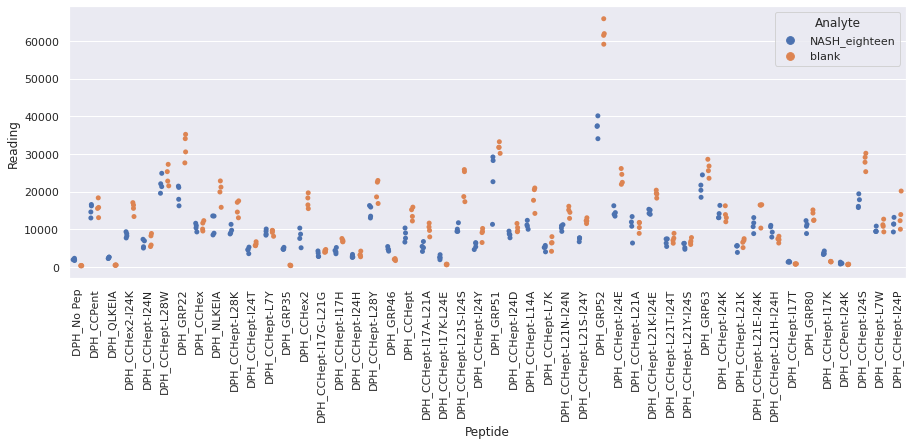

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

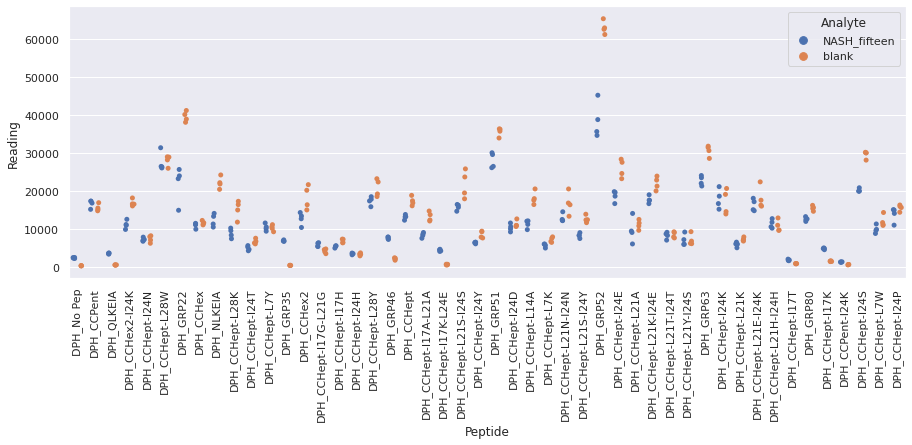

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

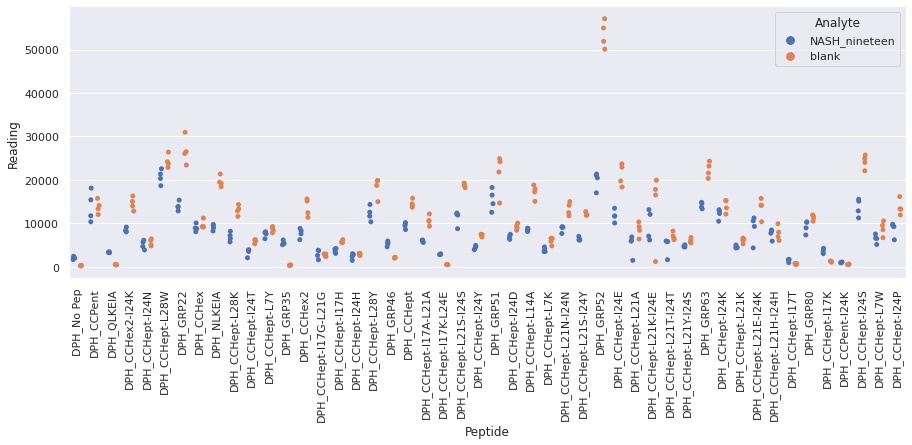

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

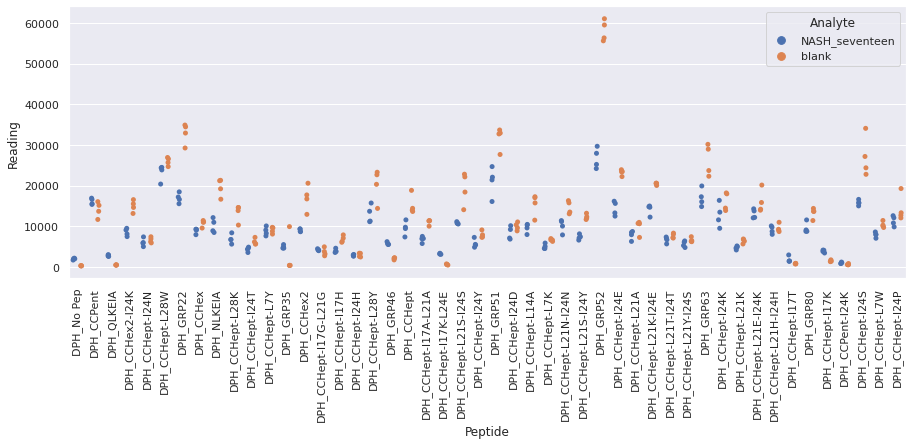

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

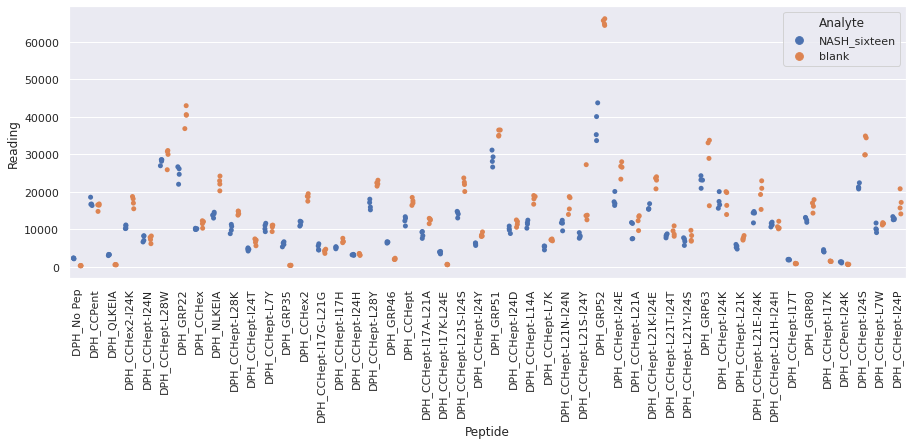

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

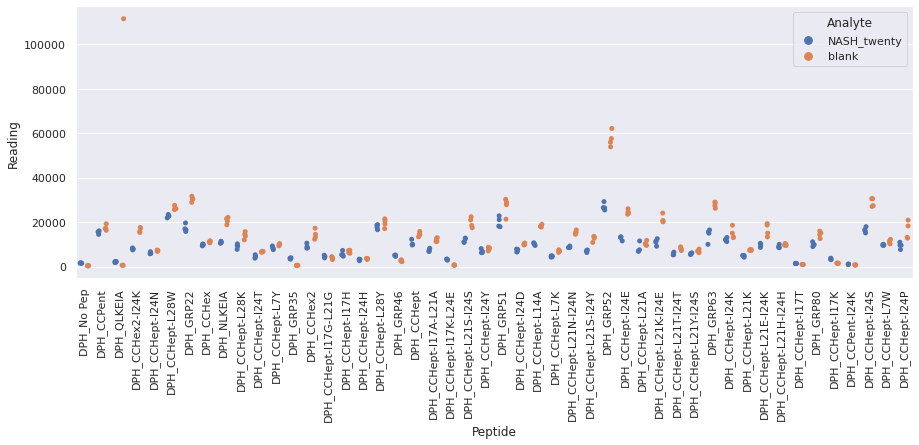

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

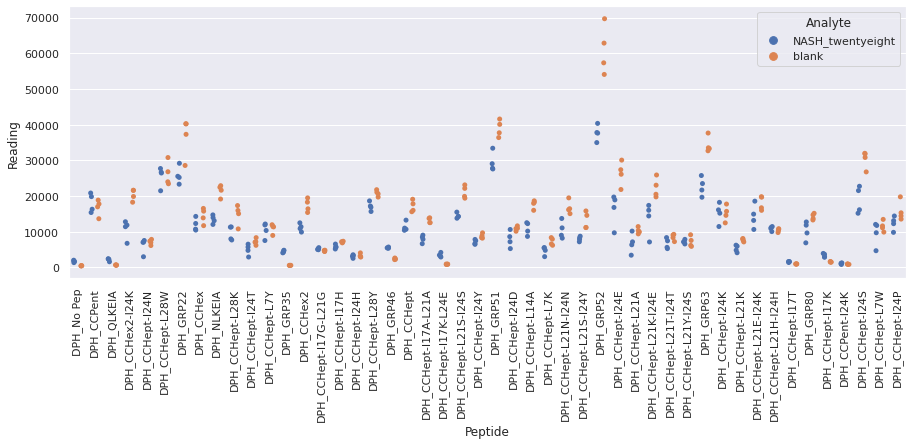

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

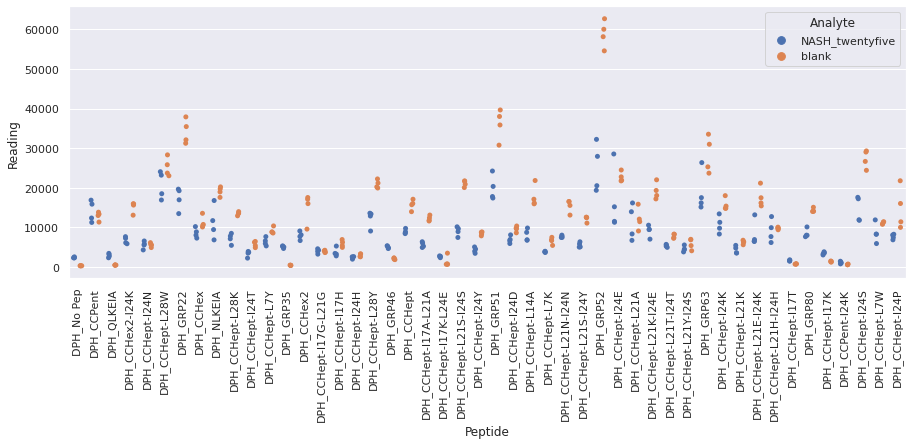

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

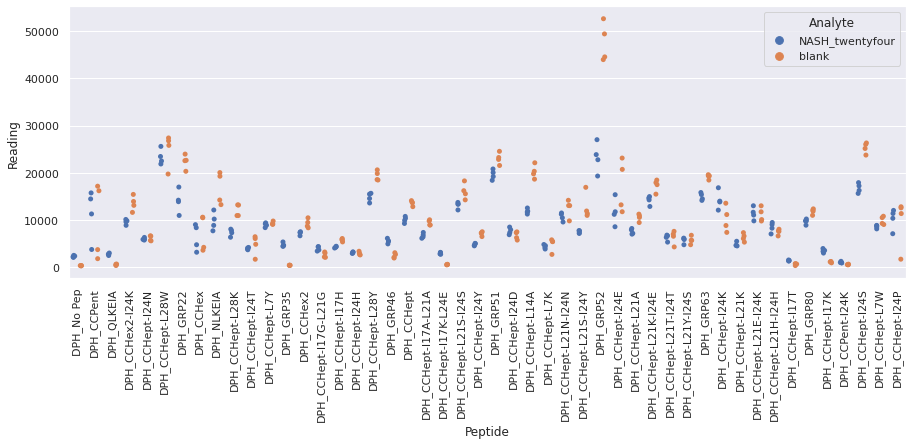

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

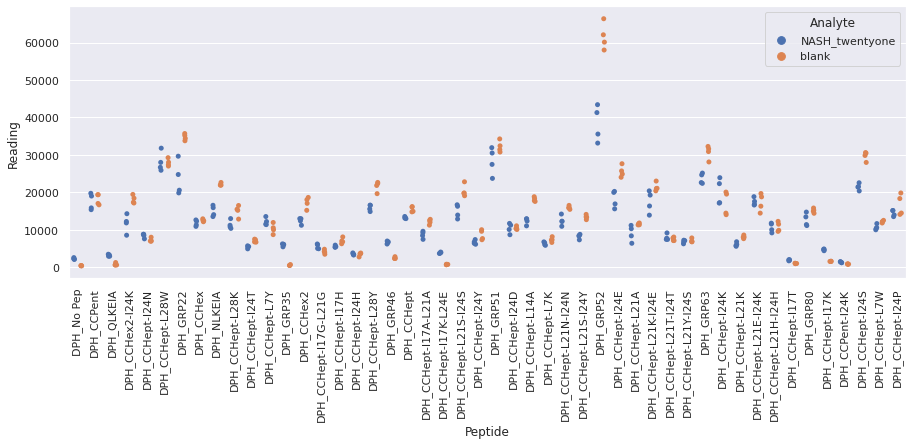

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

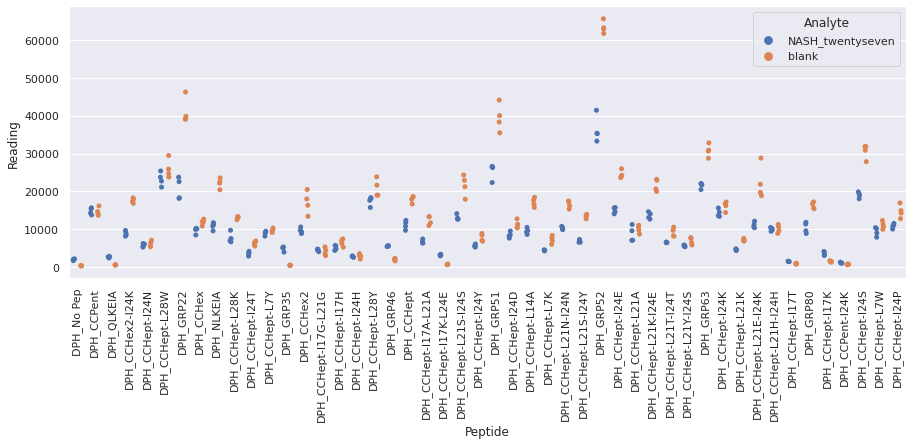

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

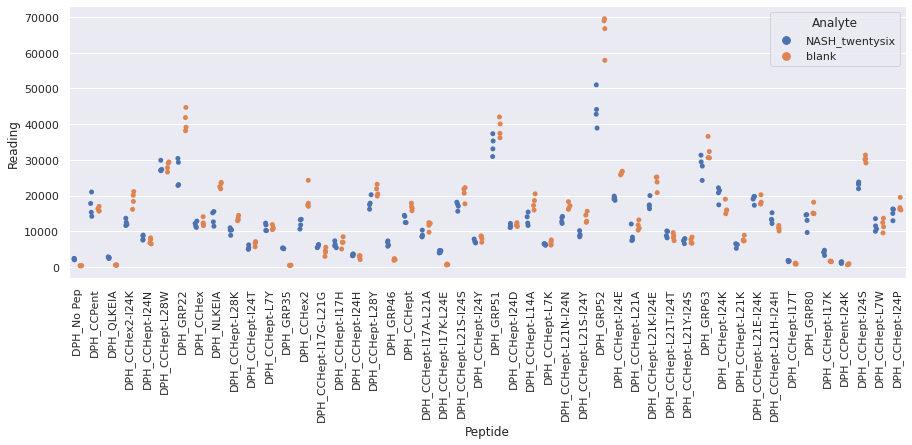

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

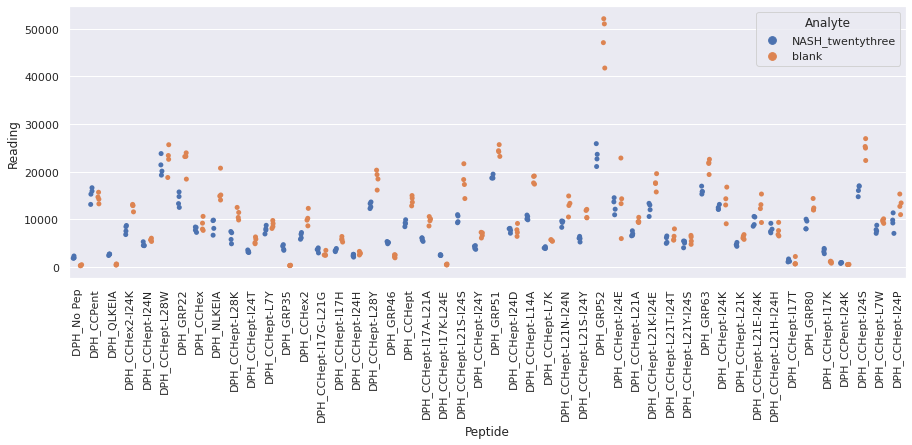

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_1.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

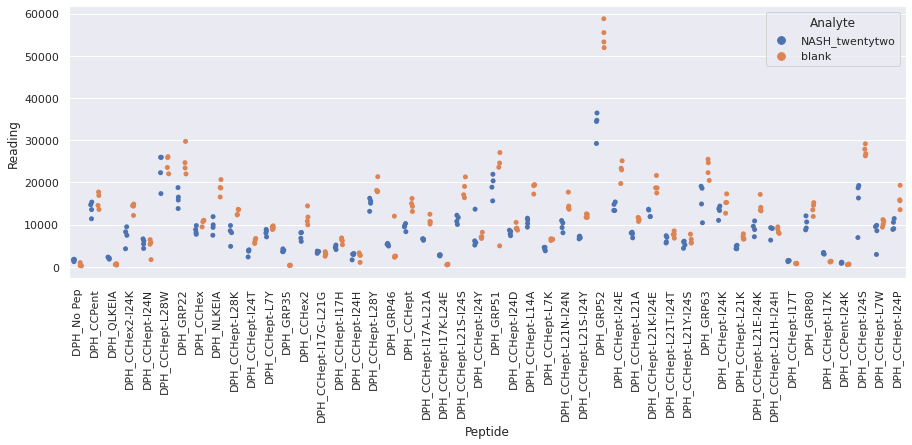

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

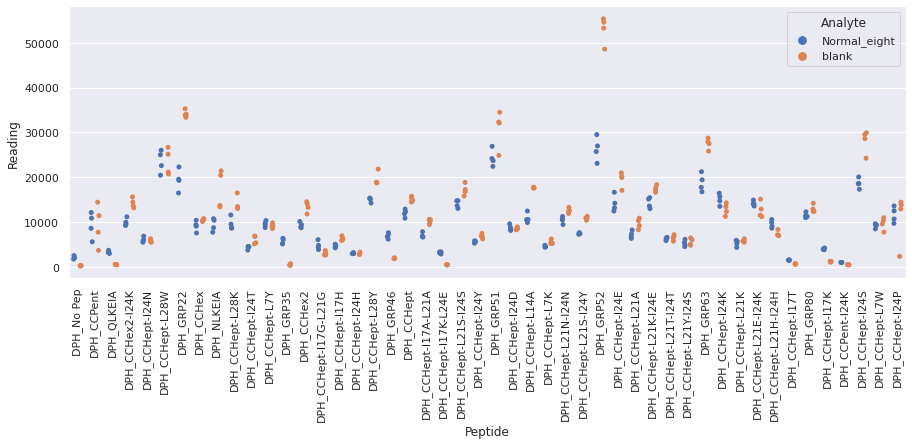

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

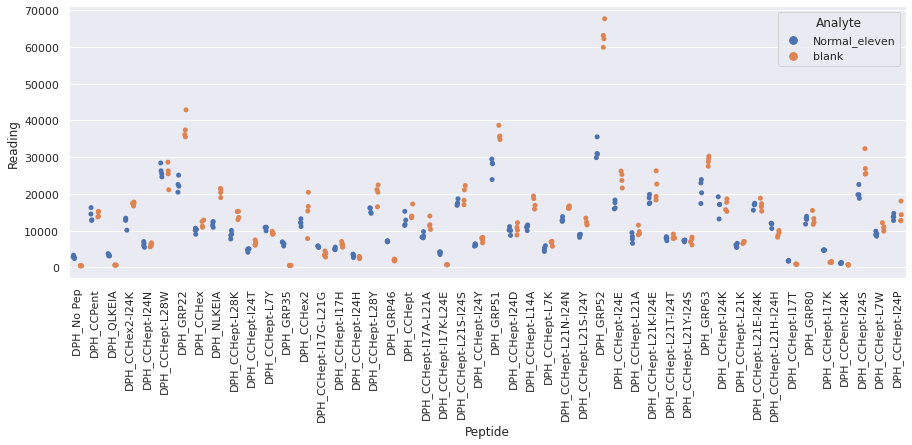

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

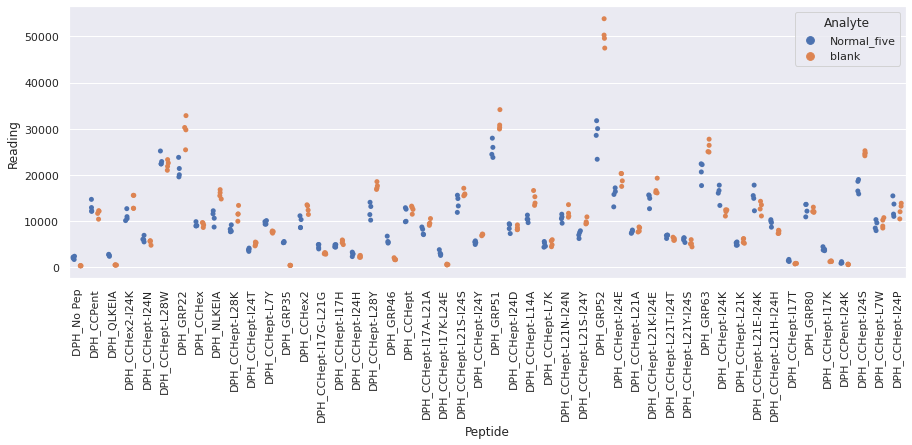

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_forty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

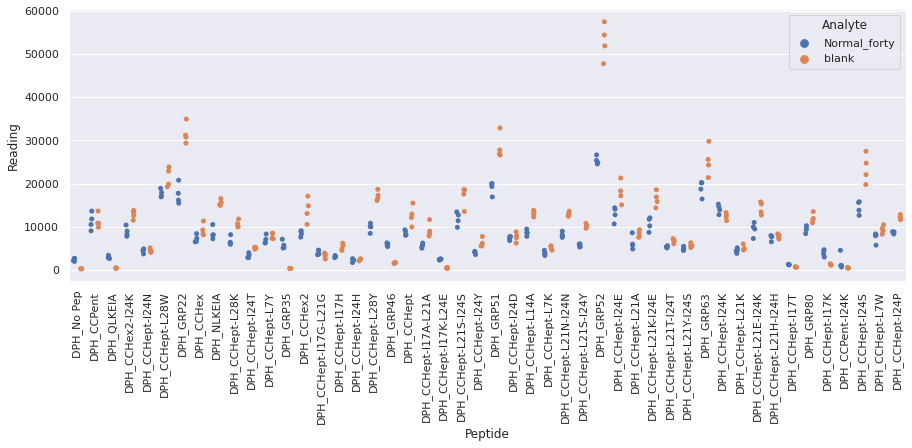

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_fortyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

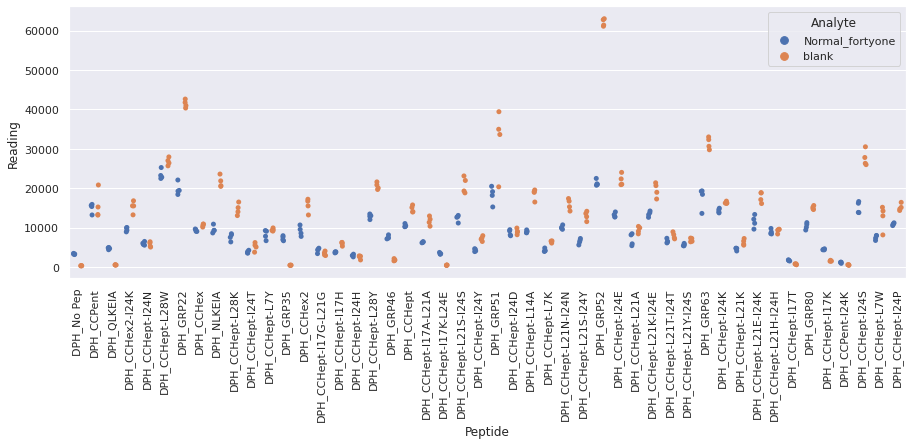

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_fortytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

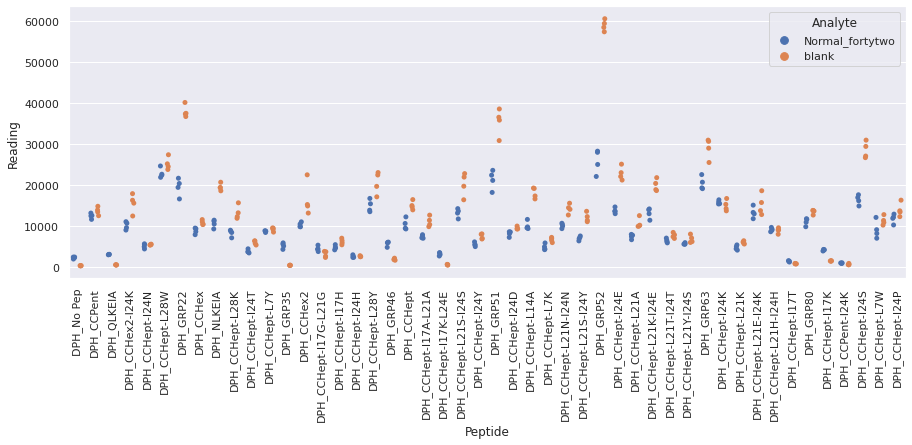

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

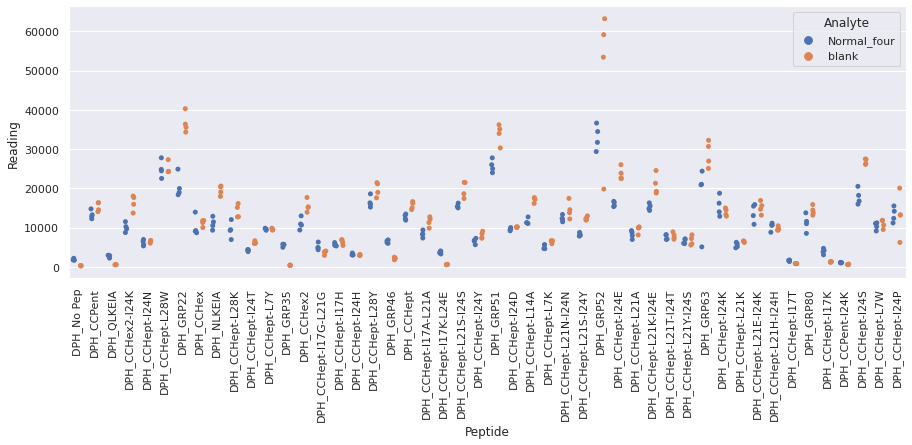

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

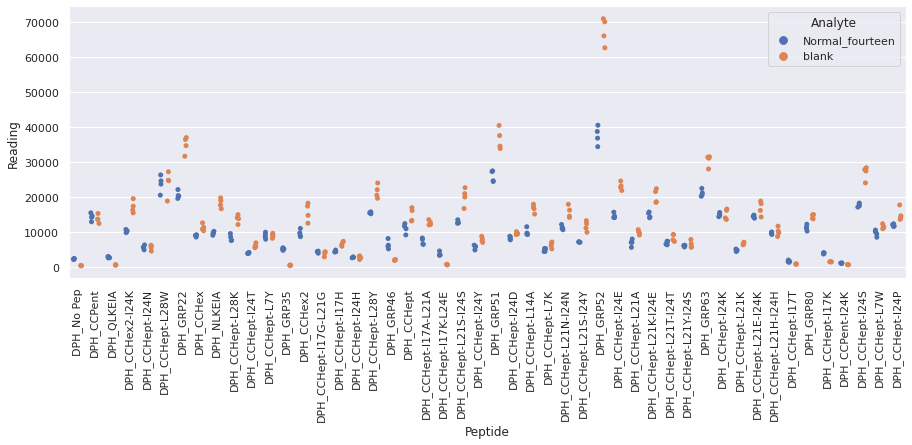

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

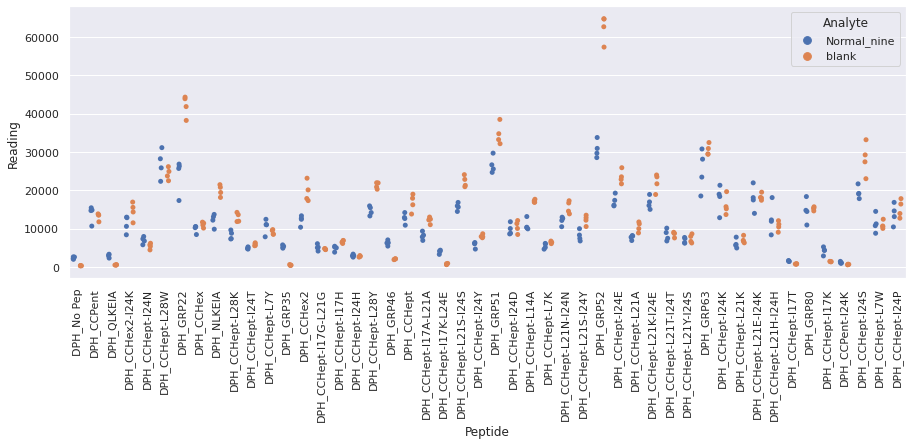

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

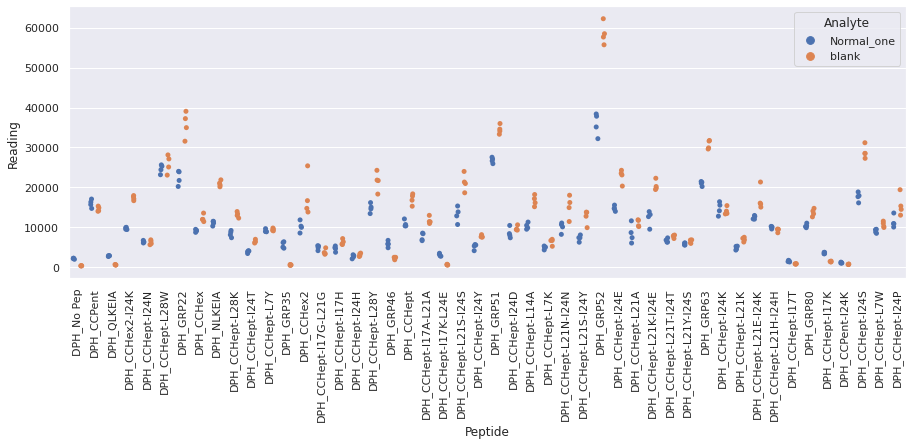

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

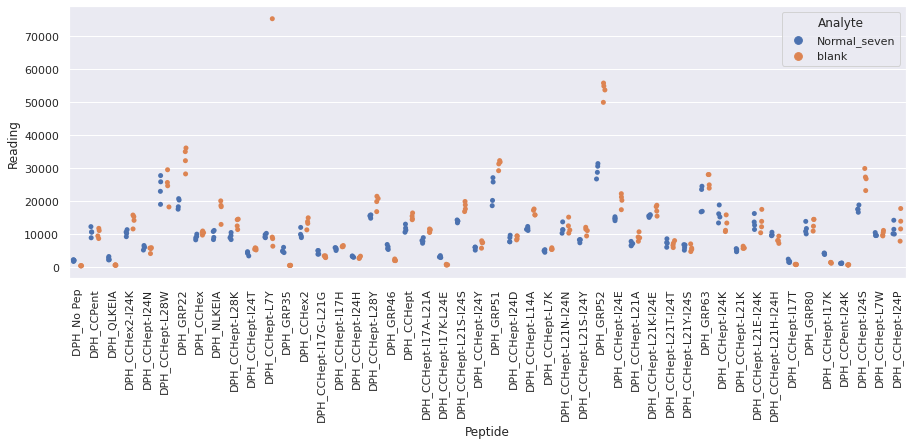

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

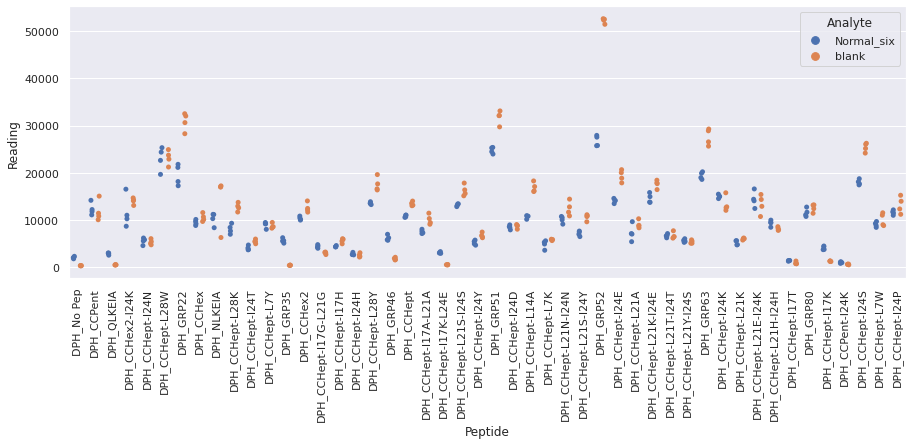

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

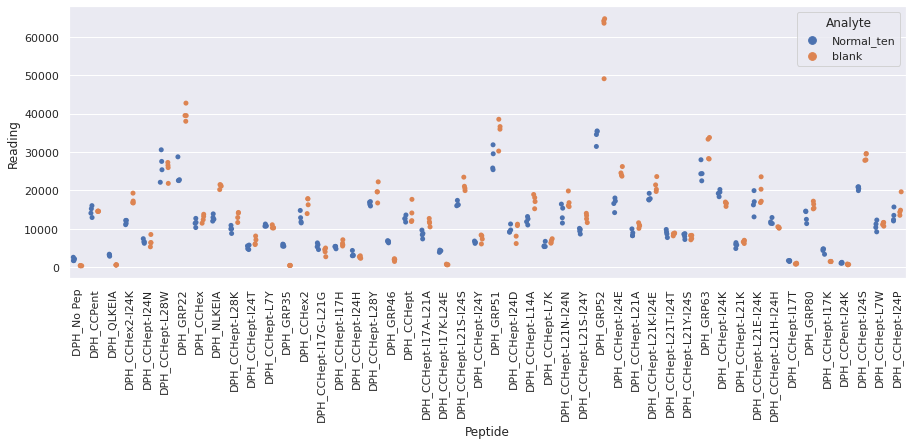

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

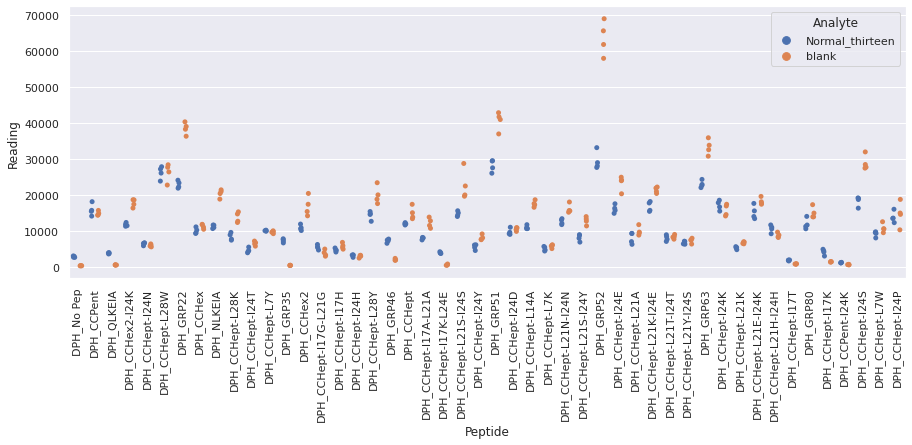

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirty_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

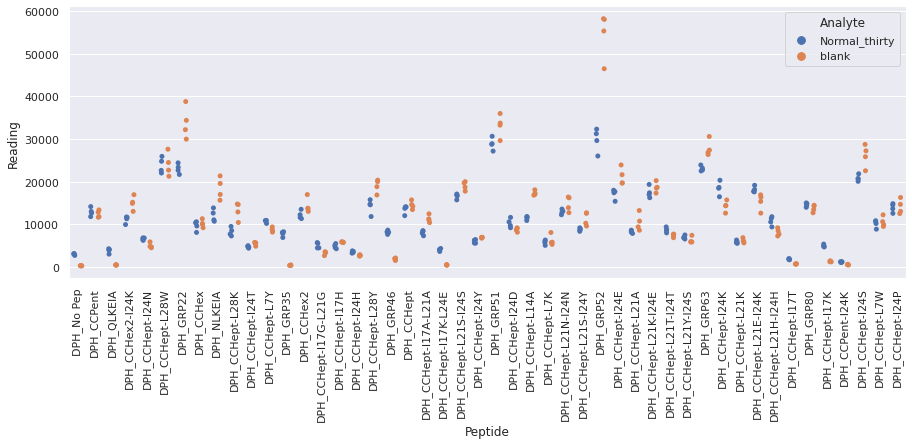

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtyeight_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

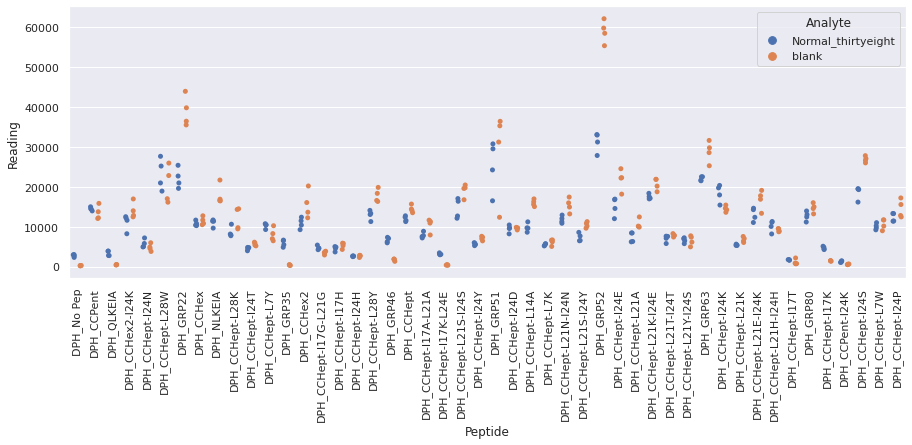

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

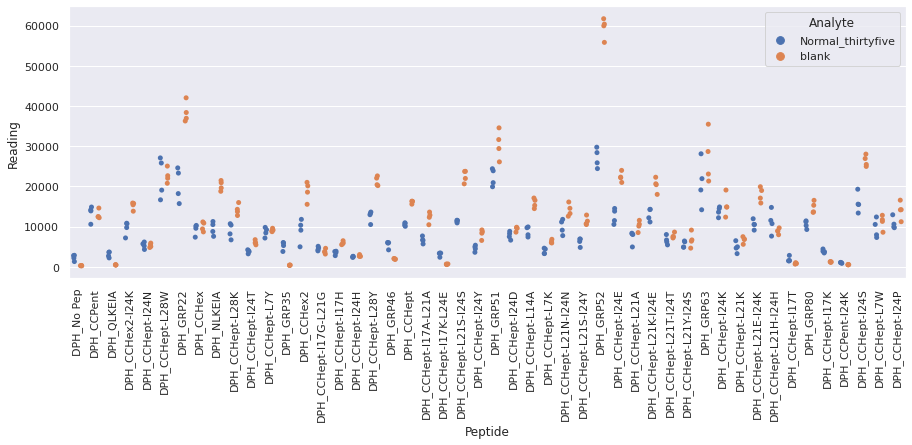

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

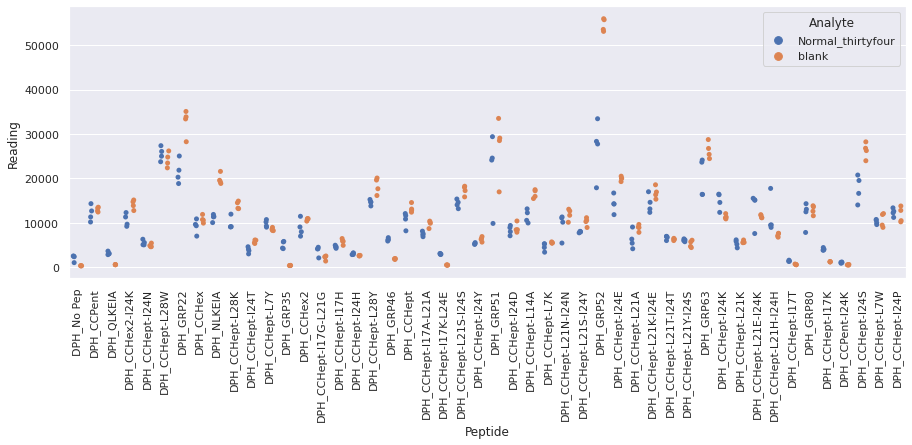

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtynine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

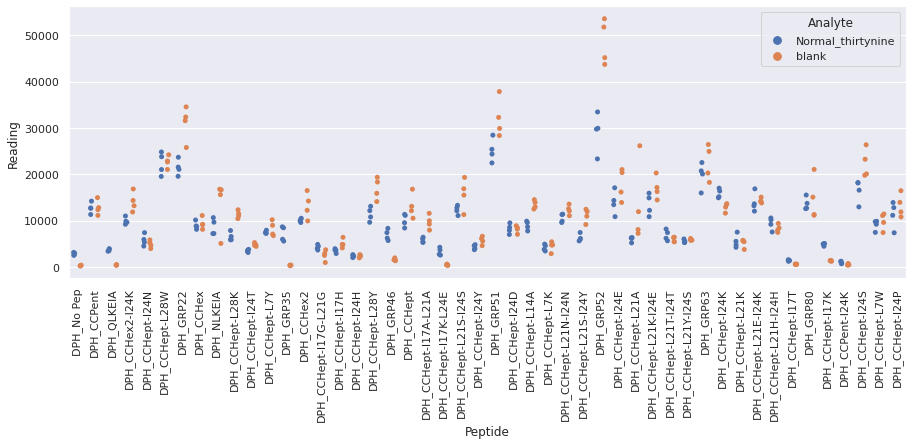

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtyone_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

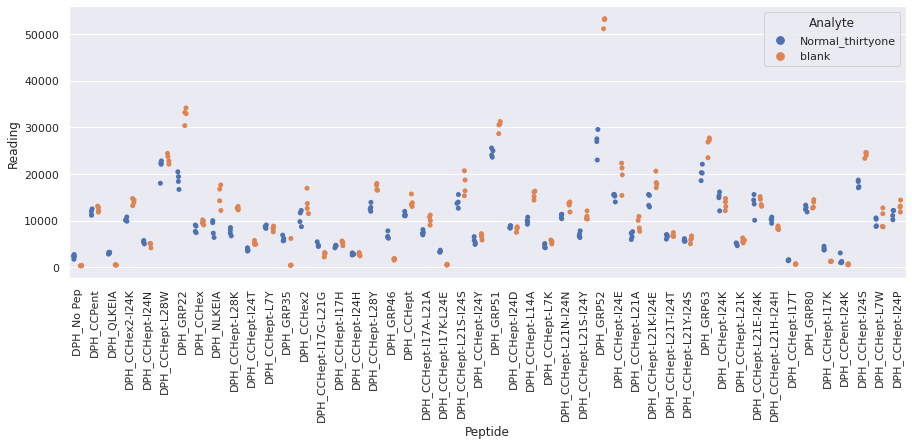

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtyseven_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

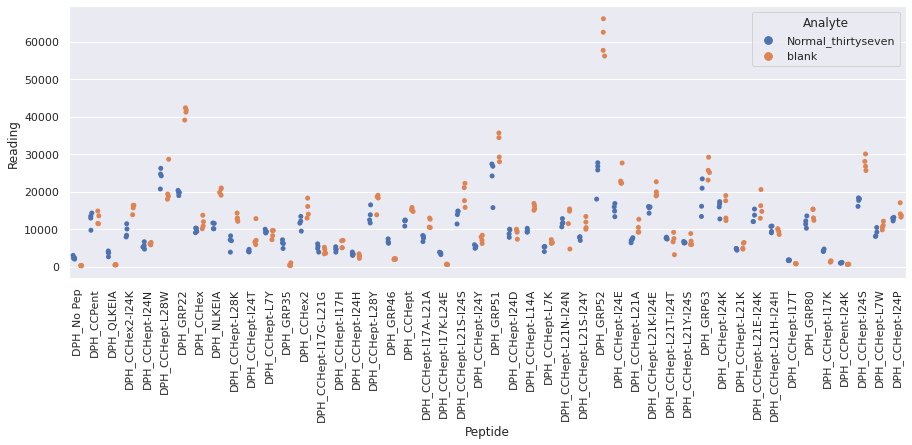

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtysix_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

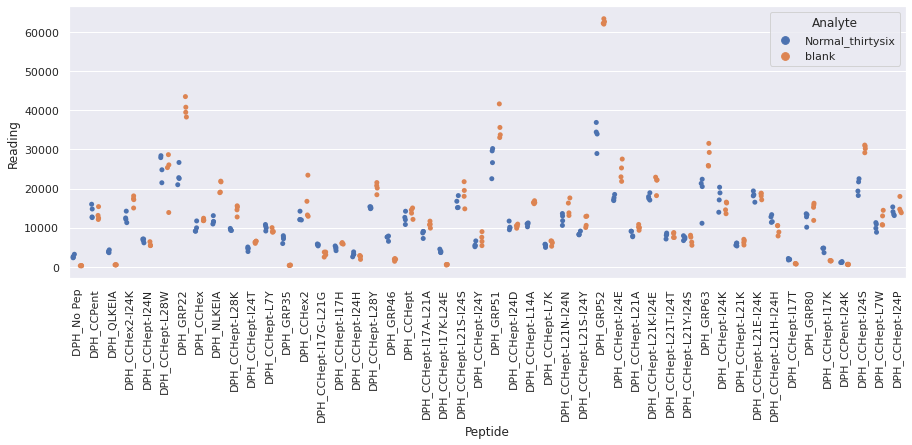

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtythree_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

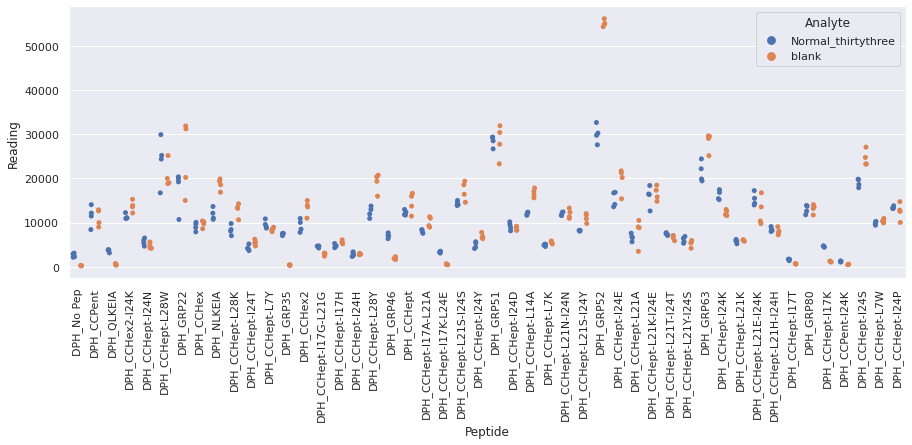

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_thirtytwo_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

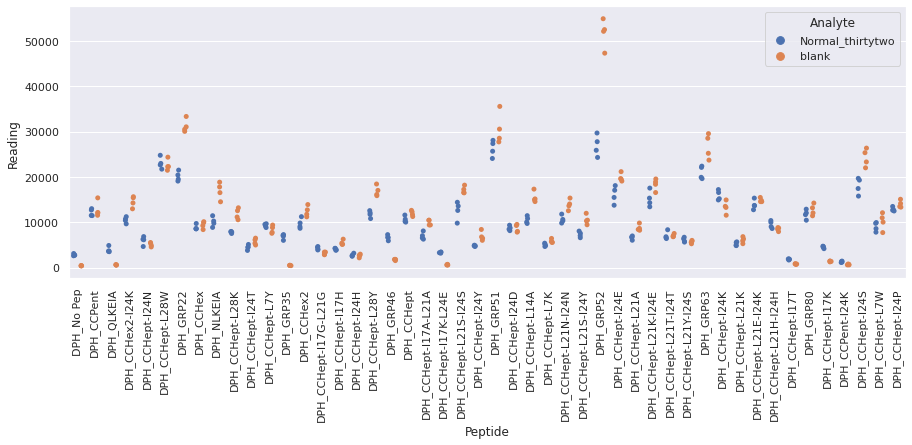

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

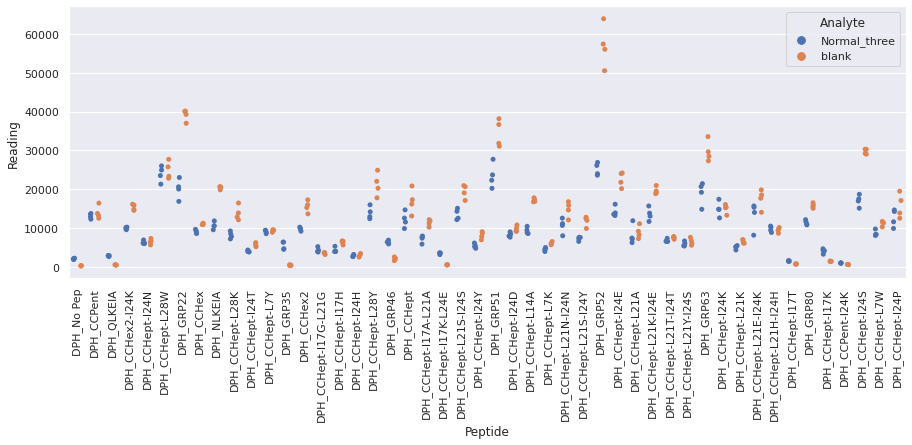

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

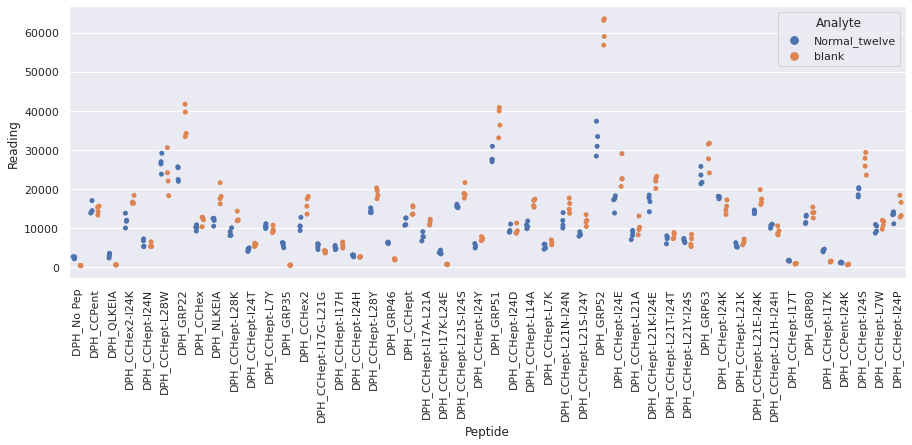

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_twentynine_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

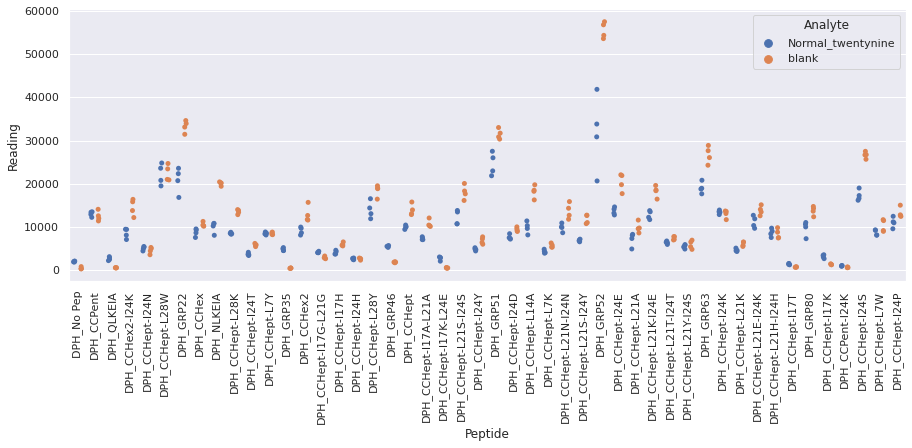

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_1.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_1 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

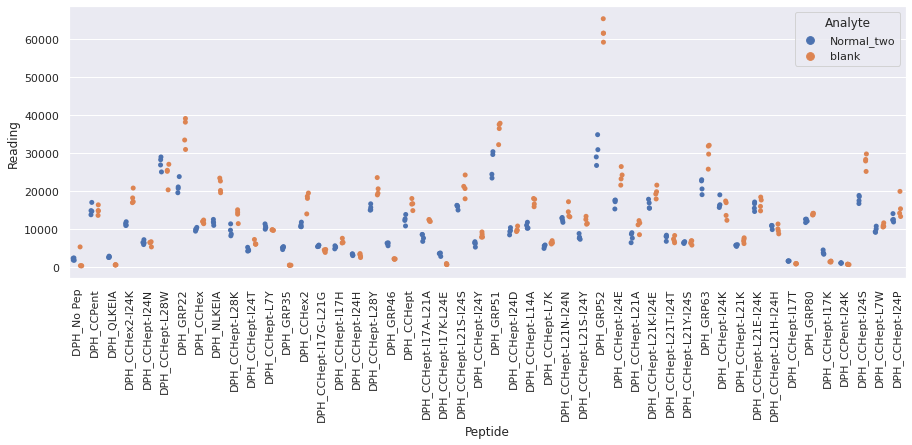

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

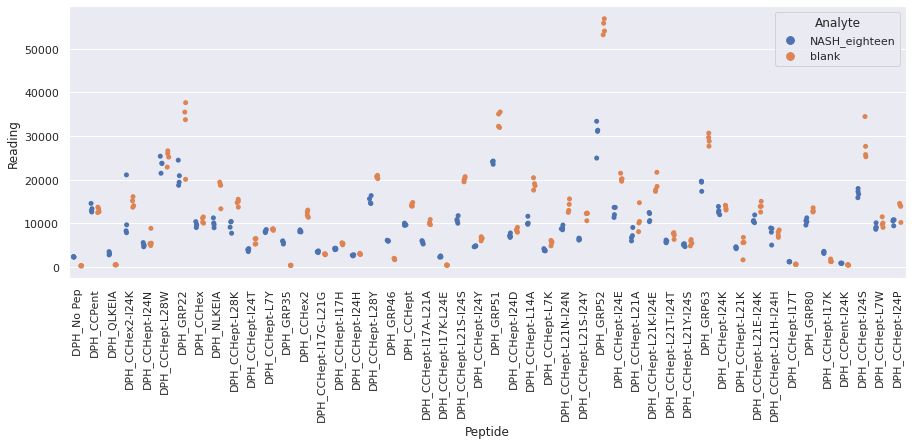

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

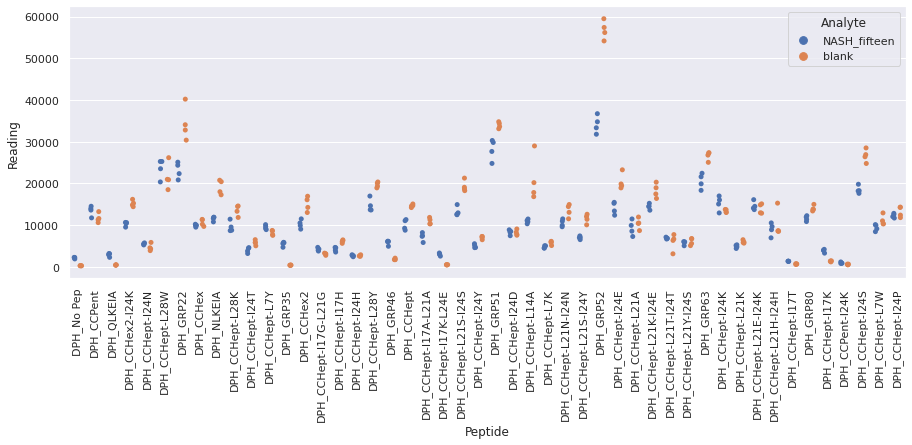

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

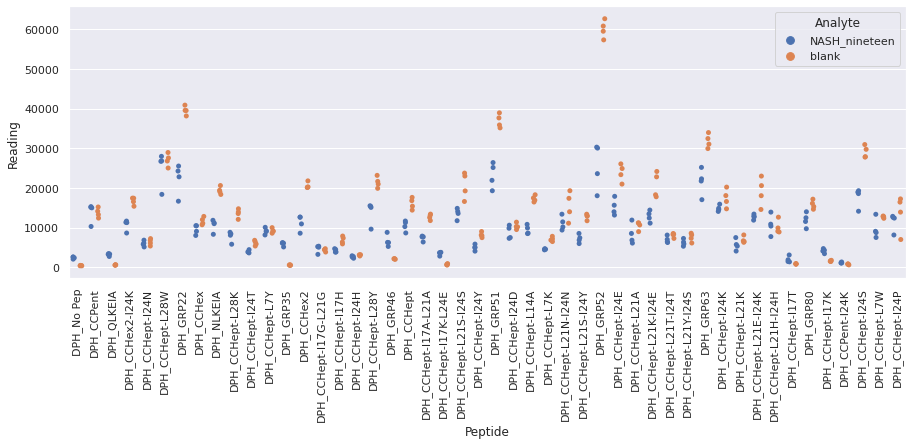

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

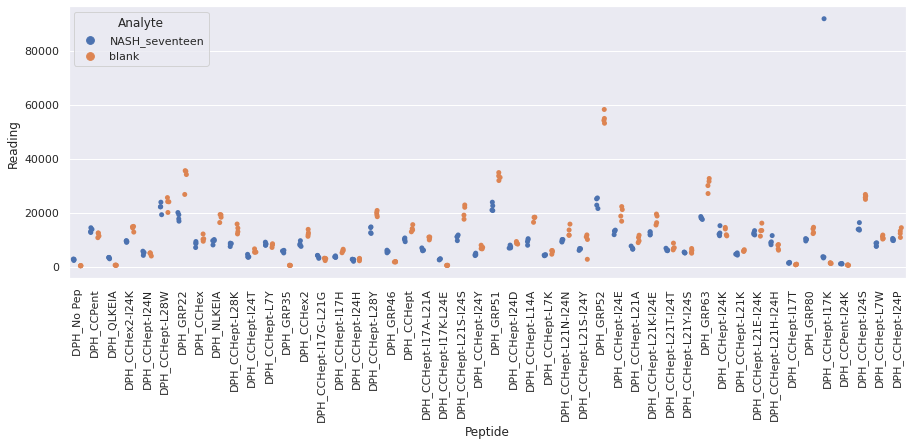

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

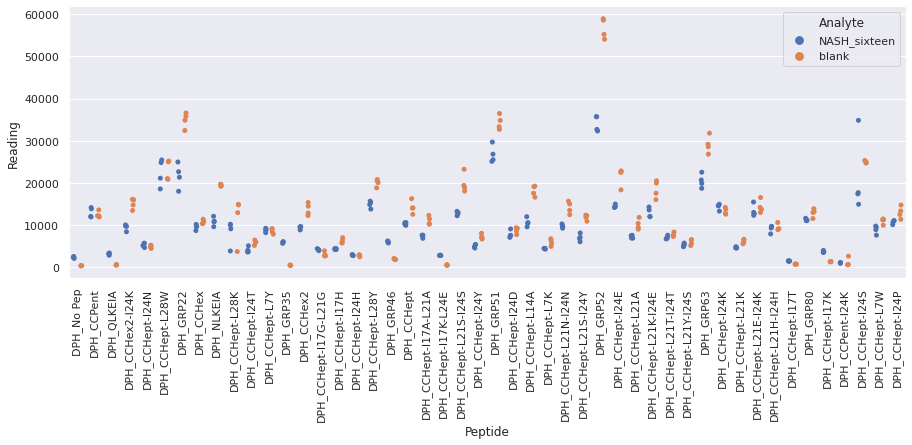

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

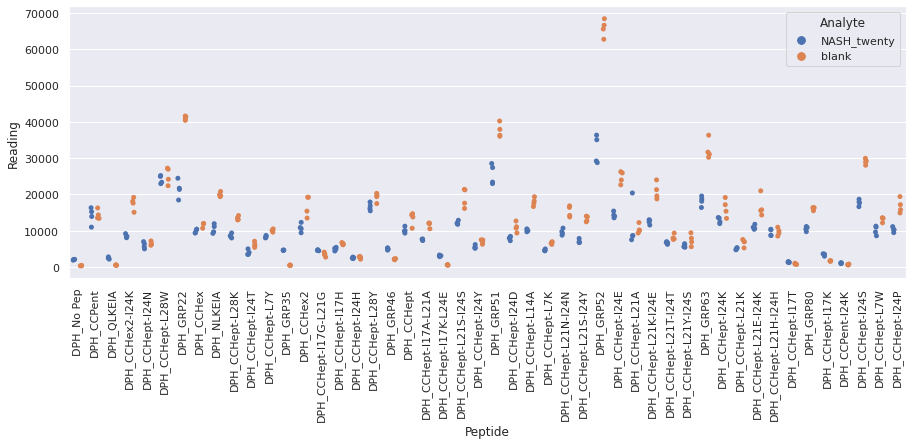

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

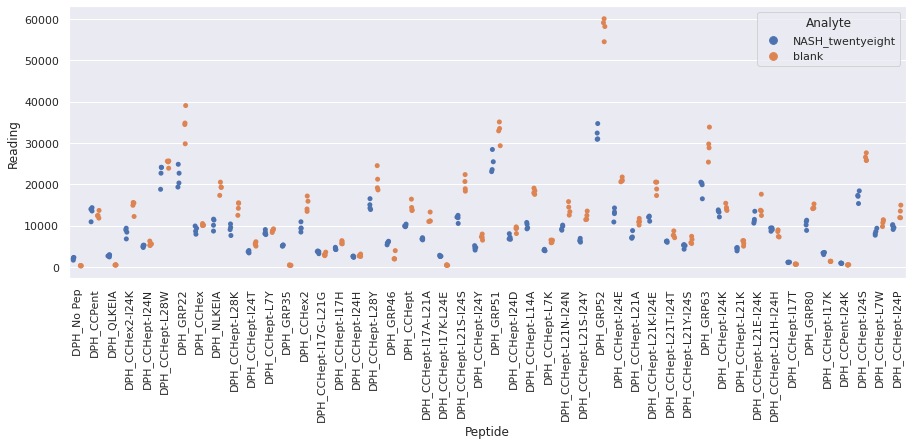

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

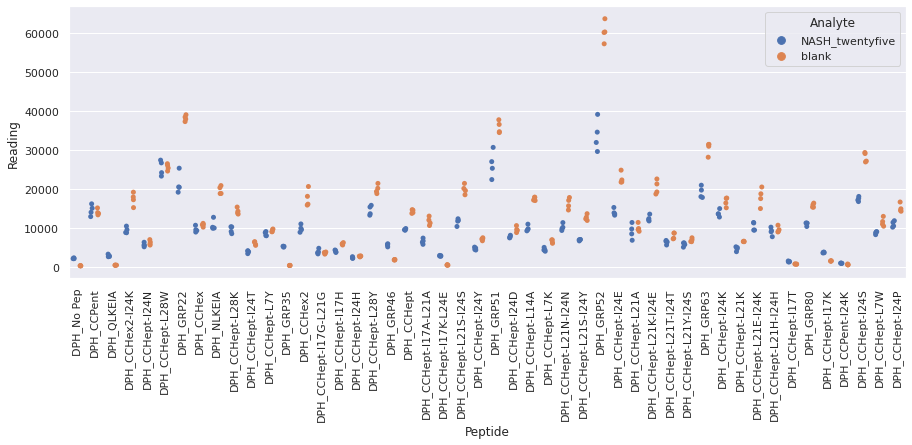

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

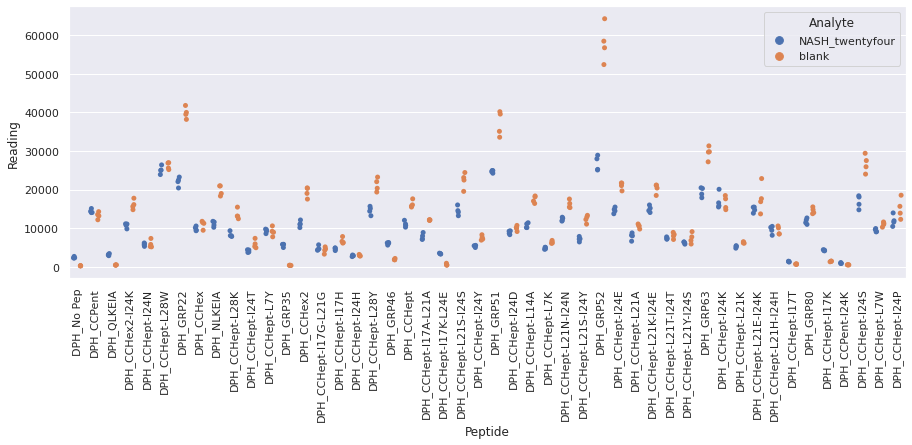

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

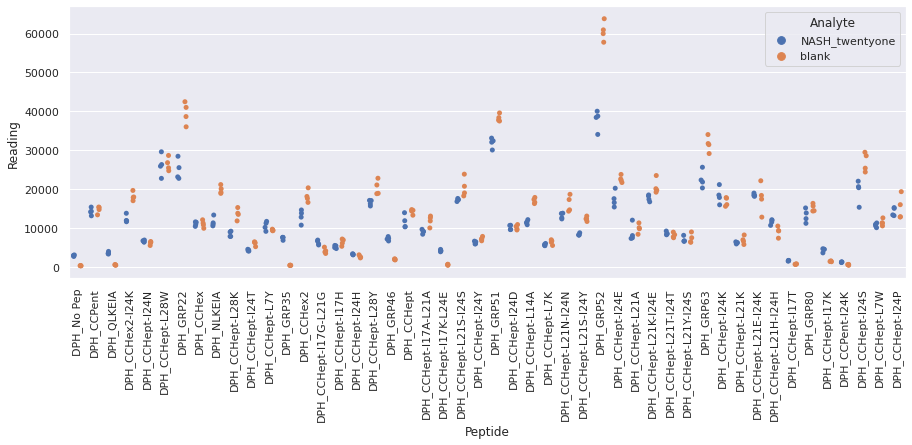

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

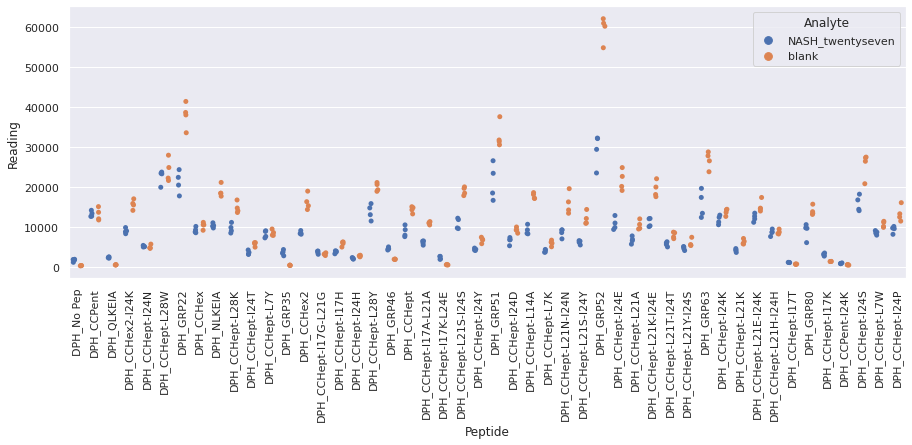

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

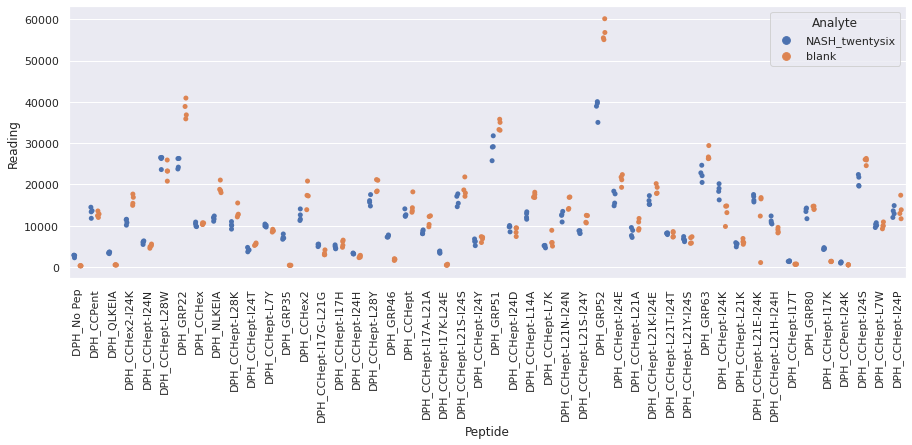

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

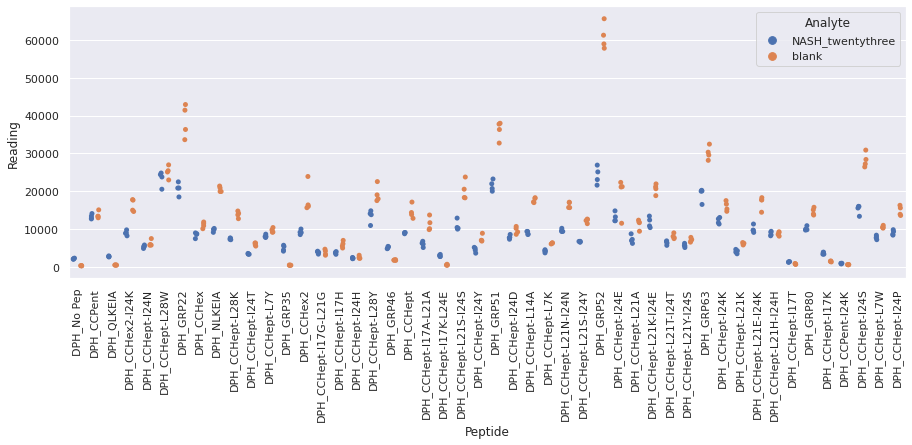

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_2.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

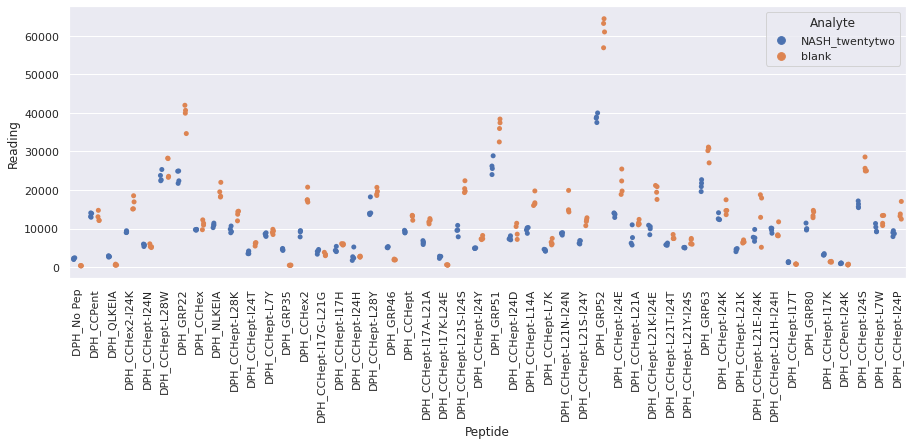

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

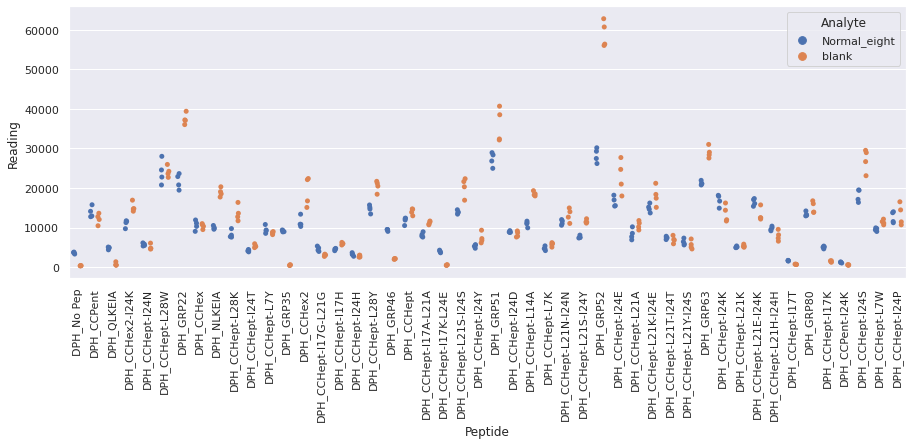

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

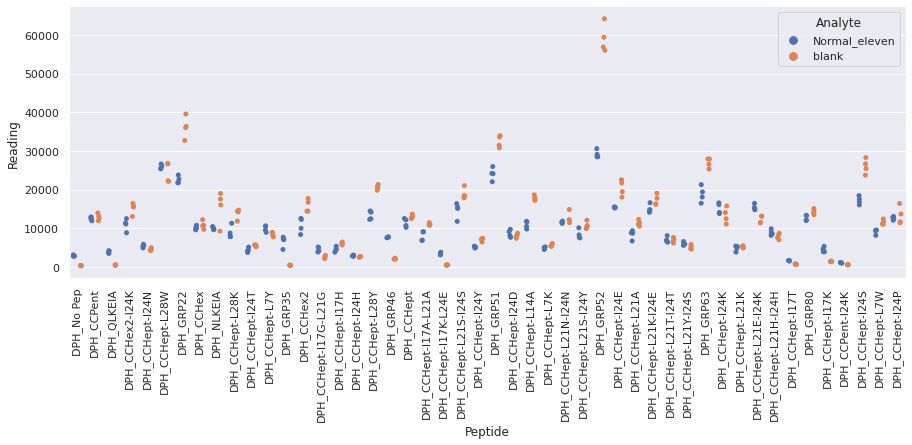

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

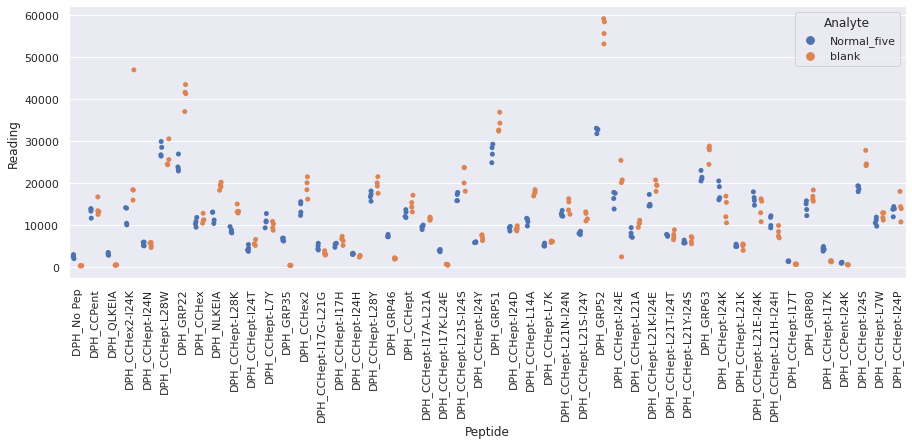

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_forty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

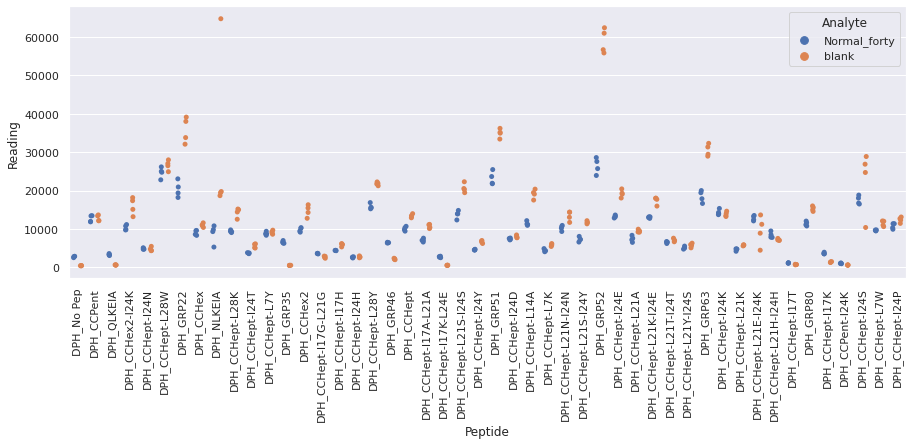

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_fortyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

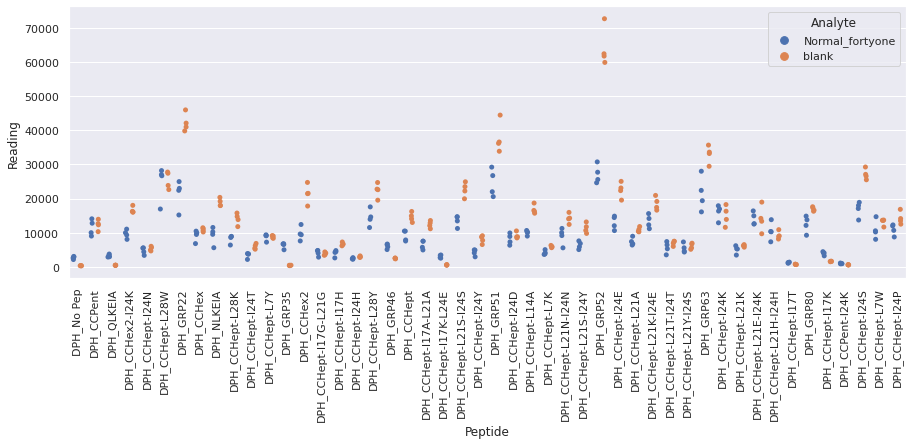

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_fortytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

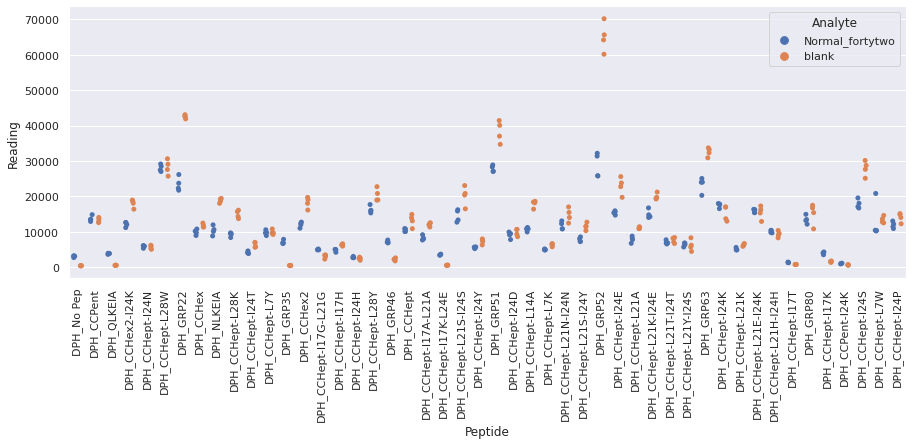

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

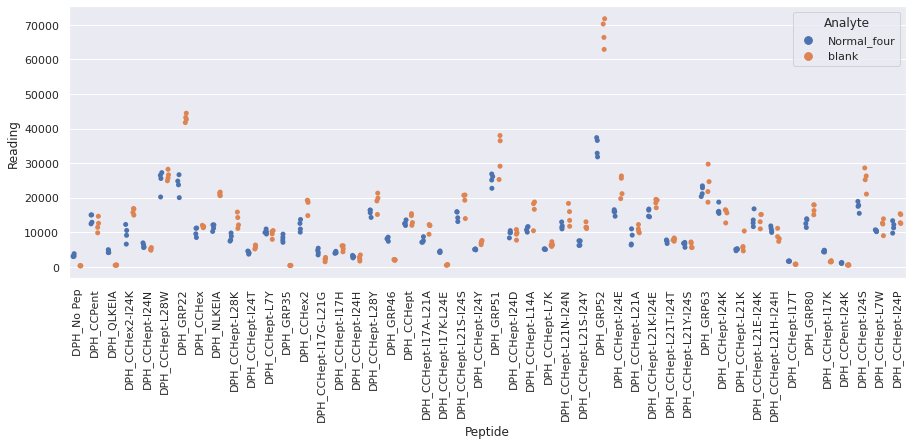

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

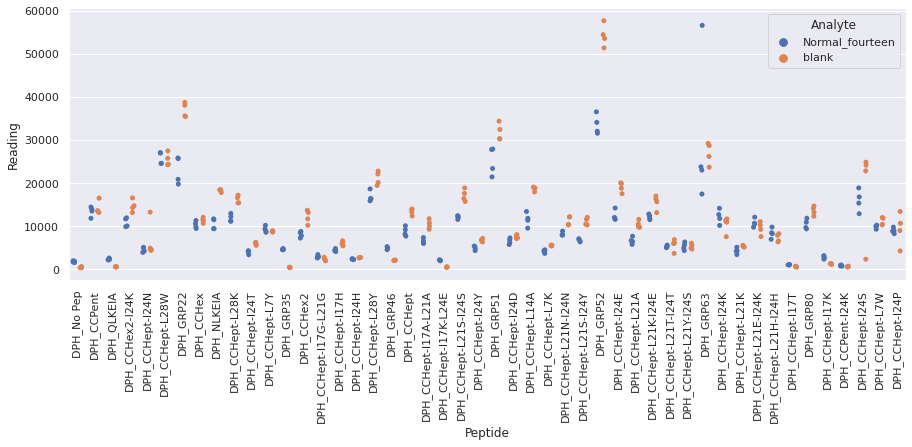

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

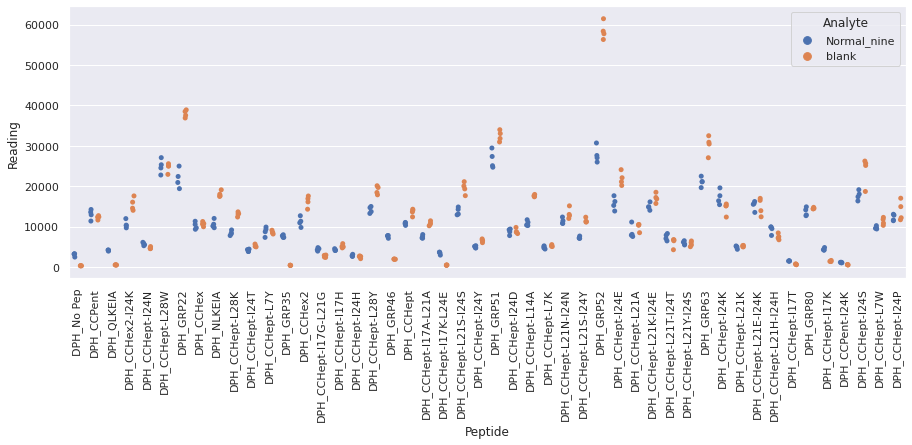

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

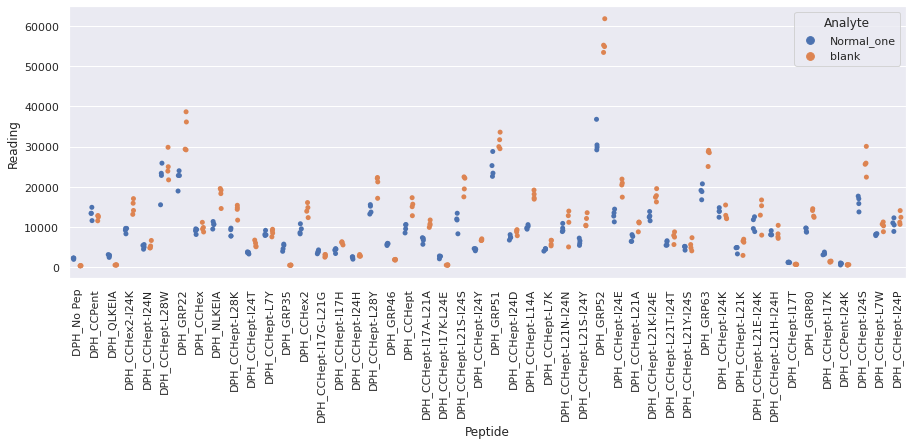

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

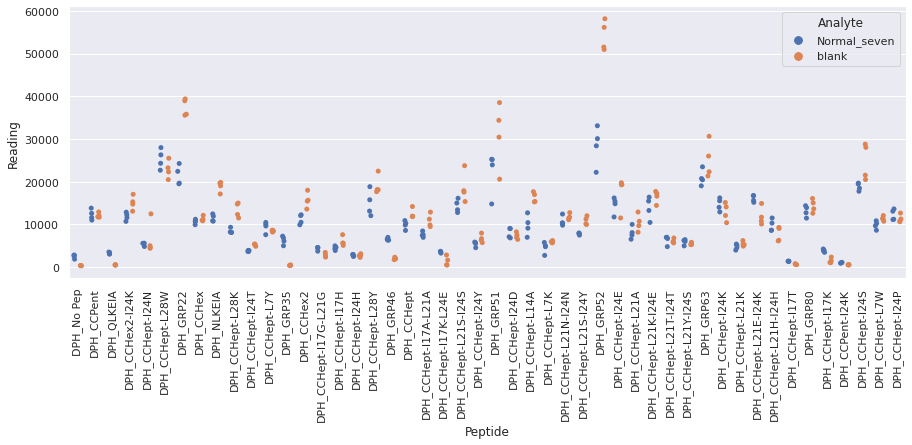

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

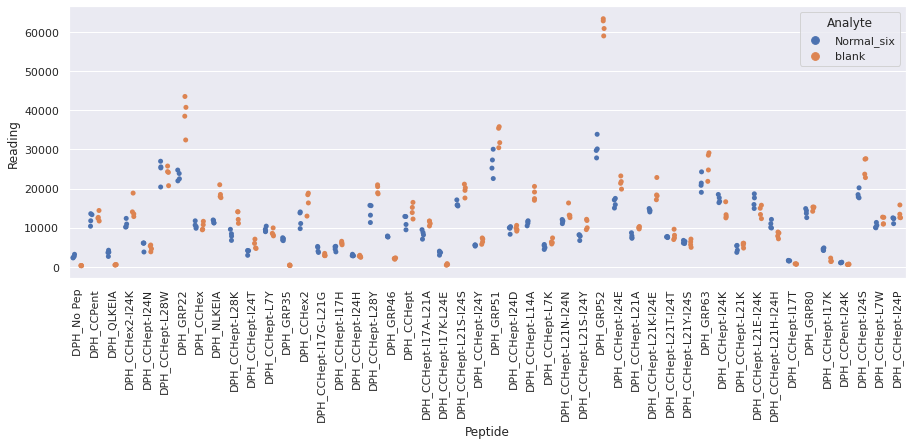

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

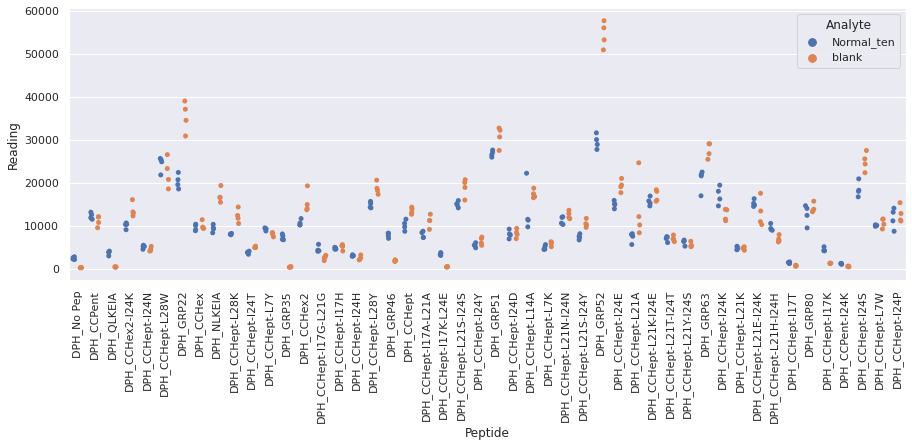

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

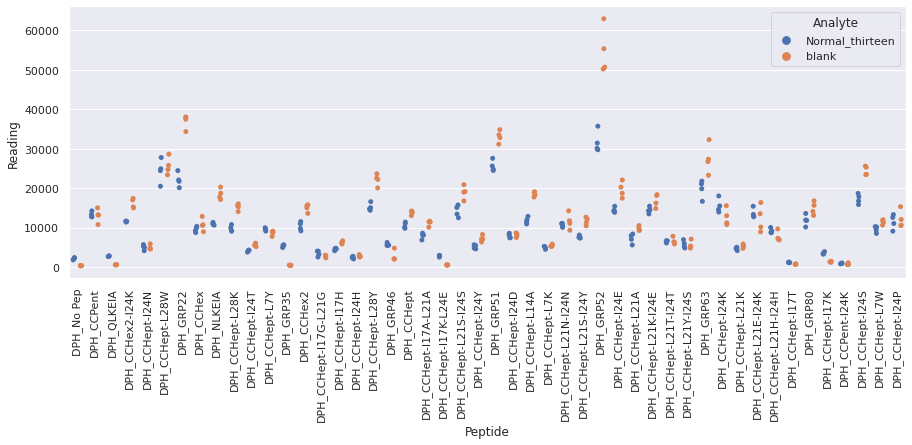

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirty_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

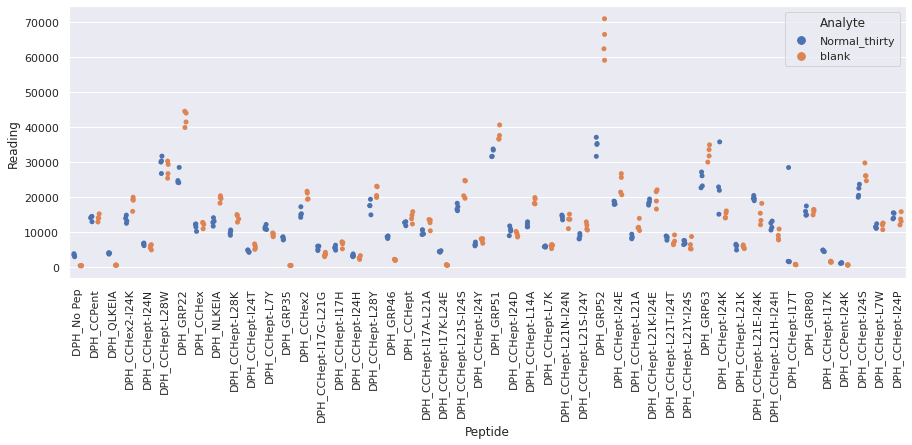

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtyeight_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

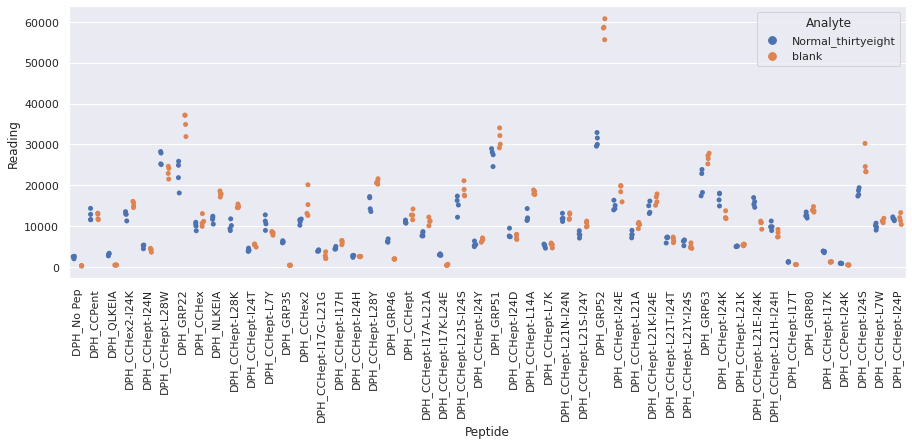

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

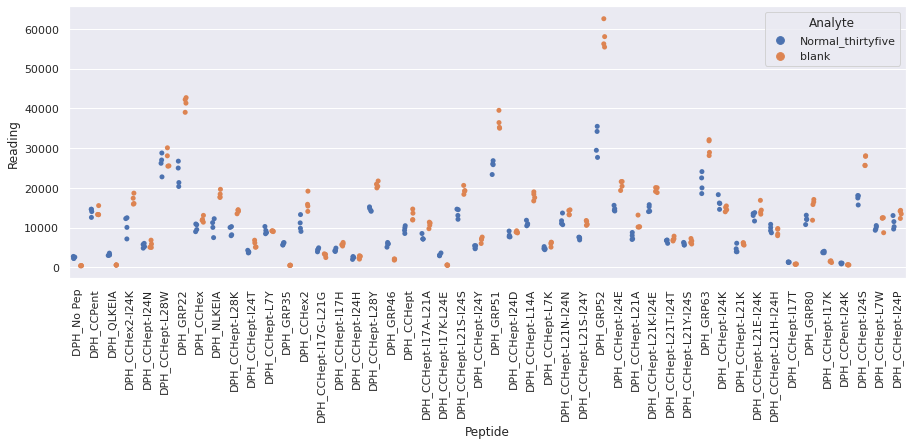

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

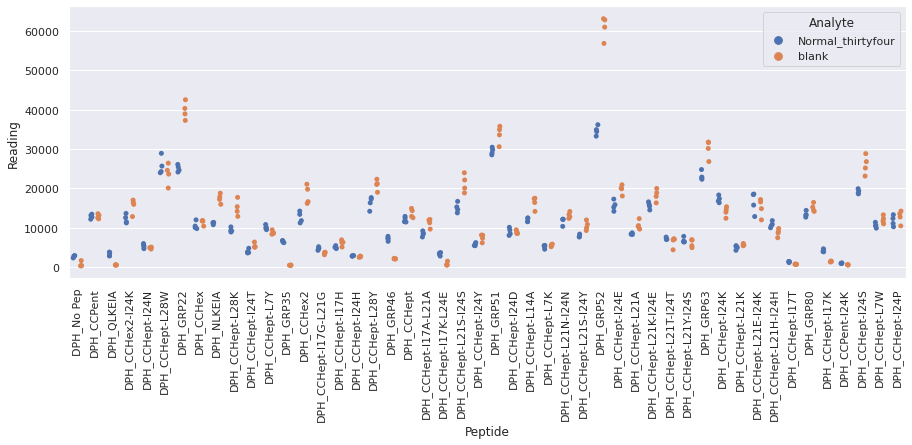

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtynine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

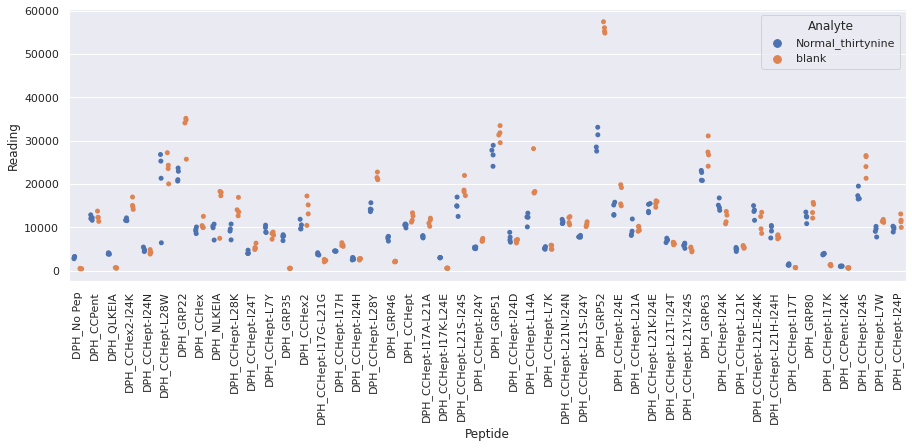

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtyone_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

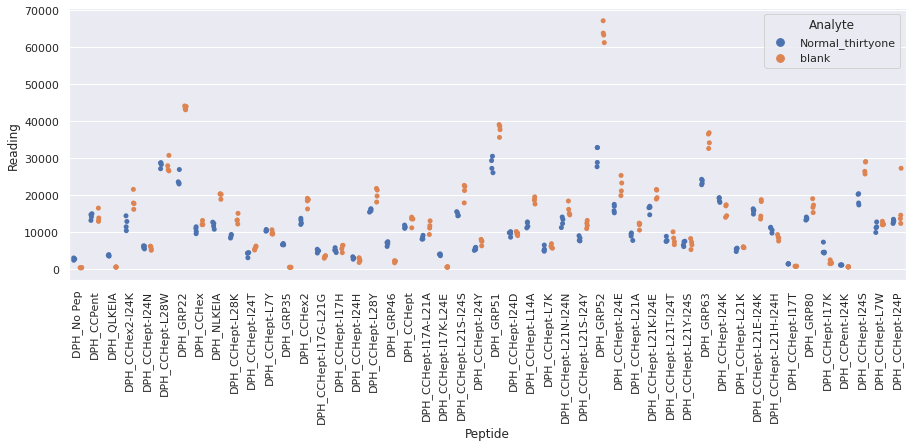

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtyseven_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

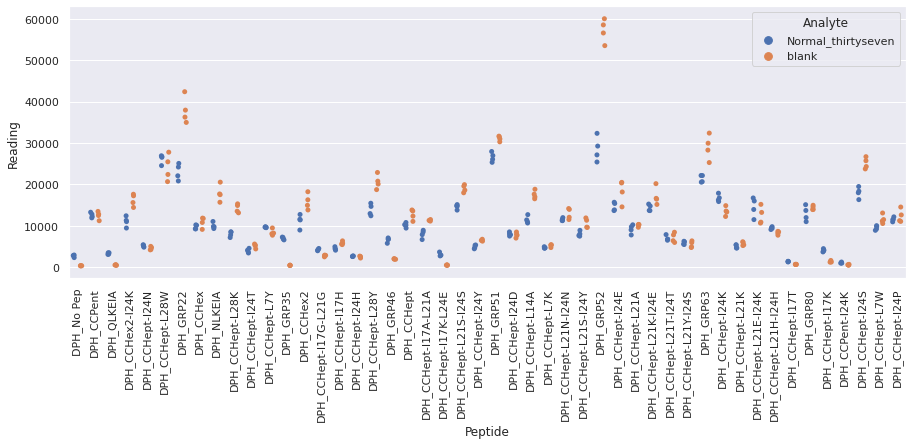

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtysix_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

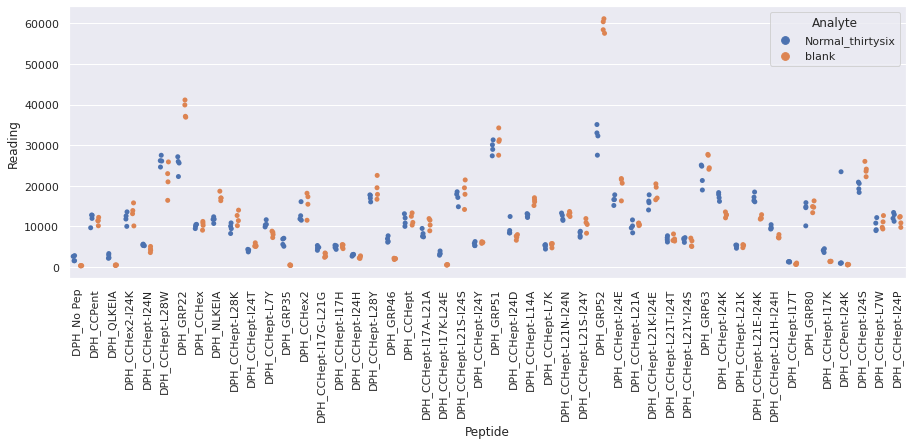

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtythree_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

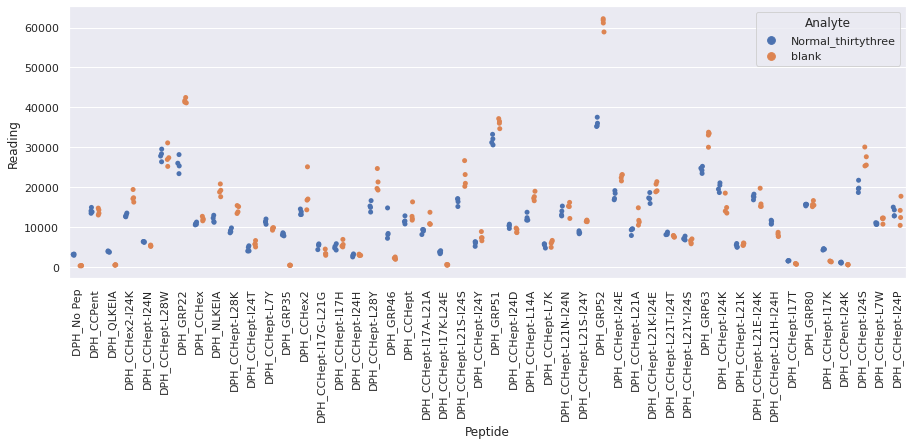

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_thirtytwo_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

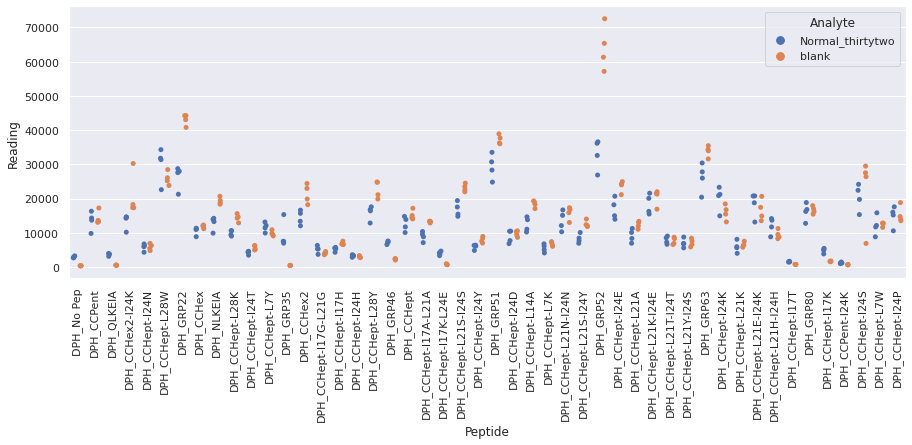

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

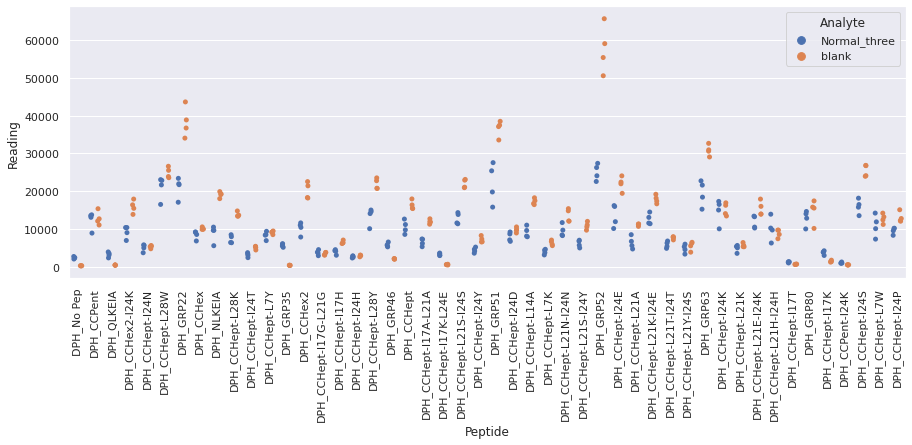

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

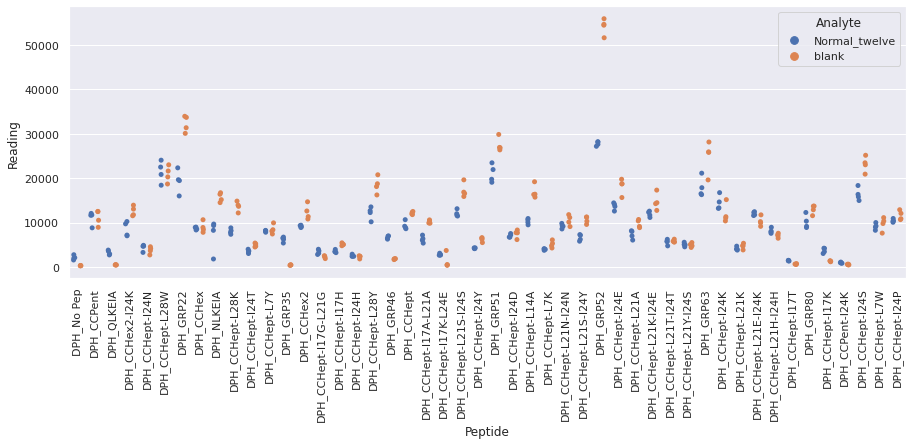

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_twentynine_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

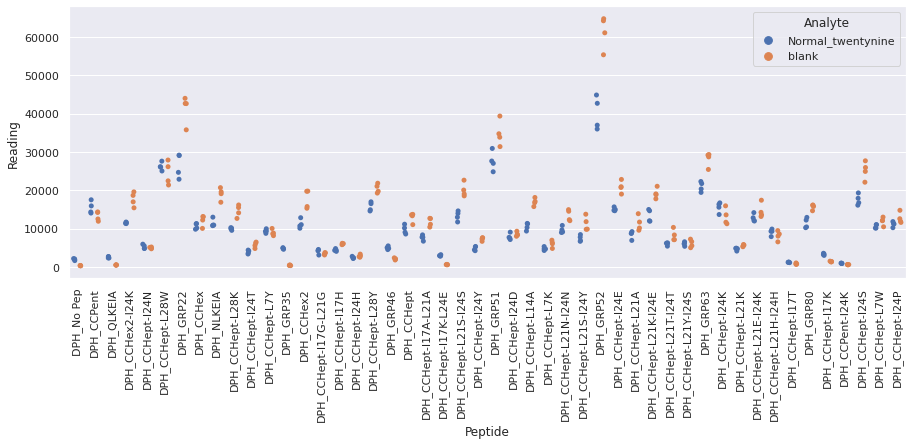

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_2.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_2 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

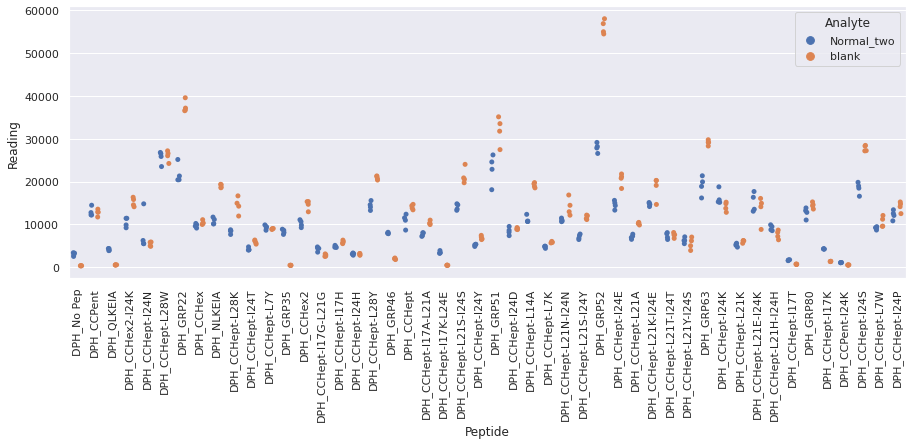

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

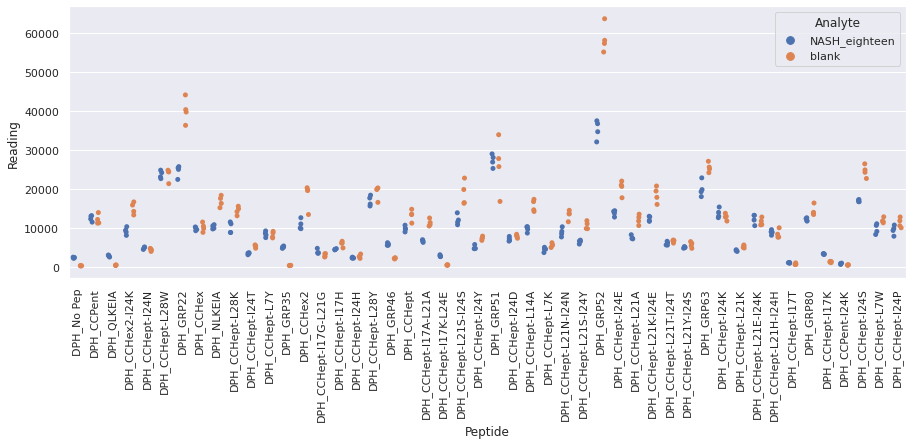

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

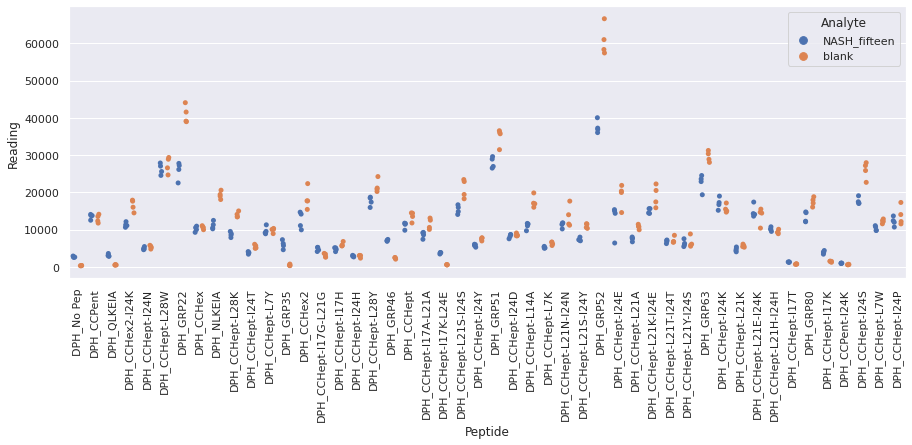

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

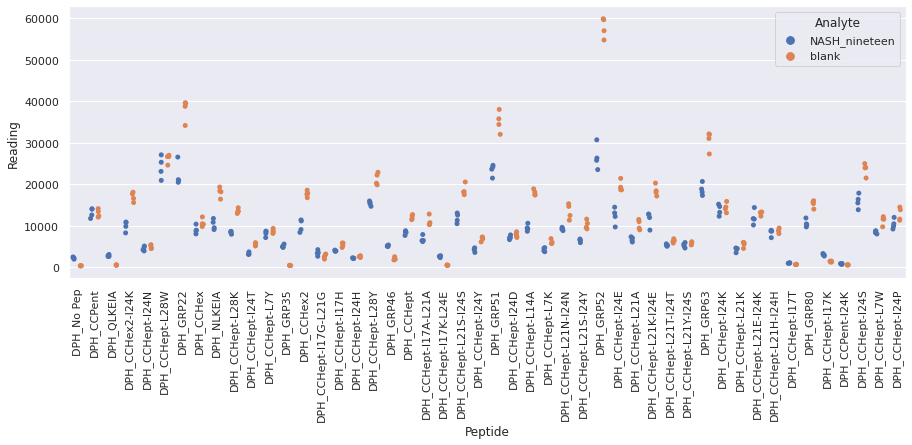

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

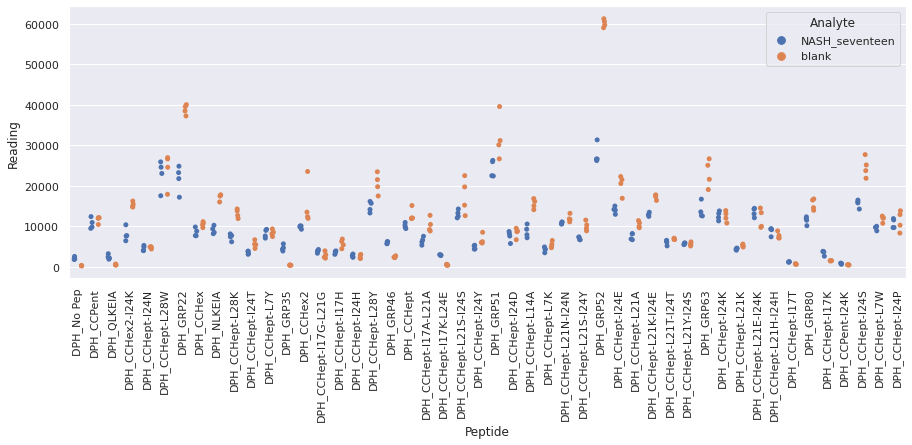

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

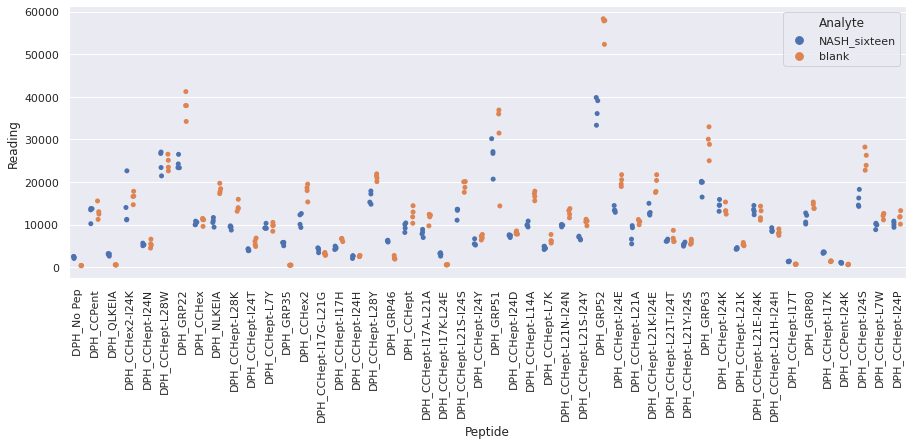

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

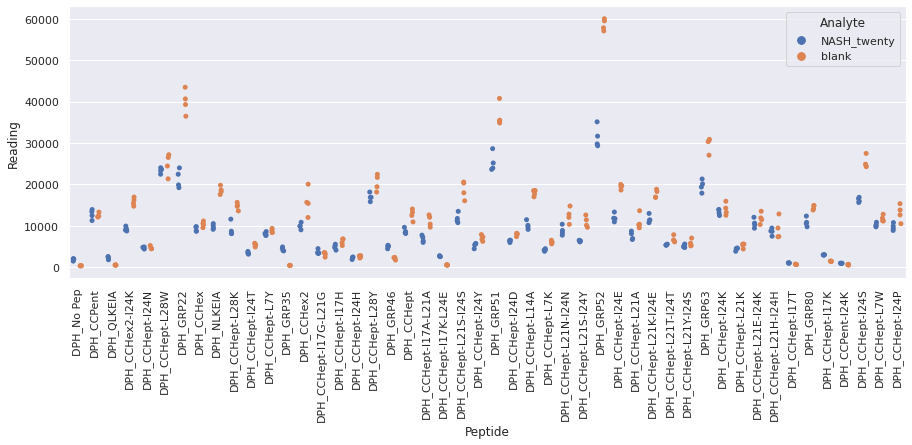

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

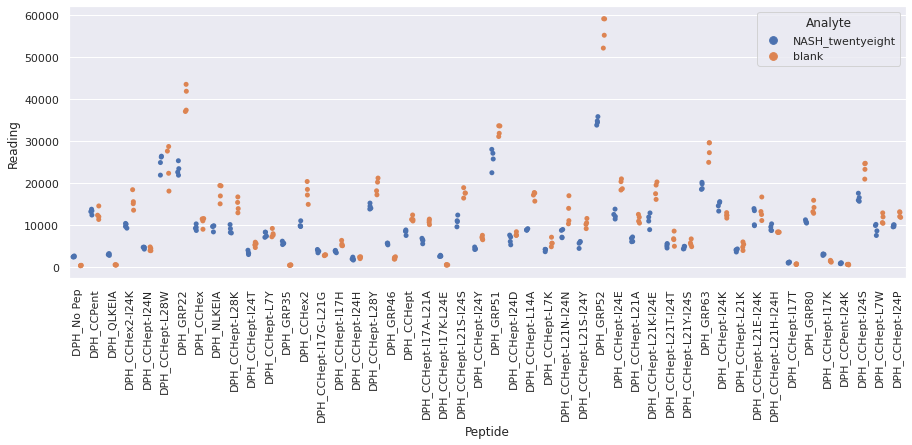

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

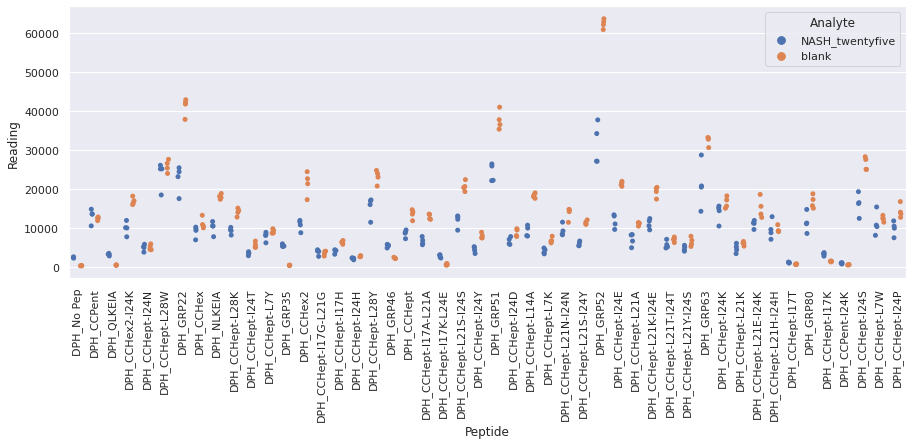

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

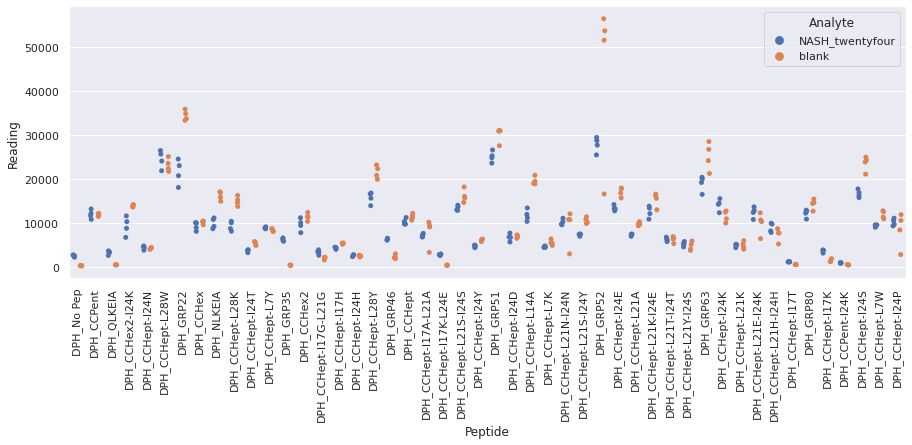

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

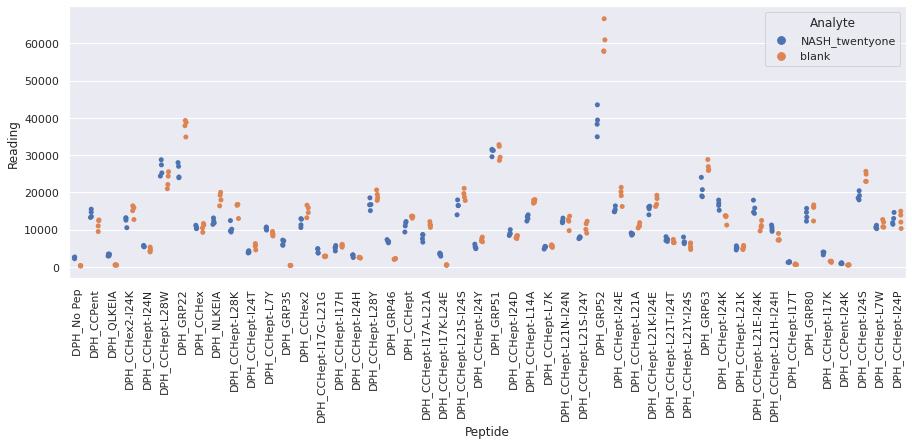

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

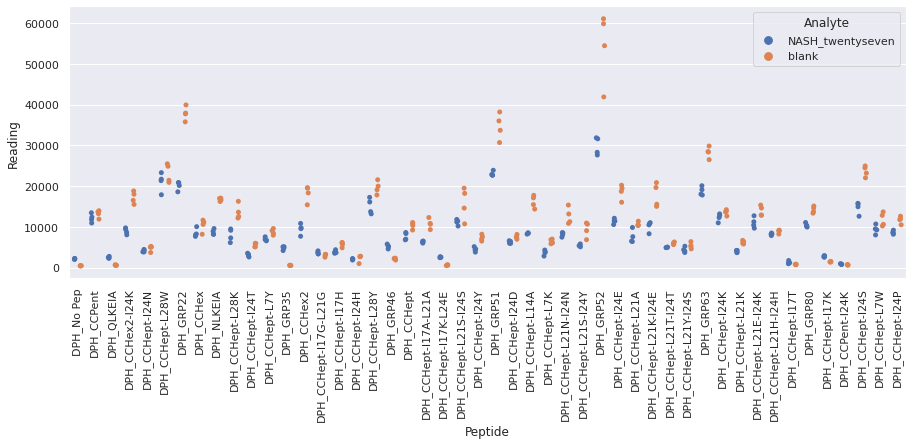

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

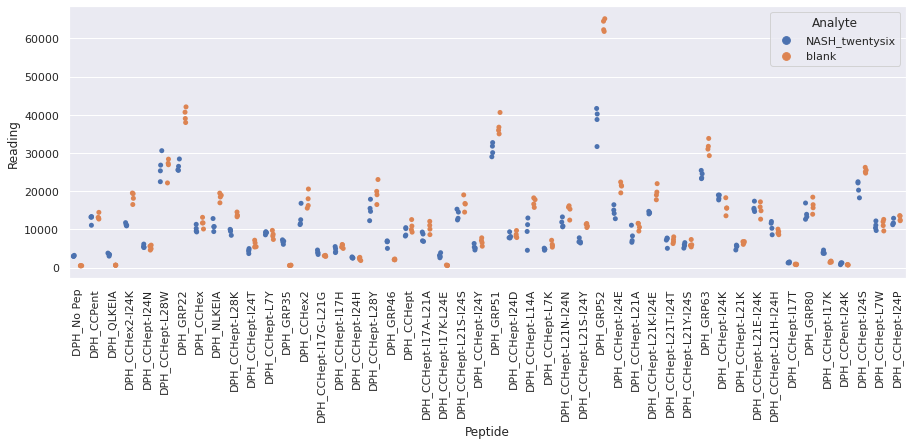

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

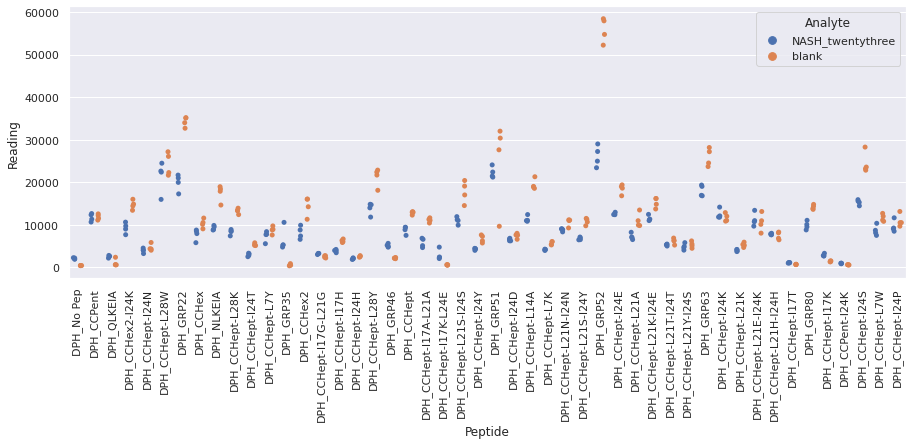

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_3.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

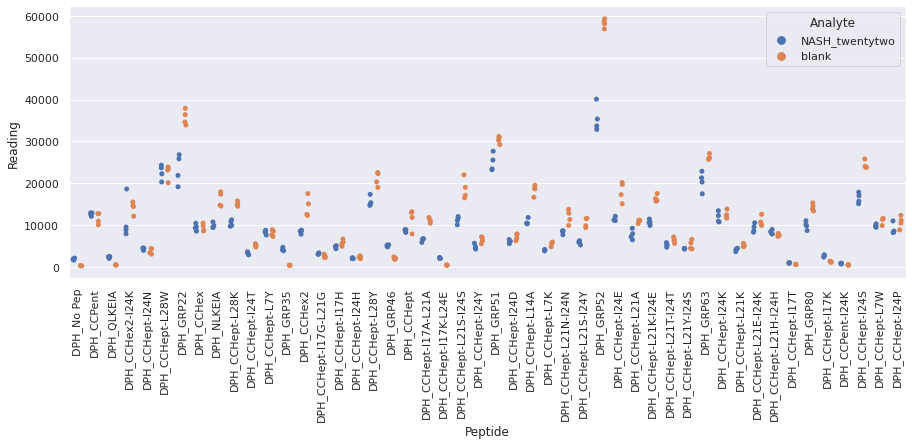

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

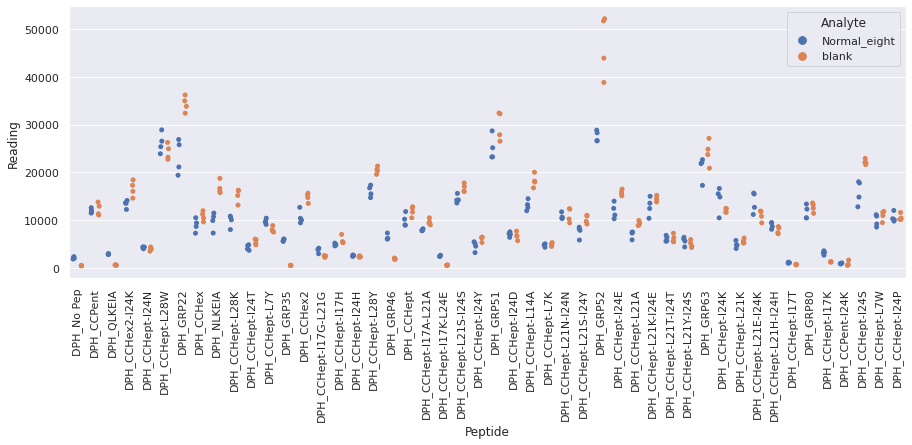

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

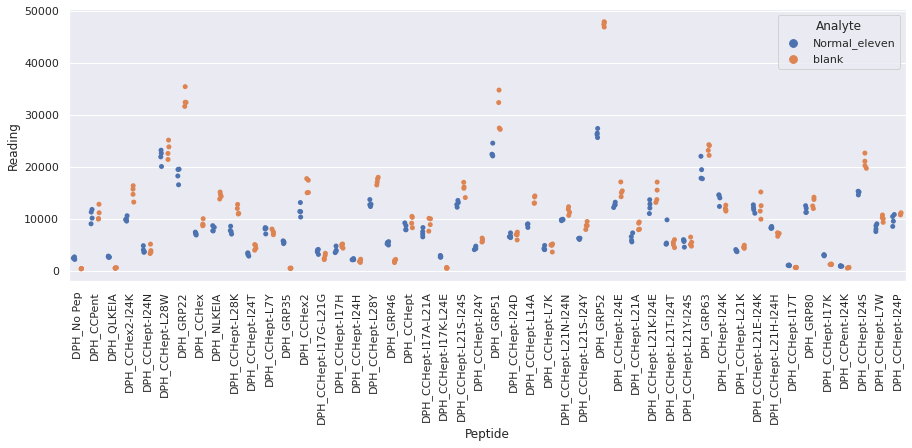

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

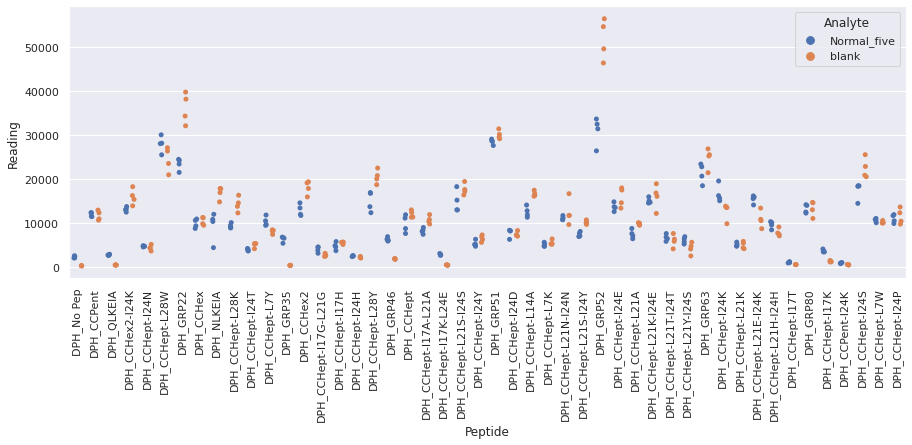

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_forty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

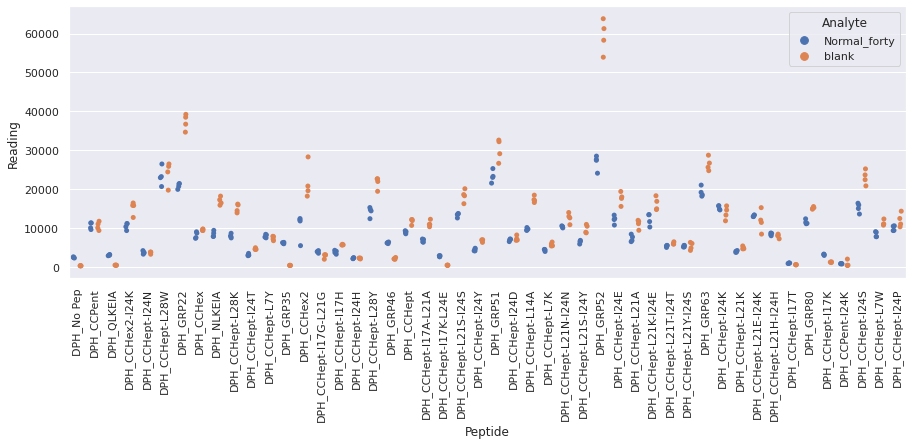

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_fortyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

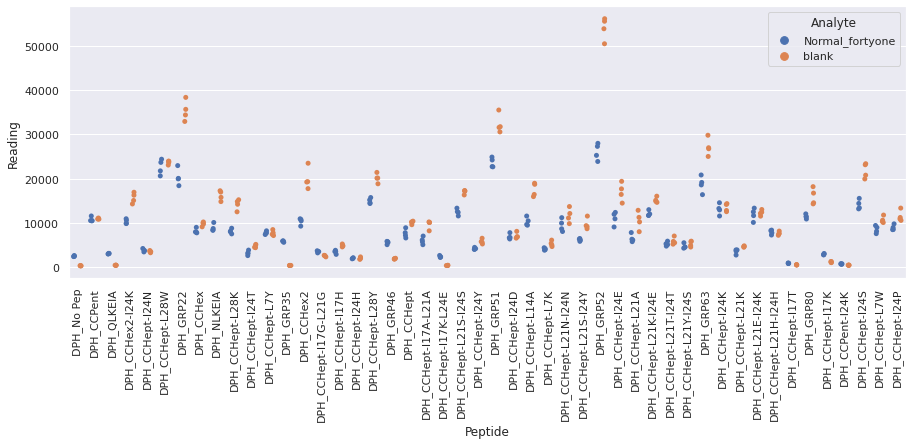

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_fortytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

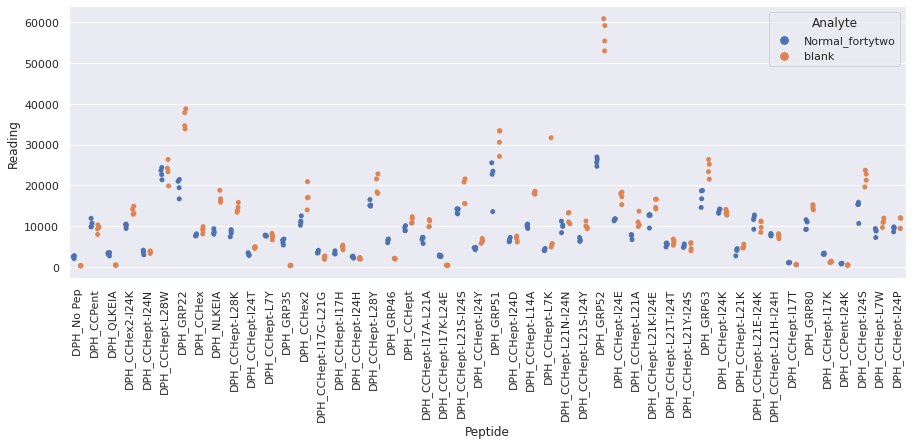

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

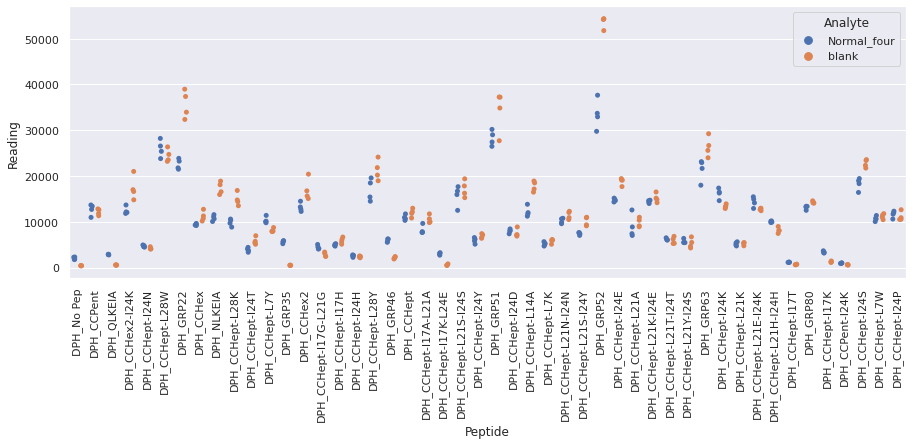

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

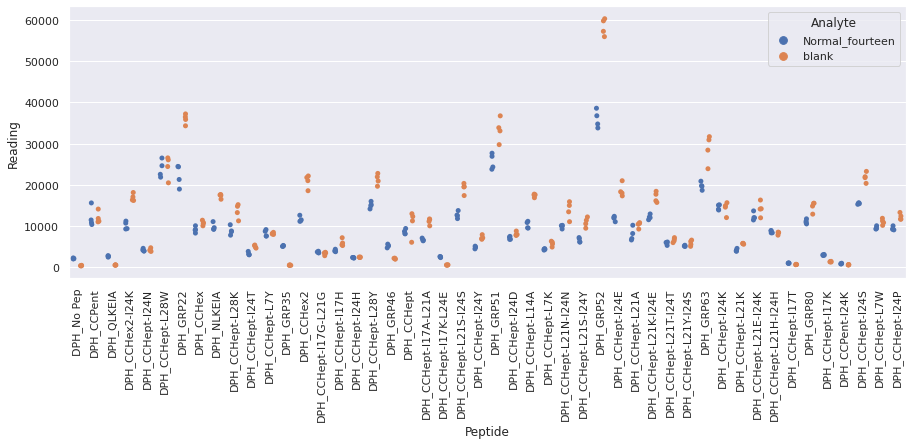

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

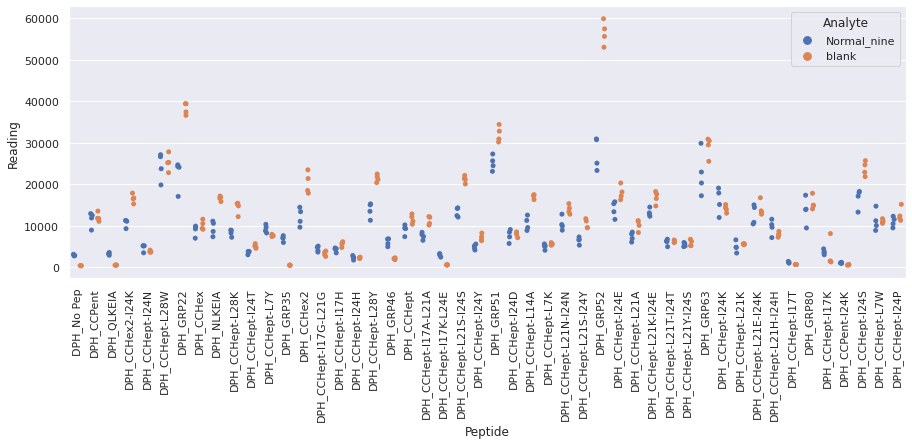

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

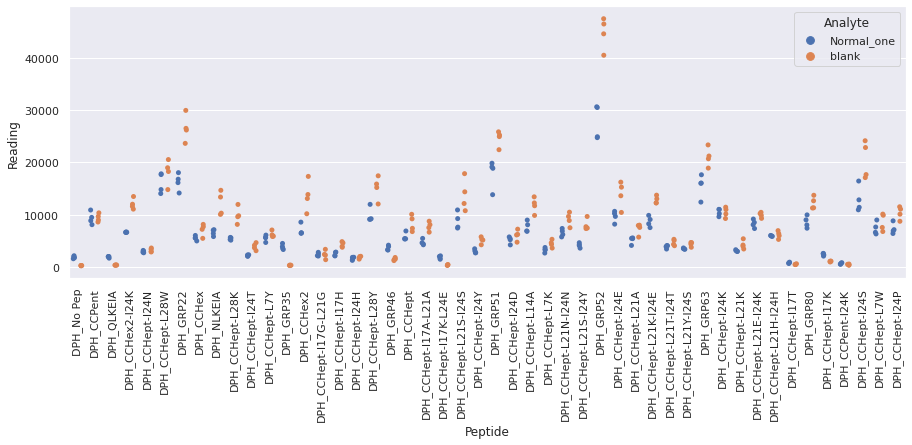

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

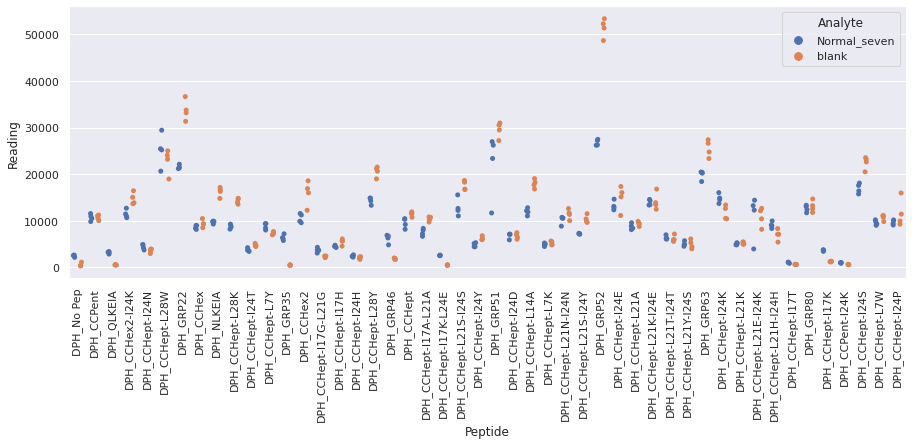

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

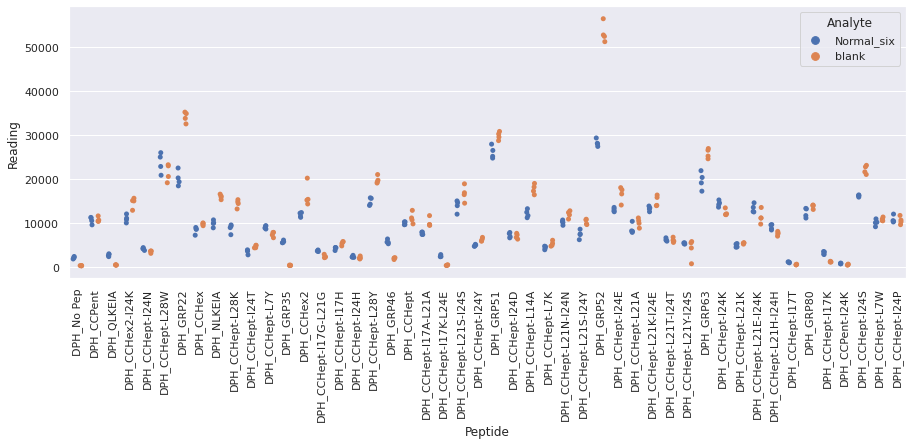

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

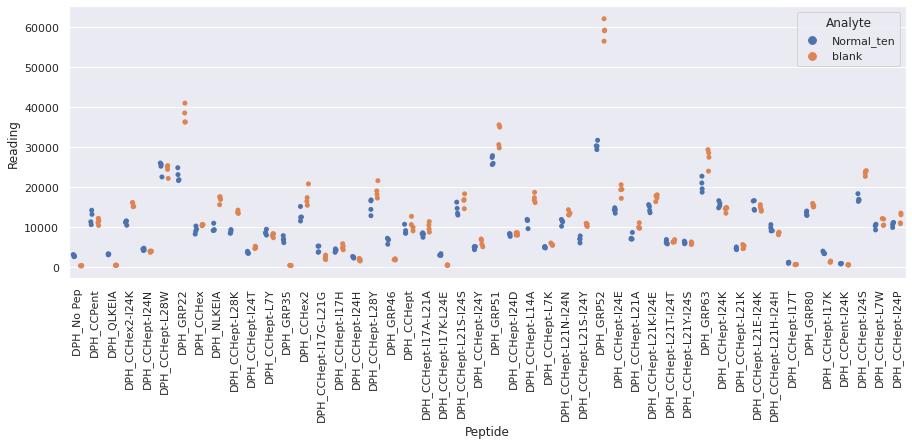

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

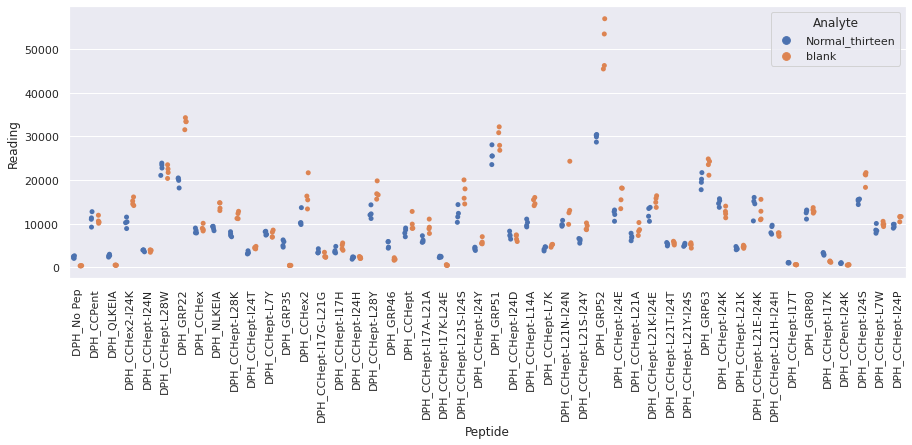

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirty_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

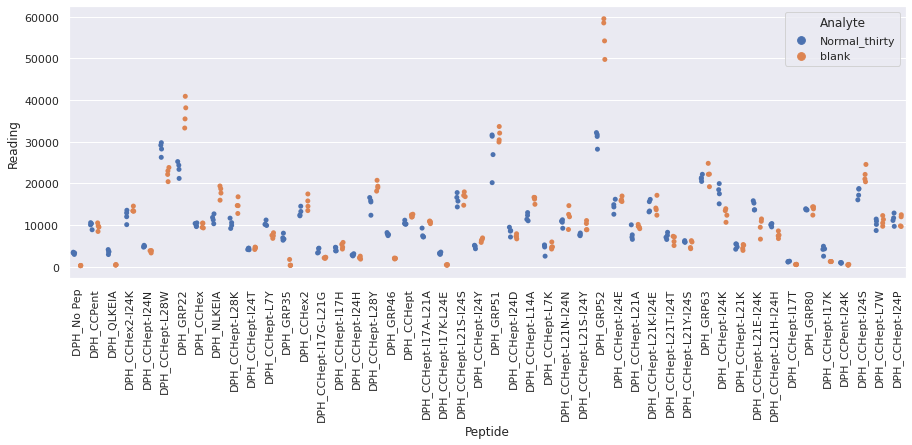

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtyeight_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

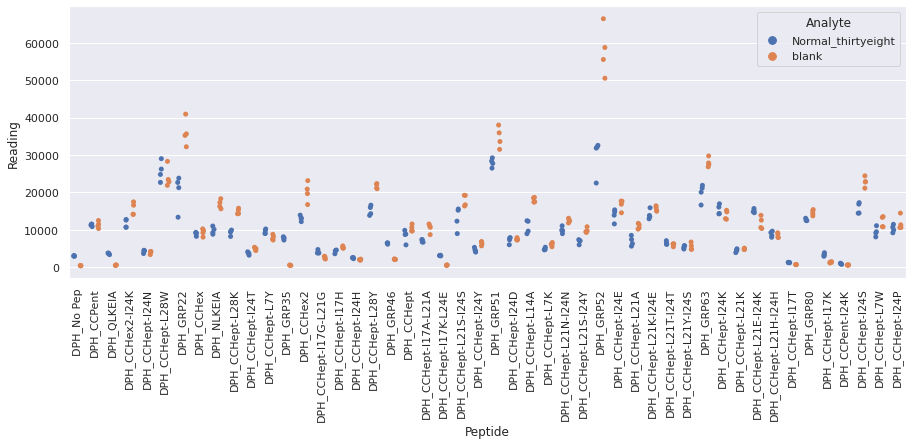

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

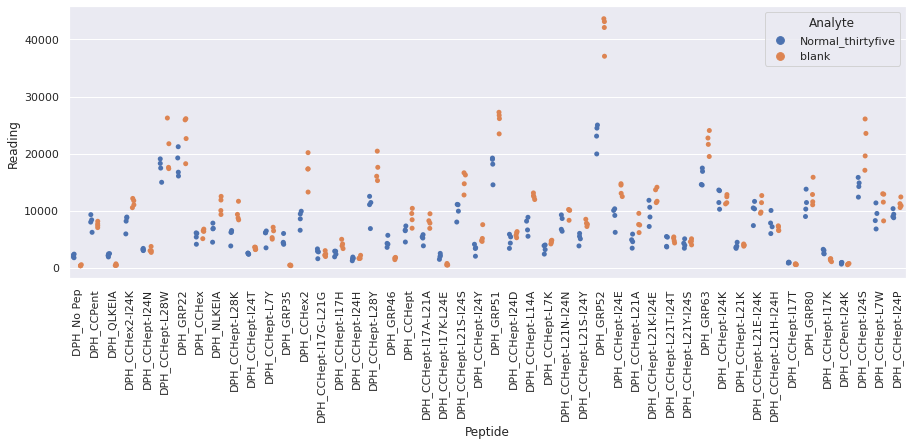

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

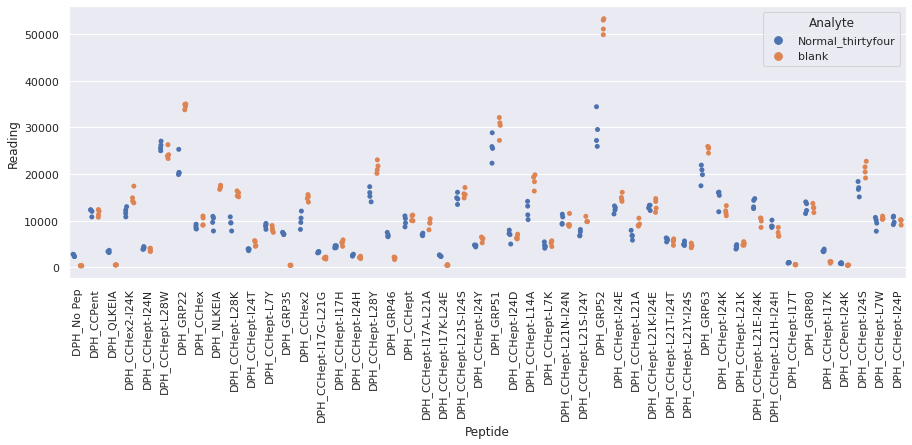

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtynine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

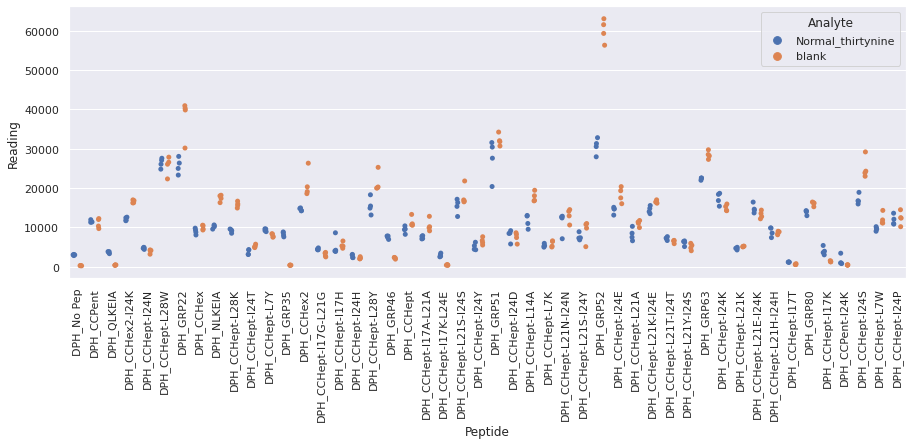

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtyone_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

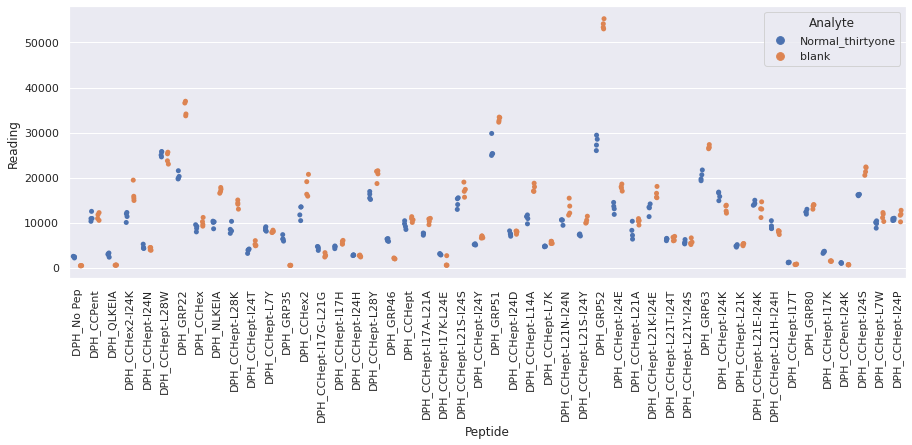

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtyseven_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

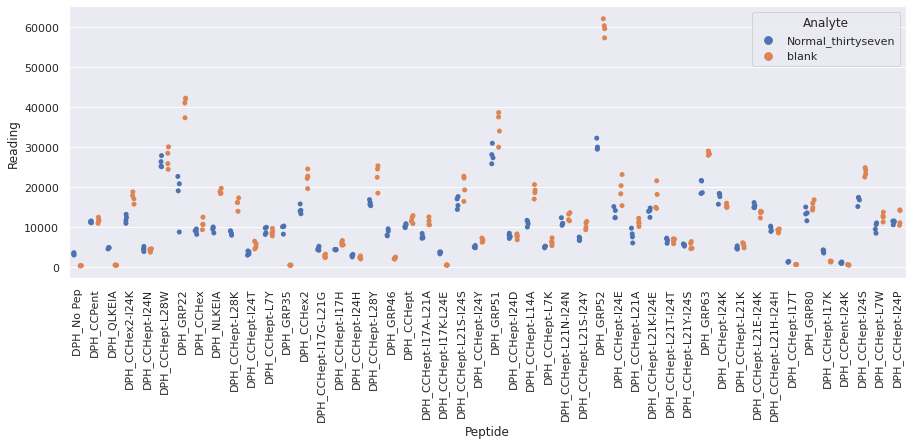

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtysix_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

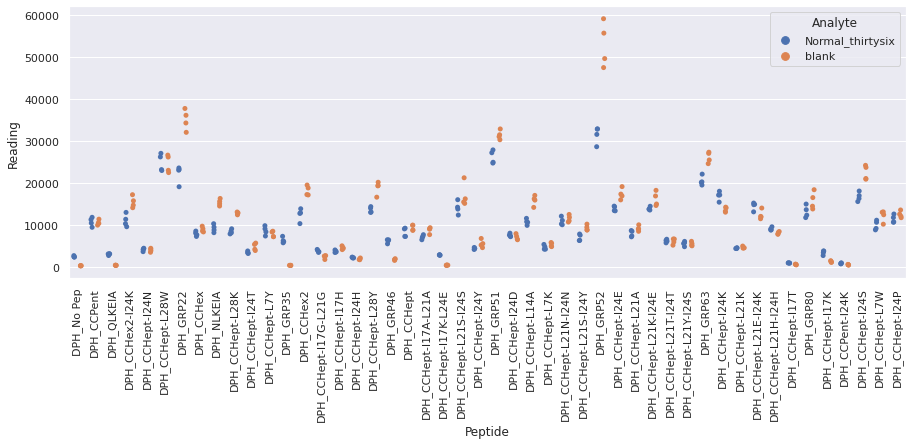

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtythree_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

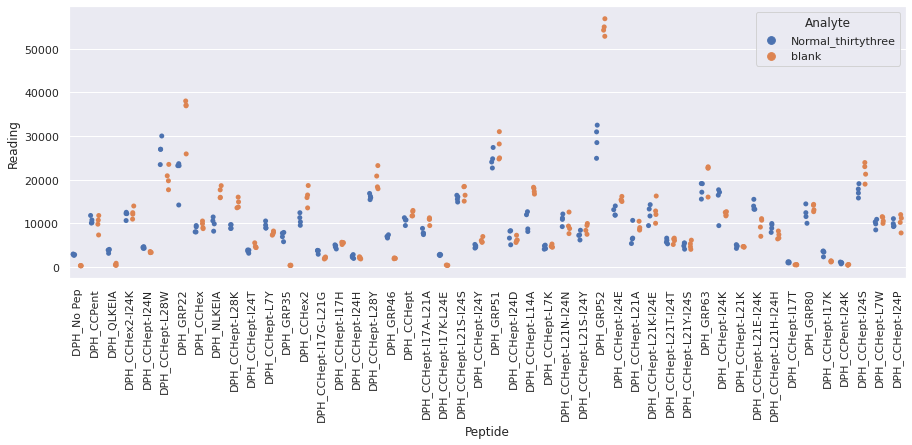

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_thirtytwo_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

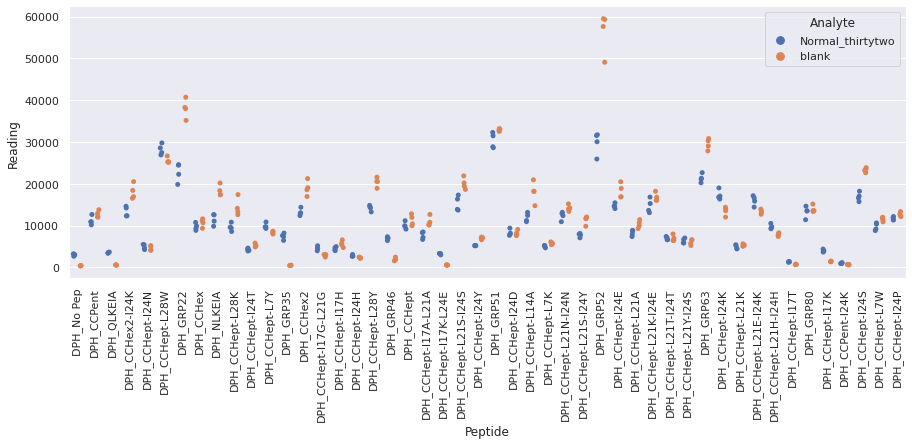

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

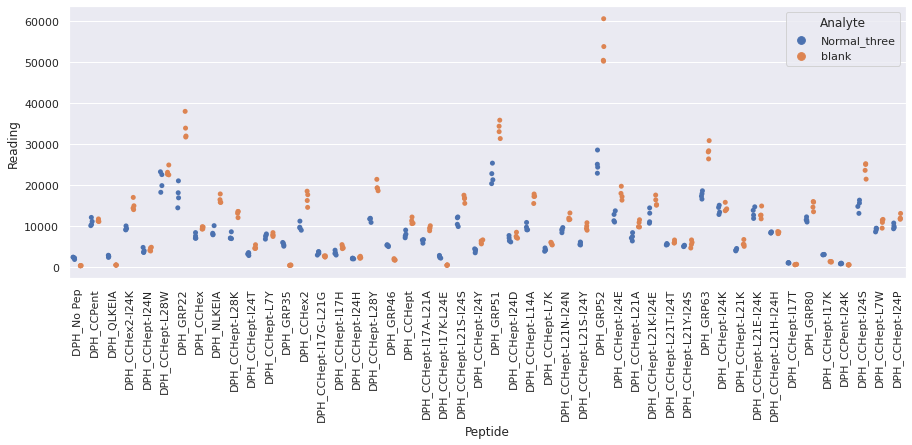

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

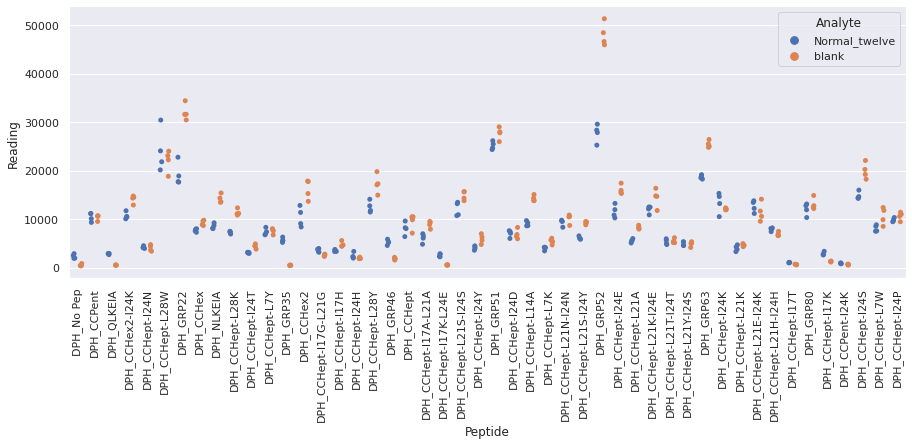

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_twentynine_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

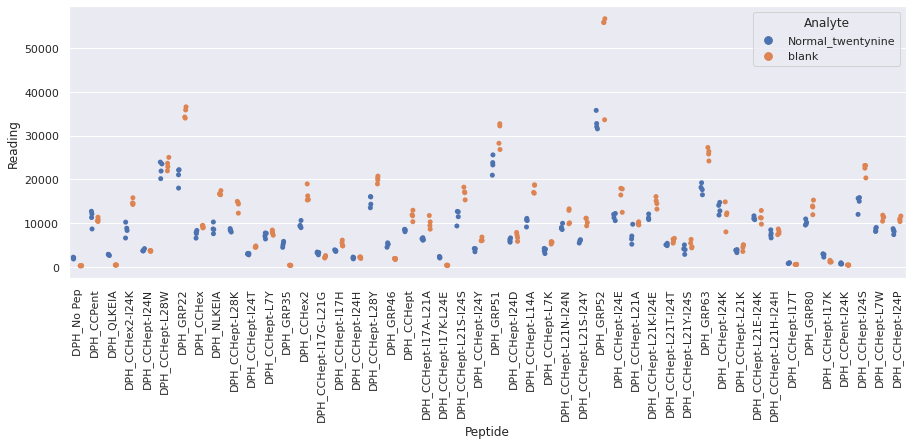

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_3.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_3 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

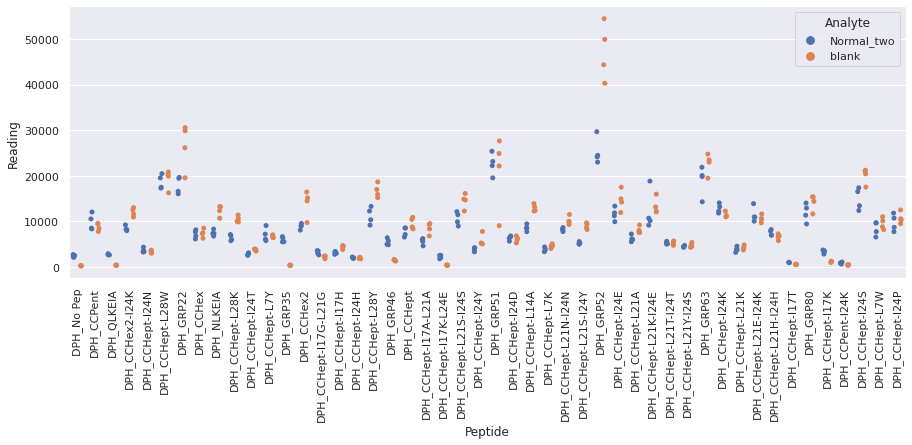

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_eighteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

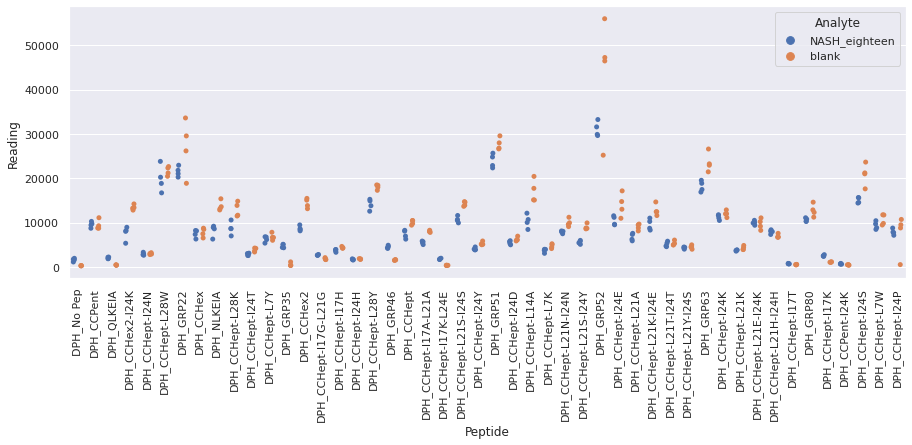

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_fifteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

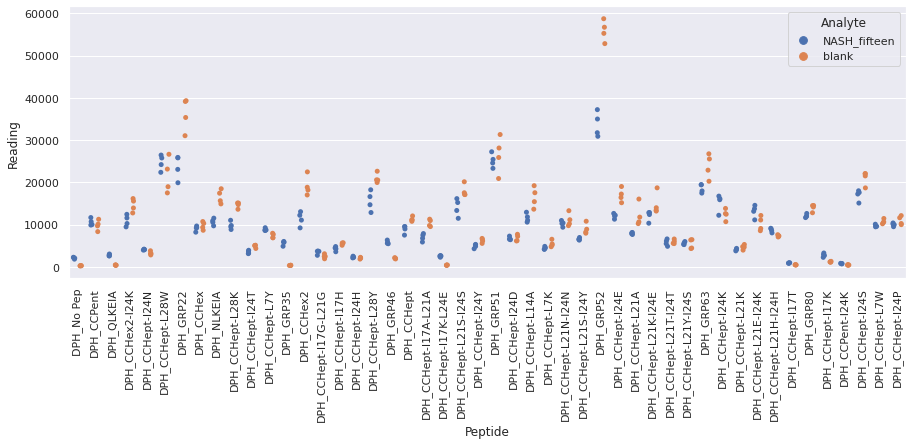

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_nineteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

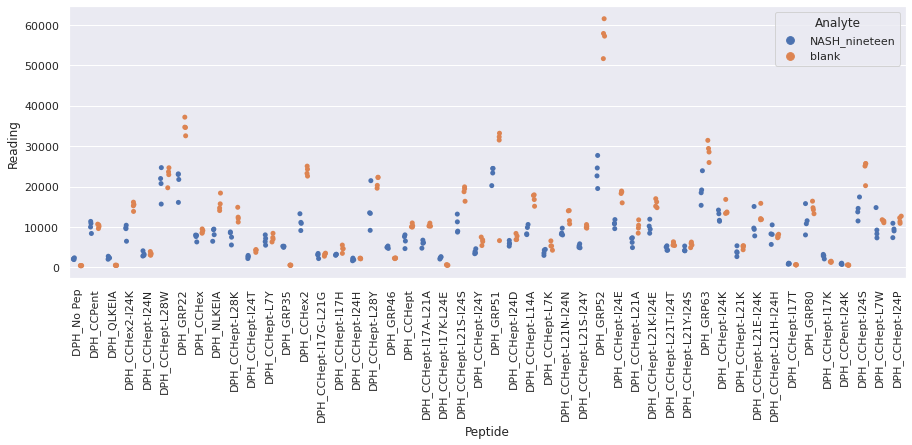

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_seventeen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

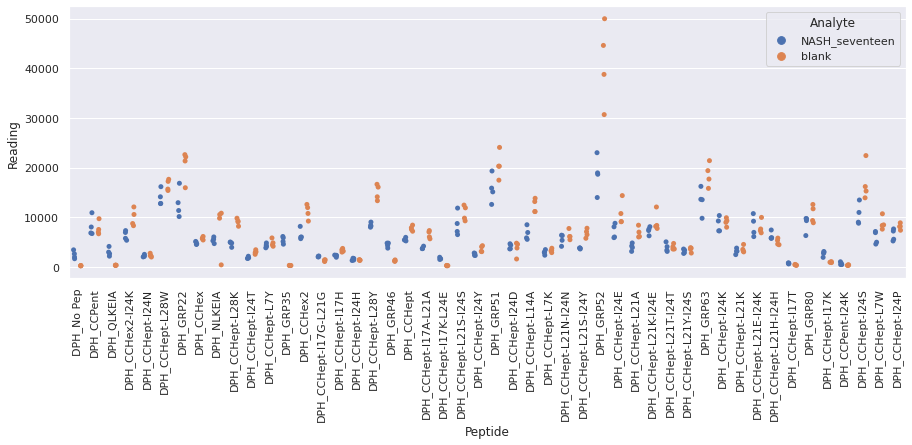

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_sixteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

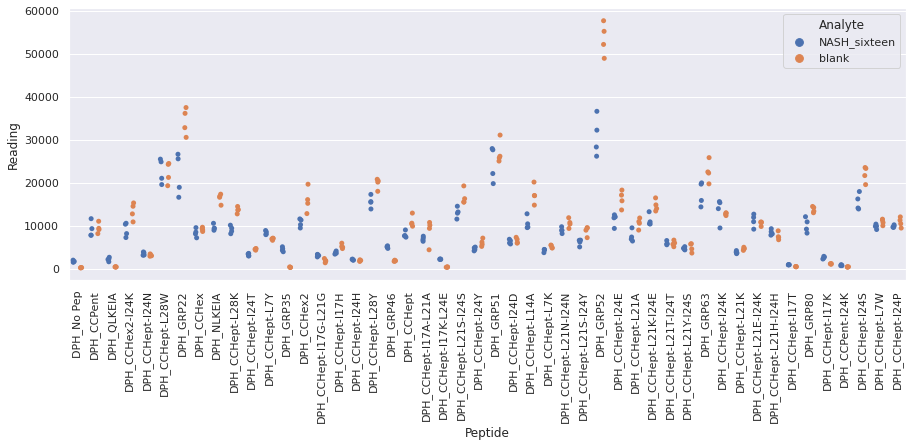

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twenty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

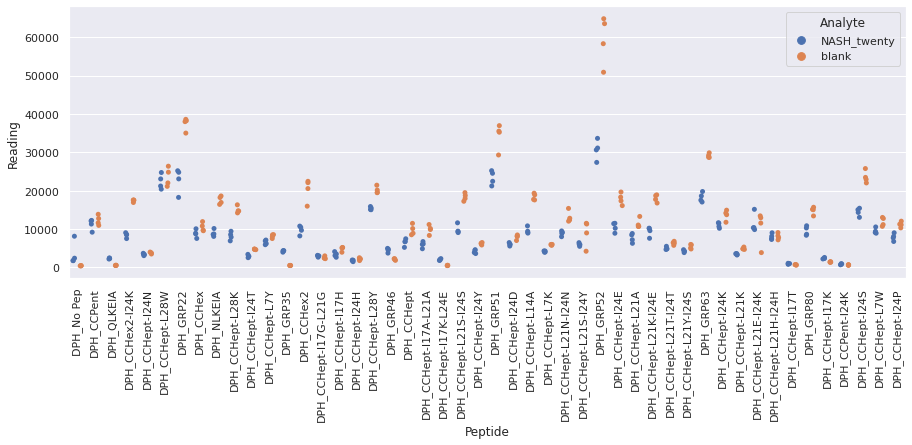

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyeight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

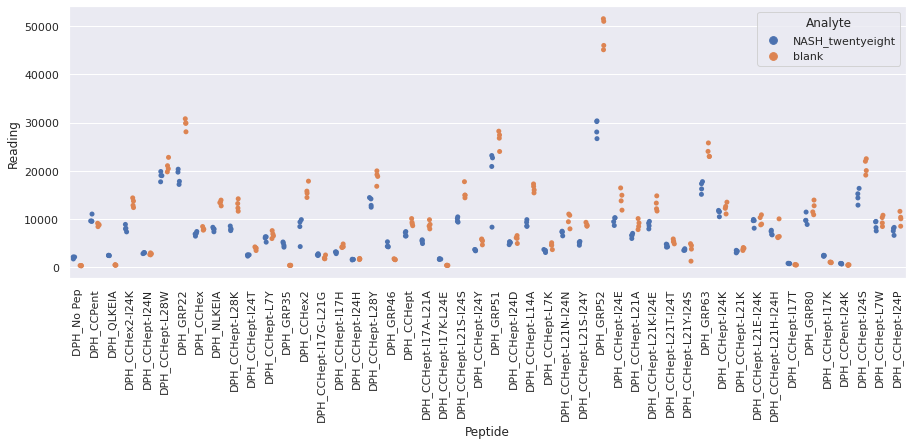

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyfive_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

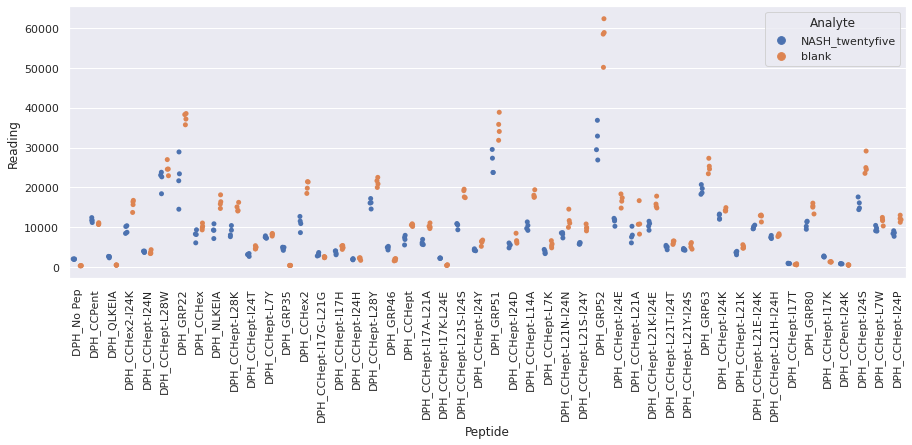

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyfour_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

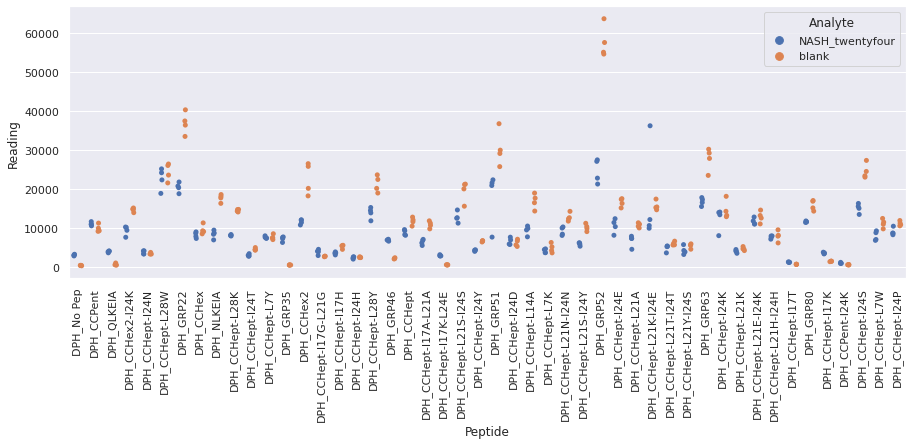

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

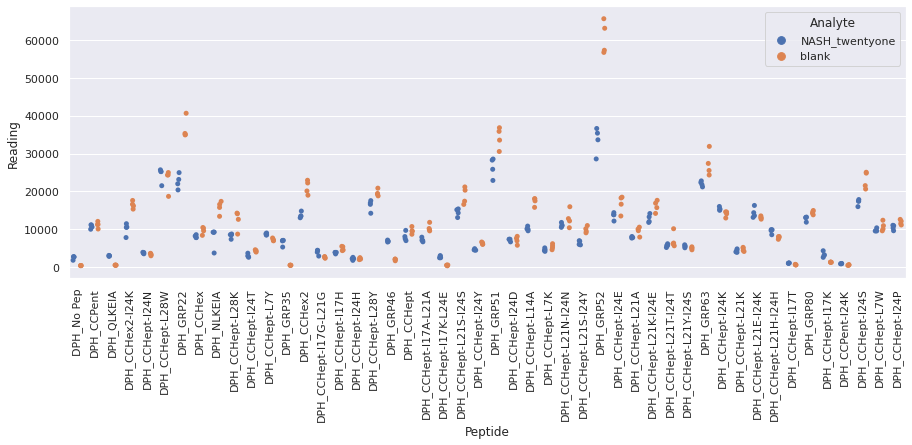

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentyseven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

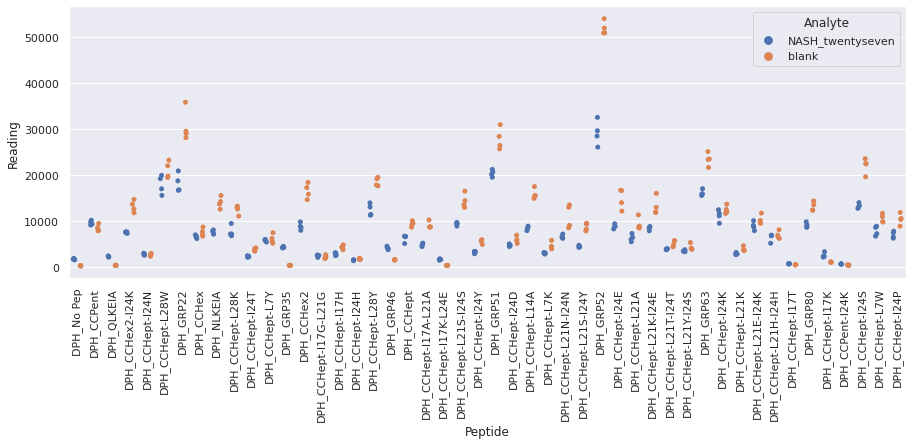

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentysix_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

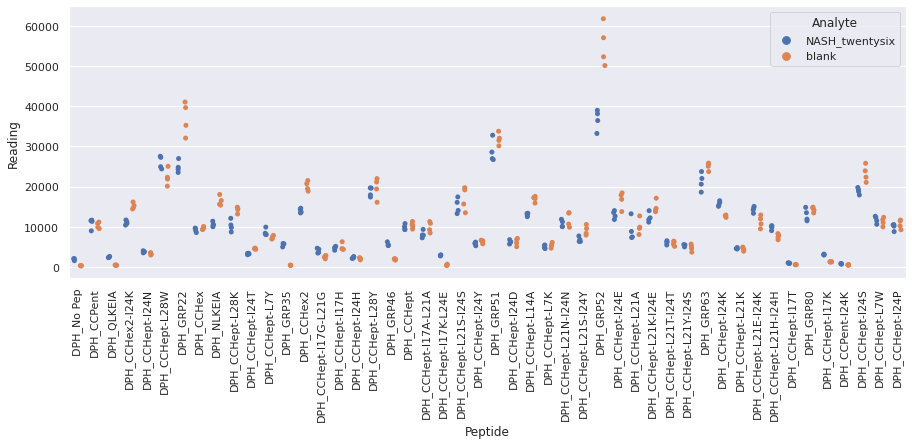

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentythree_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

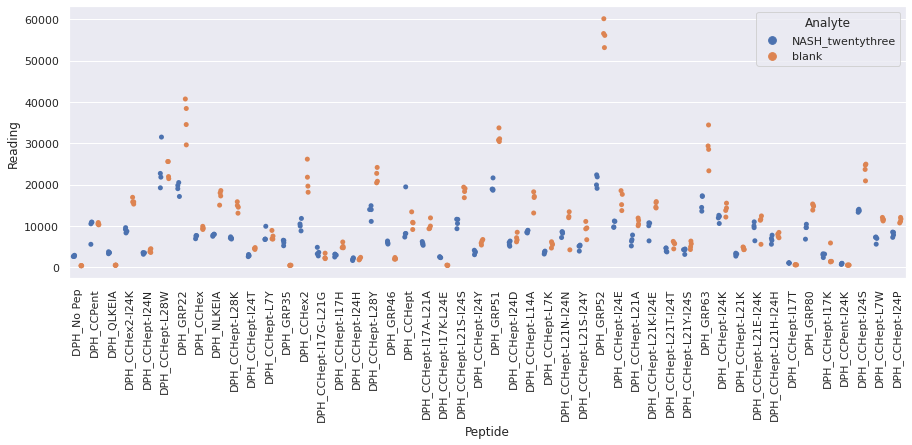

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_4.xlsx
Drawing scatter plot of data spread for NASH_twentytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

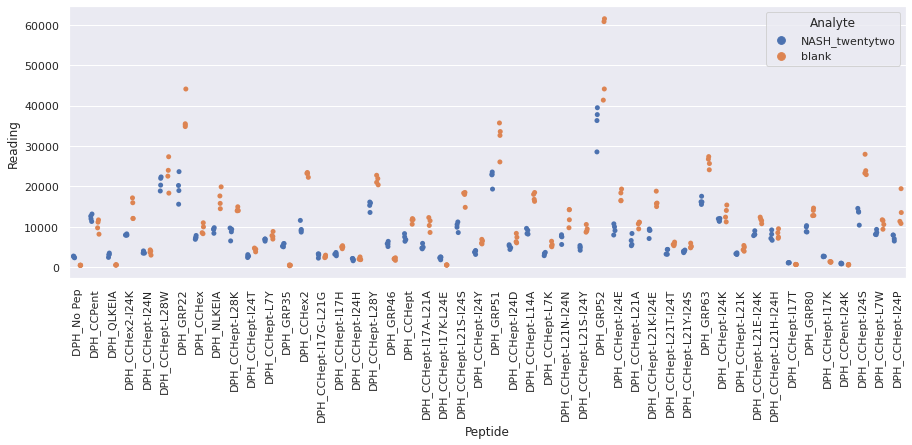

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_eight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

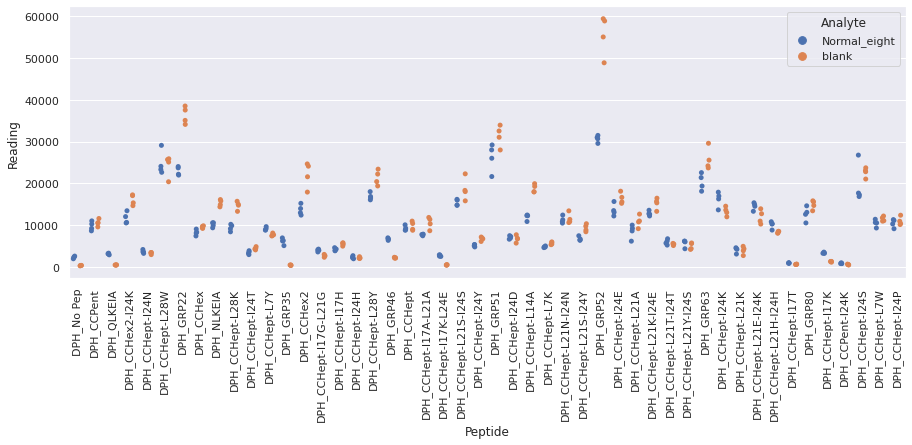

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_eleven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

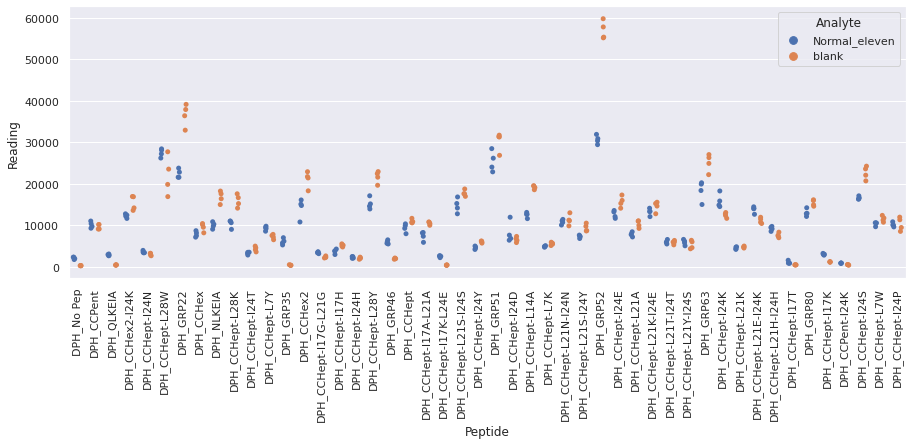

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_five_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

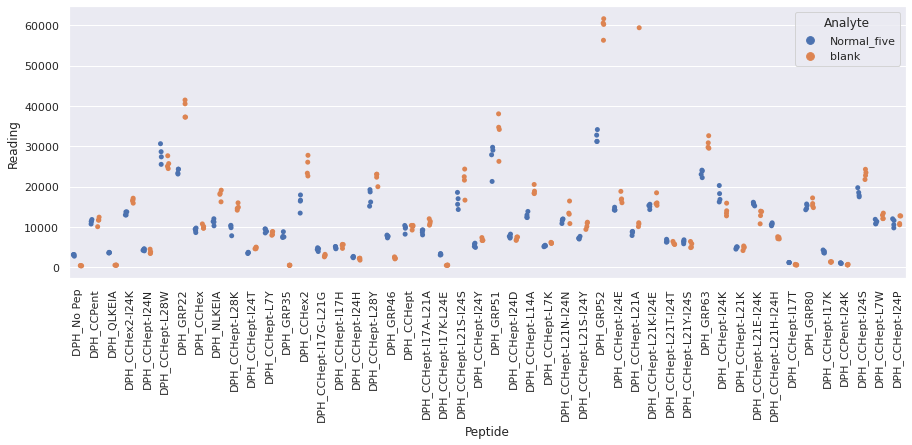

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_forty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

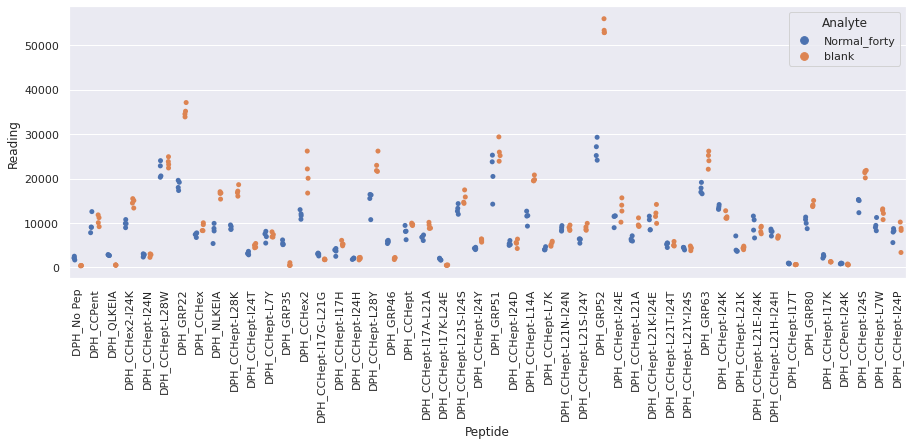

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fortyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

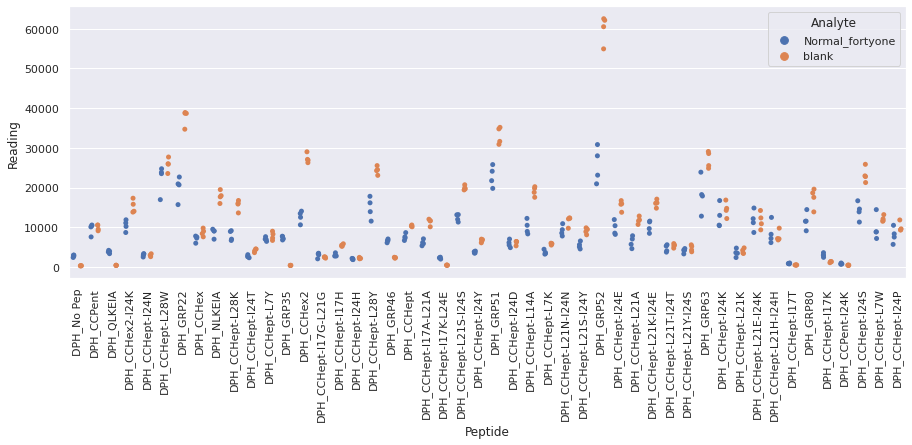

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fortytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

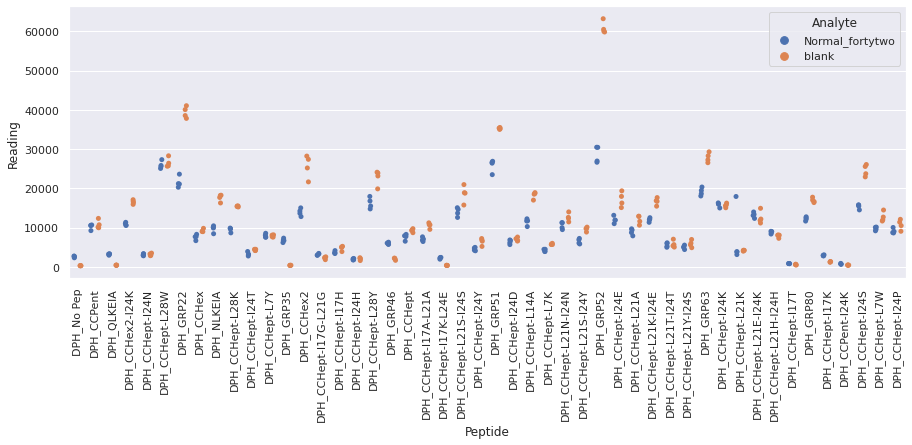

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_four_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

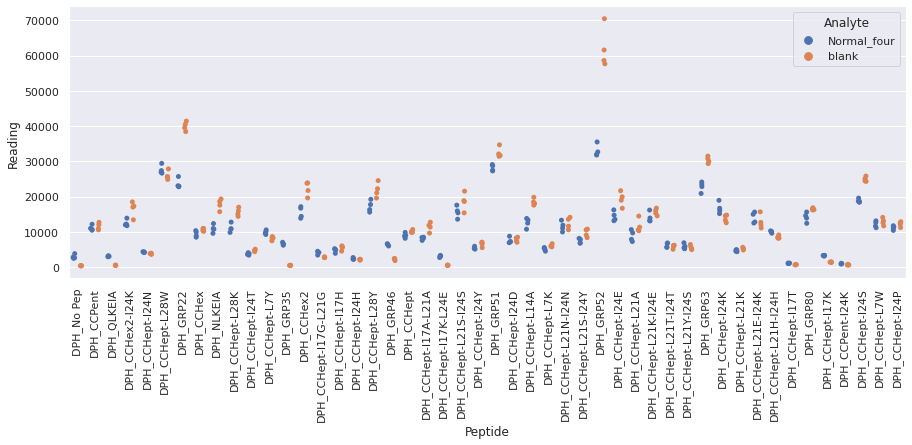

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_fourteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

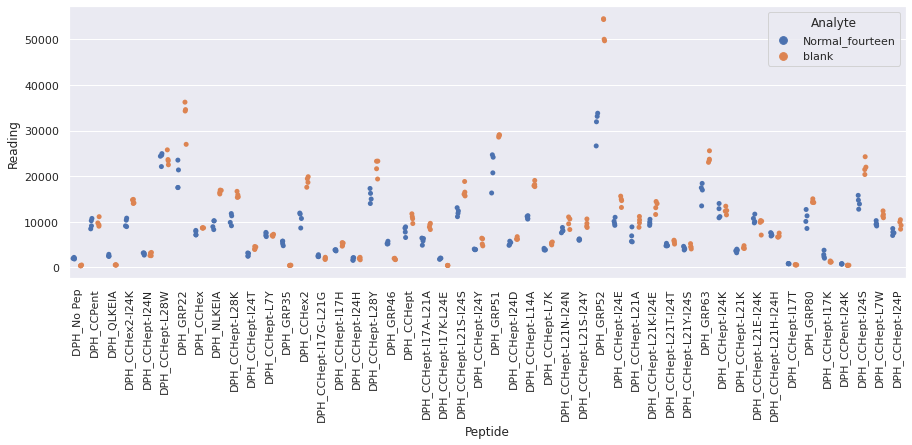

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_nine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

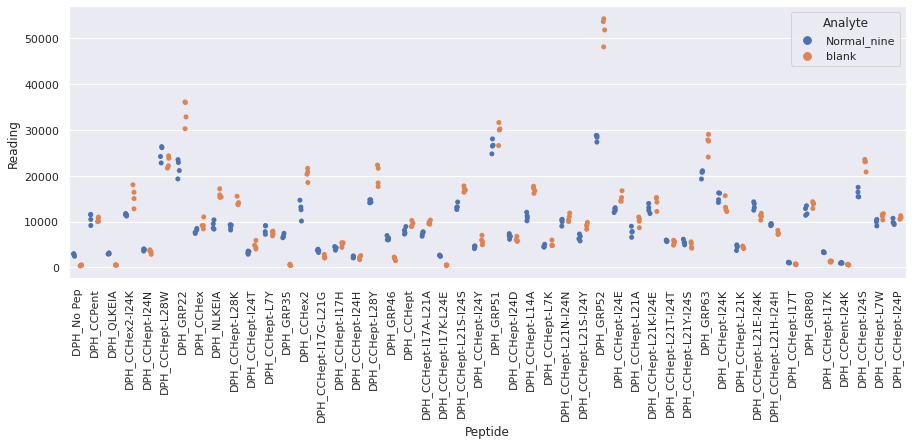

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_one_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

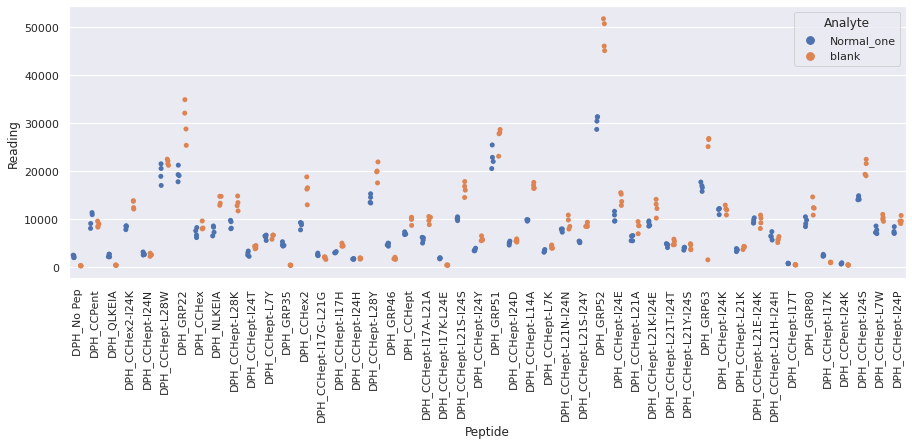

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_seven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

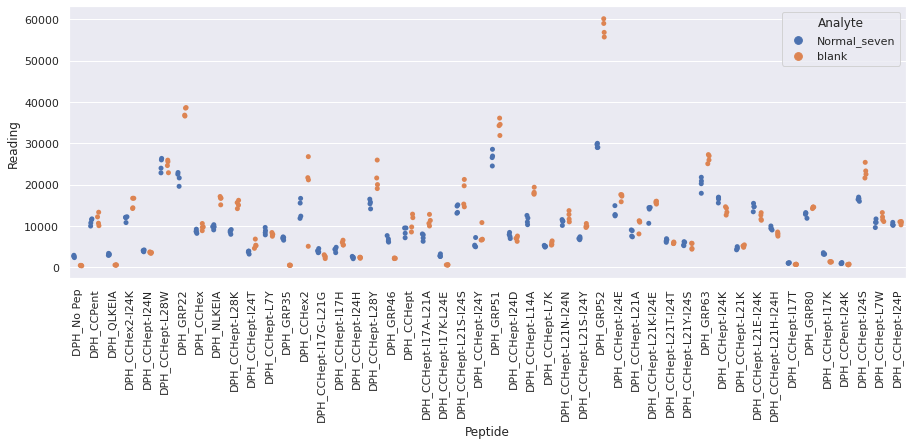

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_six_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

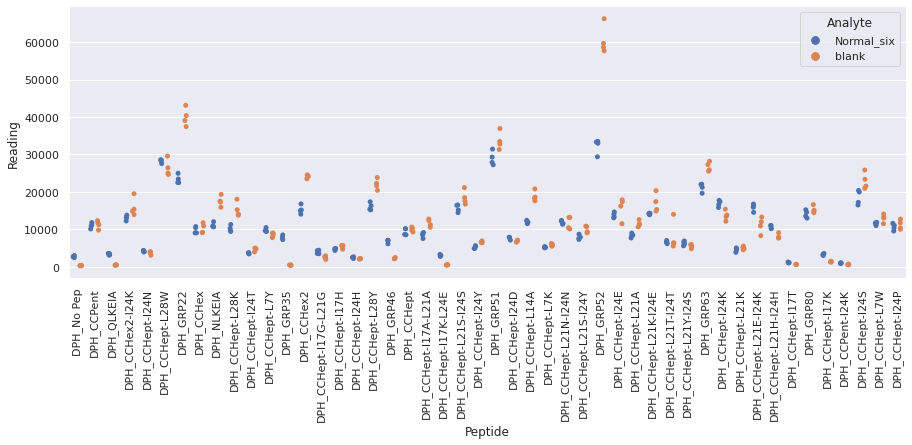

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_ten_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

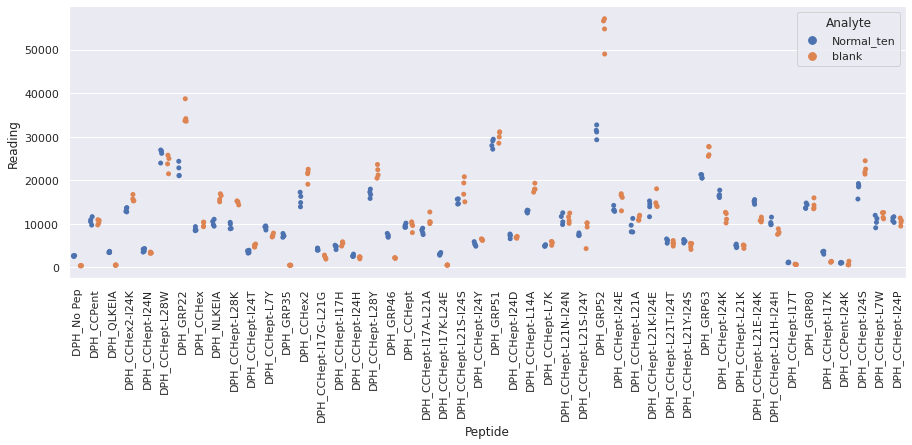

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirteen_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

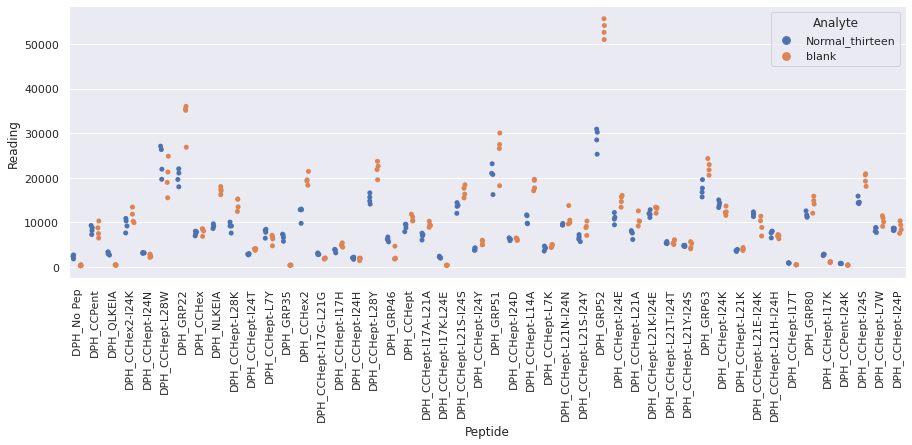

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirty_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

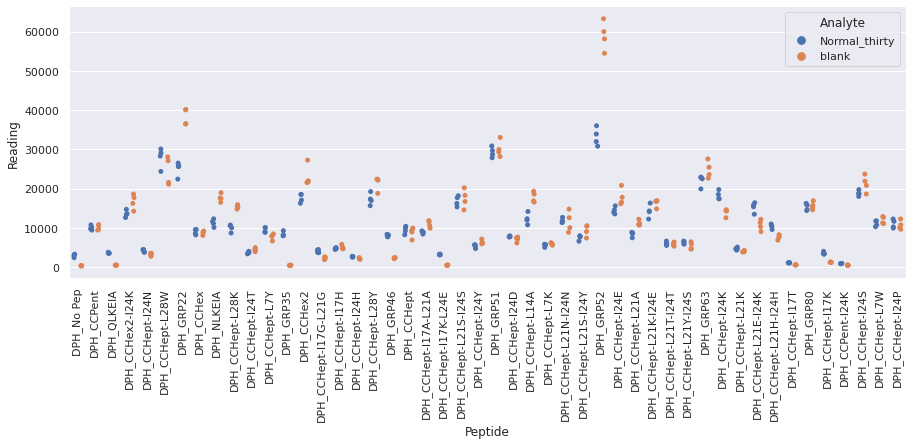

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtyeight_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

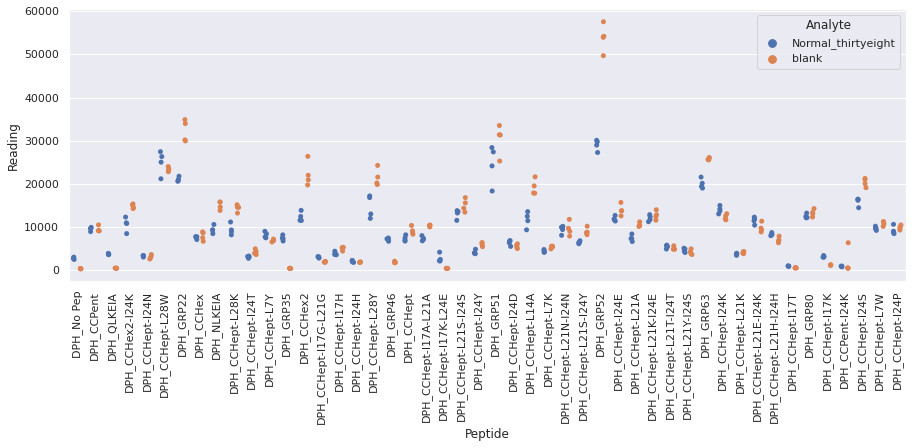

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

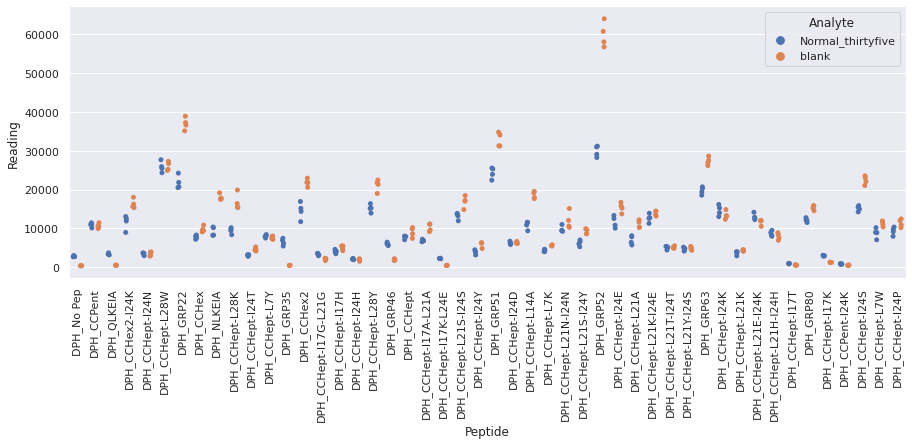

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

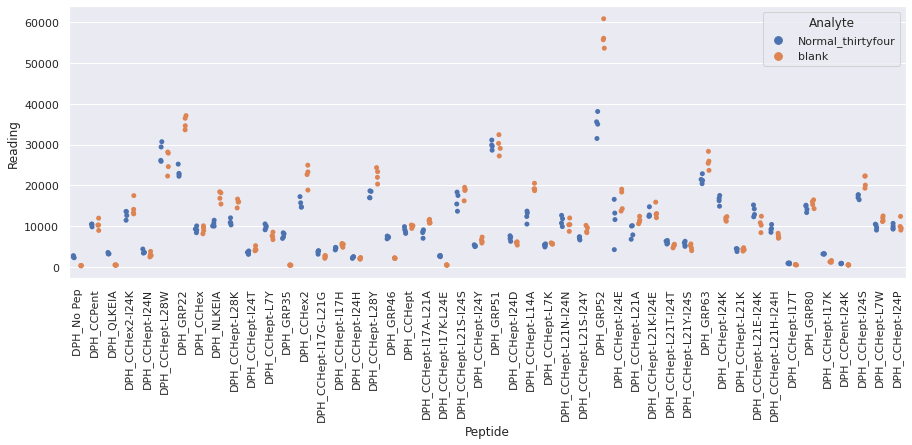

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtynine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

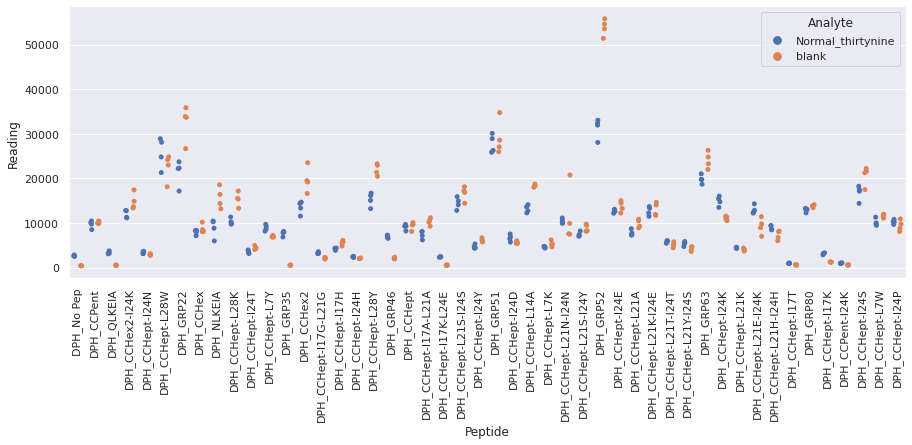

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtyone_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

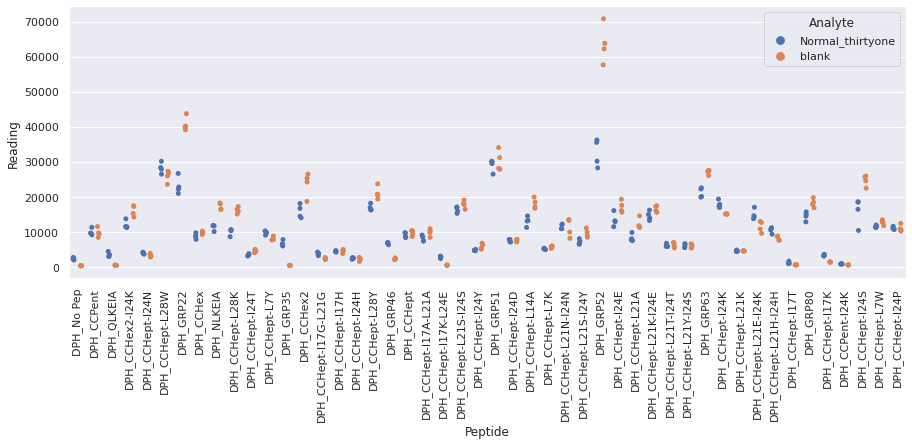

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtyseven_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

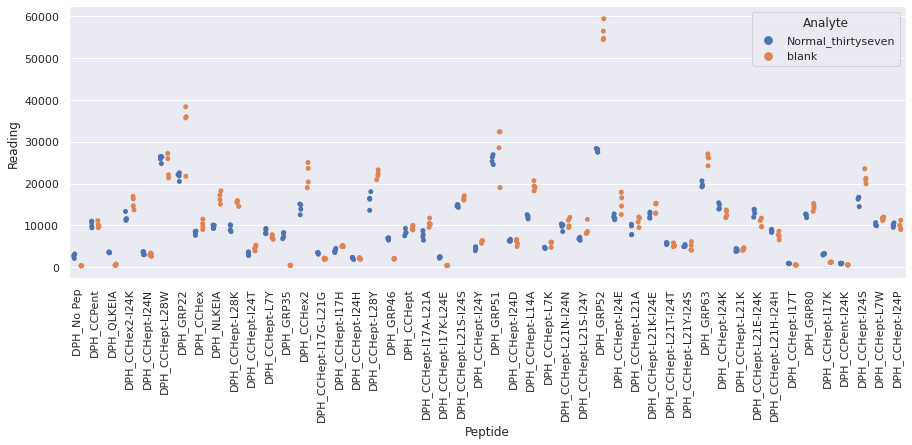

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtysix_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

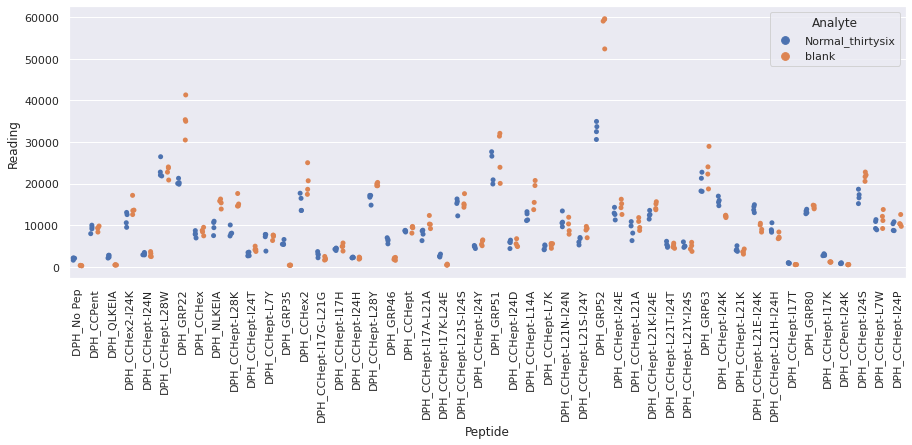

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtythree_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

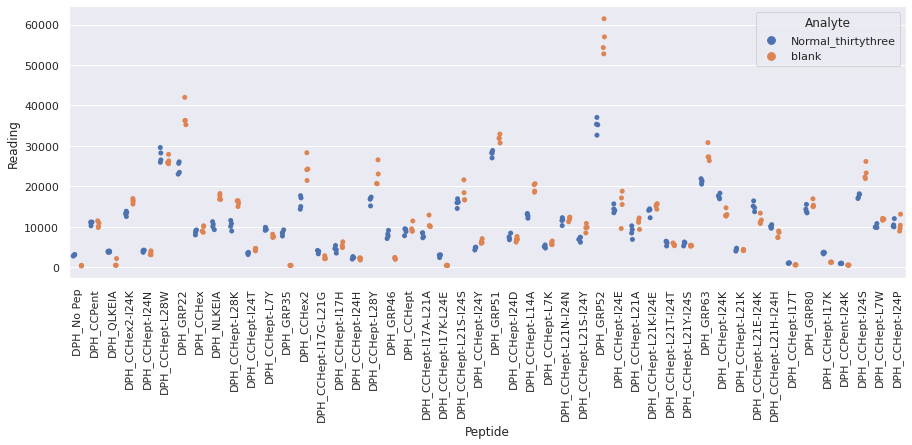

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_thirtytwo_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

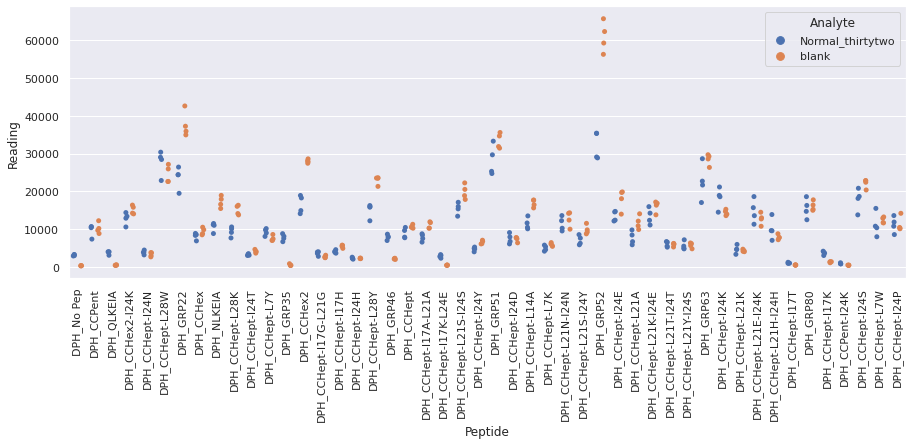

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_three_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

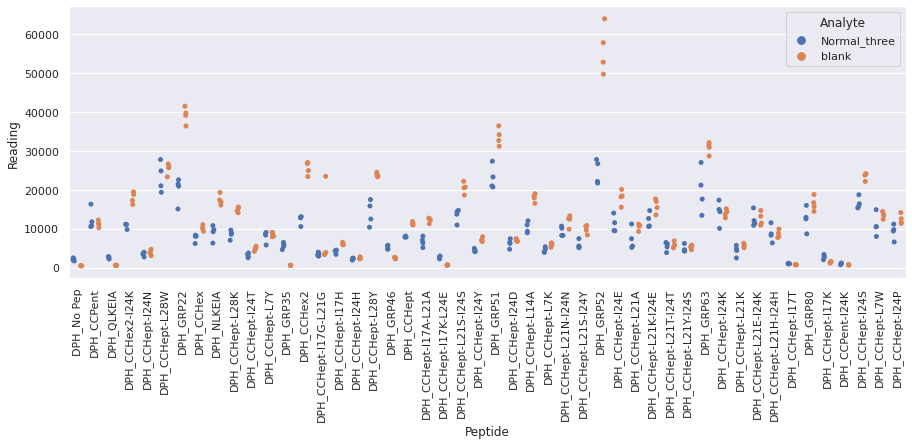

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_twelve_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

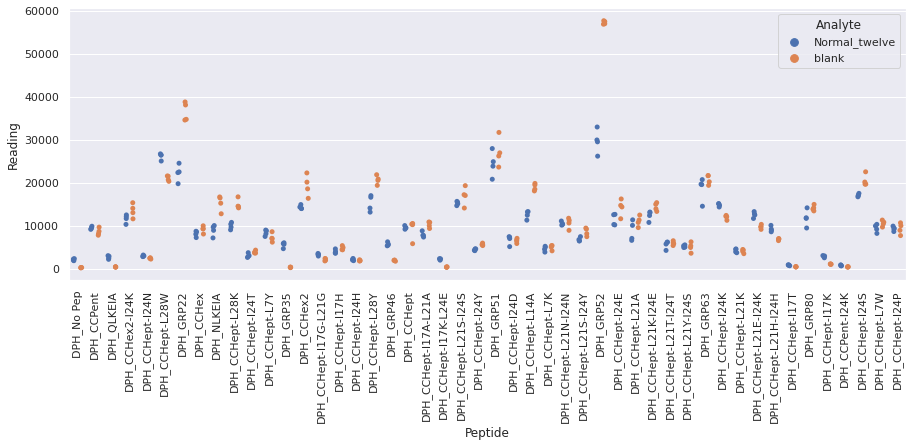

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_twentynine_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

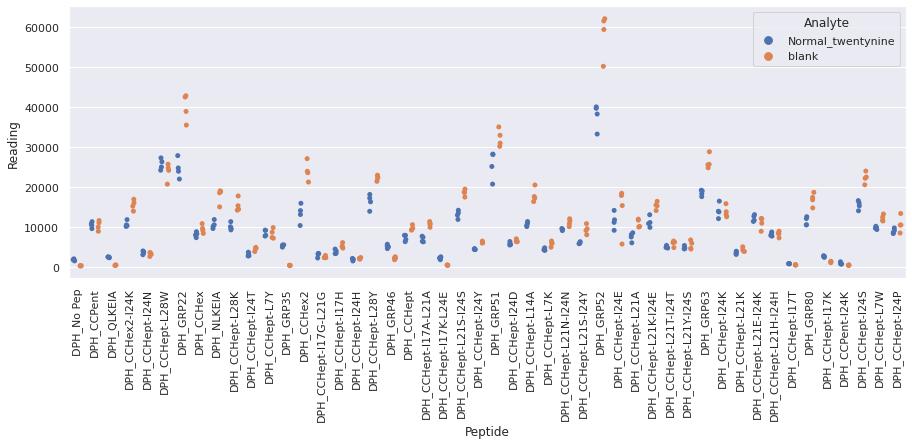

Parsing plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_4.xlsx
Drawing scatter plot of data spread for Normal_two_repeat_4 in NASH_unscaled_data


<Figure size 720x720 with 0 Axes>

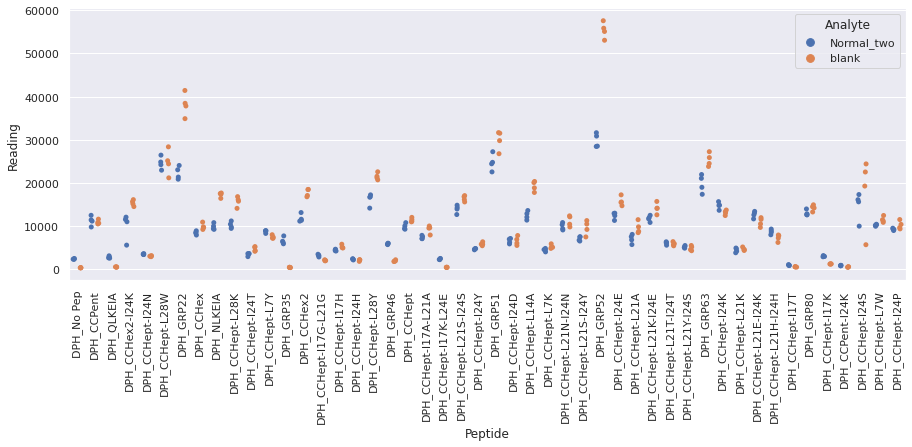

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

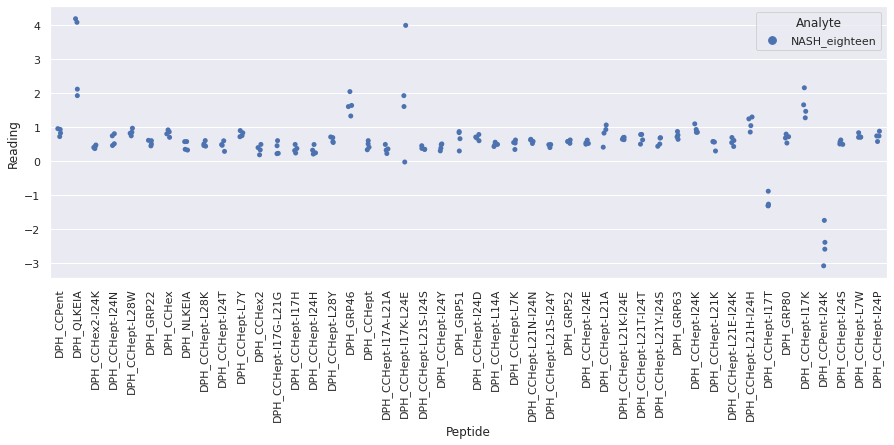

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

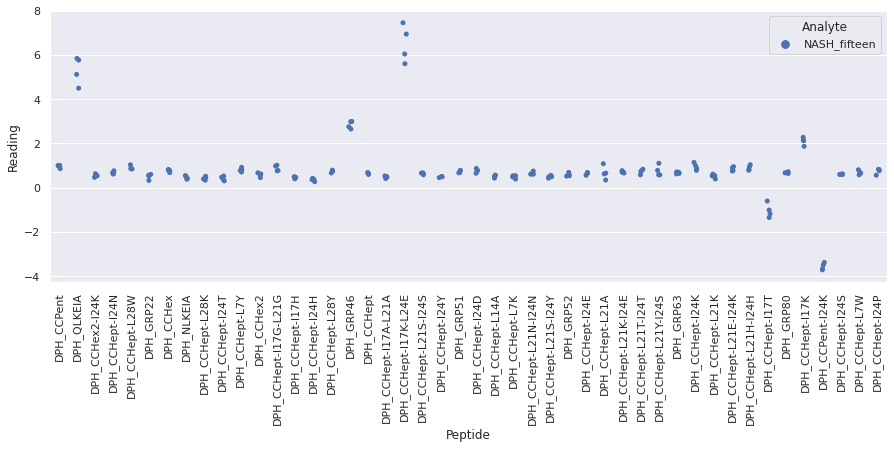

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

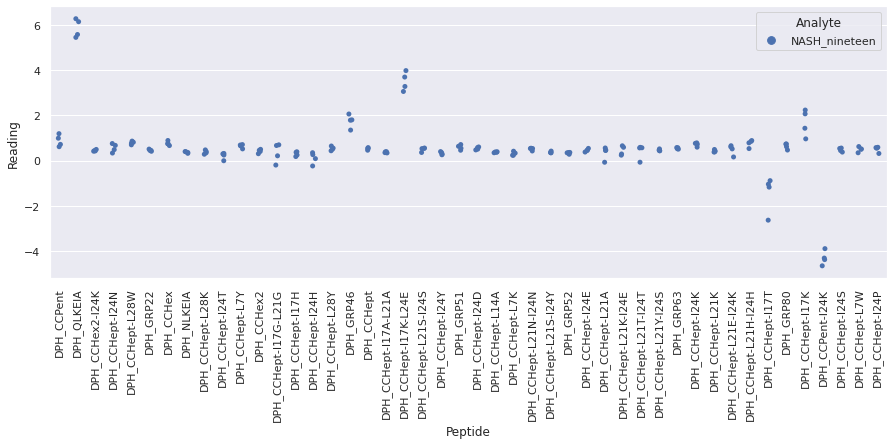

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

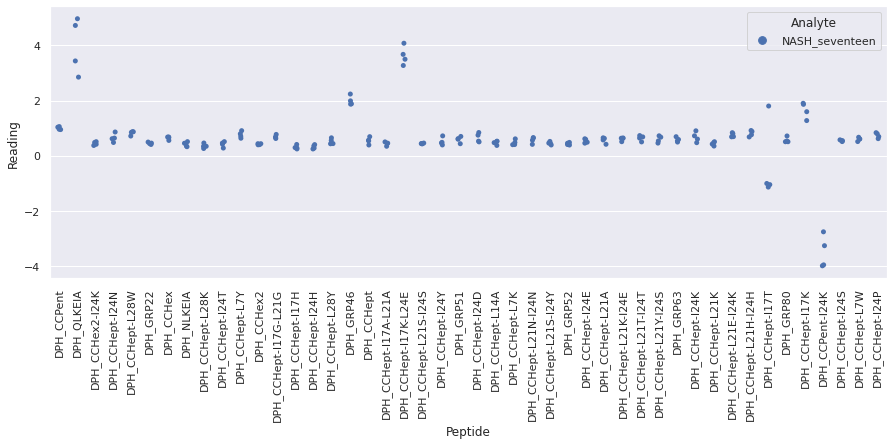

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

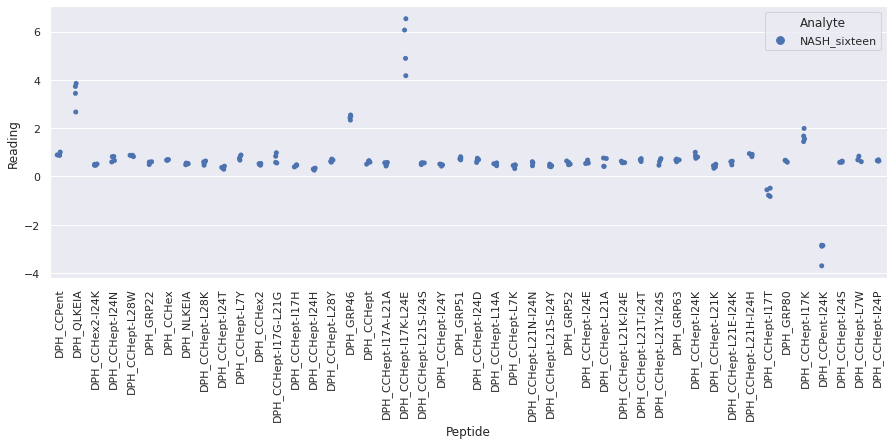

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

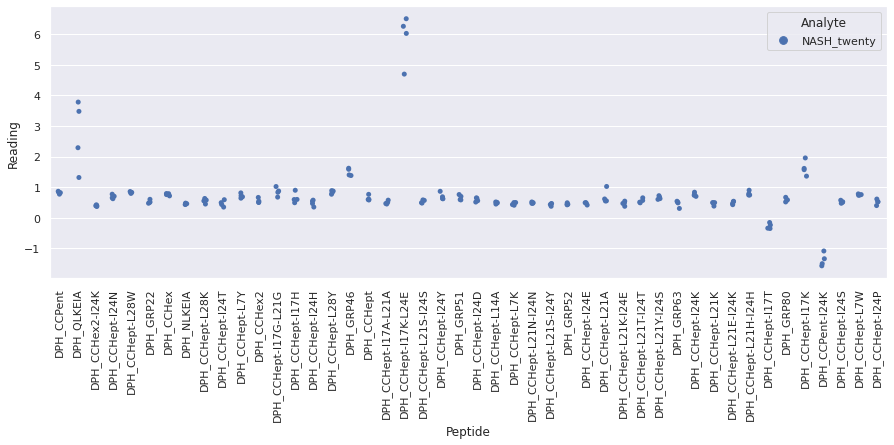

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeight_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

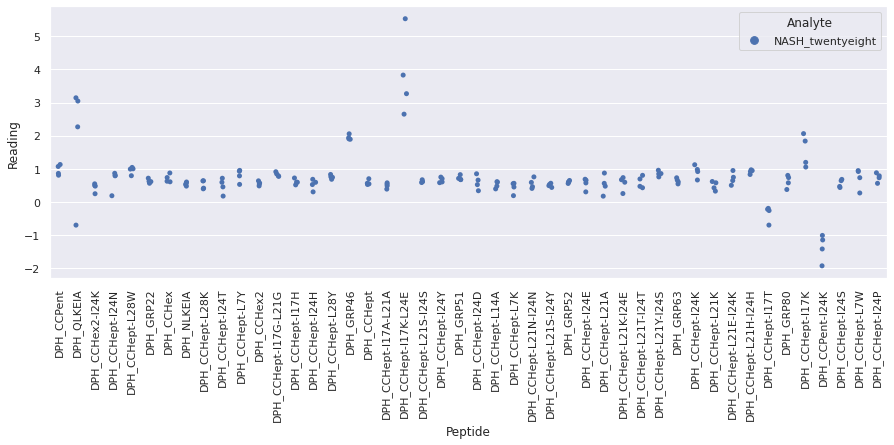

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfive_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

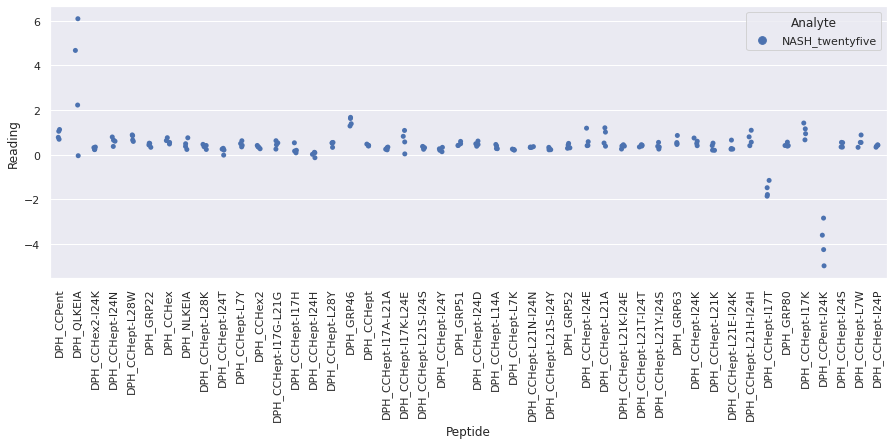

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

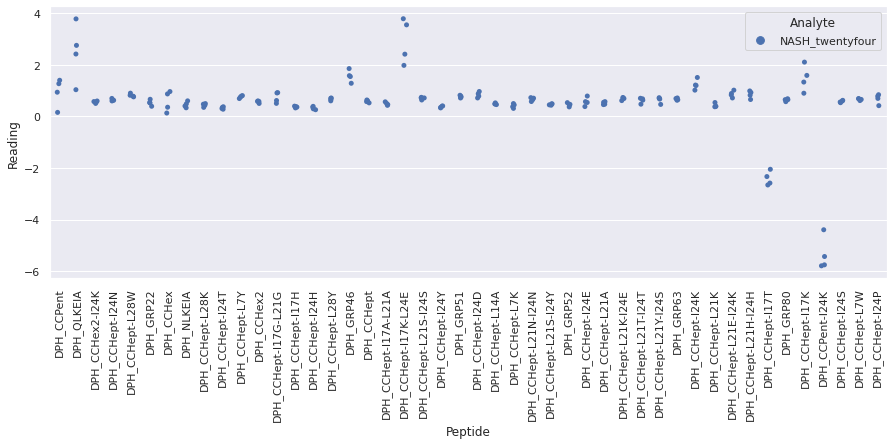

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

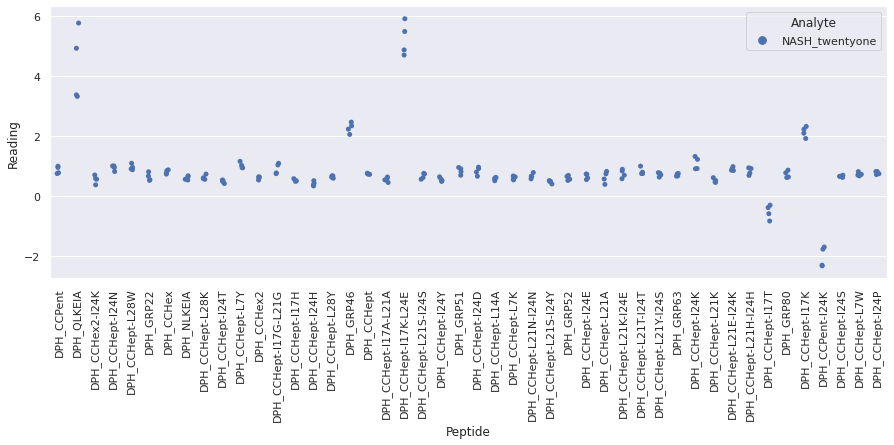

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyseven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

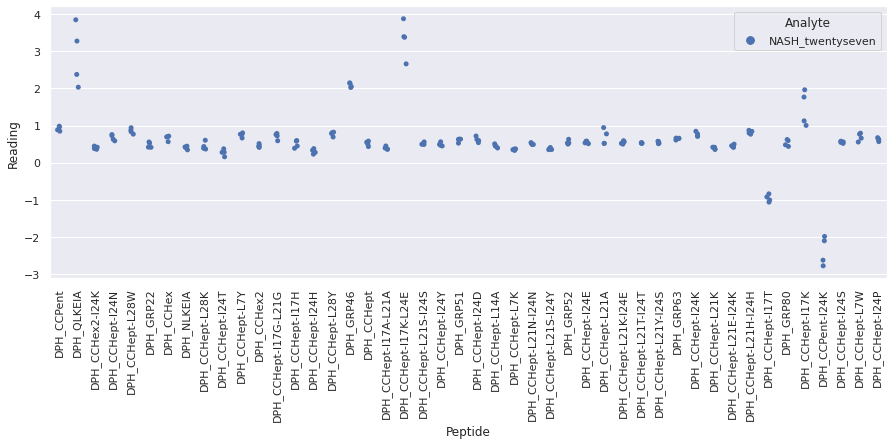

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

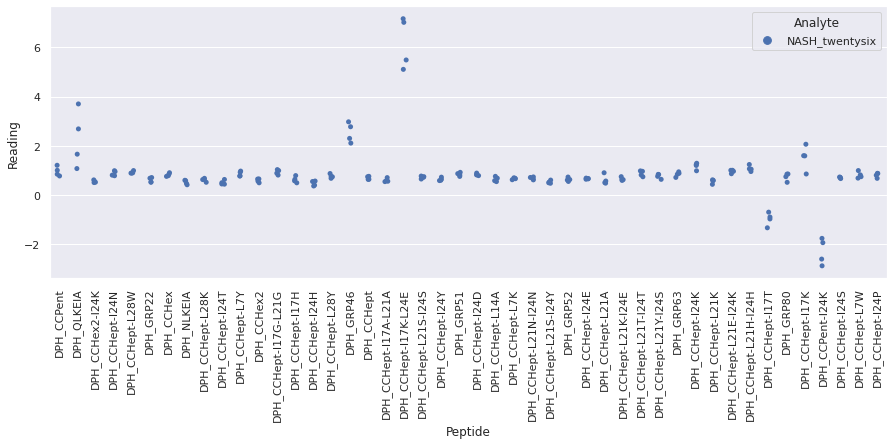

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythree_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

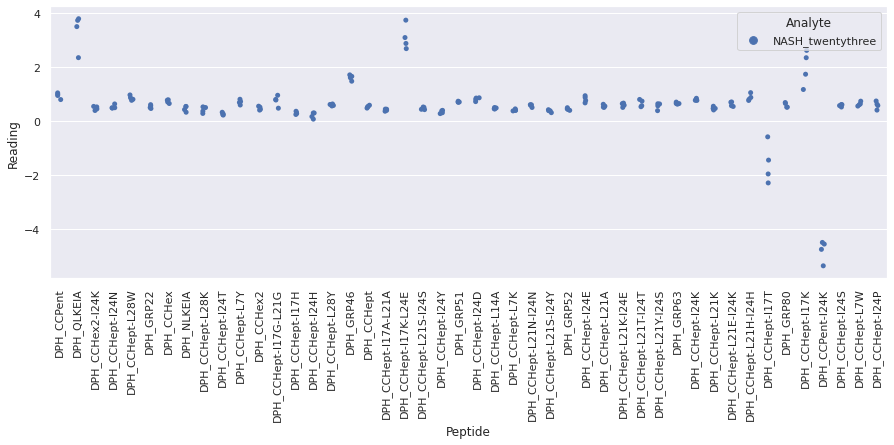

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

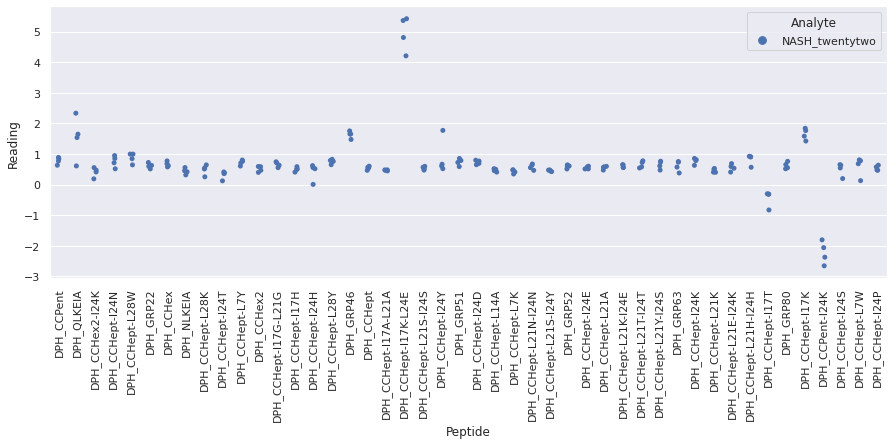

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eight_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

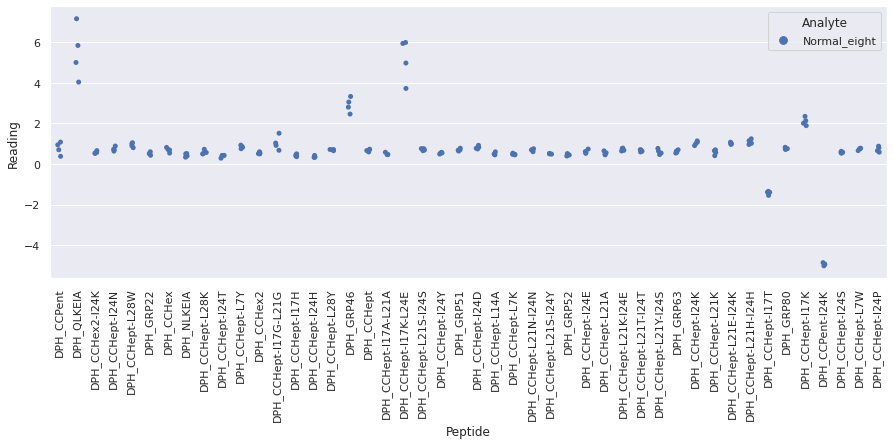

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

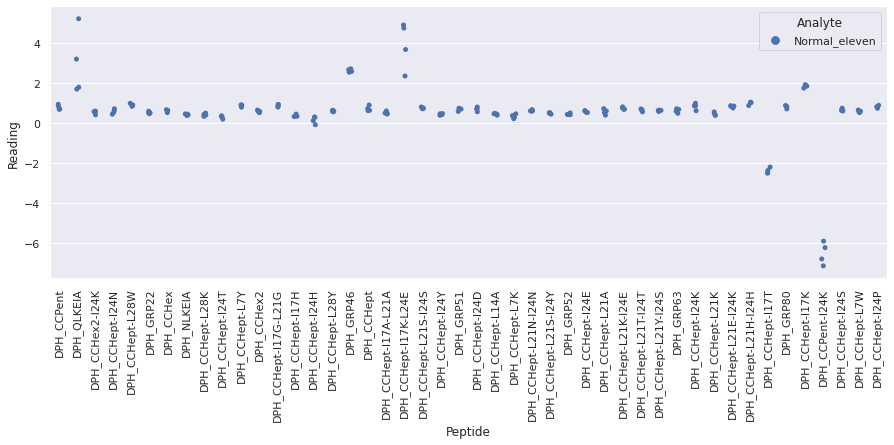

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

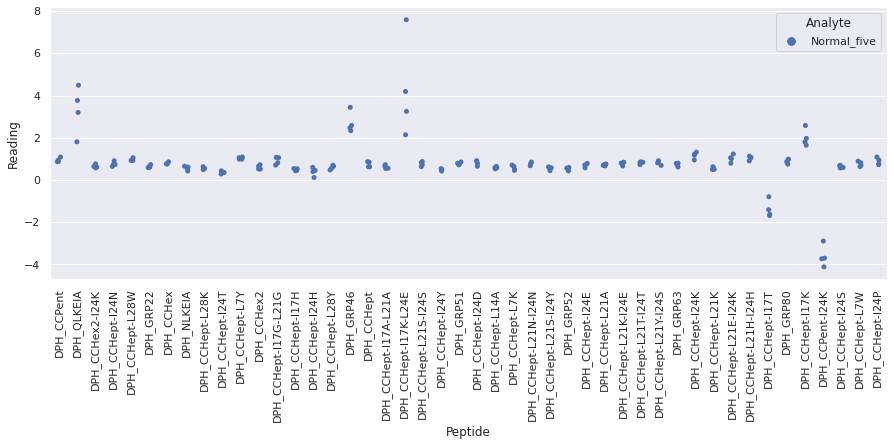

 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

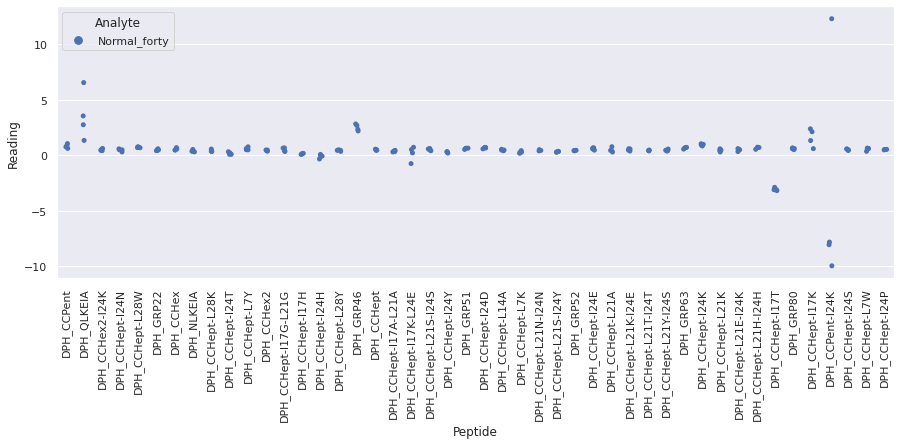

 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

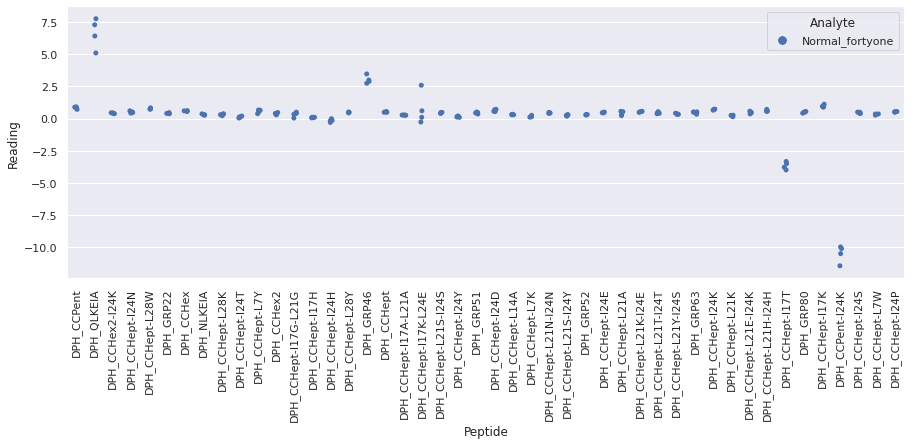

 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fortytwo_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

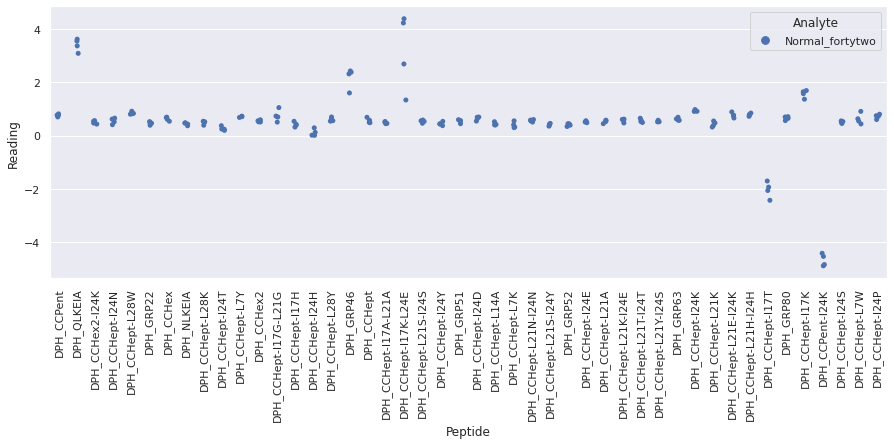

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_four_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

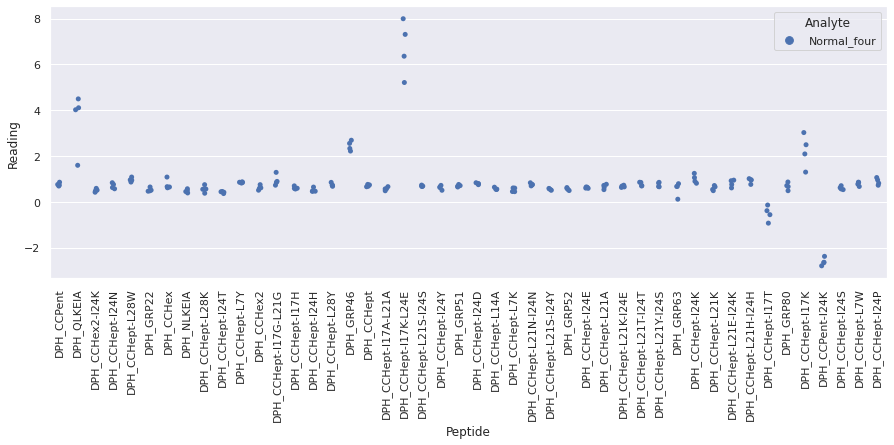

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

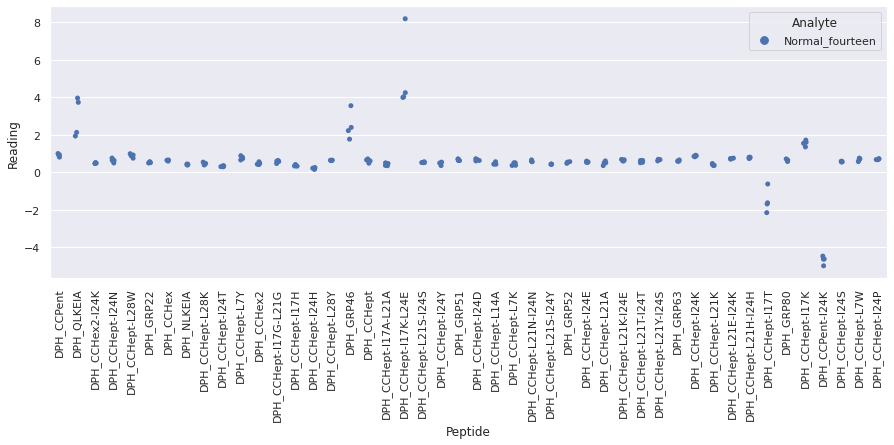

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_nine_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

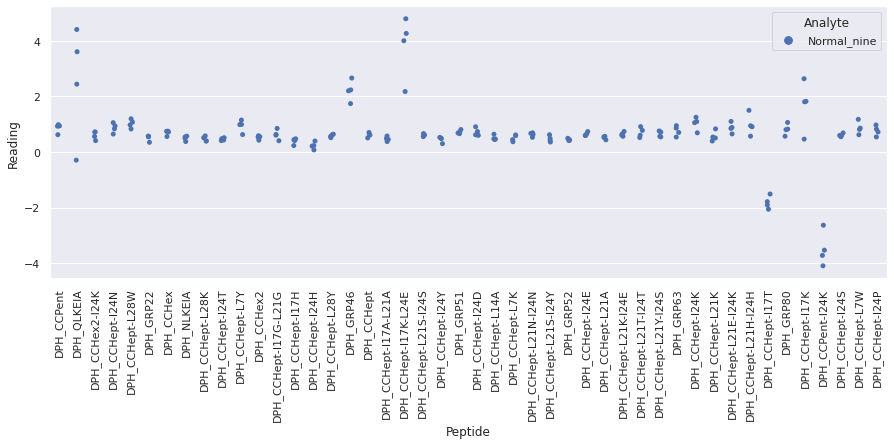

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_one_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

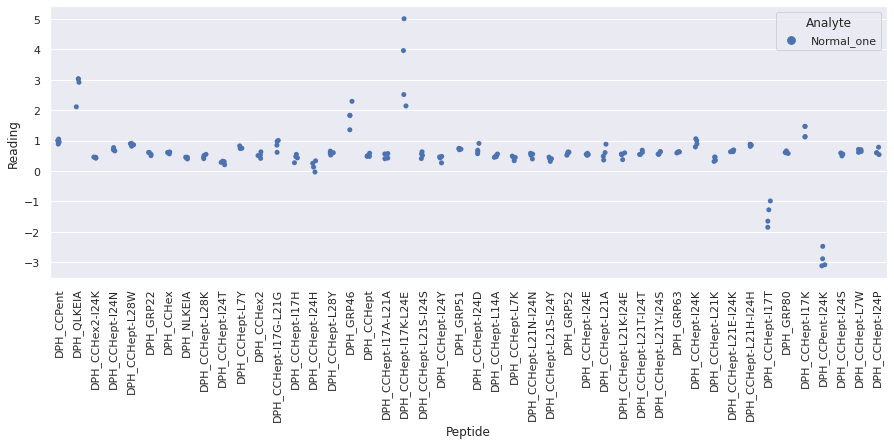

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_seven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

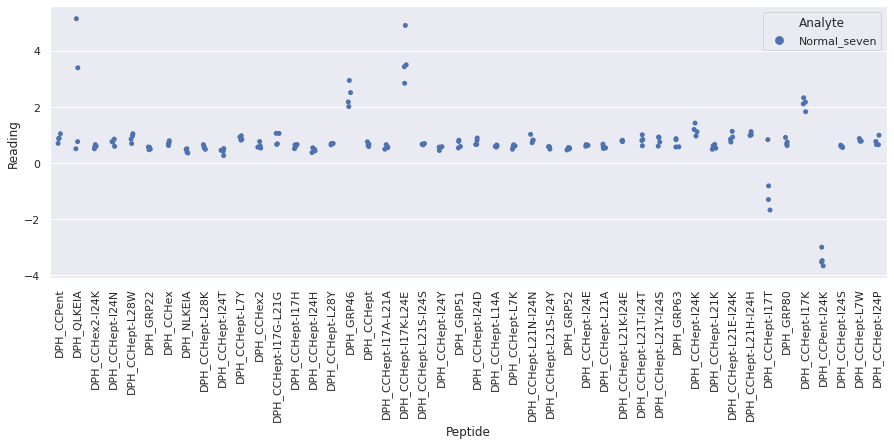

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

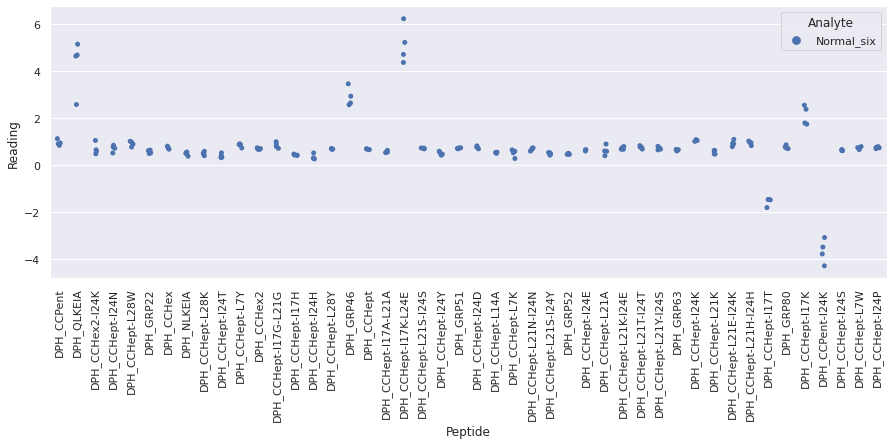

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ten_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

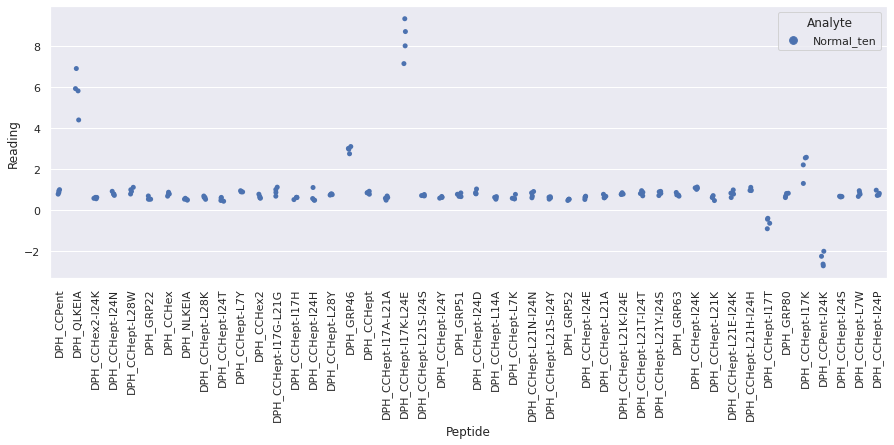

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteen_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

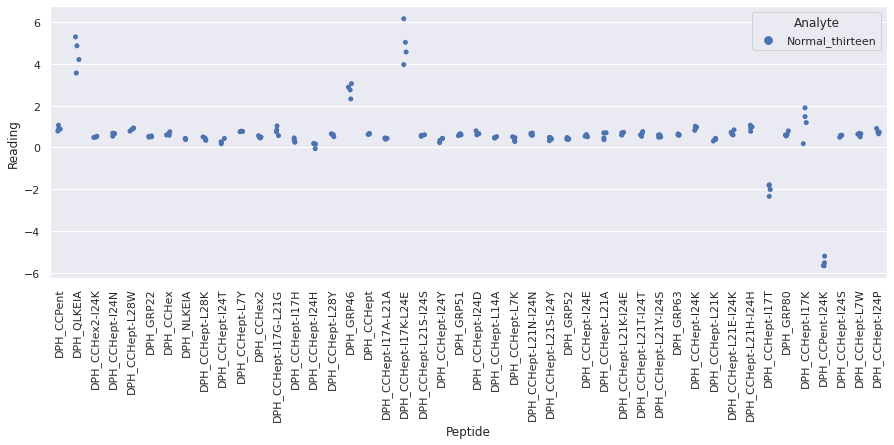

 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirty_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

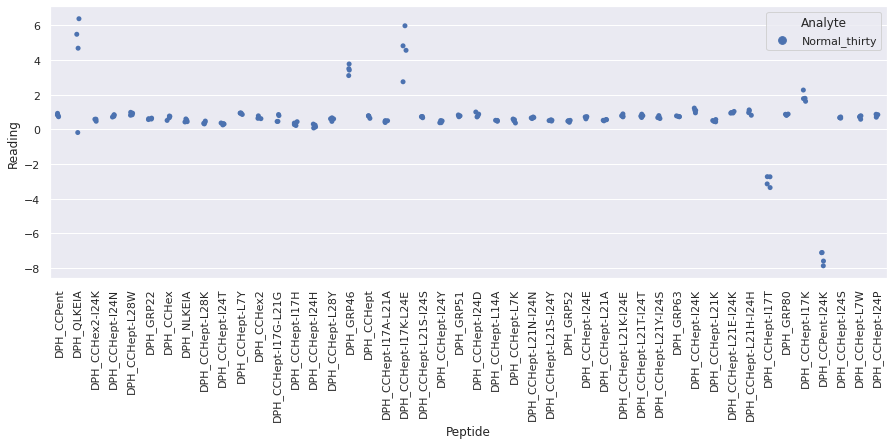

 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_1.xlsx. Analysis will con

<Figure size 720x720 with 0 Axes>

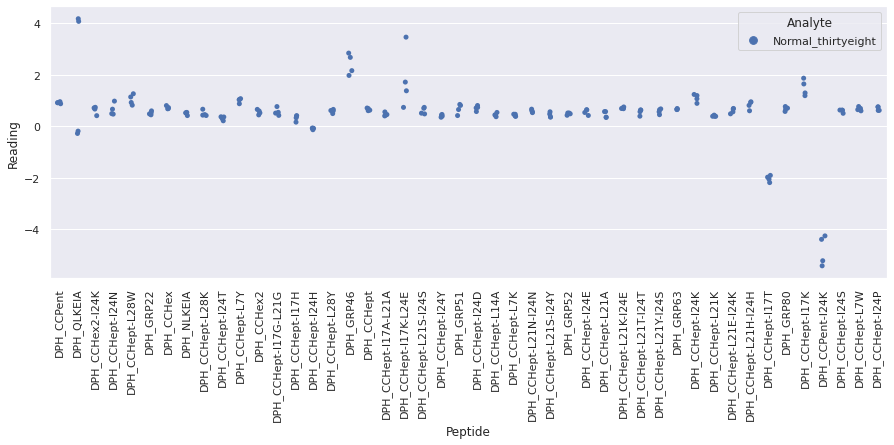

 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

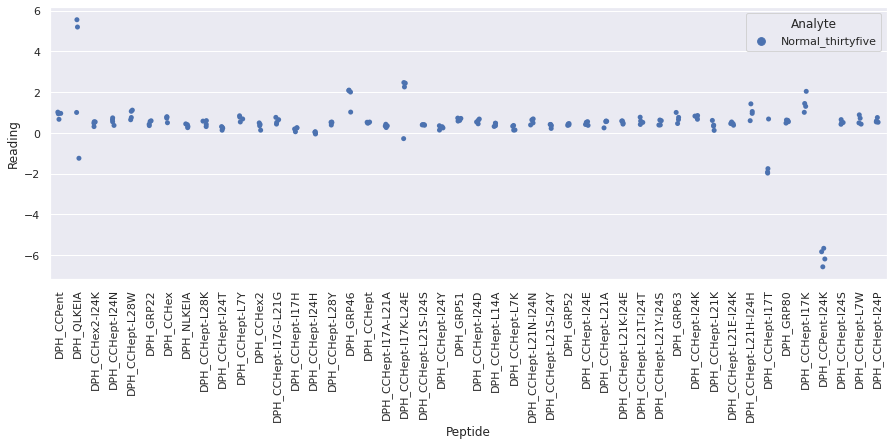

 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

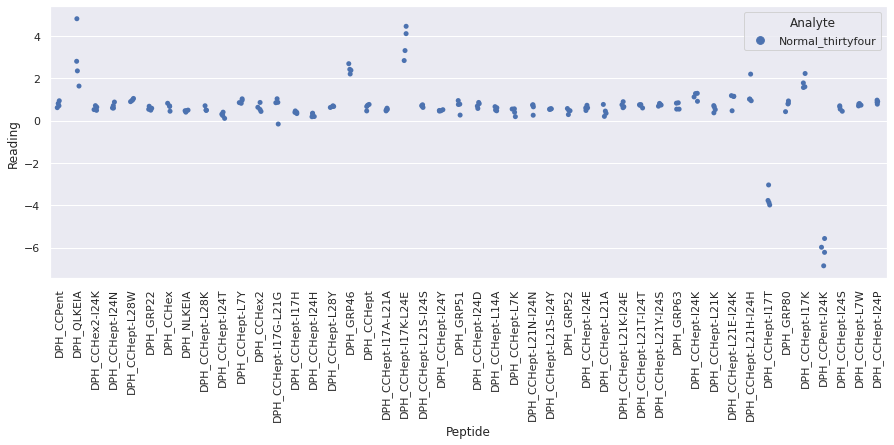

 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_1.xlsx. Analysis will continue but

<Figure size 720x720 with 0 Axes>

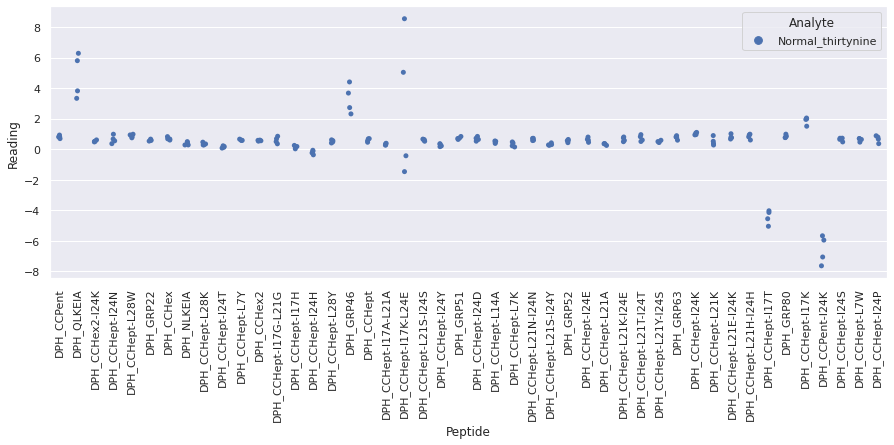

 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyone_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

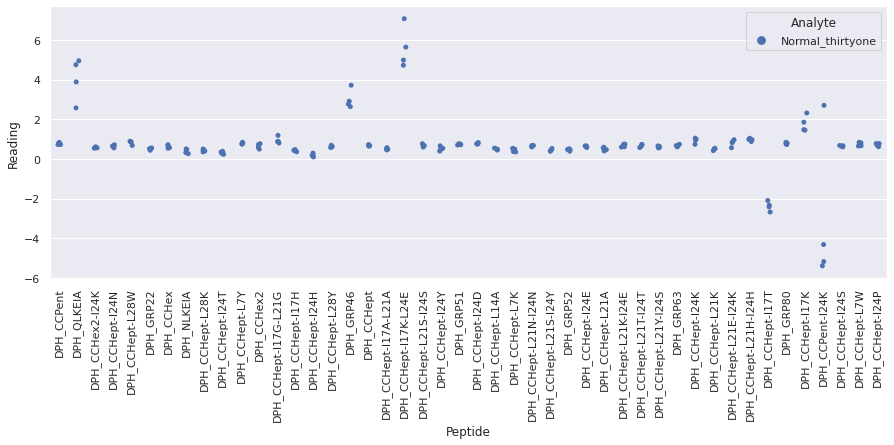

 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyseven_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

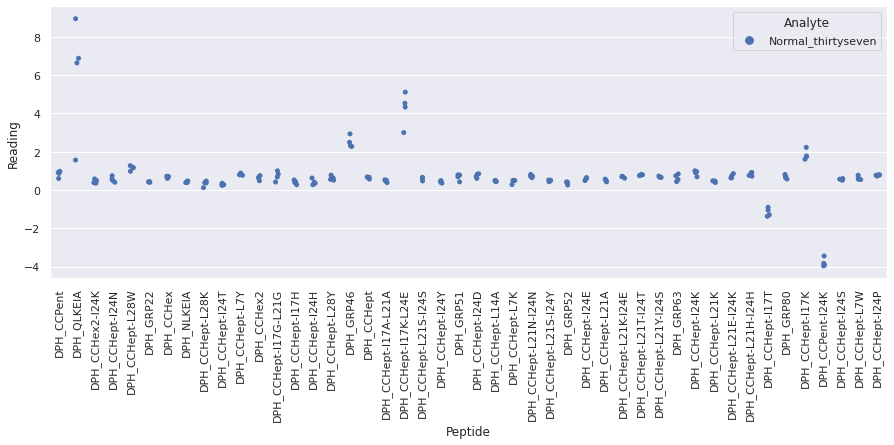

 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysix_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

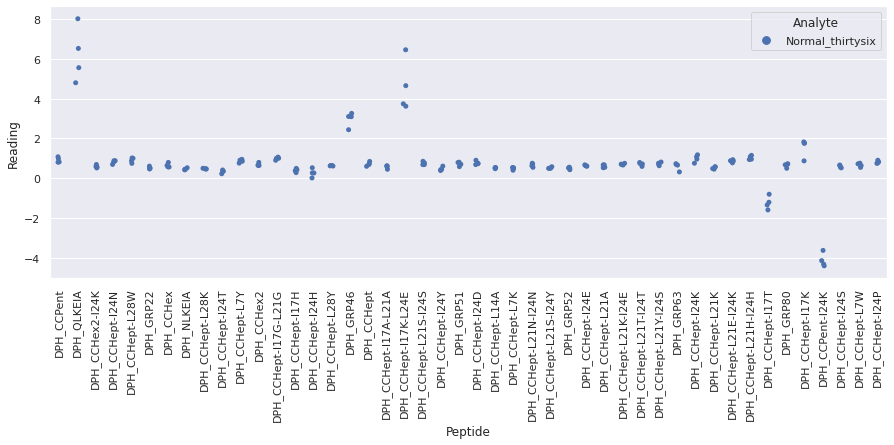

 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtythree_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

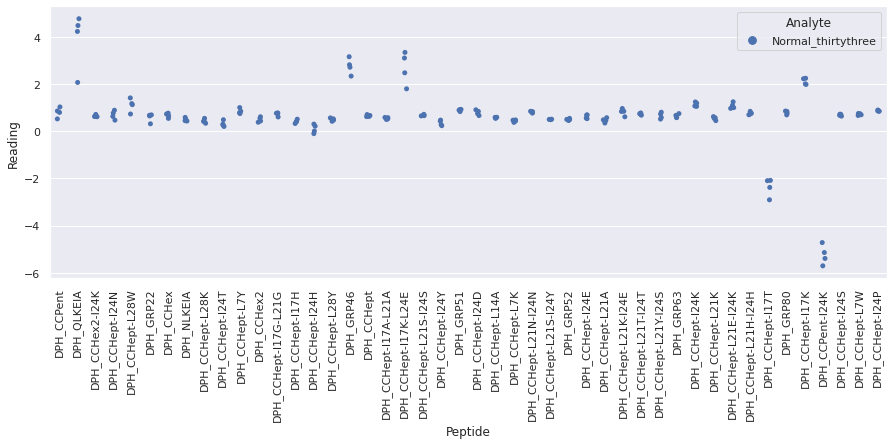

 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_1.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

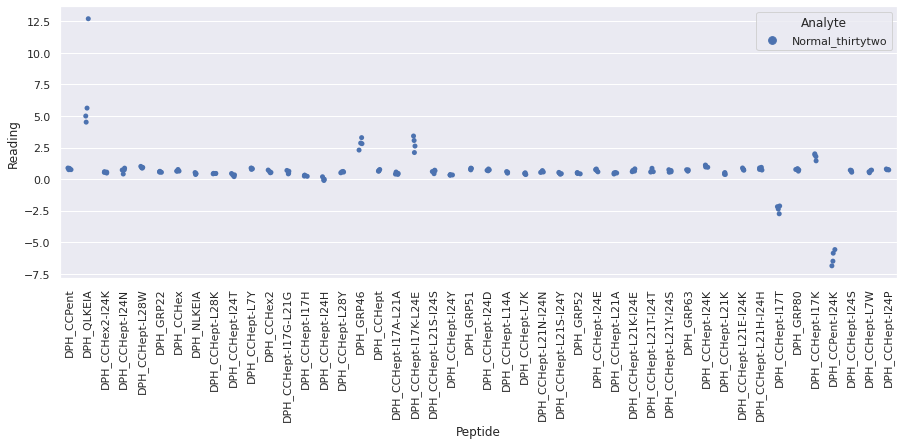

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

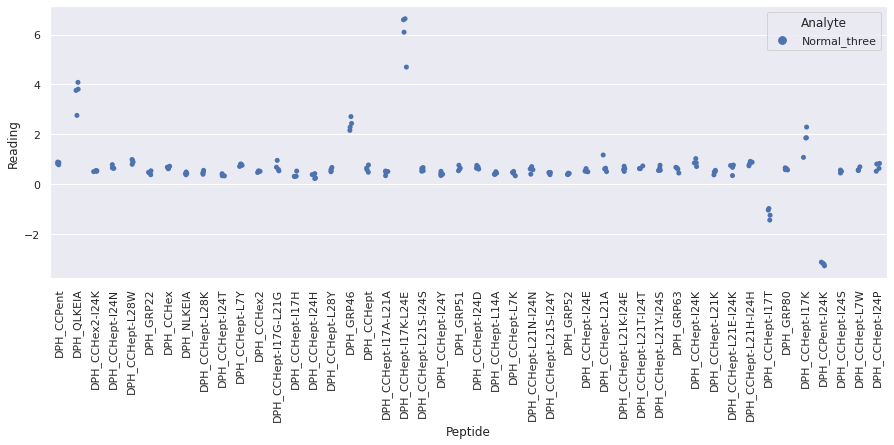

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

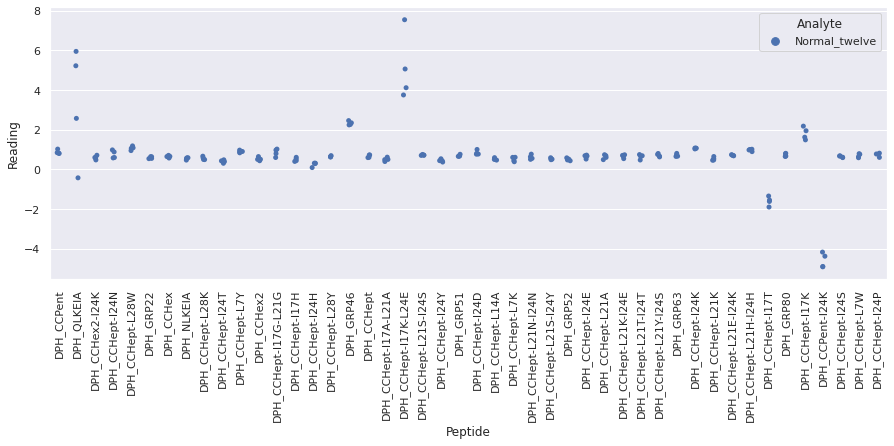

 WARNING - median fluorescence of (Normal_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynine_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

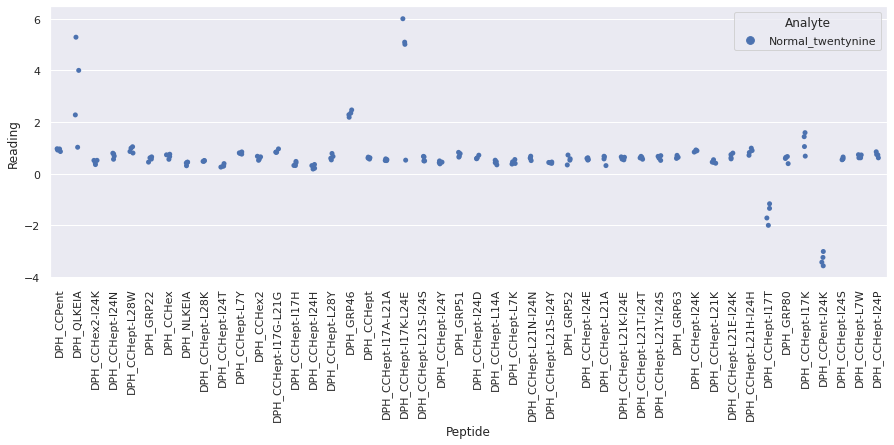

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_two_repeat_1 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

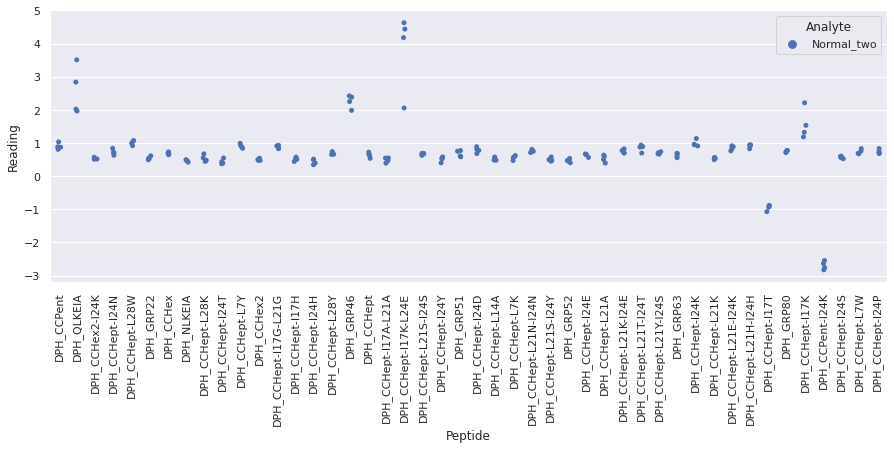

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_eighteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

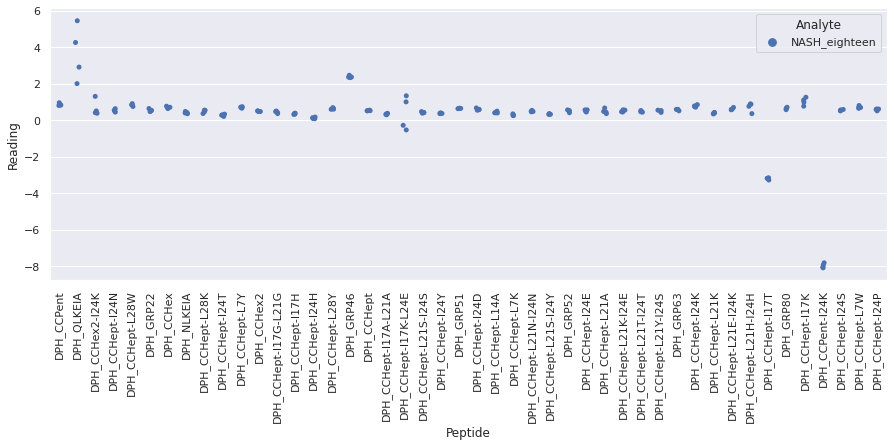

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

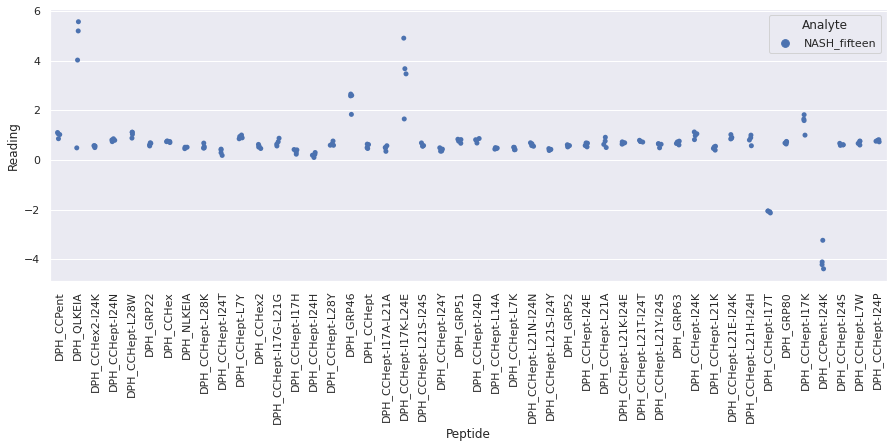

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_nineteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

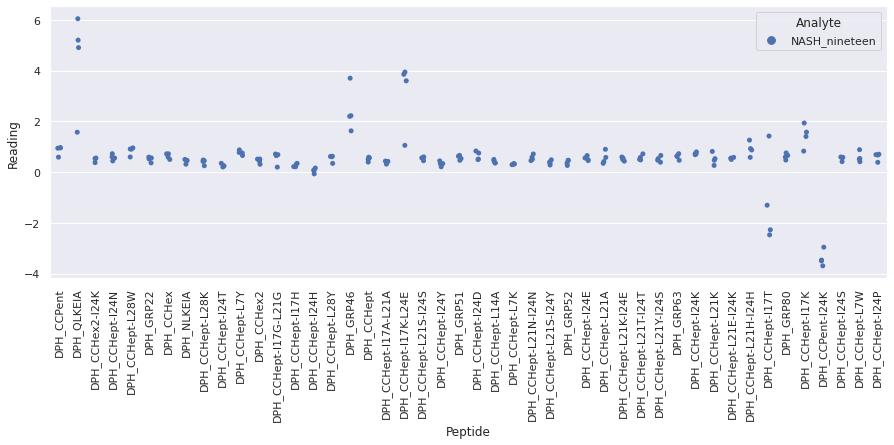

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

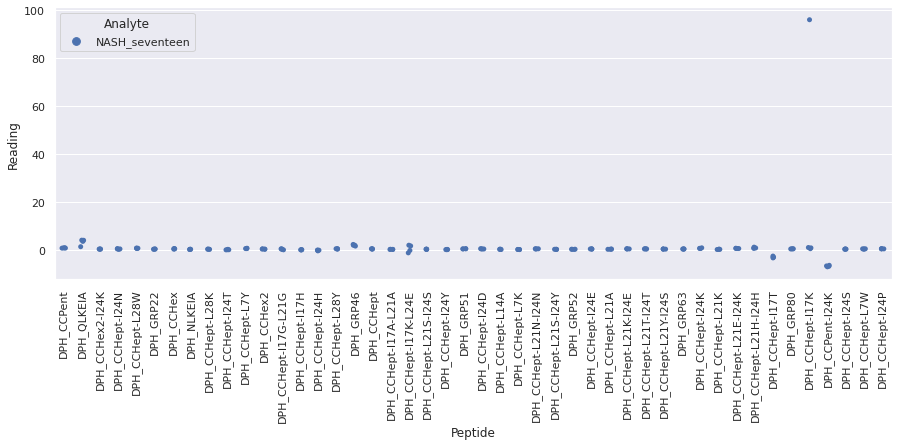

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

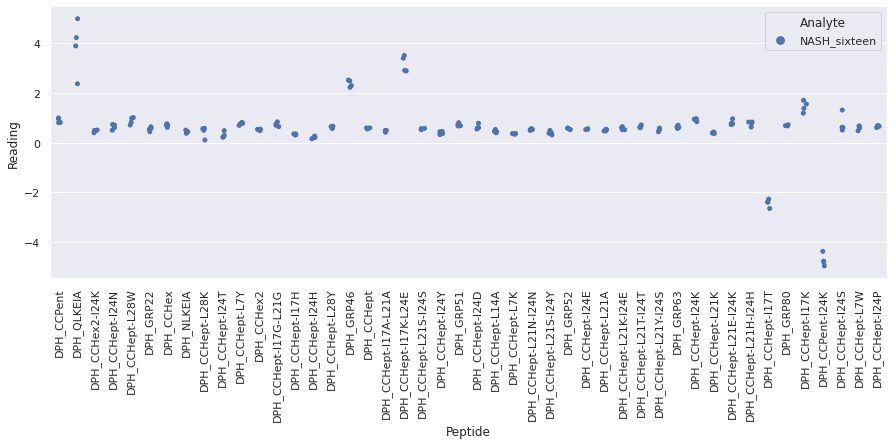

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

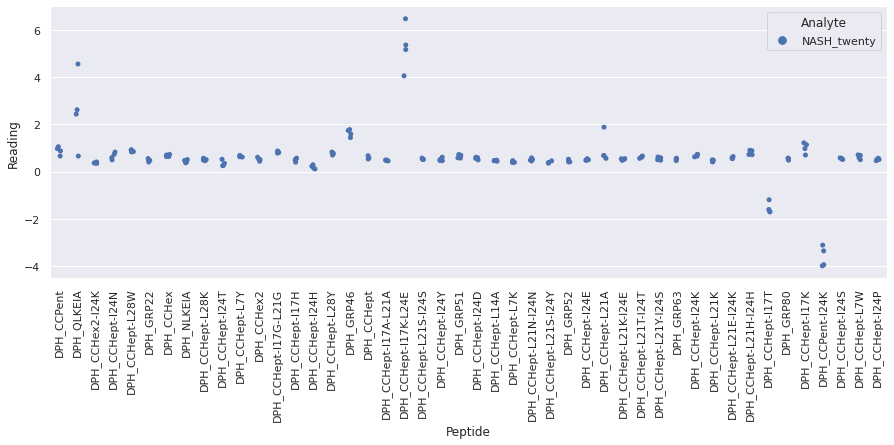

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyeight_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

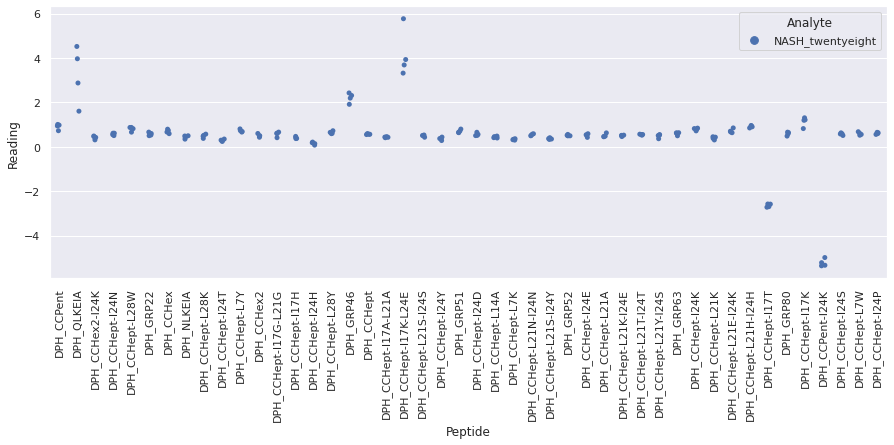

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfive_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

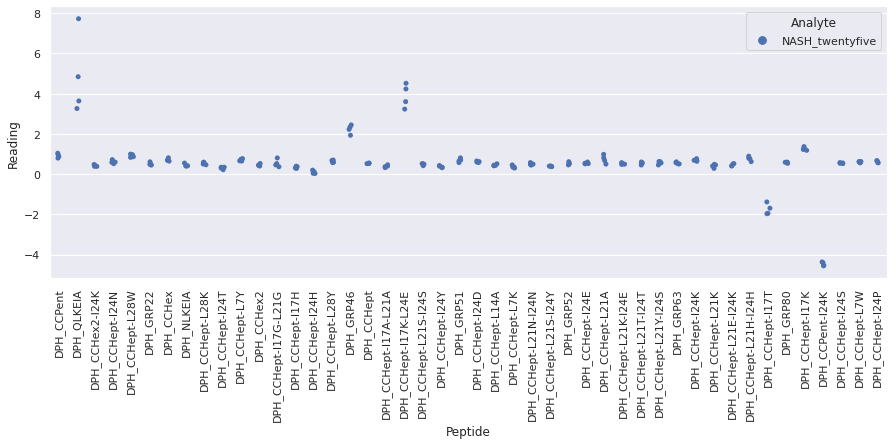

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

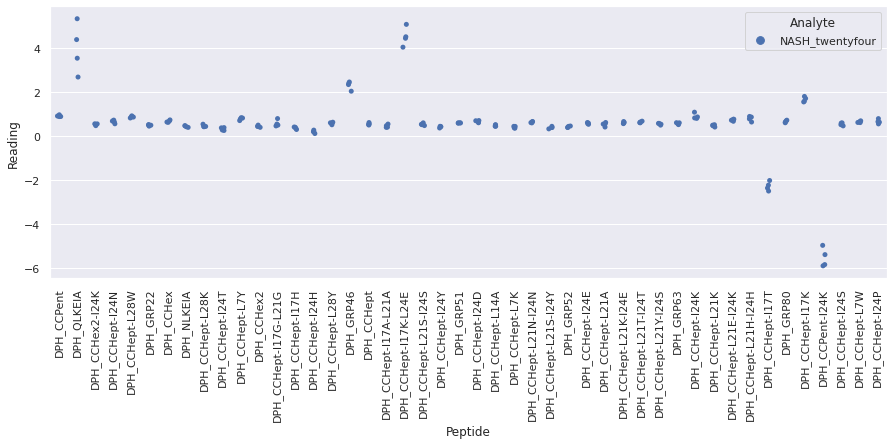

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

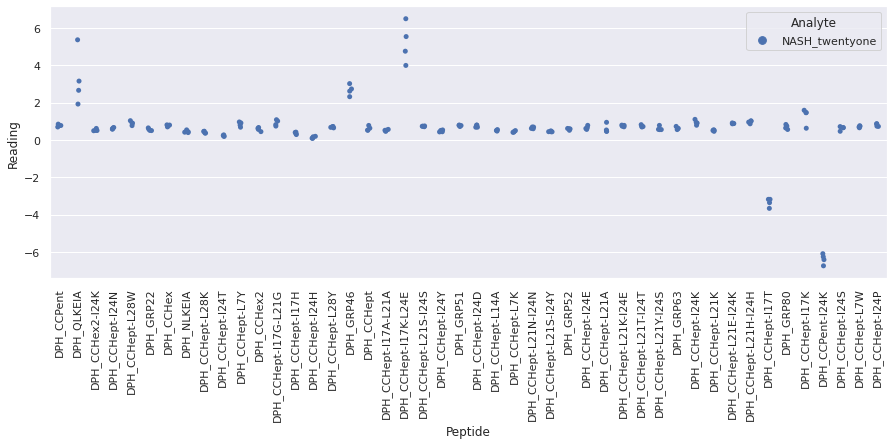

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyseven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

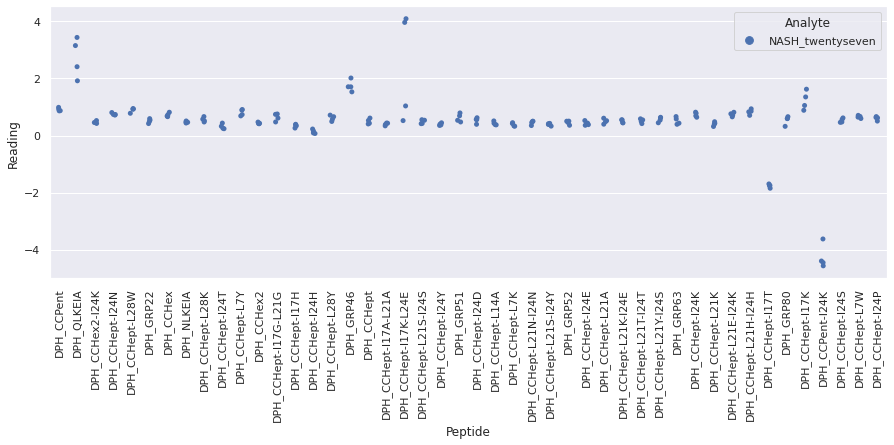

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

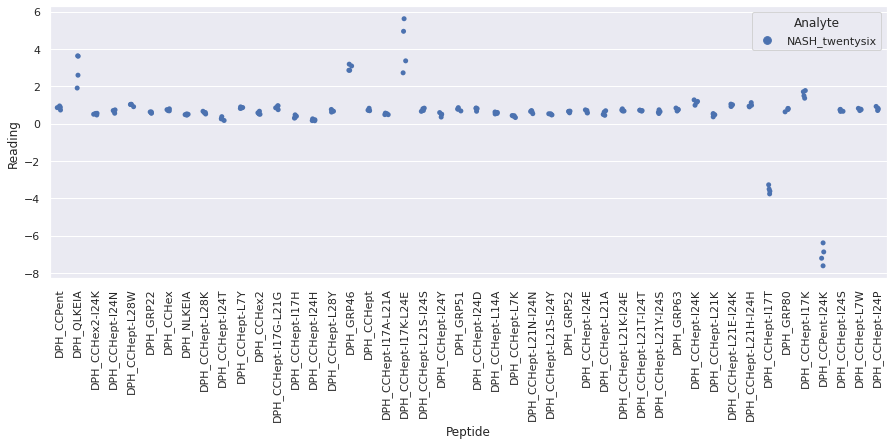

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentythree_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

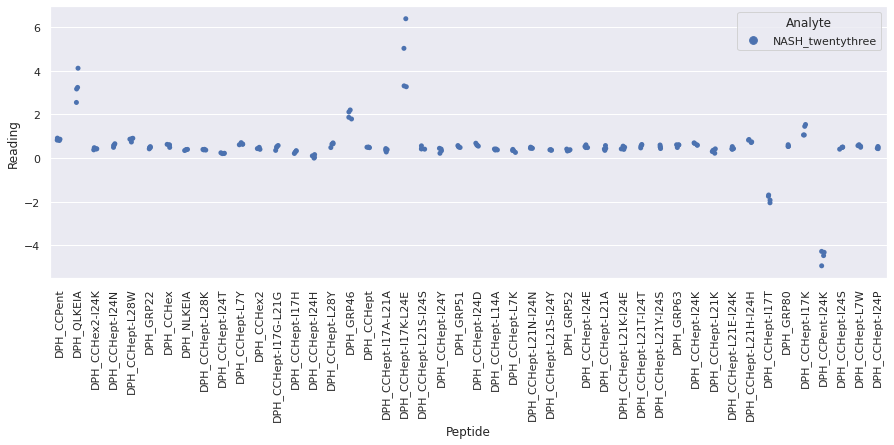

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

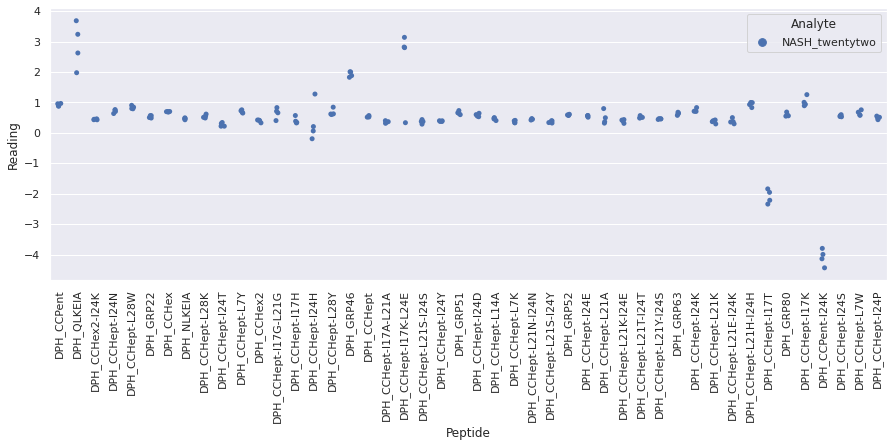

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

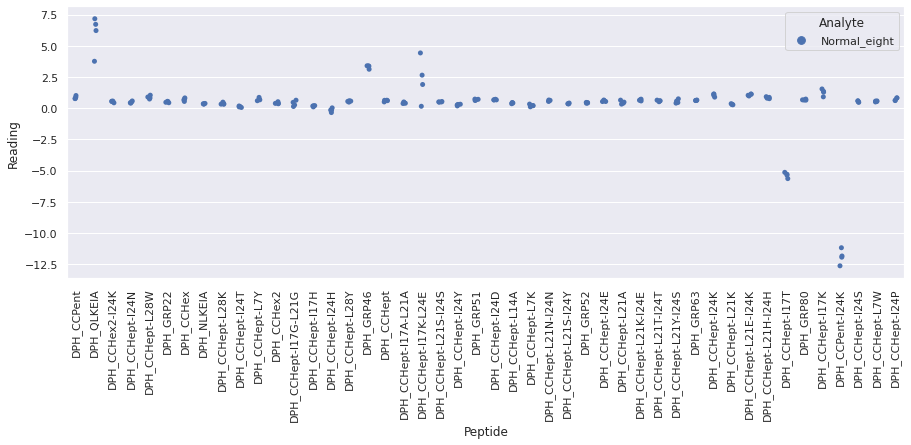

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

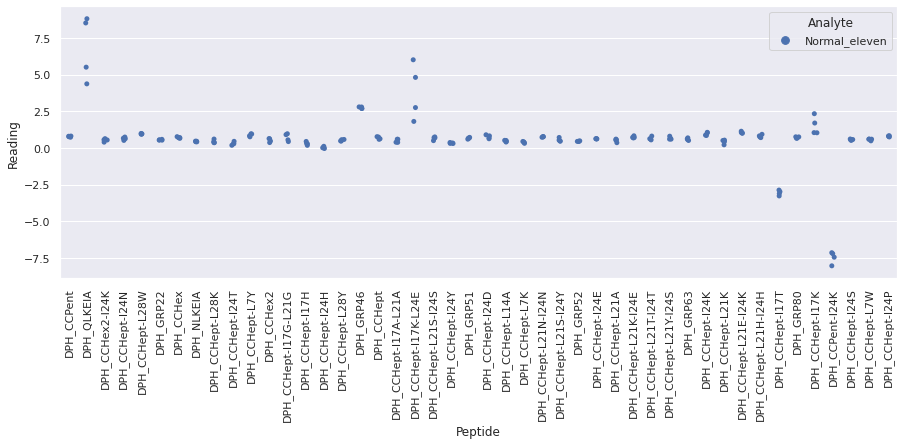

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

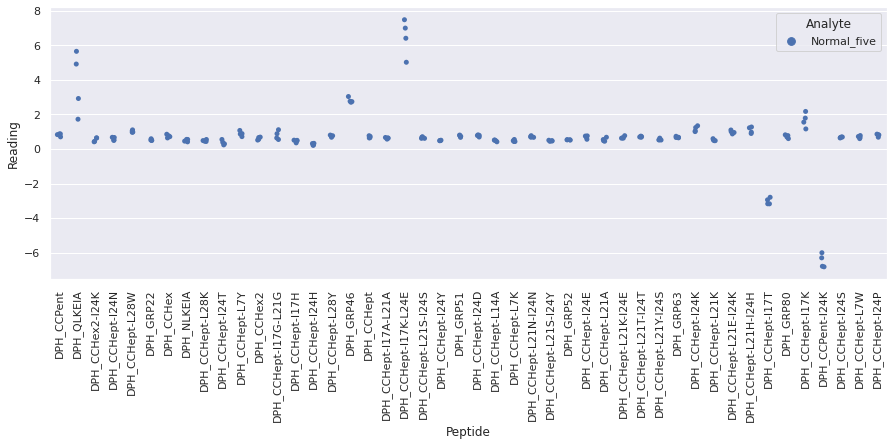

 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - med

<Figure size 720x720 with 0 Axes>

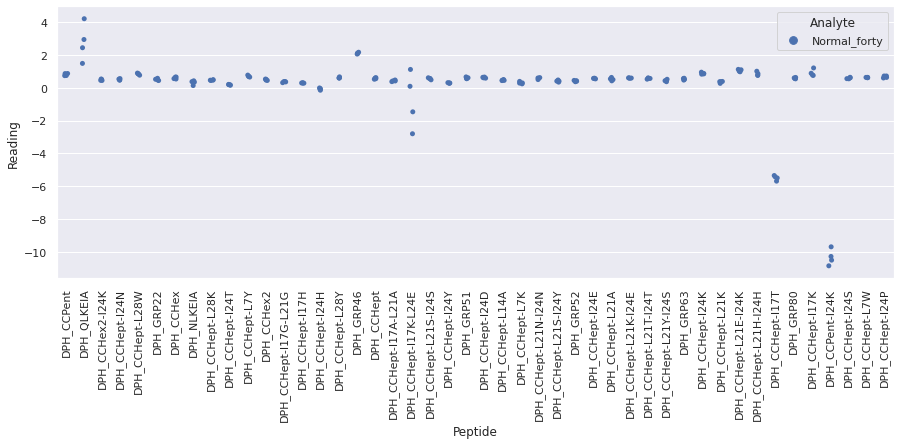

 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

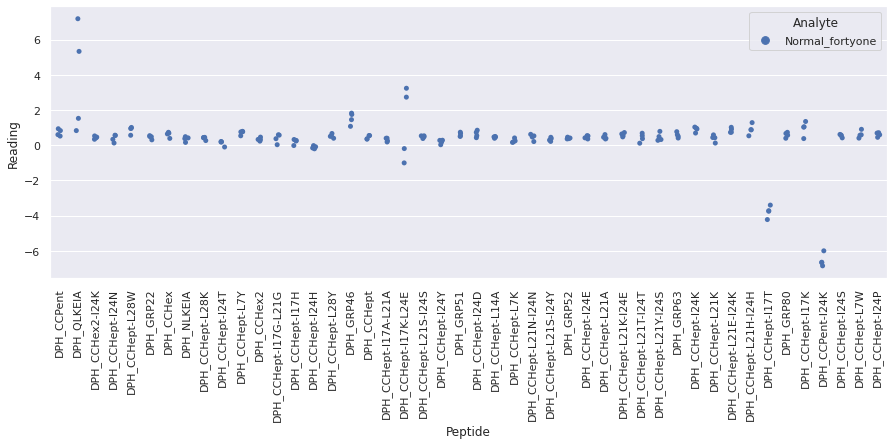

 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

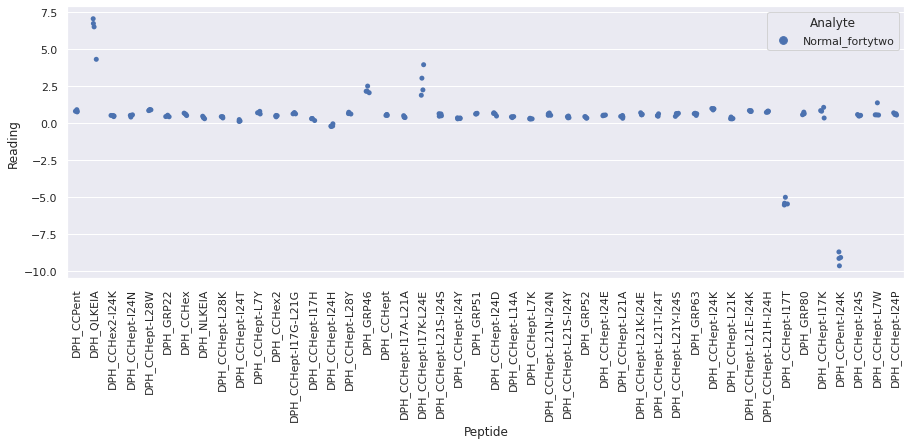

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

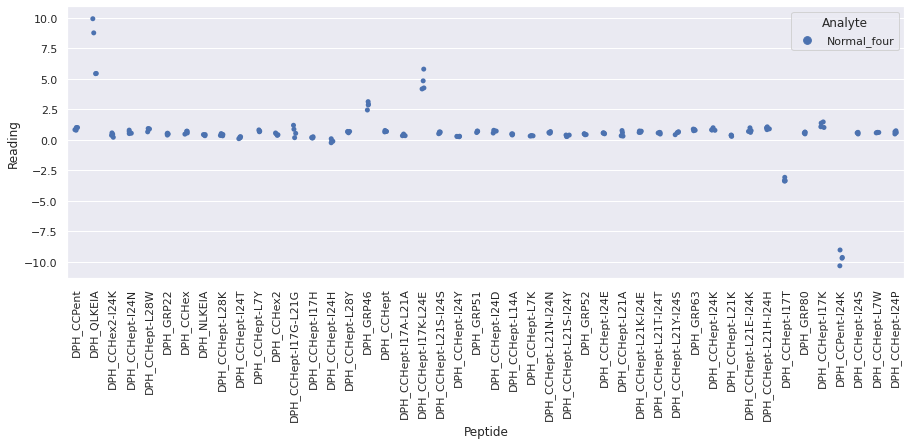

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

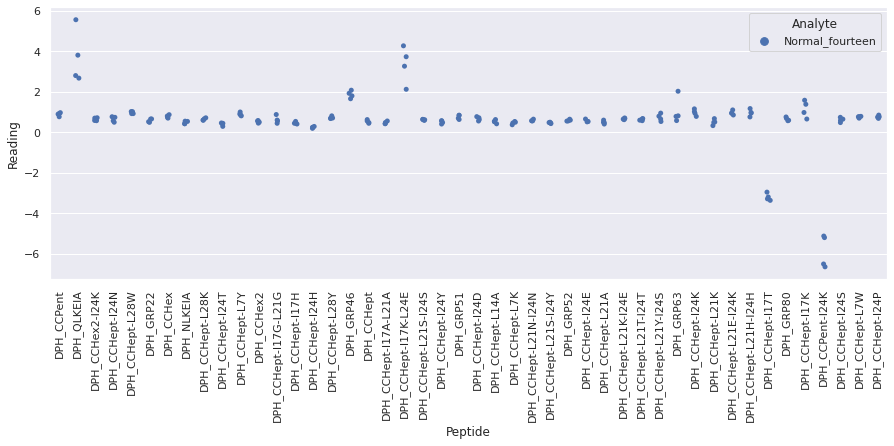

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

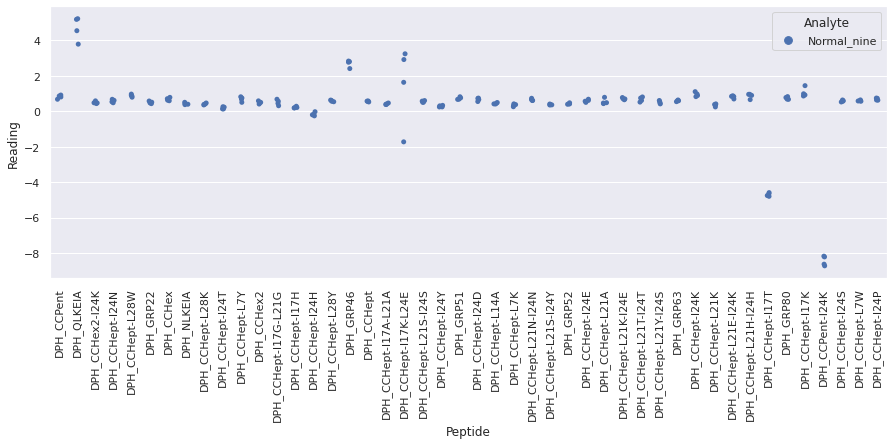

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_one_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

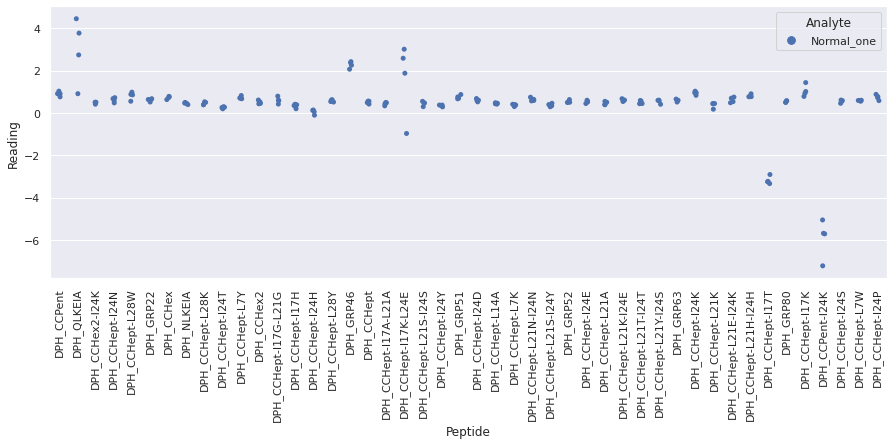

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_seven_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

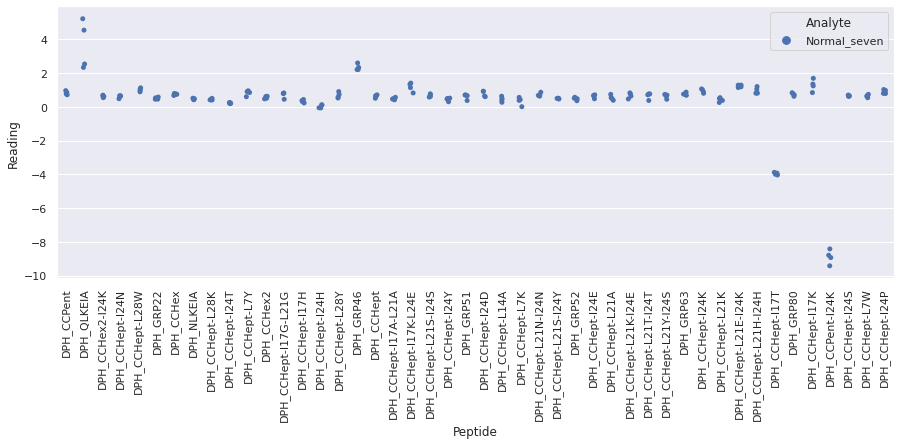

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

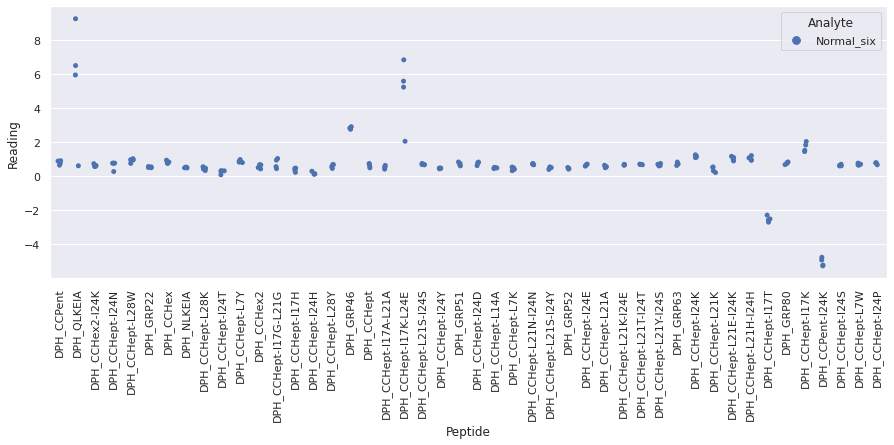

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_ten_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

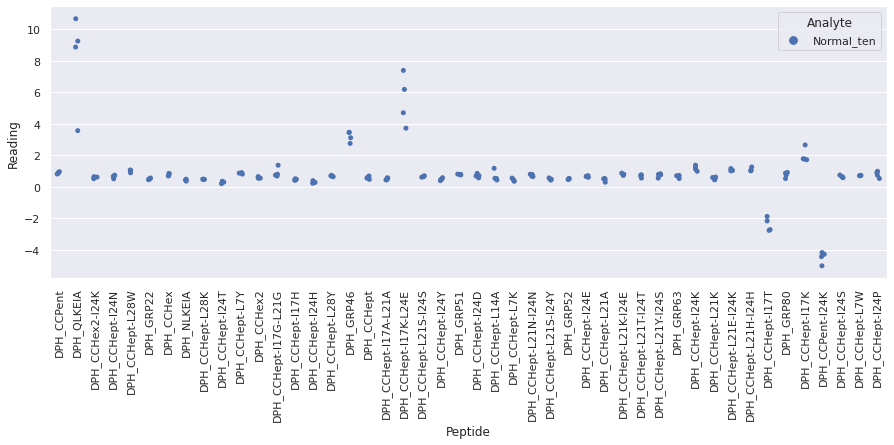

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirteen_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

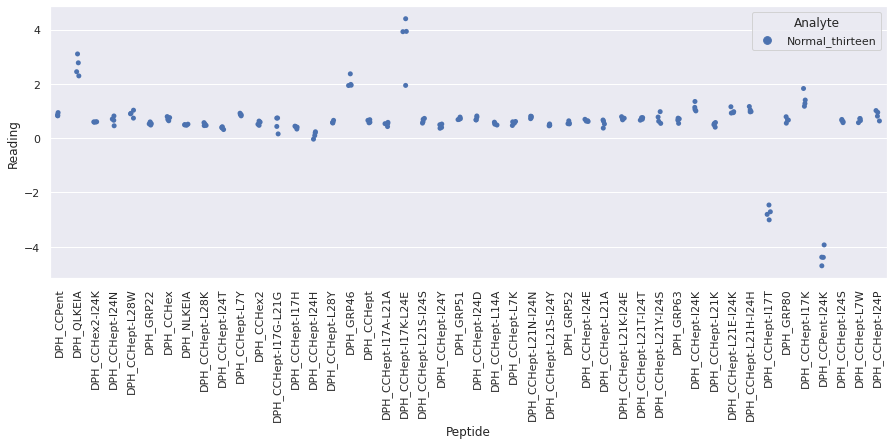

 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

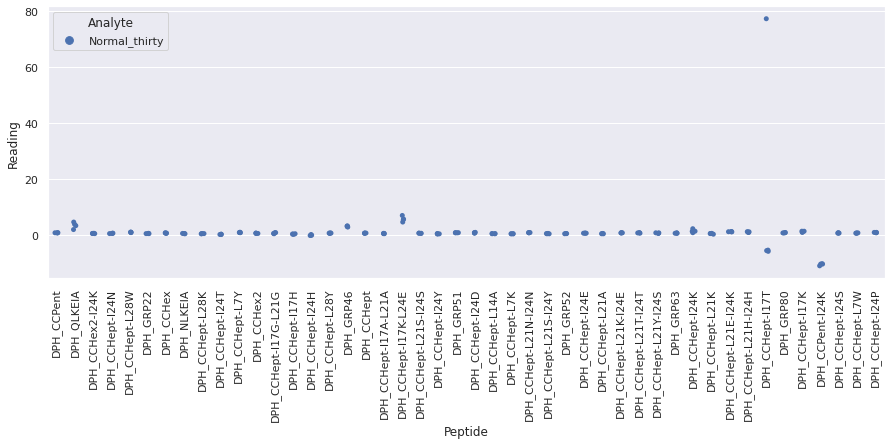

 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyeight_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

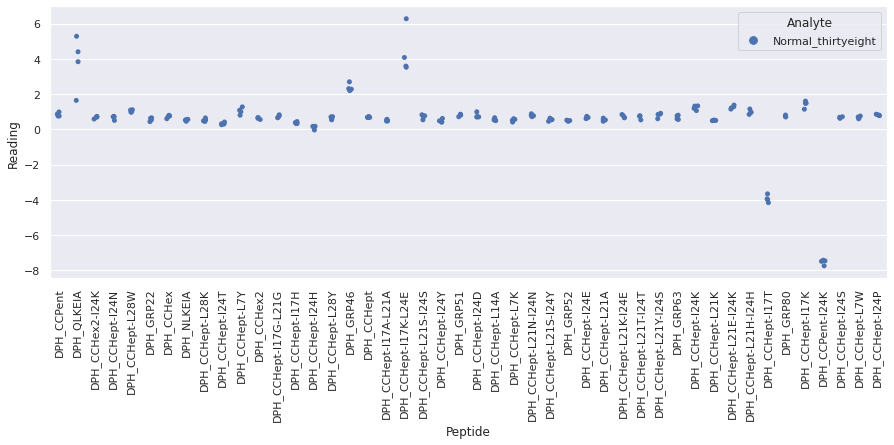

 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfive_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

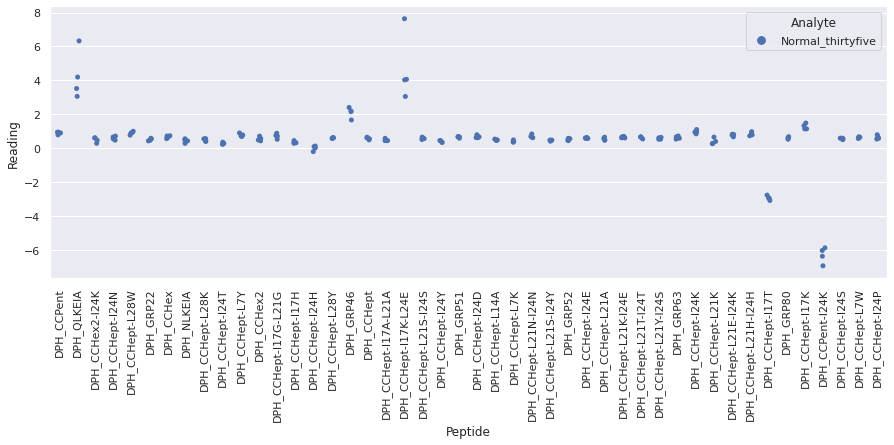

 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyfour_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

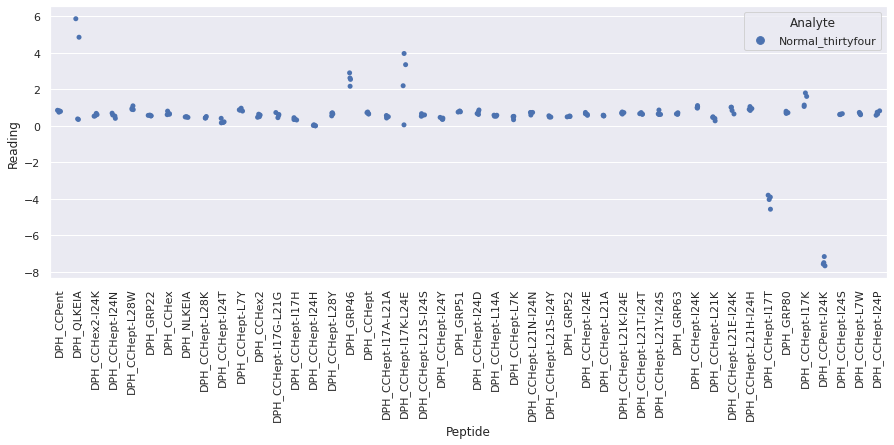

 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_2.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

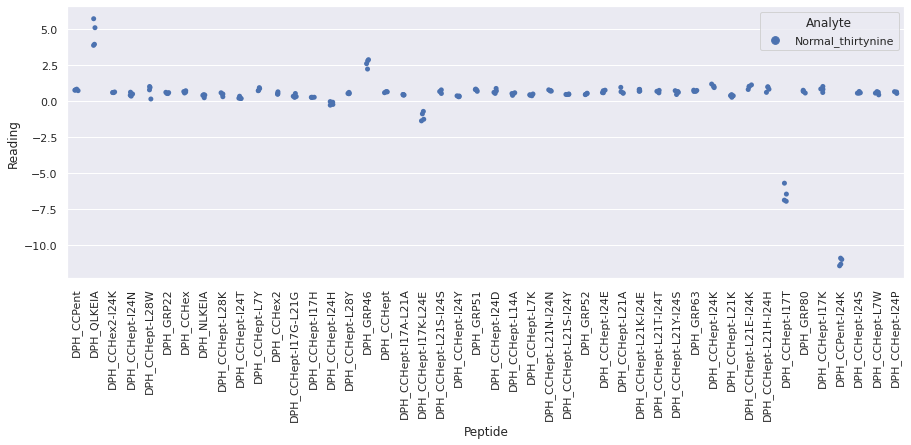

 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyone_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

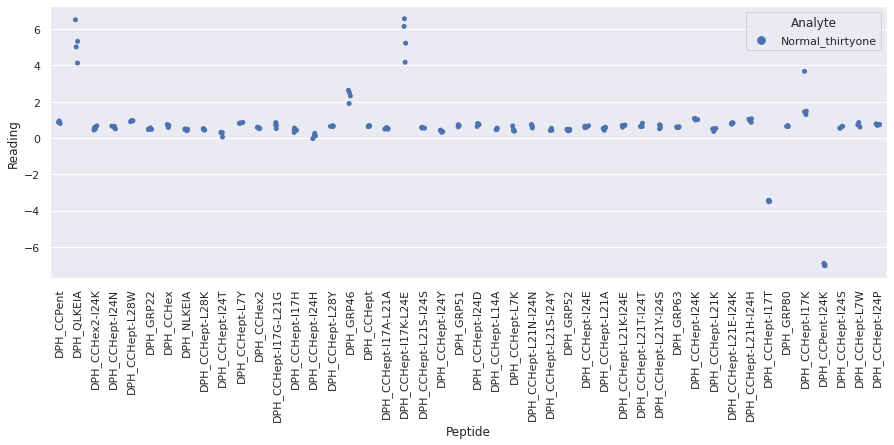

 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_2.xlsx. Analysis will con

<Figure size 720x720 with 0 Axes>

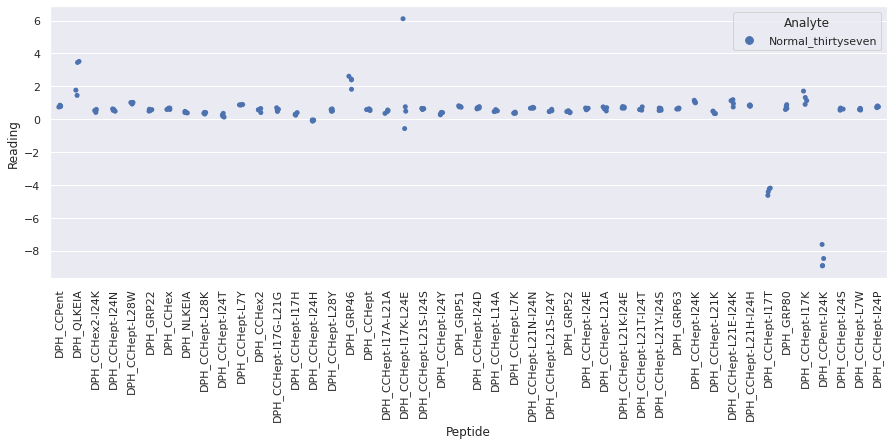

 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysix_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

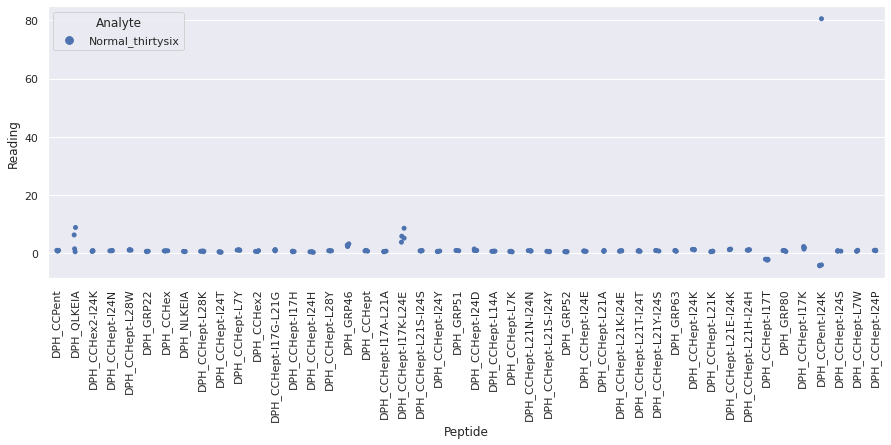

 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_2.xlsx. Analysis will con

<Figure size 720x720 with 0 Axes>

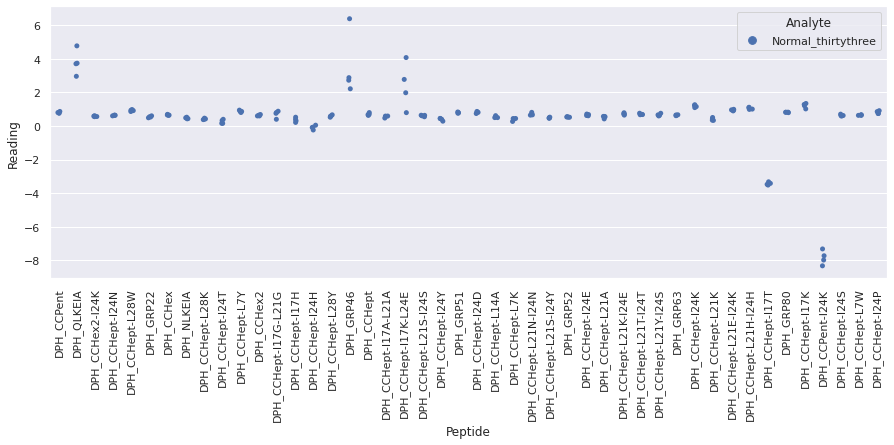

 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtytwo_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

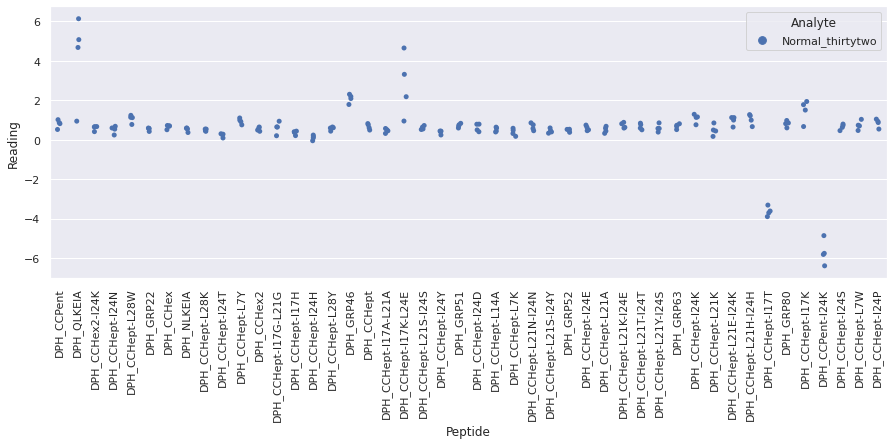

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

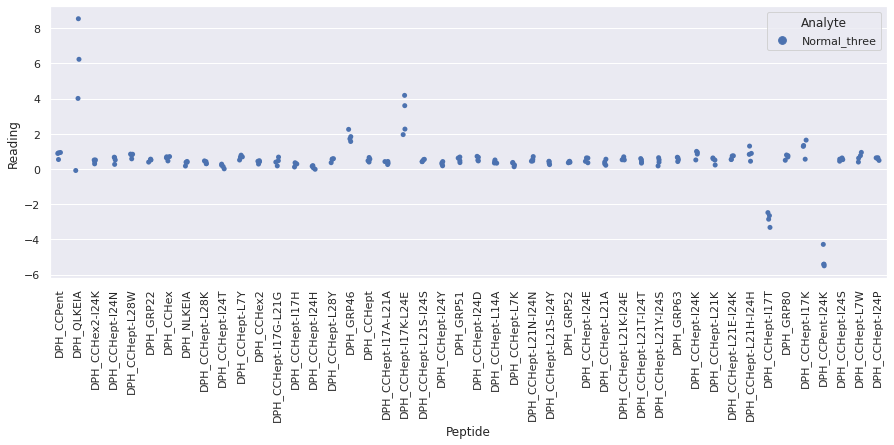

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

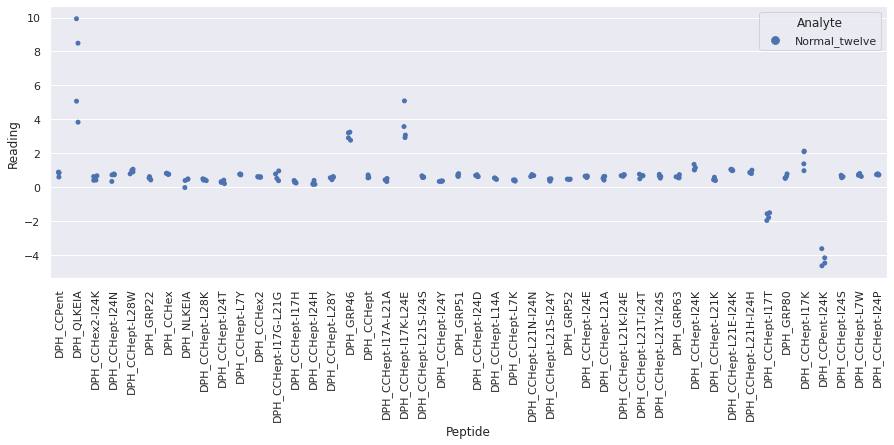

 WARNING - median fluorescence of (Normal_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynine_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

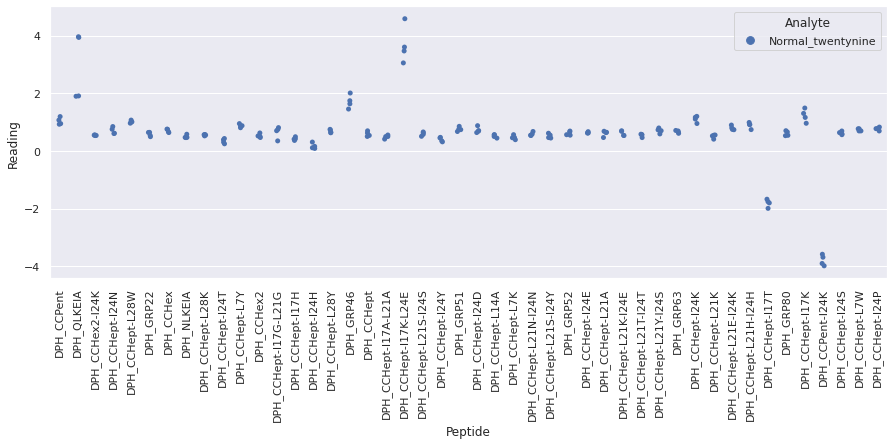

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_2.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_two_repeat_2 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

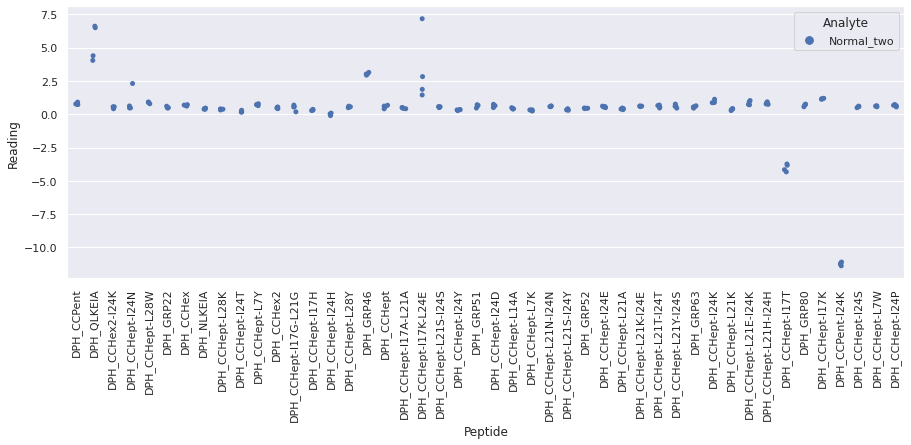

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

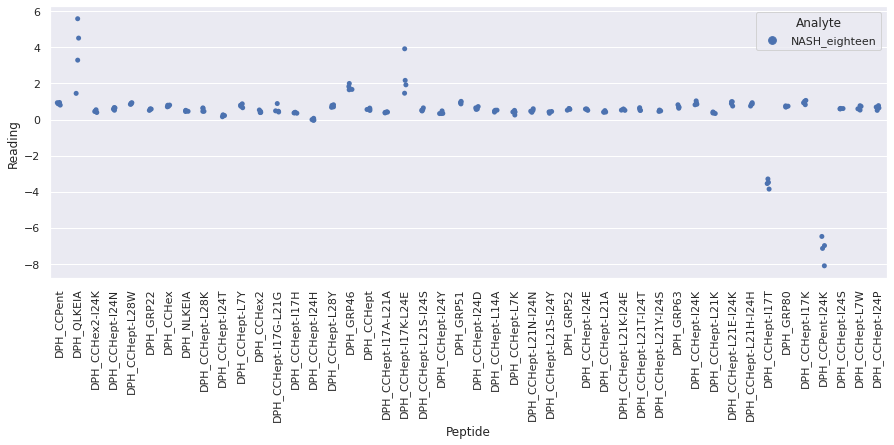

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

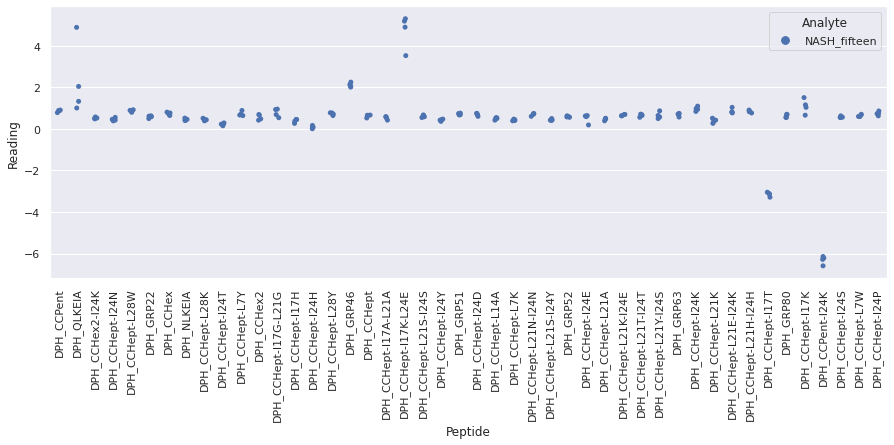

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

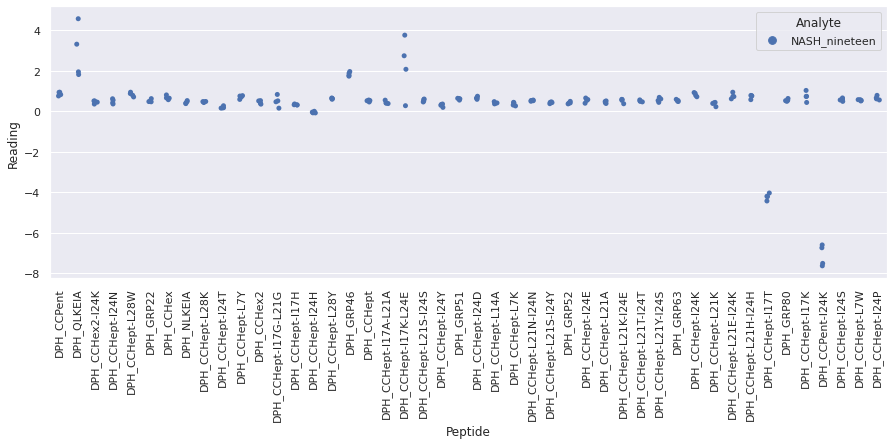

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_seventeen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

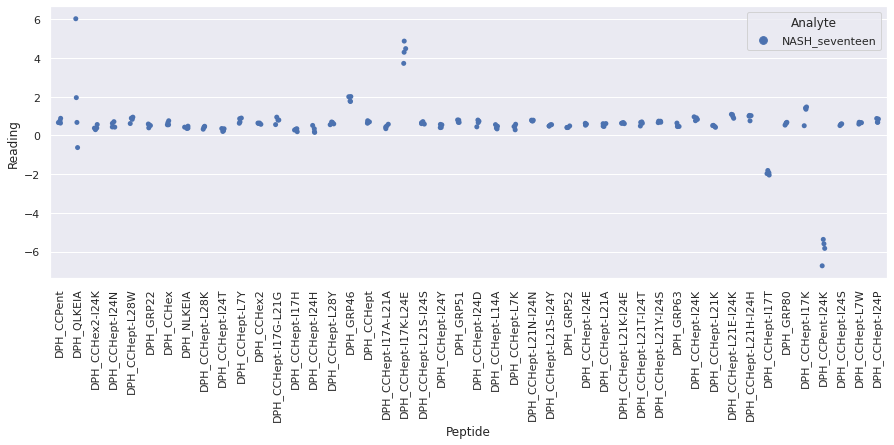

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

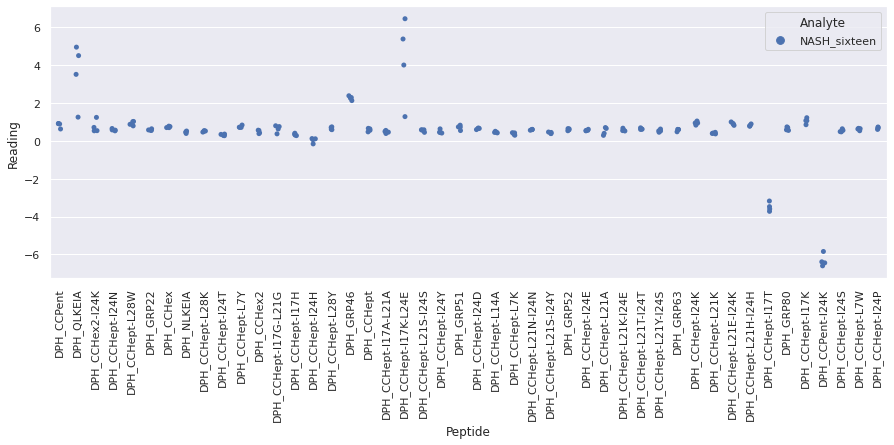

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twenty_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

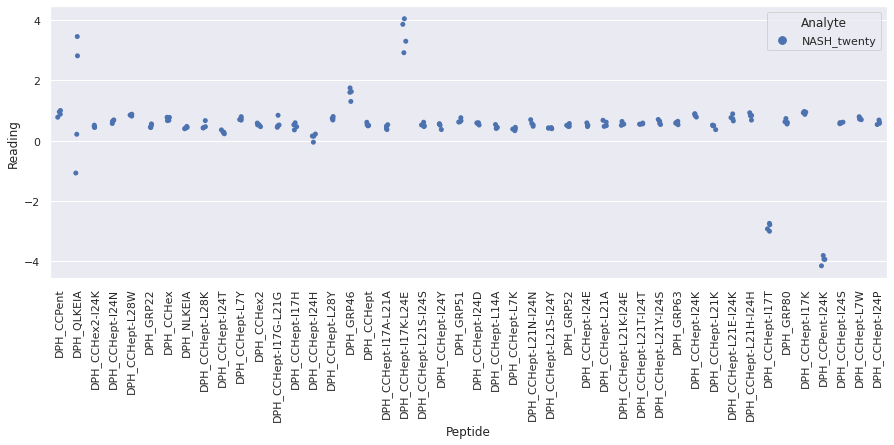

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

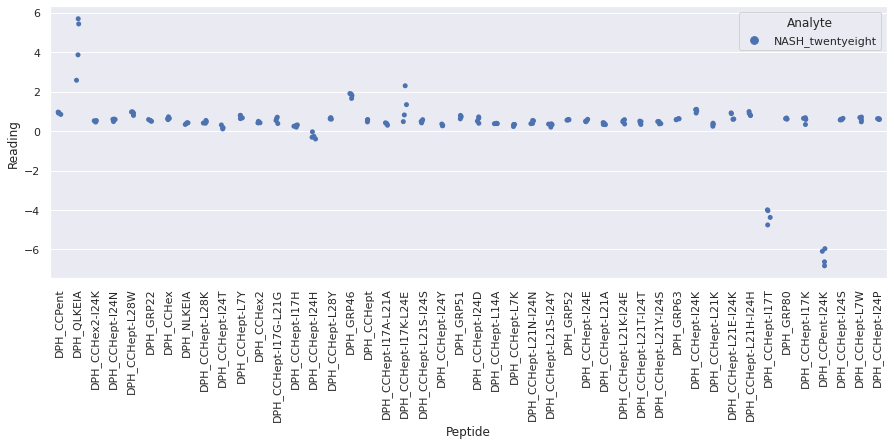

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

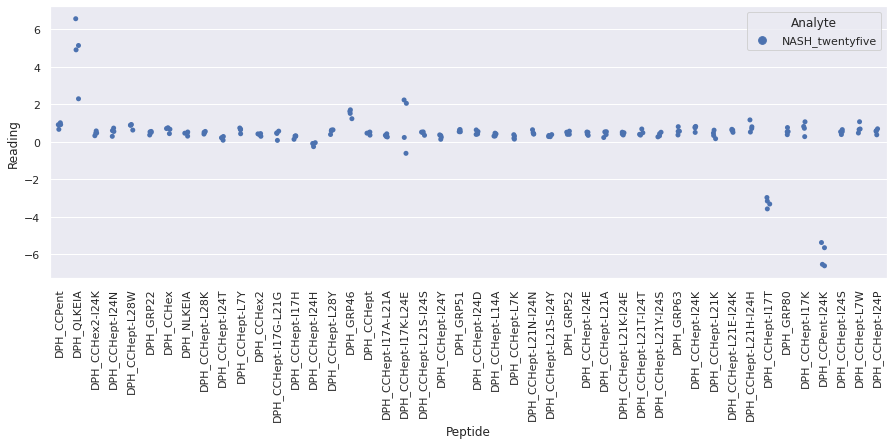

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyfour_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

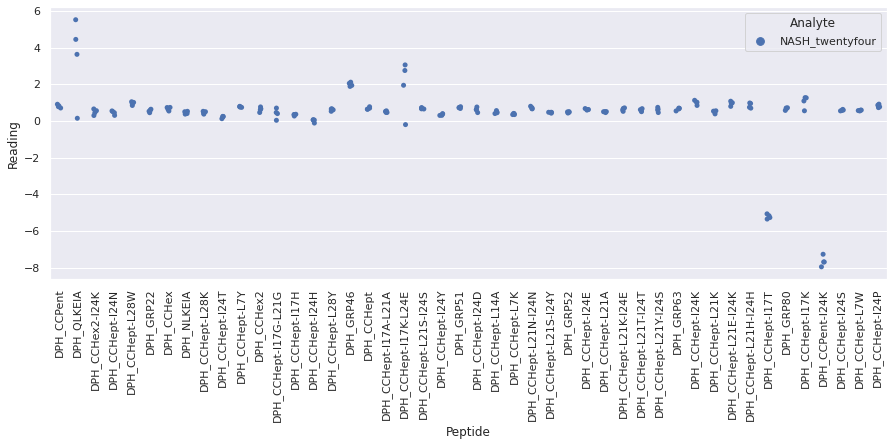

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentyone_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

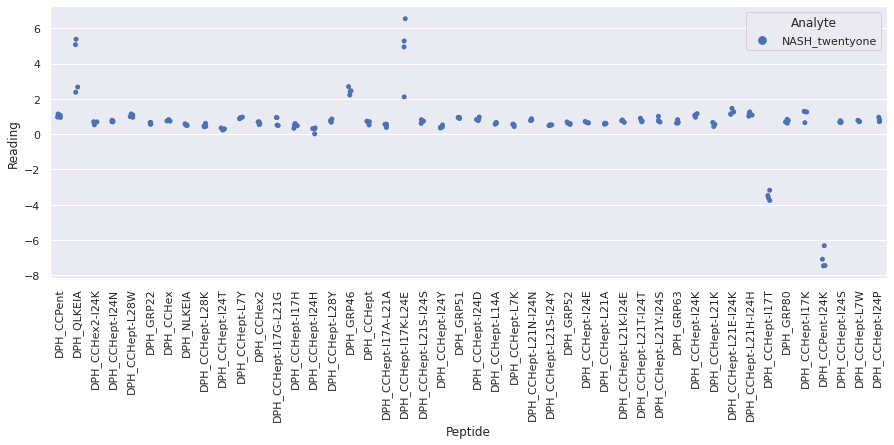

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

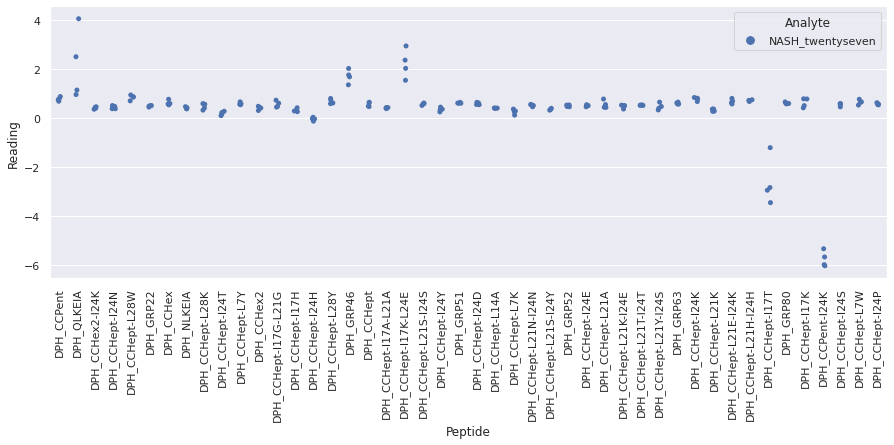

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

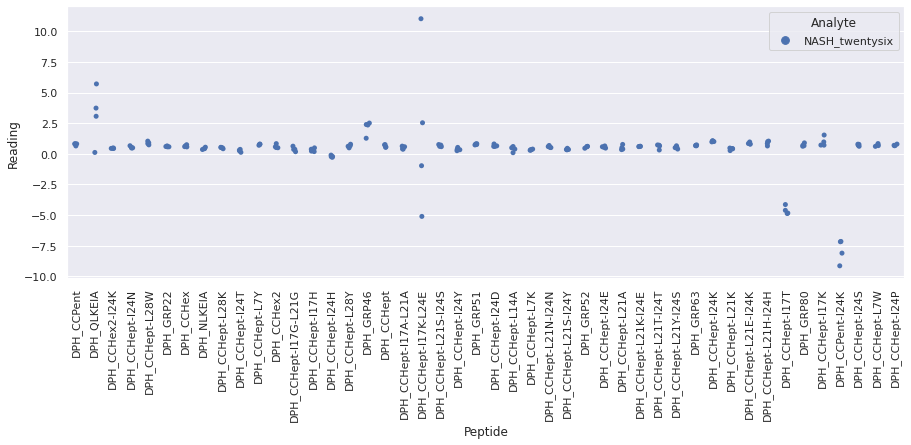

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

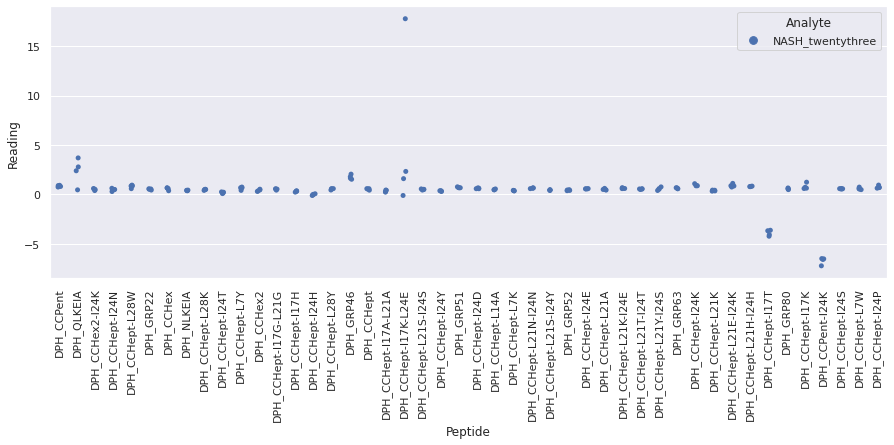

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentytwo_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

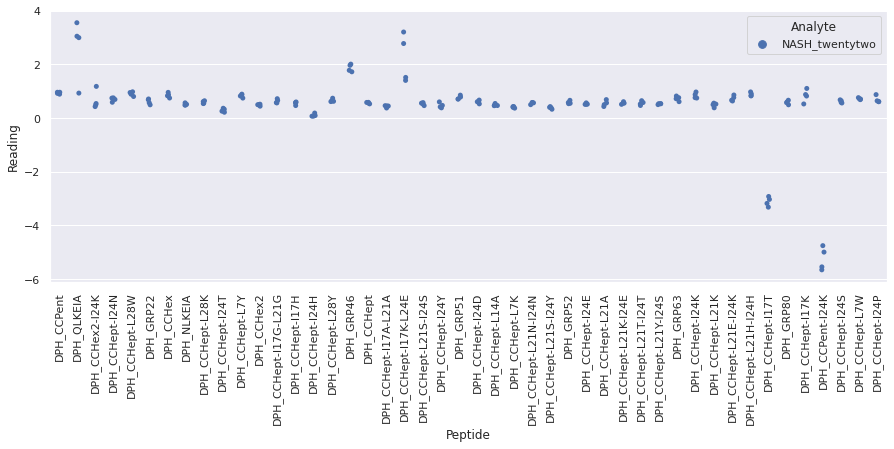

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eight_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

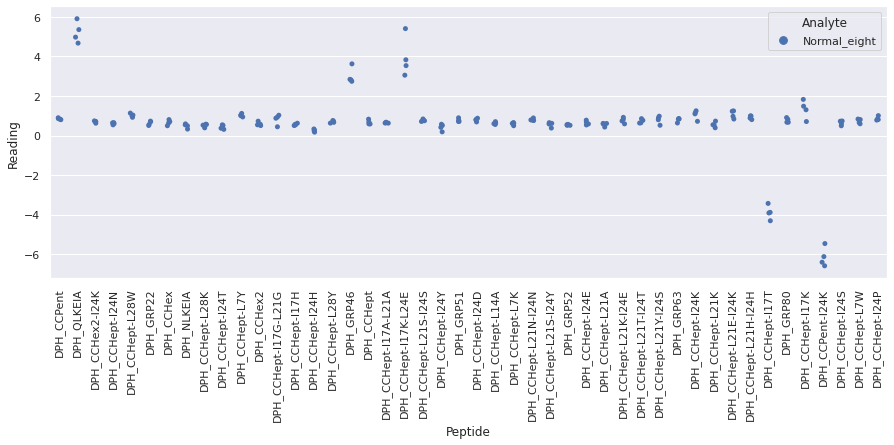

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

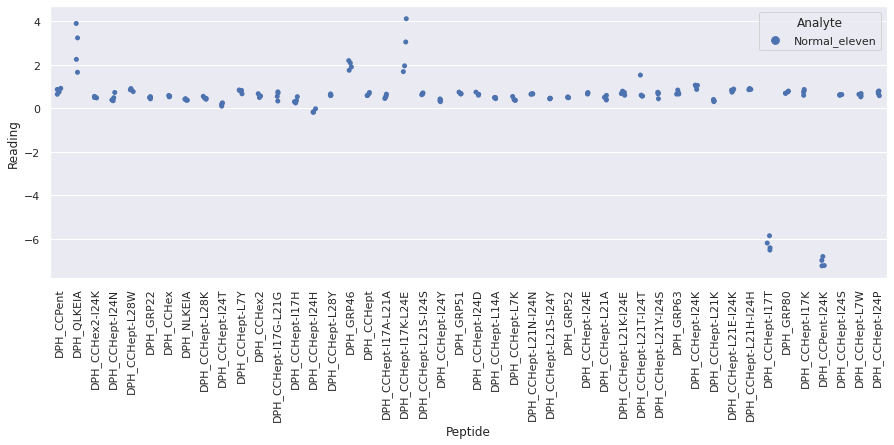

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_five_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

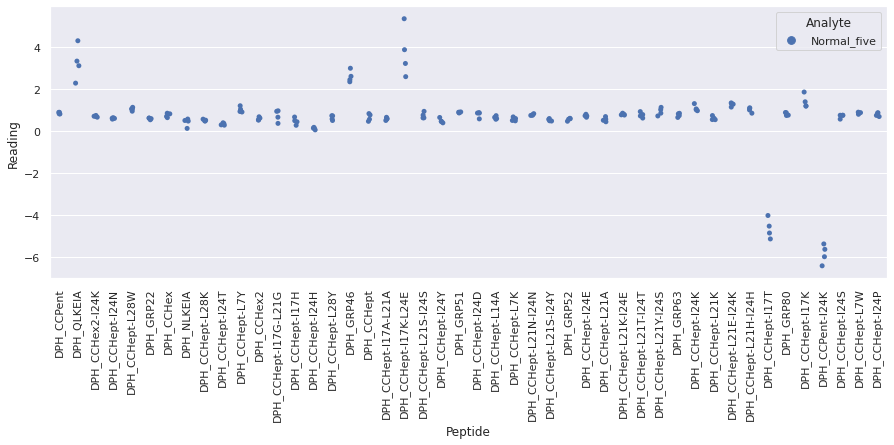

 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

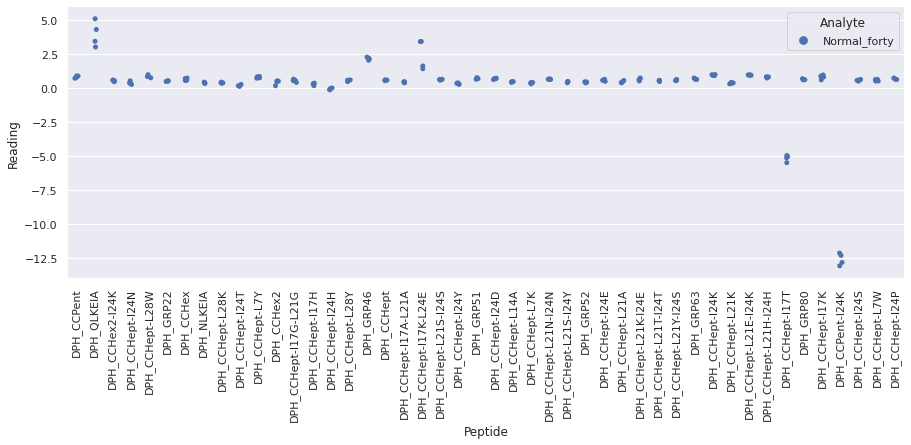

 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_3.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

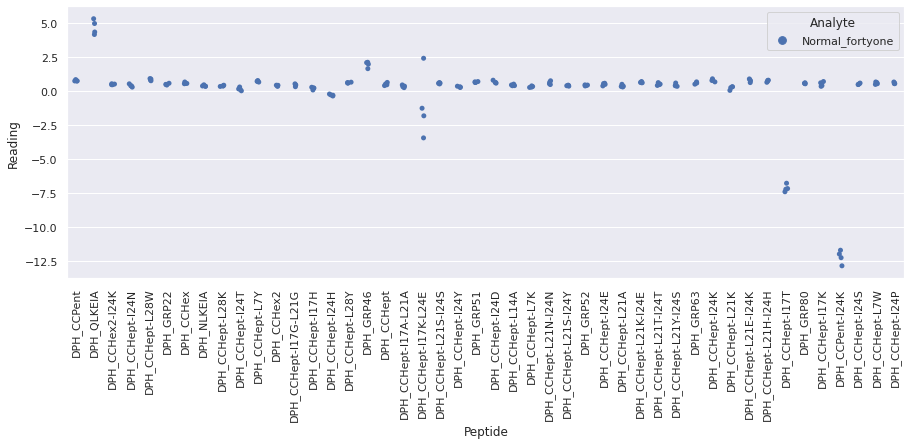

 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

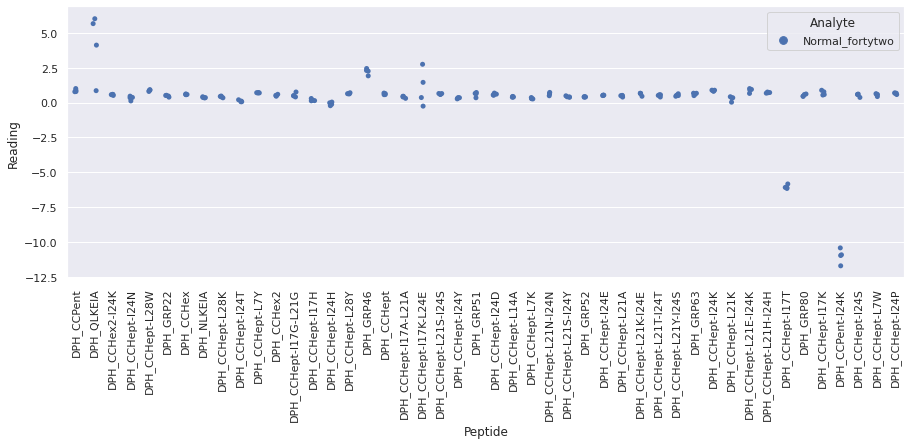

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_four_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

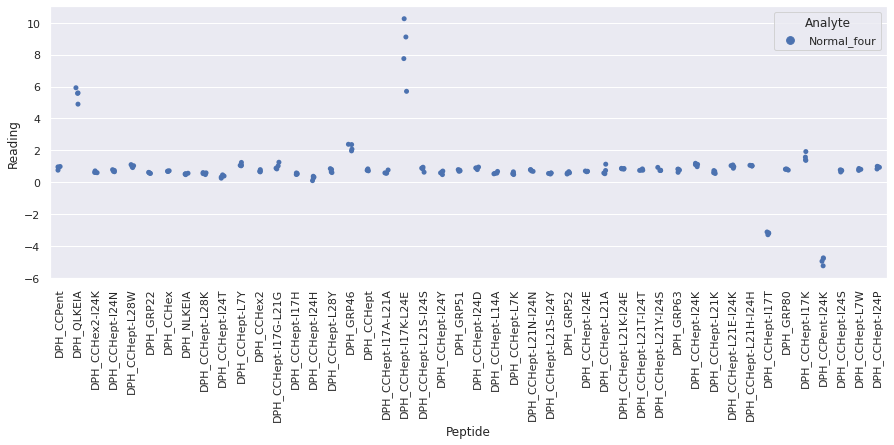

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_fourteen_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

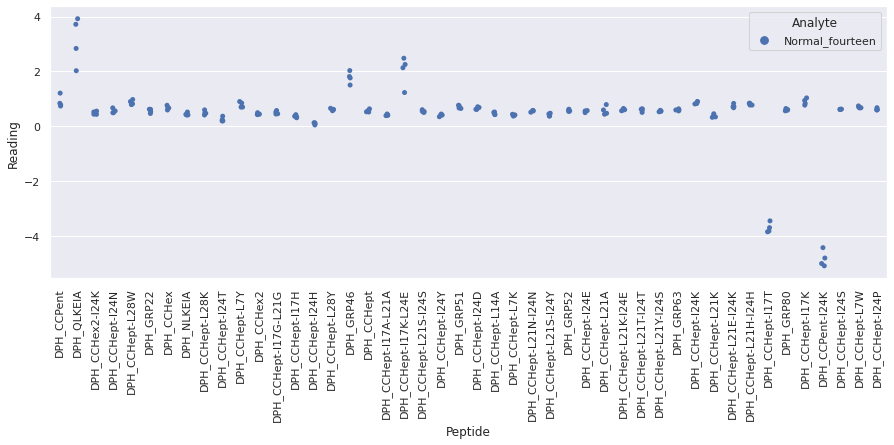

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

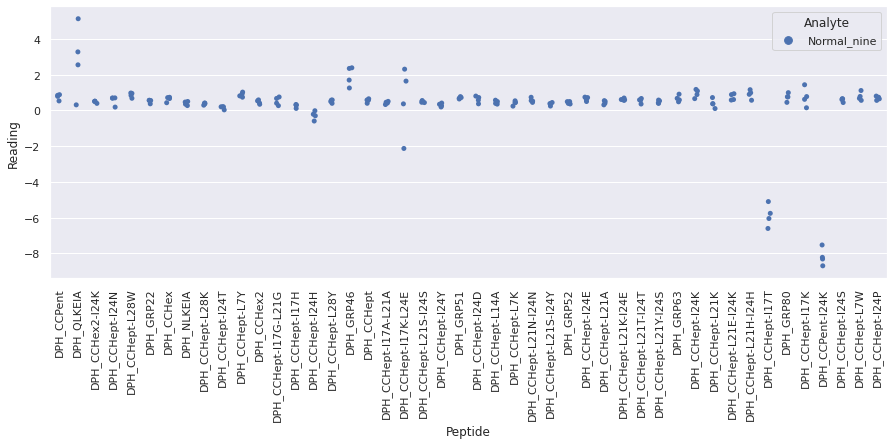

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

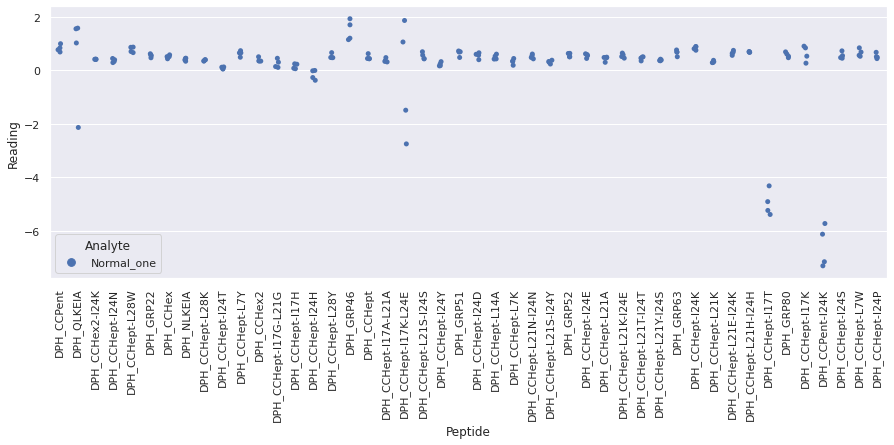

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

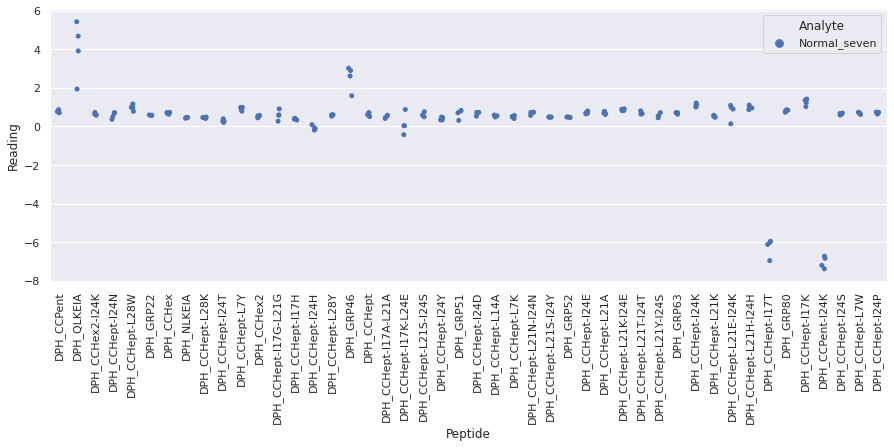

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_six_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

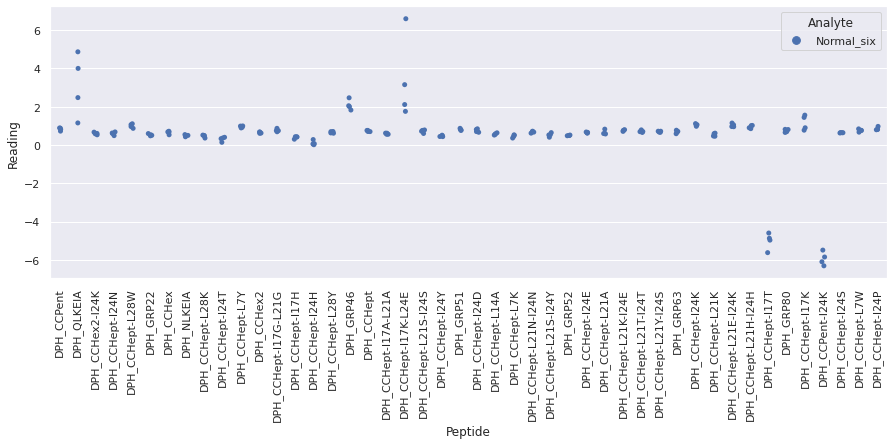

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

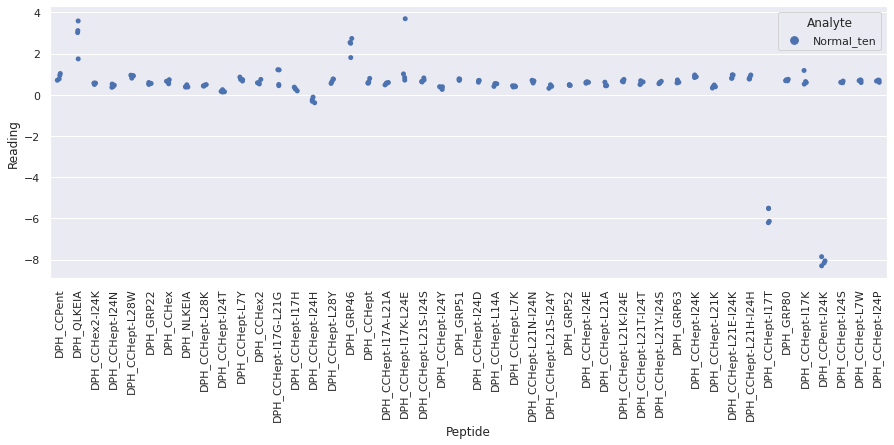

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_3.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

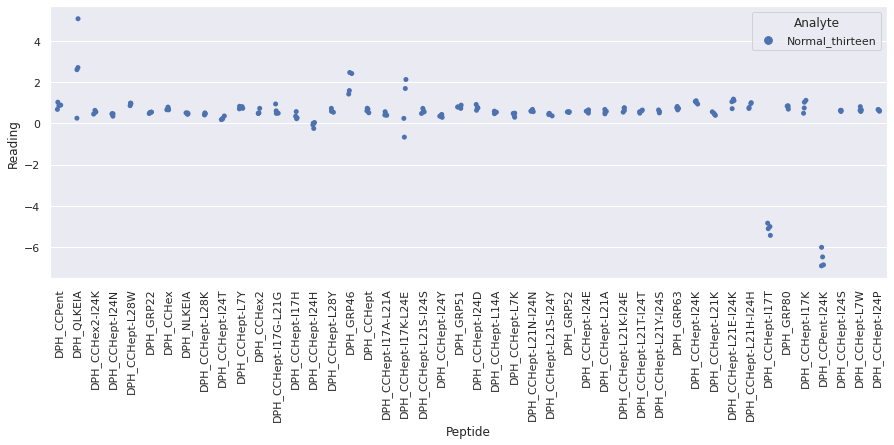

 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARN

<Figure size 720x720 with 0 Axes>

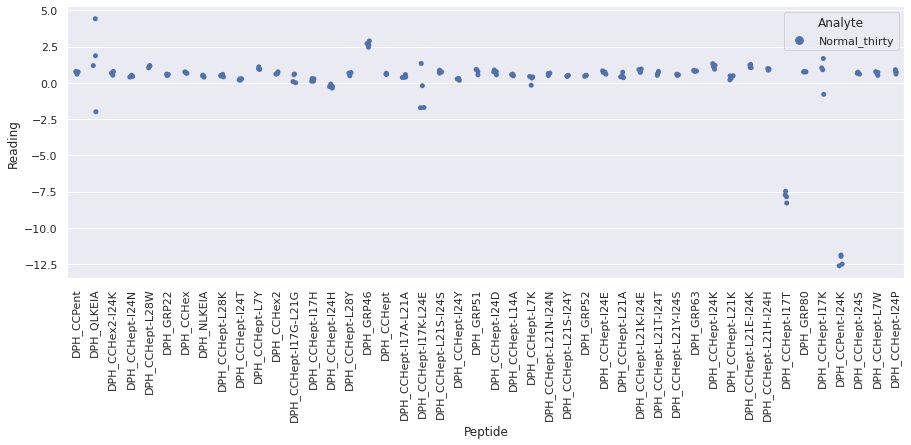

 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_3.xlsx. Analysis will con

<Figure size 720x720 with 0 Axes>

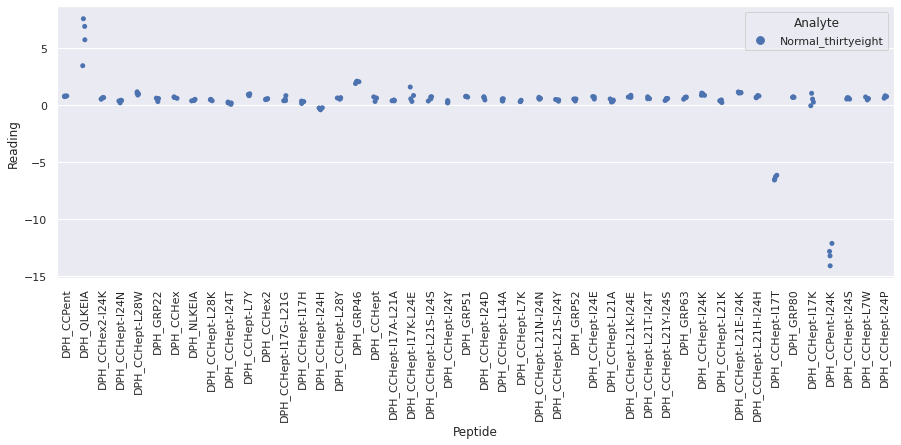

 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_3.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

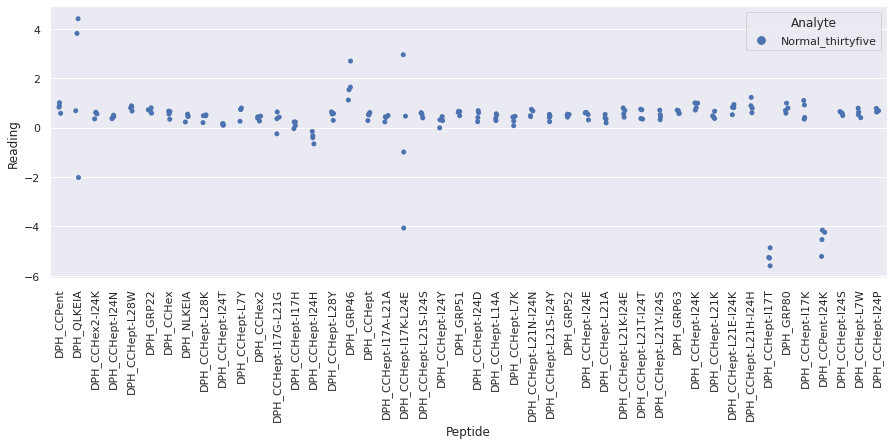

 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_3.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

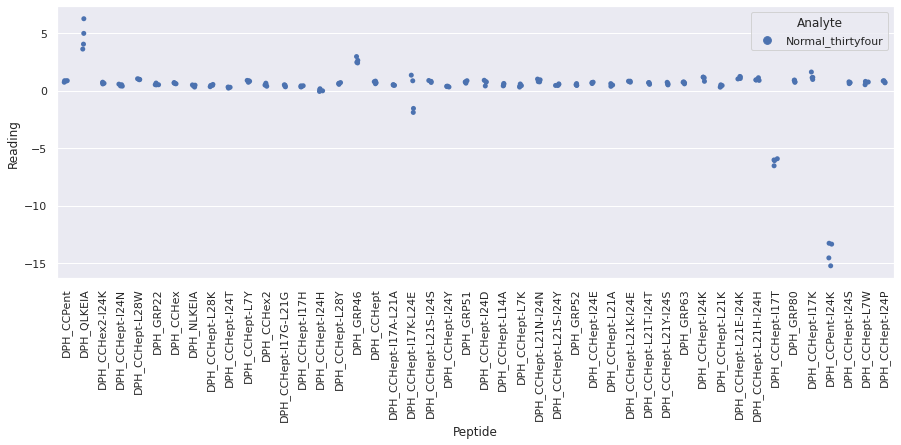

 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_3.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

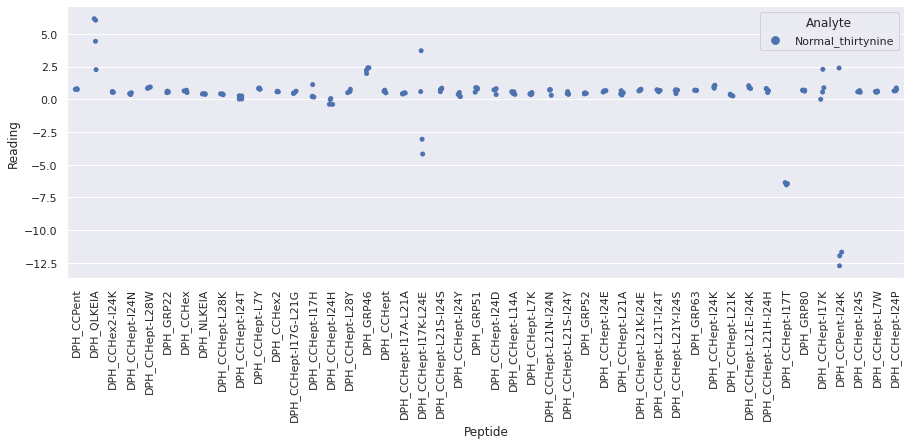

 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyone_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

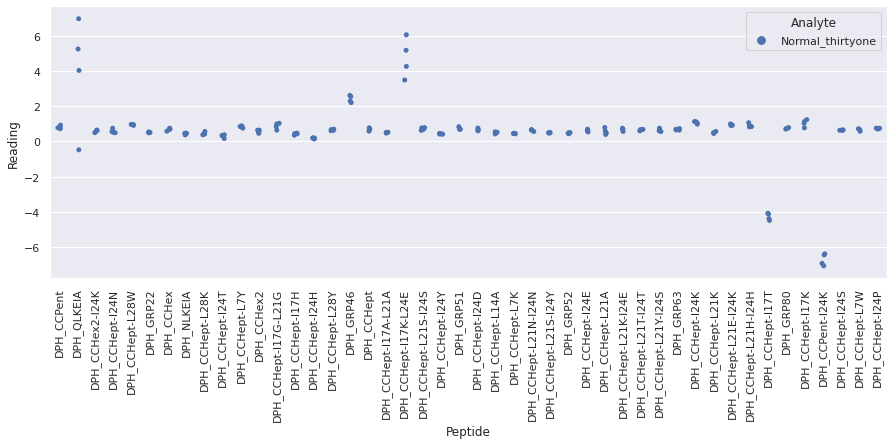

 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_3.xlsx. Analysis will con

<Figure size 720x720 with 0 Axes>

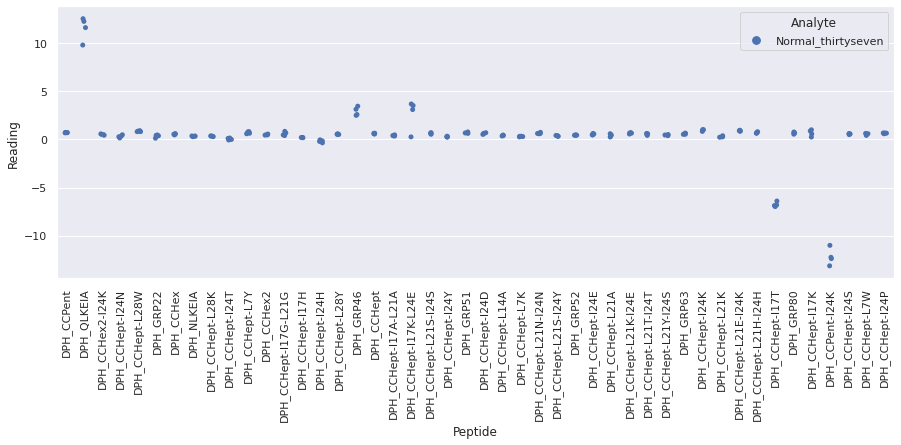

 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

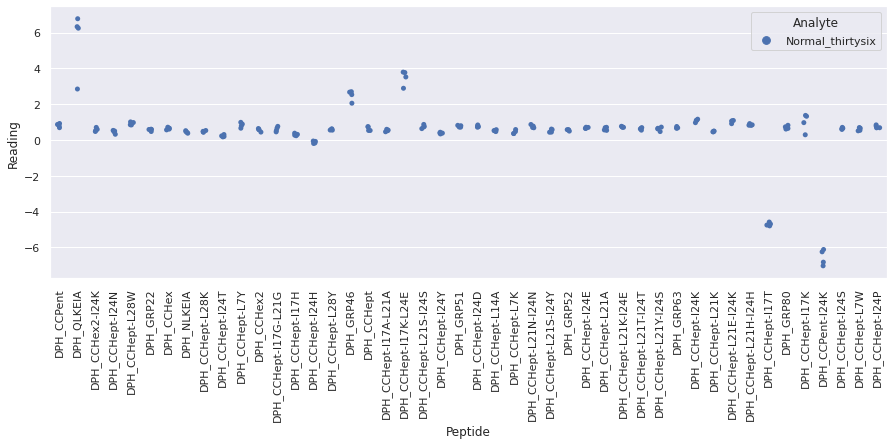

 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_3.xlsx. Analysis wil

<Figure size 720x720 with 0 Axes>

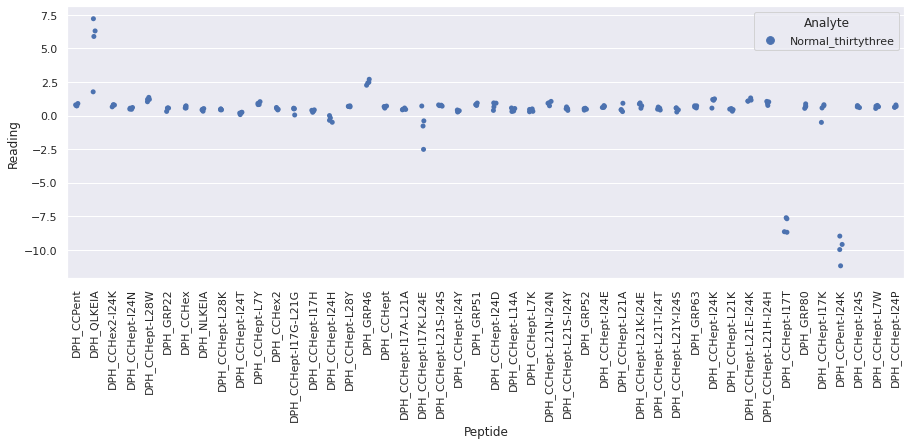

 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_3.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

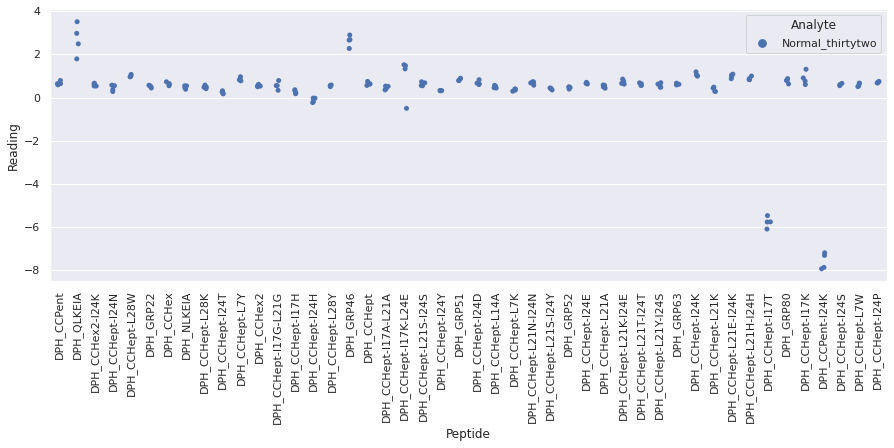

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

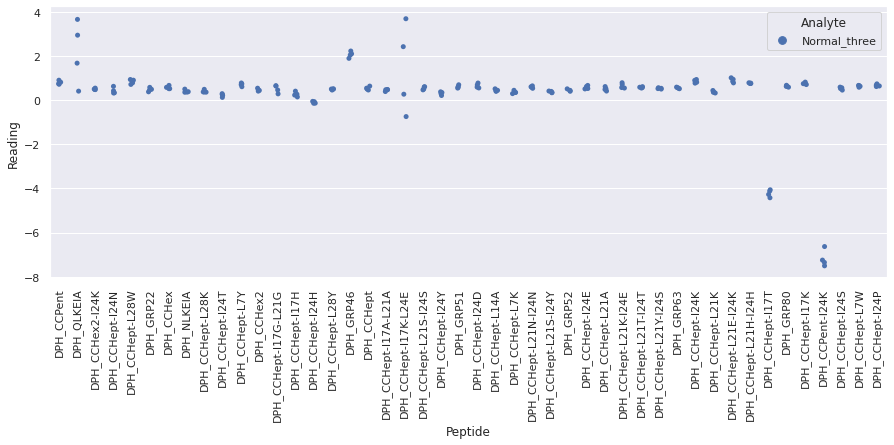

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

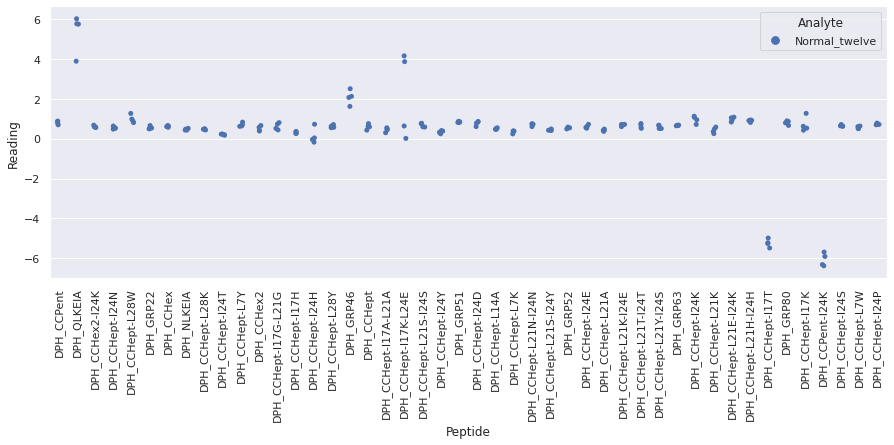

 WARNING - median fluorescence of (Normal_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynine_repeat_3 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

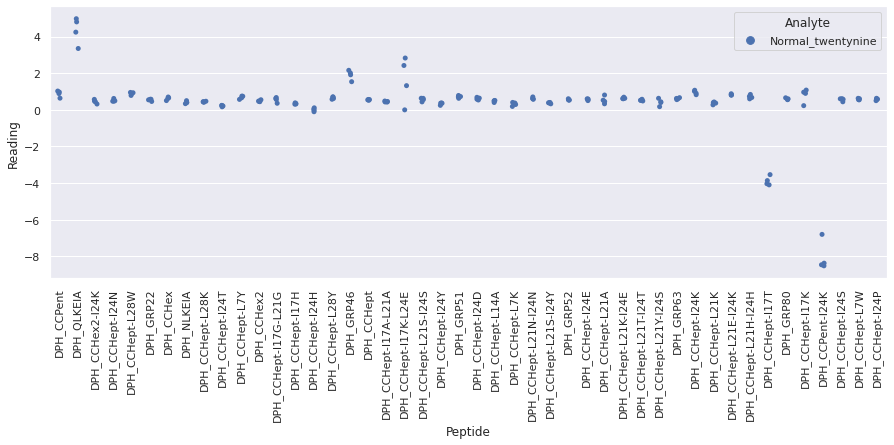

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

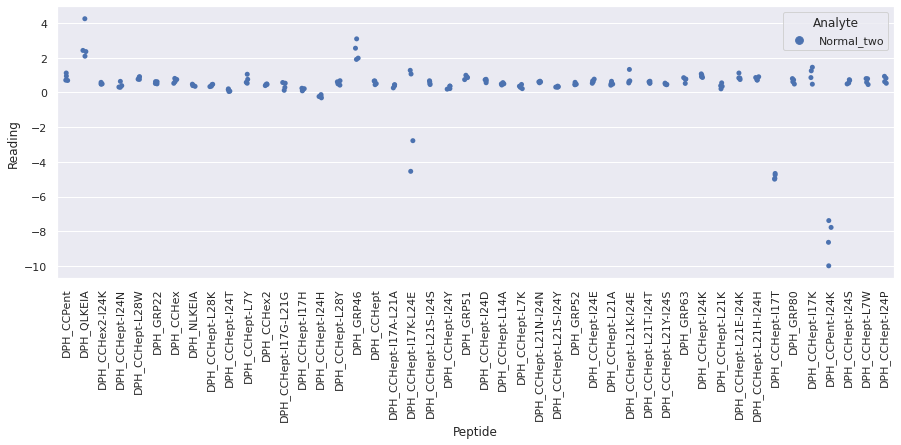

 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_eighteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_eighteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

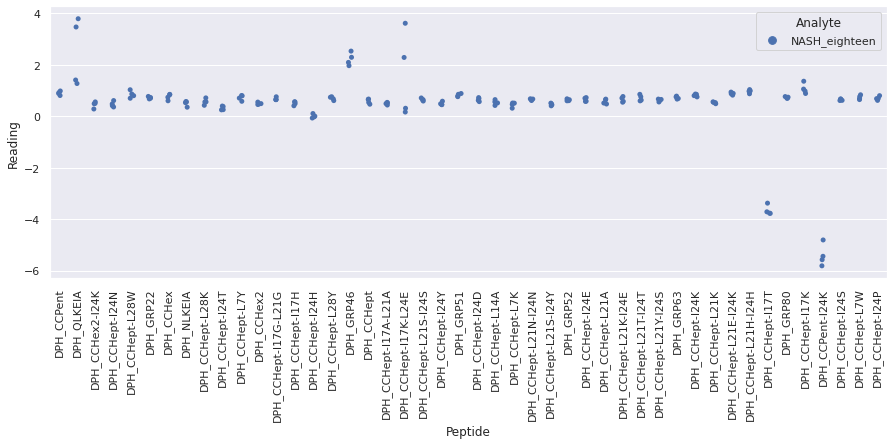

 WARNING - median fluorescence of (NASH_fifteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_fifteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_fifteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_fifteen_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

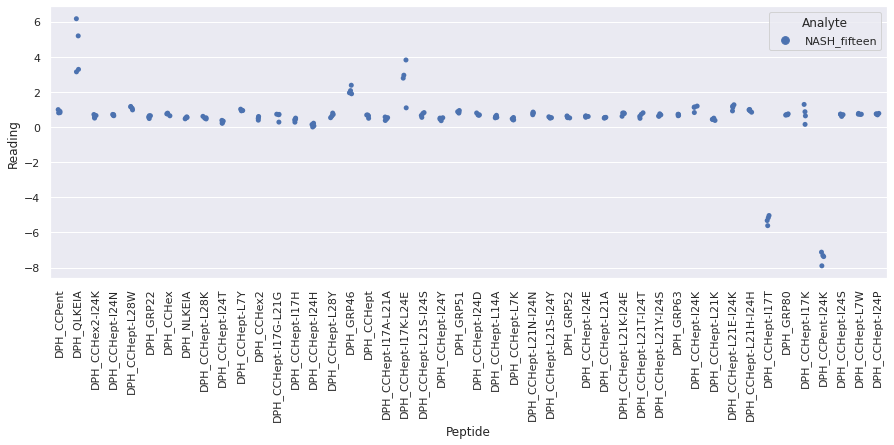

 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_nineteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_nineteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_nineteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

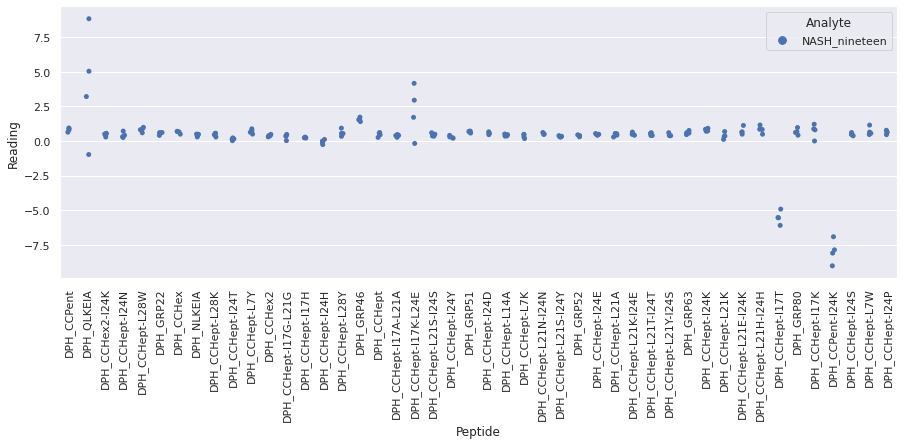

 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I24N + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_seventeen + DPH_CCHept-I17G-L21G + fluorophore) is less than fluorescence of (NASH_seventeen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_seventeen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

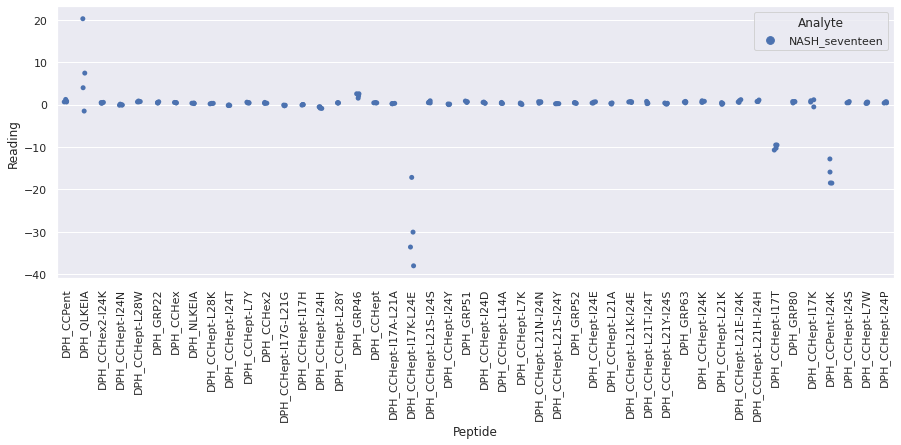

 WARNING - median fluorescence of (NASH_sixteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_sixteen + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_sixteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_sixteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_sixteen_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

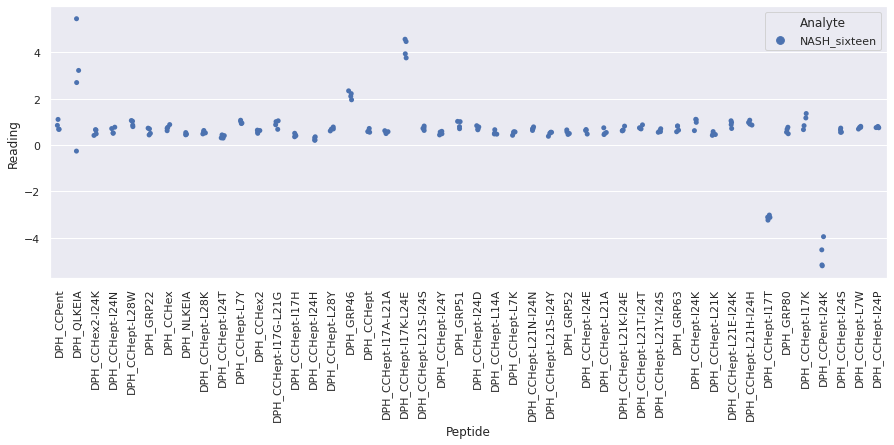

 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twenty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twenty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twenty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

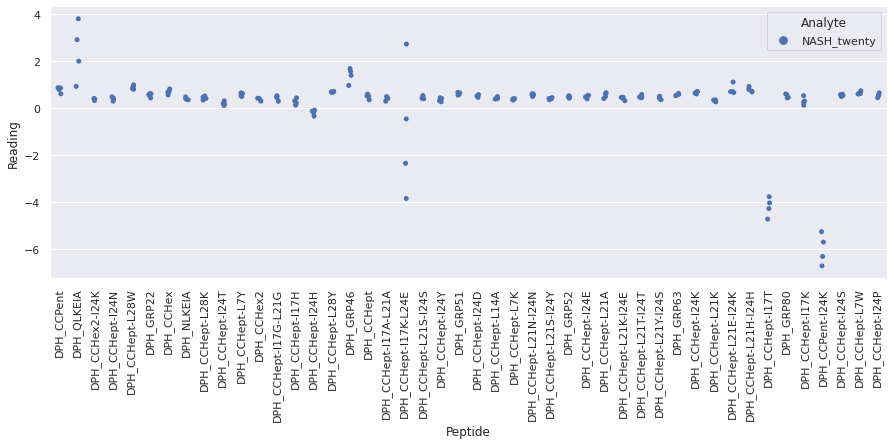

 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyeight_repeat_4.xlsx. Analysis will continue but ple

<Figure size 720x720 with 0 Axes>

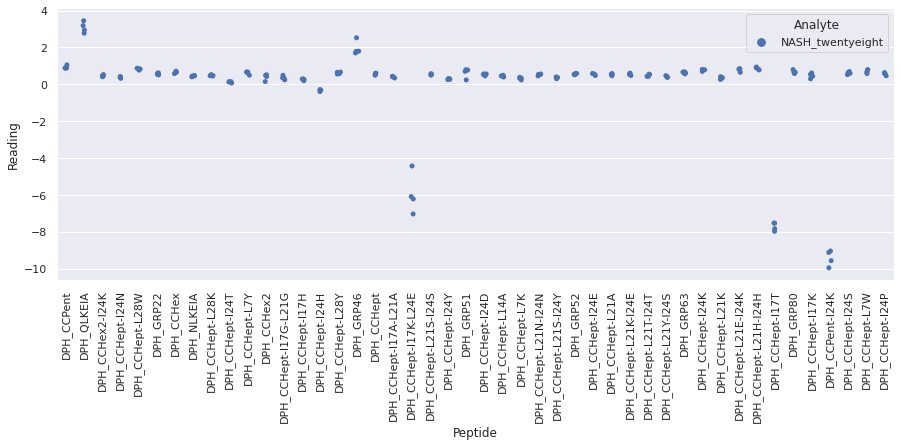

 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfive + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

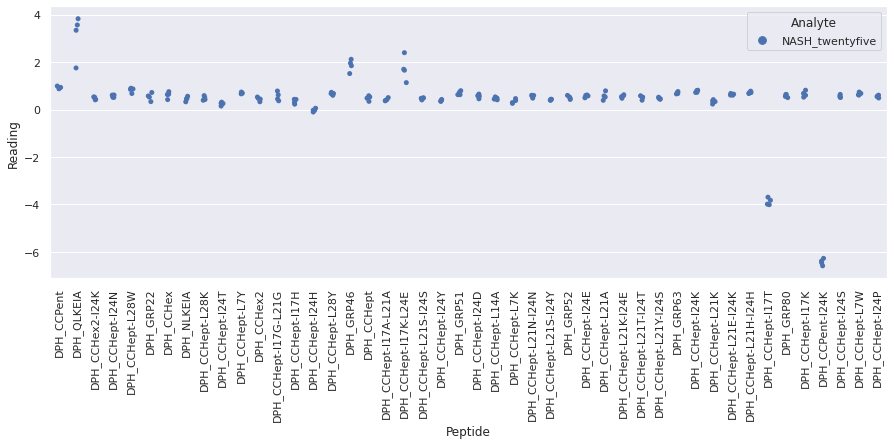

 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyfour + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyfour_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

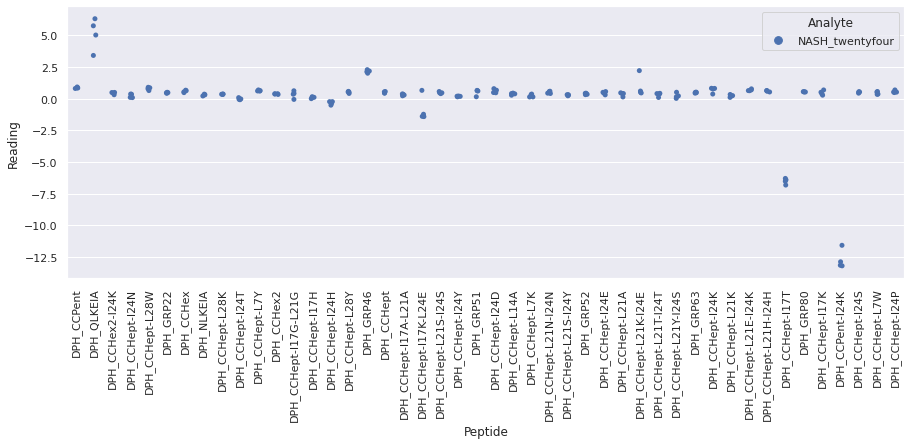

 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
D

<Figure size 720x720 with 0 Axes>

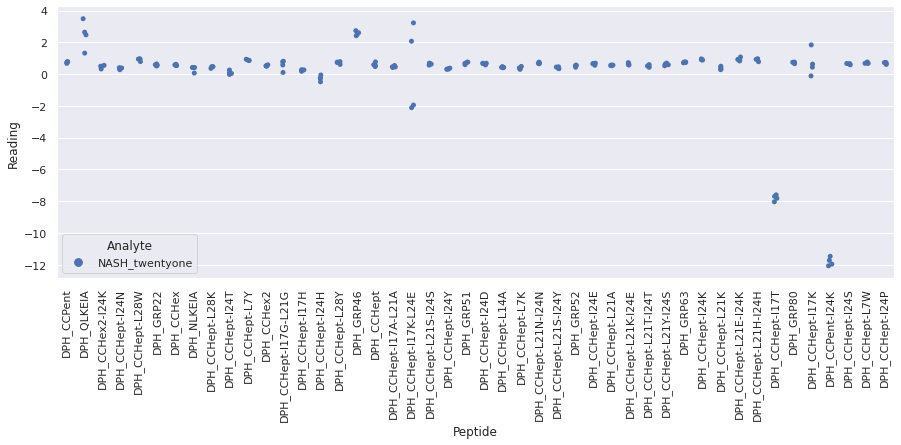

 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentyseven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentyseven_repeat_4.xlsx. Analysis will continue but please C

<Figure size 720x720 with 0 Axes>

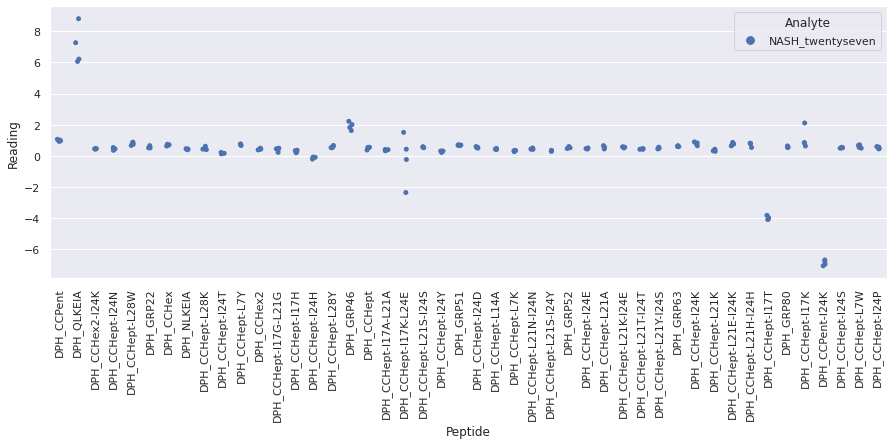

 WARNING - median fluorescence of (NASH_twentysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (NASH_twentysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for NASH_twentysix_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

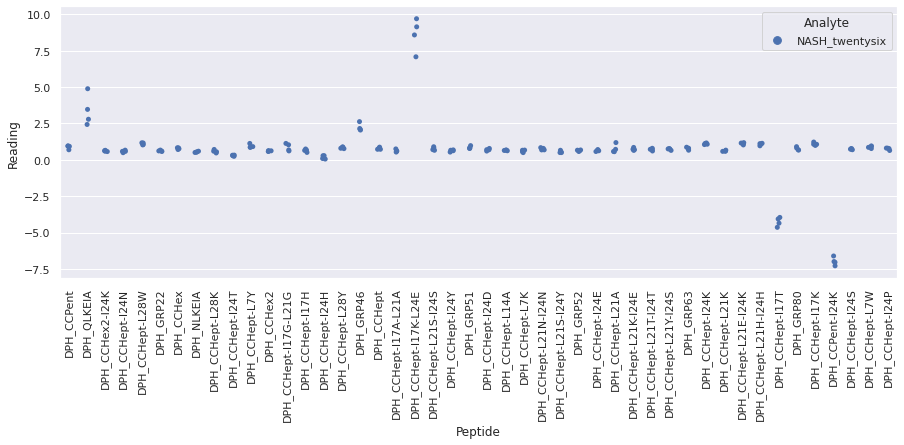

 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentythree_repeat_4.xlsx. Analysis will continue but ple

<Figure size 720x720 with 0 Axes>

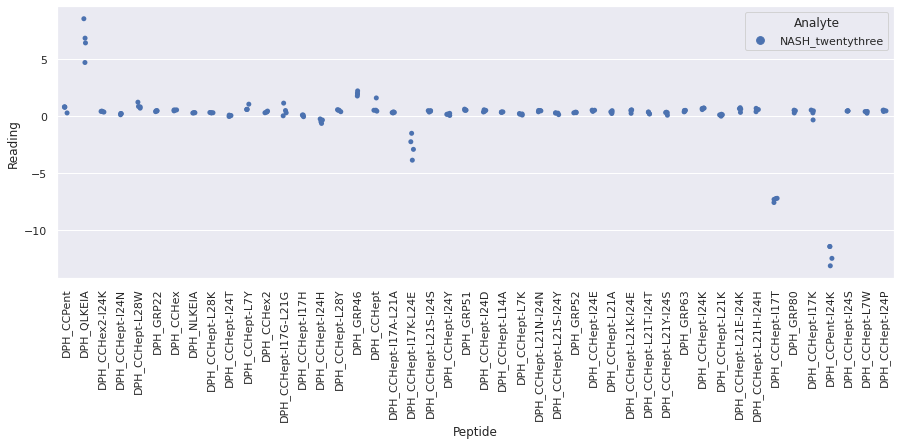

 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (NASH_twentytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (NASH_twentytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_twentytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DAT

<Figure size 720x720 with 0 Axes>

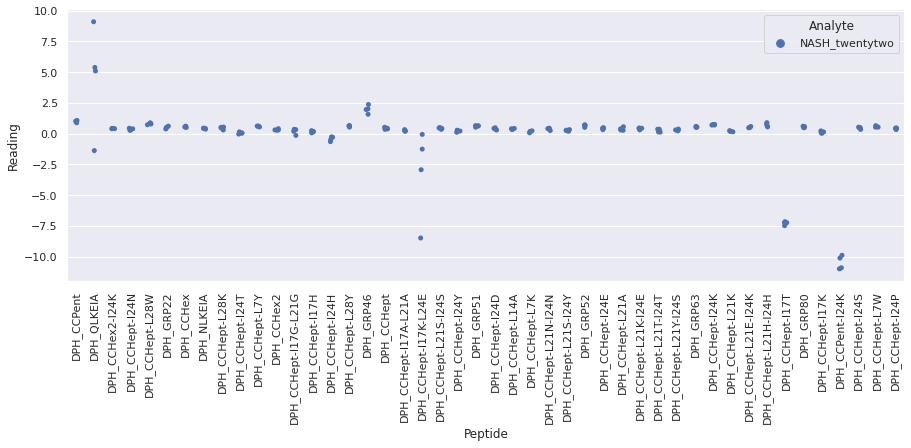

 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eight + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

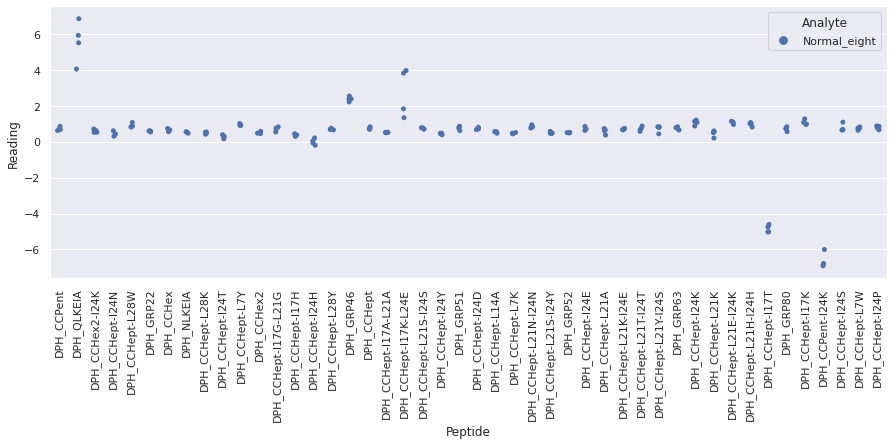

 WARNING - median fluorescence of (Normal_eleven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_eleven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_eleven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_eleven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_eleven_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

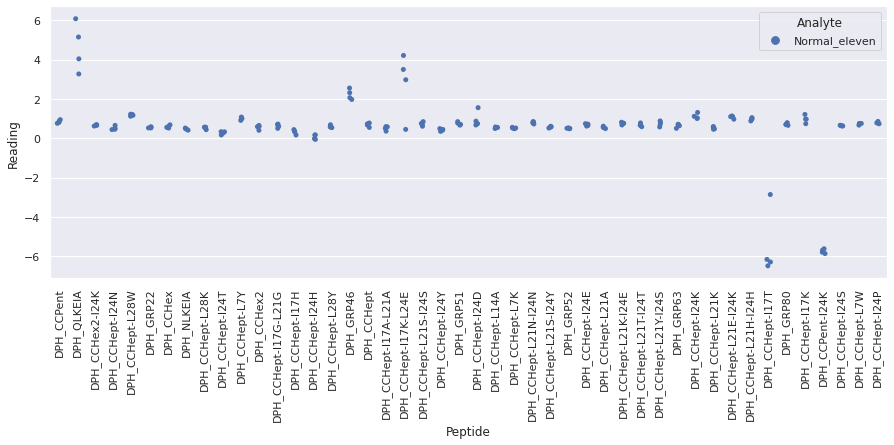

 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_five + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_five + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_five_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

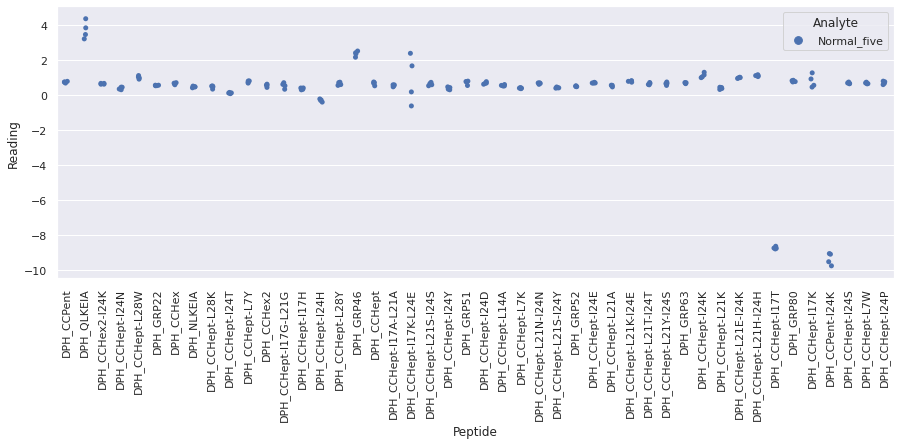

 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_forty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_forty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_forty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - med

<Figure size 720x720 with 0 Axes>

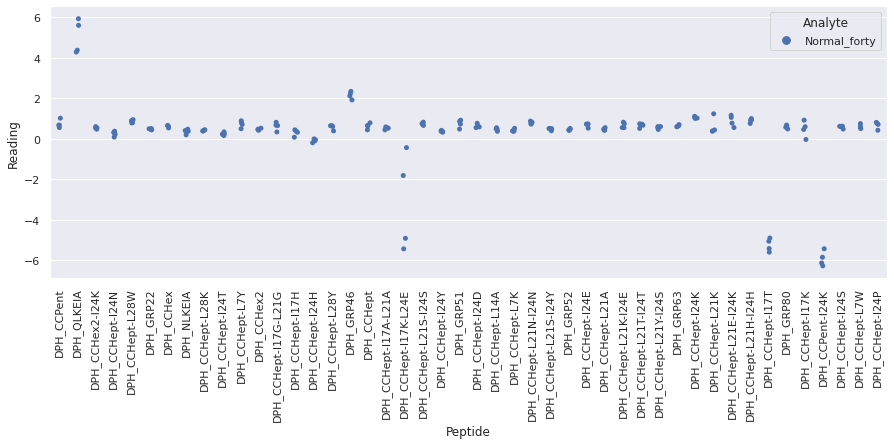

 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I24T + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I17H + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortyone + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR

<Figure size 720x720 with 0 Axes>

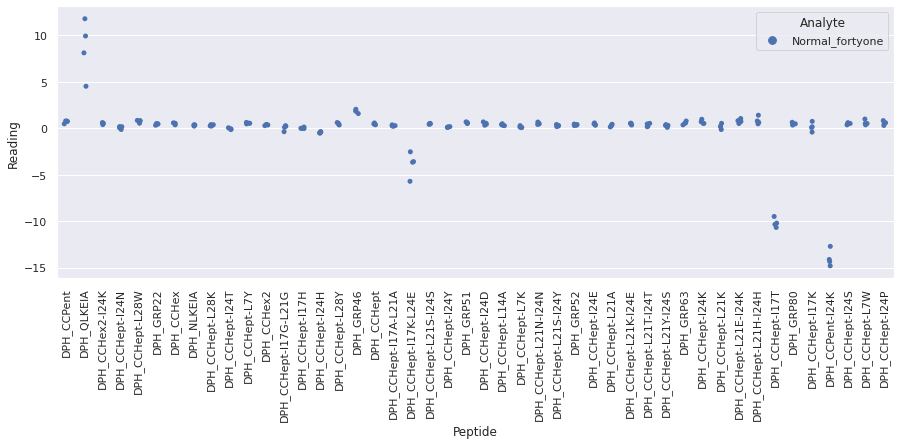

 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fortytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fortytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fortytwo_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

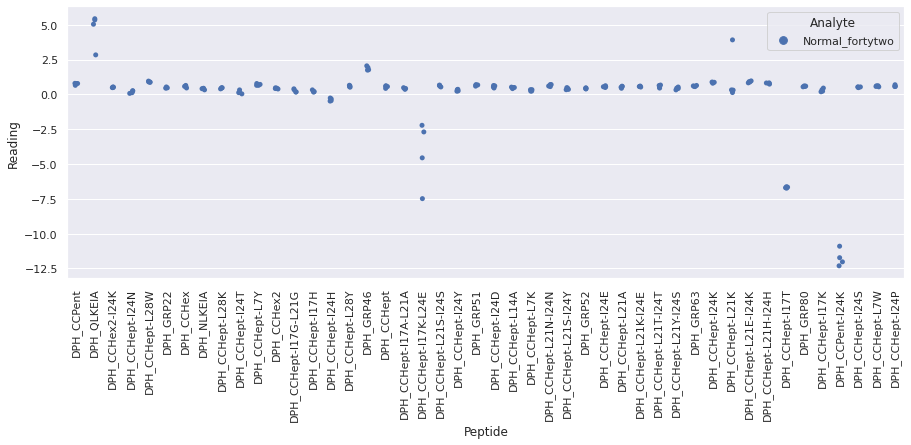

 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_four + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_four + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_four_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data

<Figure size 720x720 with 0 Axes>

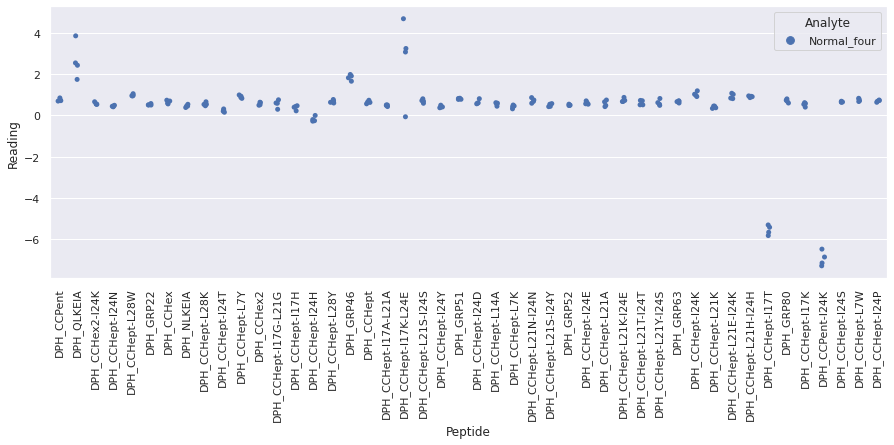

 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_fourteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_fourteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_fourteen_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

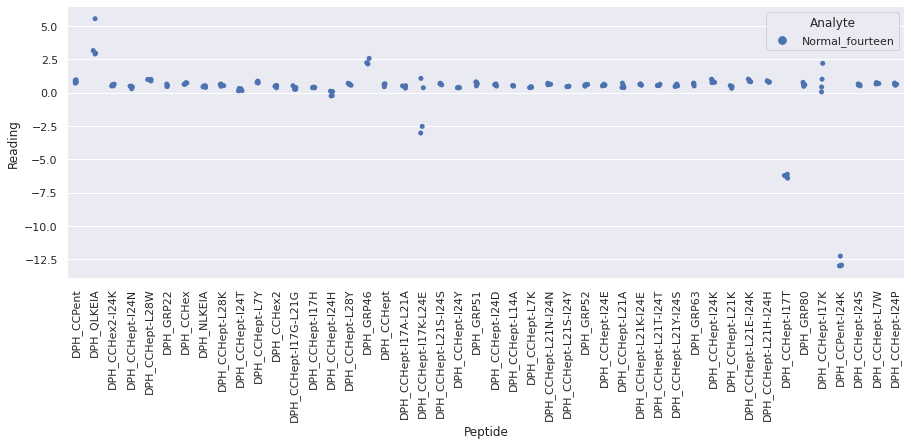

 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_nine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_nine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_nine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluor

<Figure size 720x720 with 0 Axes>

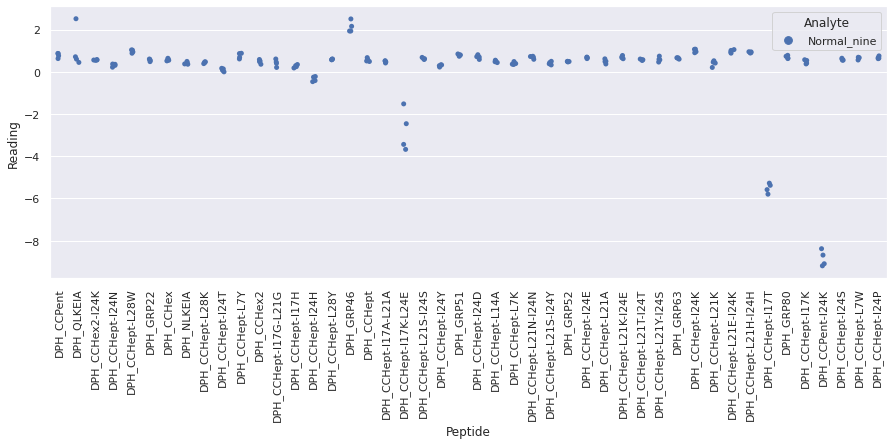

 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_one + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_one + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_one_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence o

<Figure size 720x720 with 0 Axes>

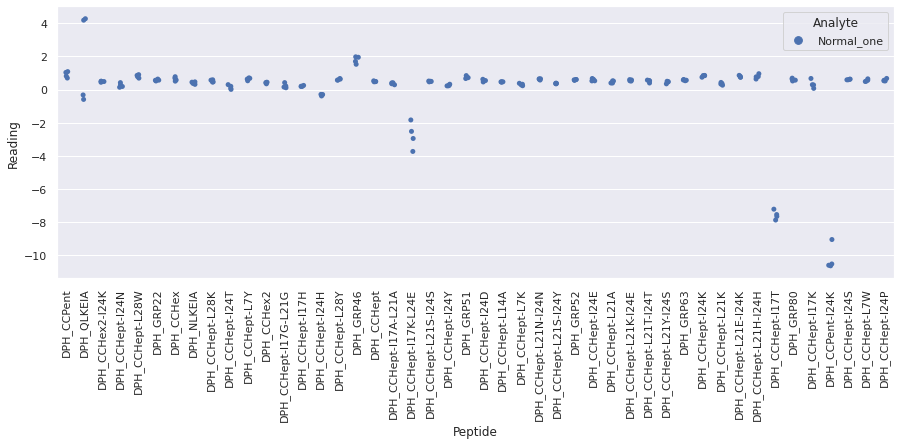

 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_seven + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_seven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_seven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plo

<Figure size 720x720 with 0 Axes>

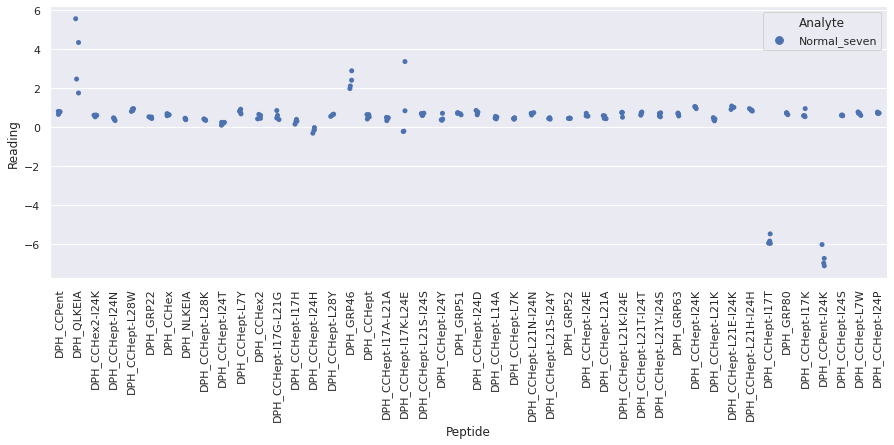

 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_six + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_six + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_six_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

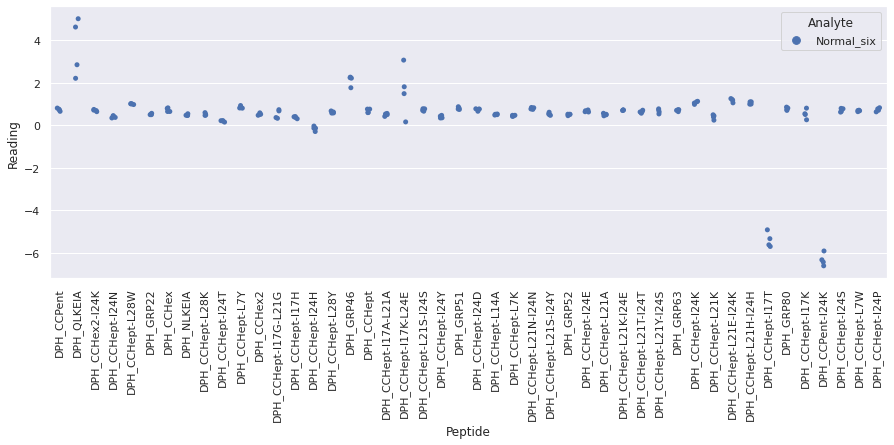

 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_ten + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_ten + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_ten_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

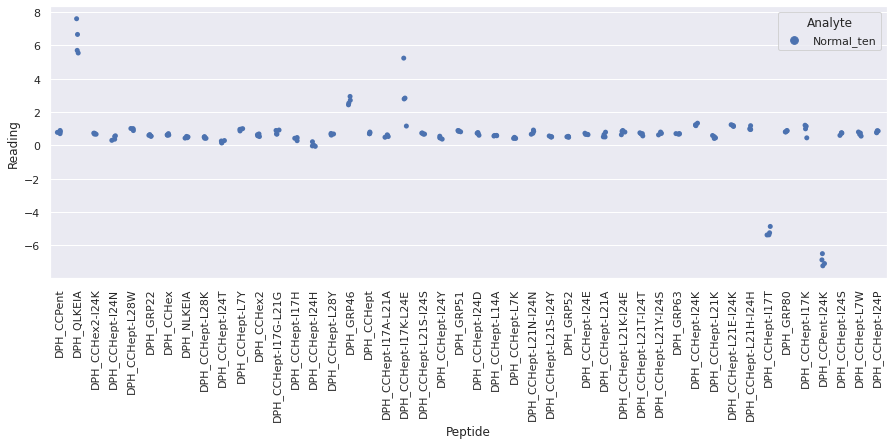

 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirteen + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirteen + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirteen_repeat_4.xlsx. Analysis will continue but please CHECK

<Figure size 720x720 with 0 Axes>

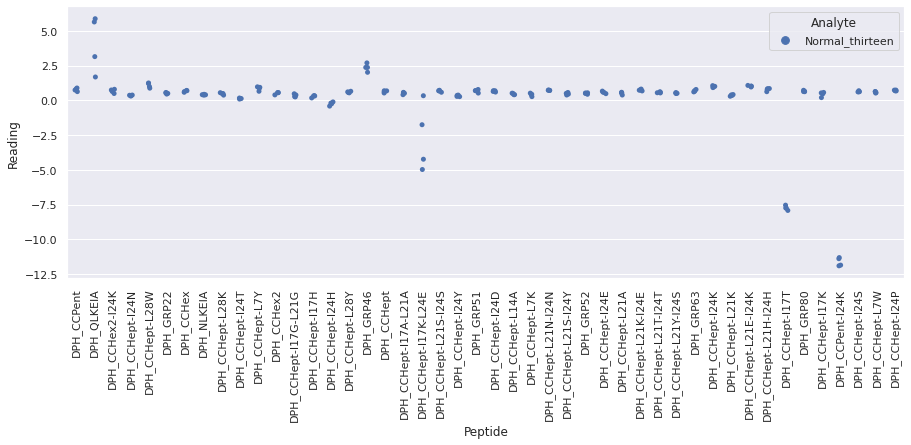

 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirty + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirty + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirty_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing sc

<Figure size 720x720 with 0 Axes>

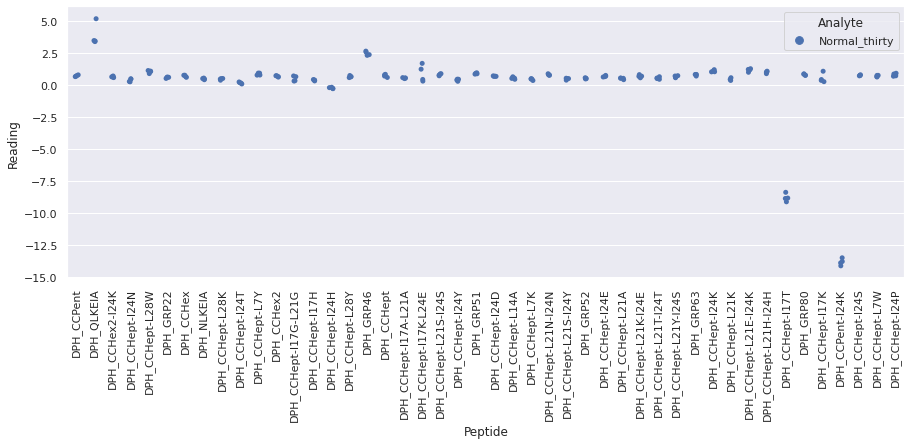

 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyeight + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyeight + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyeight_repeat_4.xlsx. Analysis wil

<Figure size 720x720 with 0 Axes>

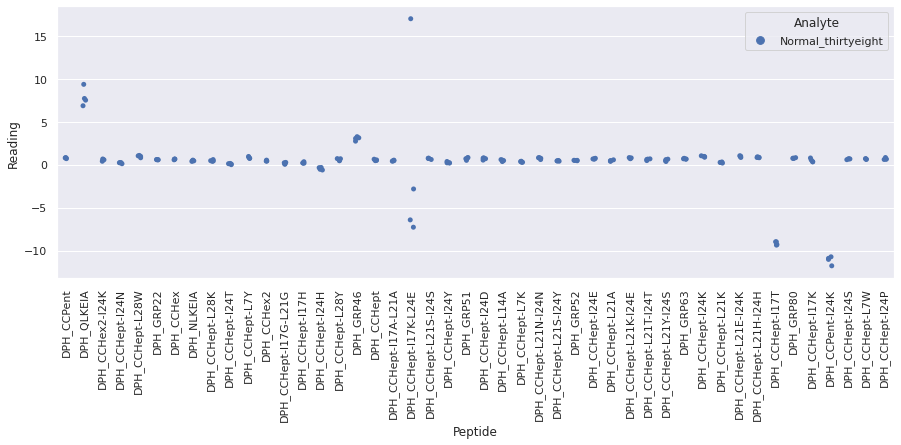

 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfive + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfive + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfive_repeat_4.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

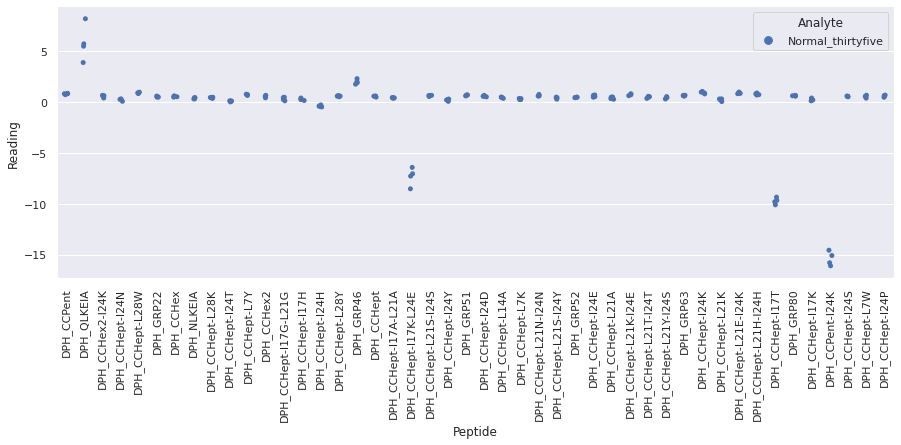

 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyfour + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyfour + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyfour_repeat_4.xlsx. Analysis will continue but

<Figure size 720x720 with 0 Axes>

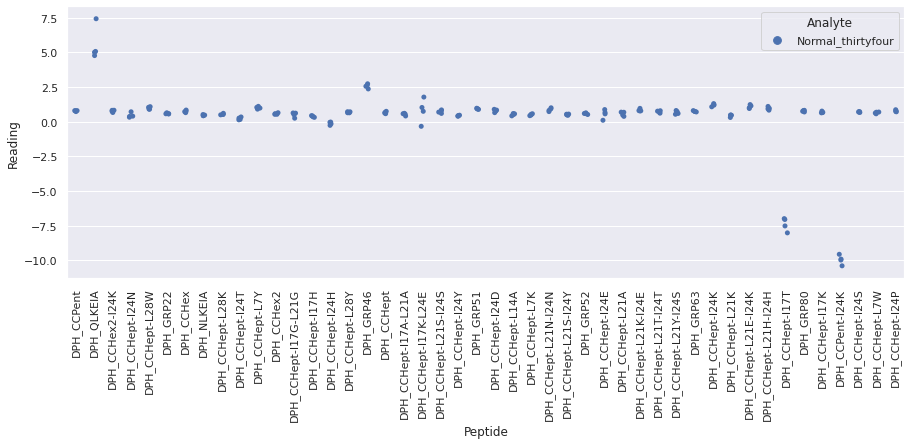

 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtynine_repeat_4.xlsx. Analysis will continu

<Figure size 720x720 with 0 Axes>

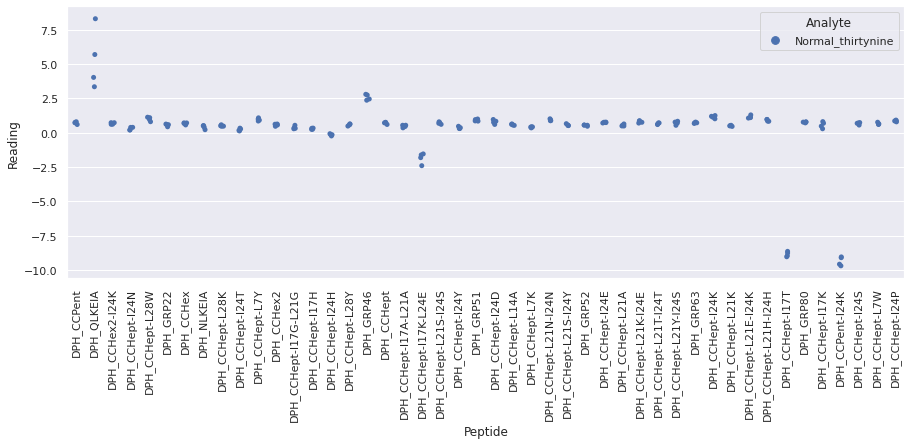

 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyone + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtyone + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyone_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtyone_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

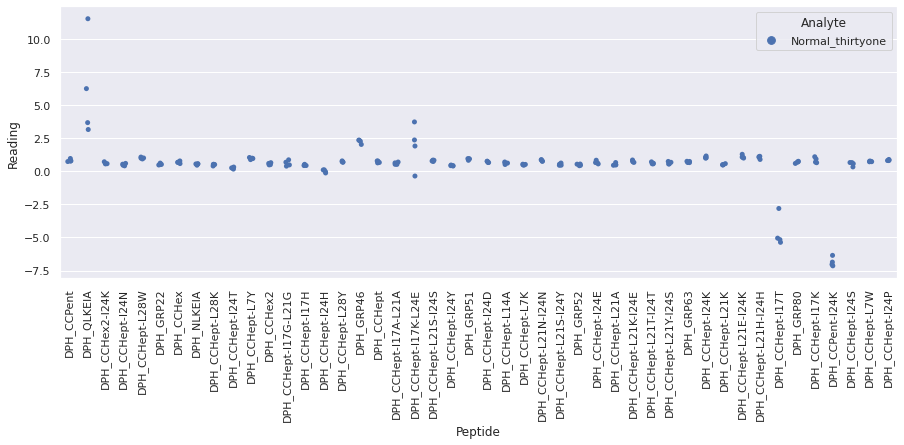

 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtyseven + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtyseven + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtyseven_repeat_4.xlsx. Analysis wil

<Figure size 720x720 with 0 Axes>

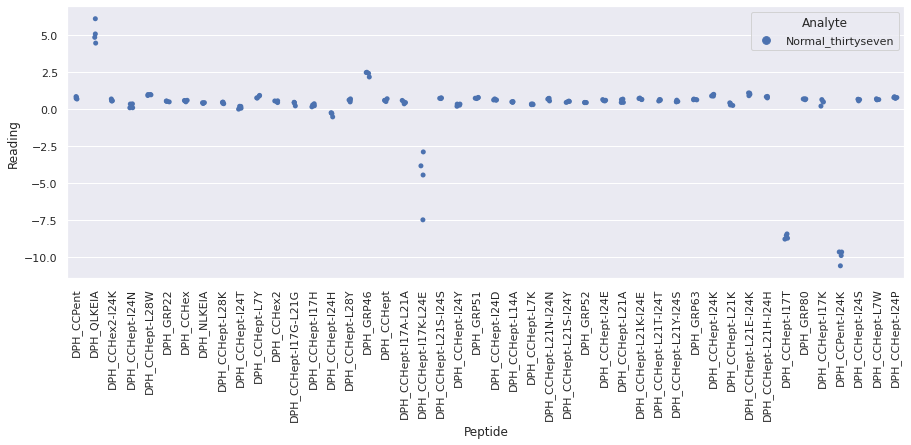

 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtysix + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_thirtysix + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtysix_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_thirtysix_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

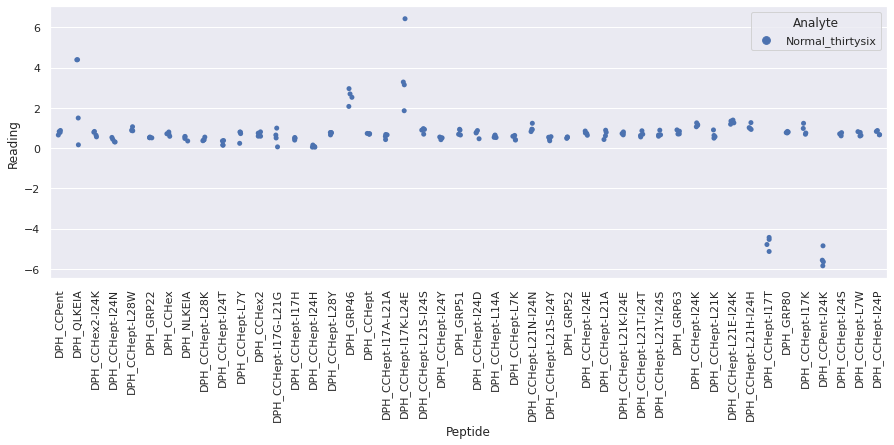

 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtythree + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtythree + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtythree_repeat_4.xlsx. Analysis wil

<Figure size 720x720 with 0 Axes>

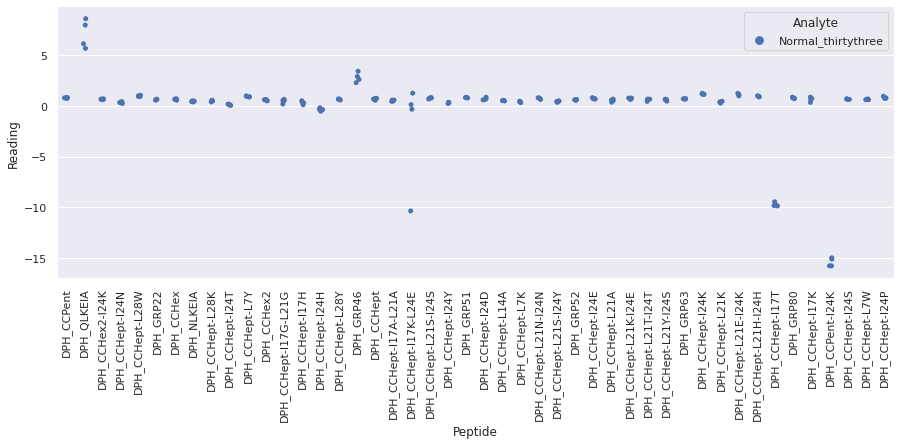

 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_thirtytwo + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_thirtytwo + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_thirtytwo_repeat_4.xlsx. Analysis will continue but ple

<Figure size 720x720 with 0 Axes>

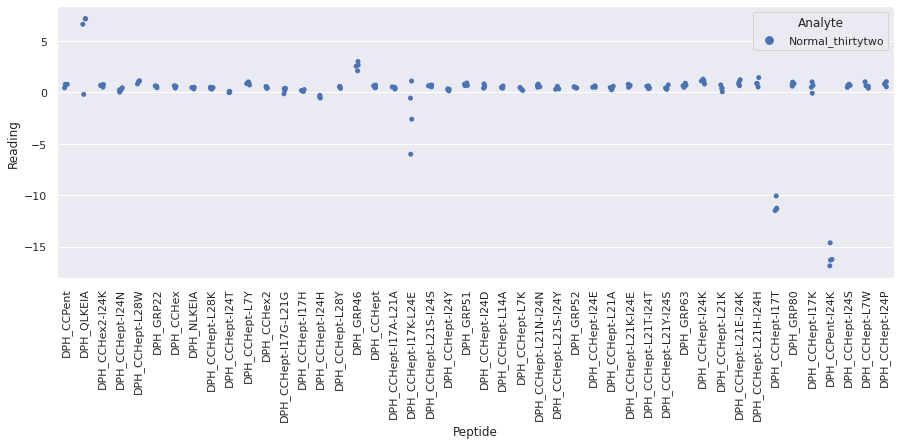

 WARNING - median fluorescence of (Normal_three + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_three + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_three + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_three_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_three_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

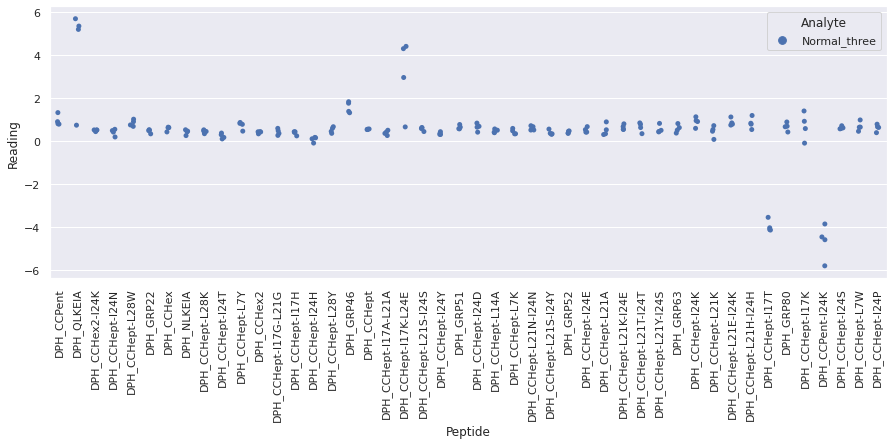

 WARNING - median fluorescence of (Normal_twelve + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twelve + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twelve + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twelve_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twelve_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

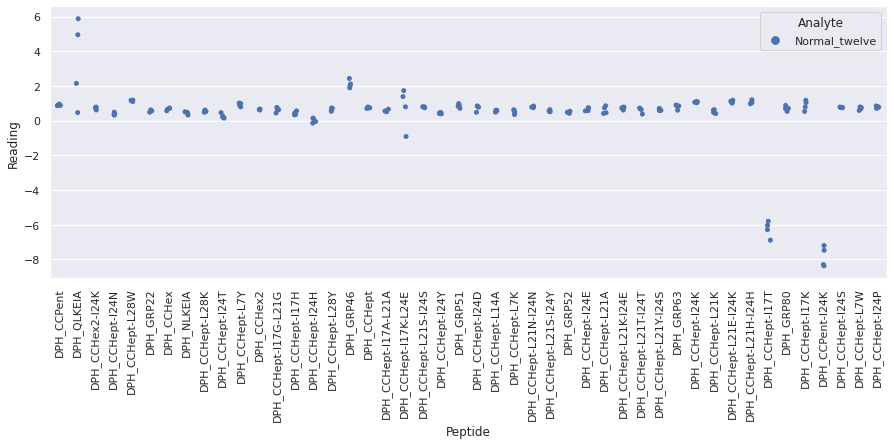

 WARNING - median fluorescence of (Normal_twentynine + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_twentynine + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_twentynine + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_twentynine_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for Normal_twentynine_repeat_4 in NASH_scaled_data


<Figure size 720x720 with 0 Axes>

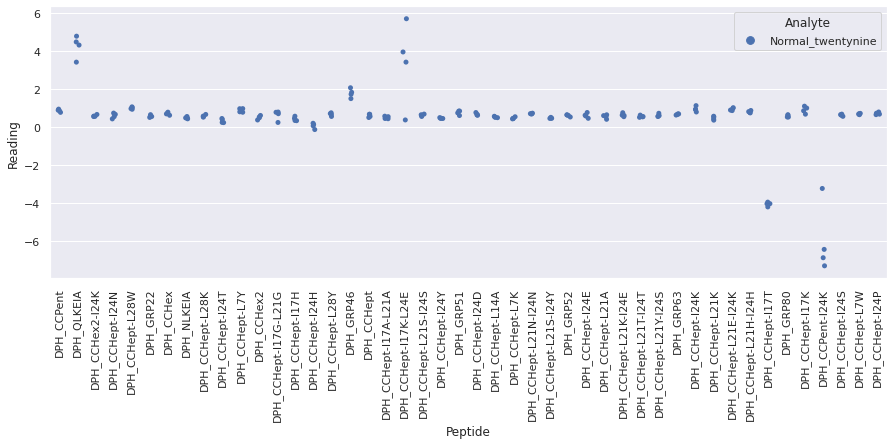

 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I24H + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCHept-I17T + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (Normal_two + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (Normal_two + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/Normal_two_repeat_4.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread f

<Figure size 720x720 with 0 Axes>

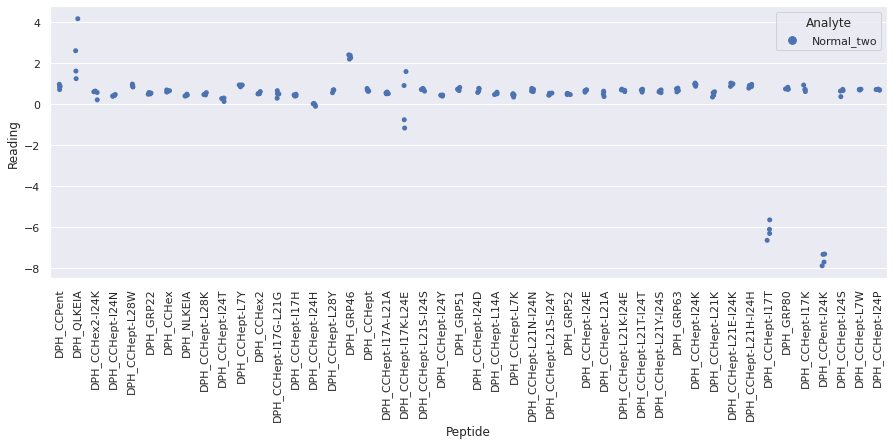



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx: blank, DPH_CCHept-L21E-I24K, 10332.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx: blank, DPH_CCPent-I24K, 588.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx: NASH_eighteen, DPH_CCHept-L21K, 3870.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx: NASH_eighteen, DPH_CCHept-I17T, 1519.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_eighteen_repeat_1.xlsx: NASH_eighteen, DPH_CCHept-L7W, 10850.0
/home/ks17361/ML_environment/BADASS/NASH_serum_data/Reformatted_csvs_2_classes_split_patient/NASH_fifteen_repeat_1.xlsx: blank, DPH_CCHept-I24D, 12646.0
/home/ks17361/ML_envir

In [6]:
nash_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='NASH'
)

At a glance:
- The serum samples are causing changes in fluorescence (e.g. compare to the sugar samples, where addition of analyte has little effect upon the fluorescence signal) - clearly there are components in the samples that are substantially affecting the interaction of DPH with the peptides.
- By eye there aren't any entire plates that are anomalous and hence should be discarded. There are individual outliers on several plates, however they will be discarded when the repeat readings are averaged by calculating the median.
- The serum samples themselves fluoresce at the same wavelength as DPH (excite at 350nm, measure at 450nm), hence the samples show pretty high background signal (compare the blue and orange dots for "DPH_No Pep" on the scatter plots for each plate). 
- There are several peptides that have little effect upon the fluorescence of DPH. Consequently, given the high background fluorescence of the analyte, the fluorescence of the sample with DPH and the peptide exceeds that of DPH and the peptide alone in these cases. The fact that the fluorescence increases in the presence of analyte is not on its own problematic, provided that the increase is consistent - however, the low fluorescence of the peptide and DPH alone means that these readings are more likely to contain larger amounts of noise (since the readings are scaled relative to the fluorescence of the peptide + DPH in order to enable fair comparison of readings measured on different plates). This is reflected in the above scatter plots - the ranges of readings obtained for peptides QLKEIA and CCHept-I17K-L24E in particular are unusually large even when only comparing samples on the same plate => think it is unlikely that the readings from these peptides will provide much signal about the sample class and instead will be predominantly noise. In contrast, although peptides CCHept-I17T and CCPent-I24K yield negative (scaled) readings as a result of the fact that in both cases the fluorescence of analyte + peptide + DPH is smaller than that of analyte + DPH alone, the (scaled) readings are fairly consistent. Hence they are likely to provide useful signal (and accordingly I am not concerned by the warnings that these samples cause the program to raise).

Combines readings of the same analyte solution across different plates, then calculates the median reading of non-independent repeats of the same analyte. Runs generalised ESD test, discards samples with two or more outlier readings (p=0.02 threshold).

(Using the default thresholds of p=0.05 and drop_thresh=2, I found a large number of samples were identified as "anomalous" (when in fact looking at the scatter plots above by eye they did not appear obviously unusual). Consequently I have reduced the p-value threshold to 0.02 for the NASH data. The original values of p=0.05 and drop_thresh=2 were determined on the small molecules data - that they appear to be too stringent for biological data likely reflects the greater variation present in biological samples.)

In [7]:
nash_fluor_data.combine_plate_readings(outlier_excl_thresh=0.02, drop_thresh=2)



Outliers across plates:

repeat_1_NASH_eighteen: NASH_eighteen, DPH_CCHept-L21K, 0.2978114608305622
repeat_1_NASH_eighteen: NASH_eighteen, DPH_CCHept-L7W, 0.8347080326178649
repeat_1_NASH_fifteen: NASH_fifteen, DPH_CCHept-L28W, 1.0270548188071769
repeat_1_NASH_fifteen: NASH_fifteen, DPH_CCHept-I24S, 0.6209475049261498
repeat_1_NASH_nineteen: NASH_nineteen, DPH_CCHept-L21T-I24T, -0.07038482136026318
repeat_1_NASH_seventeen: NASH_seventeen, DPH_CCHept-L21K-I24E, 0.5064341640526588
repeat_1_NASH_seventeen: NASH_seventeen, DPH_CCHept-I17T, 1.8009478672985781
repeat_1_NASH_sixteen: NASH_sixteen, DPH_CCHept-L21K-I24E, 0.6306033175971242
repeat_1_NASH_sixteen: NASH_sixteen, DPH_CCPent-I24K, -3.7032640949554896
repeat_1_NASH_twenty: NASH_twenty, DPH_CCHept-L21K, 0.3829620108540417
repeat_1_NASH_twentyfive: NASH_twentyfive, DPH_CCHept-L21E-I24K, 0.6561051706903341
repeat_1_NASH_twentyseven: NASH_twentyseven, DPH_GRP51, 0.5248695652173913
repeat_1_NASH_twentythree: NASH_twentythree, DPH_CCHept

 Outlier excluded from final output dataset: 3, NASH_twentyfour
DPH_CCPent                                  0.858406
DPH_QLKEIA                                       5.4
DPH_CCHex2-I24K                             0.467986
DPH_CCHept-I24N                             0.233311
DPH_CCHept-L28W                             0.827771
DPH_GRP22                                   0.479044
DPH_CCHex                                   0.591748
DPH_NLKEIA                                  0.313909
DPH_CCHept-L28K                             0.359082
DPH_CCHept-I24T                           -0.0297993
DPH_CCHept-L7Y                              0.629826
DPH_CCHex2                                  0.384394
DPH_CCHept-I17G-L21G                        0.392551
DPH_CCHept-I17H         Outlier: 0.10360942627025951
DPH_CCHept-I24H                            -0.302451
DPH_CCHept-L28Y                             0.532539
DPH_GRP46                                    2.16186
DPH_CCHept                         

Display range of data points across repeats for the different analytes




Original_data:


NASH_eighteen


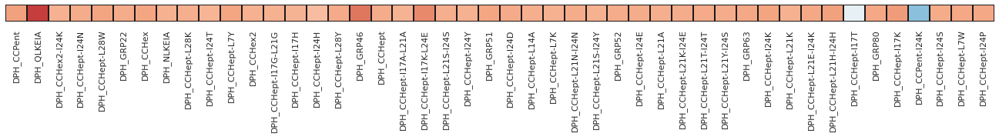


NASH_fifteen


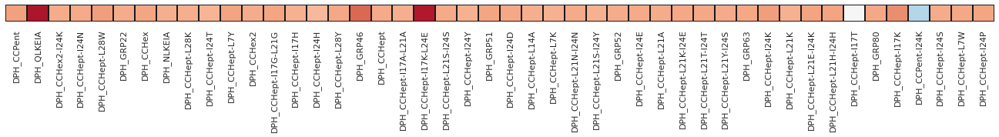


NASH_nineteen


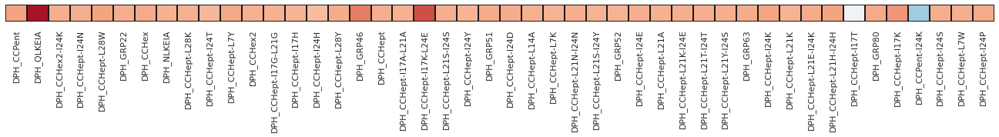


NASH_seventeen


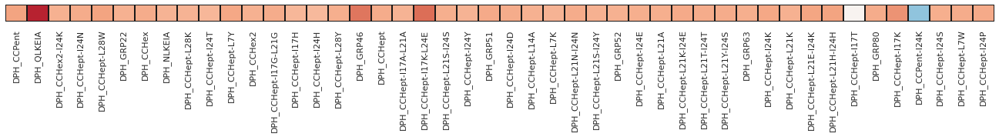


NASH_sixteen


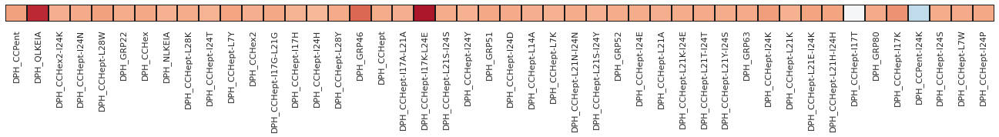


NASH_twenty


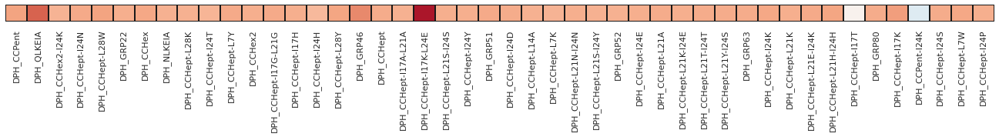


NASH_twentyeight


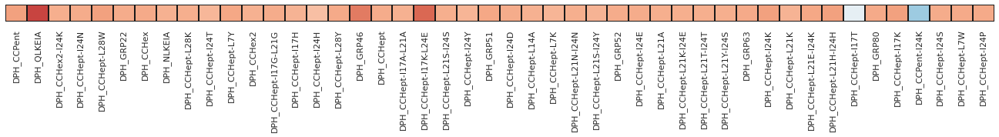


NASH_twentyfive


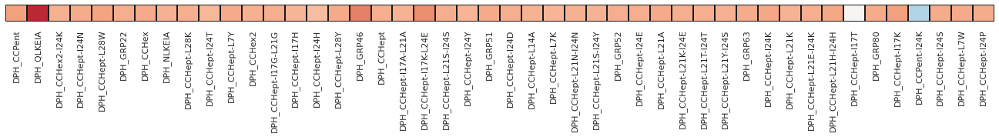


NASH_twentyfour


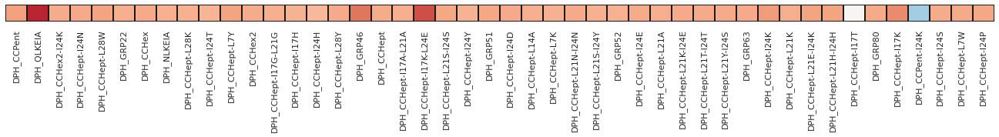


NASH_twentyone


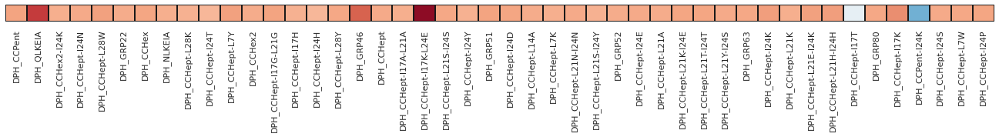


NASH_twentyseven


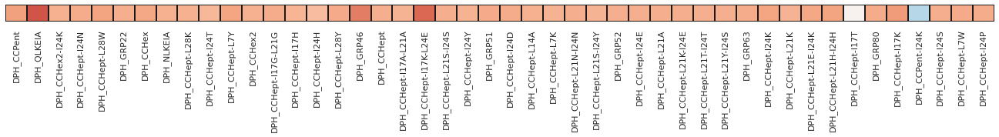


NASH_twentysix


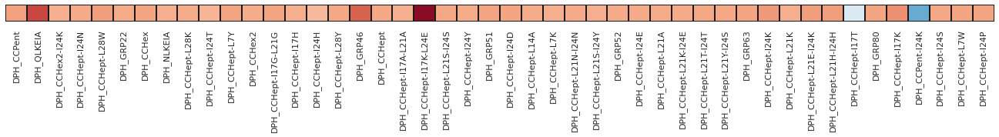


NASH_twentythree


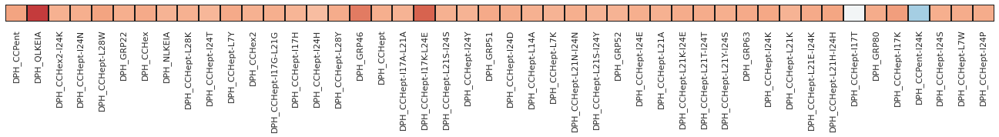


NASH_twentytwo


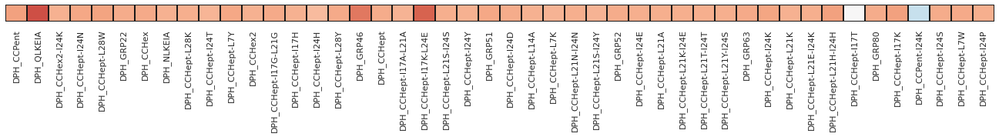


Normal_eight


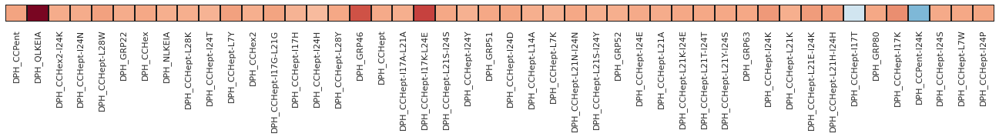


Normal_eleven


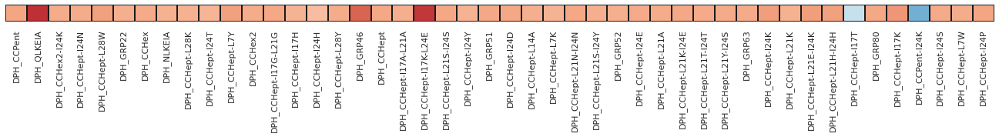


Normal_five


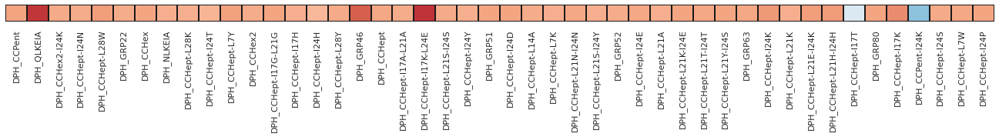


Normal_forty


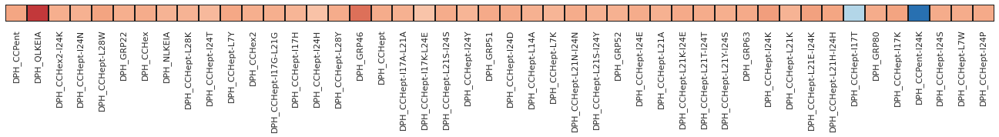


Normal_fortyone


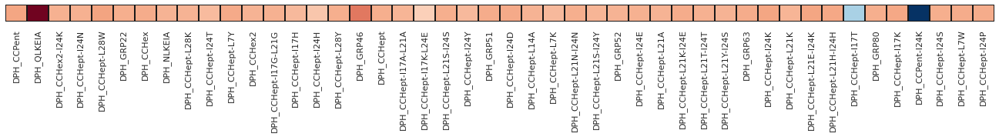


Normal_fortytwo


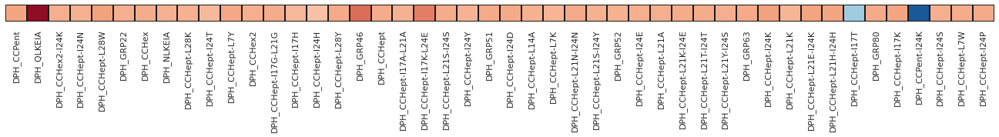


Normal_four


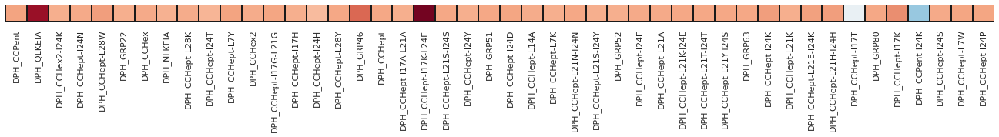


Normal_fourteen


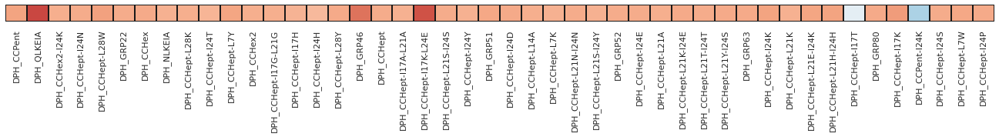


Normal_nine


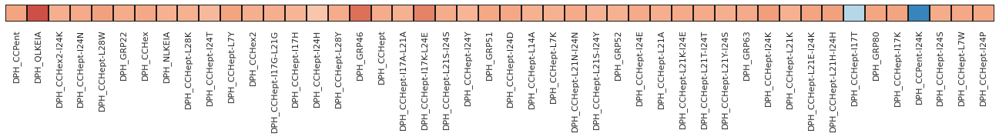


Normal_one


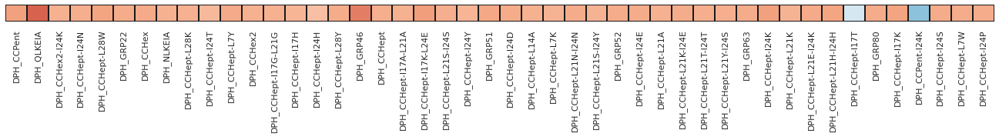


Normal_seven


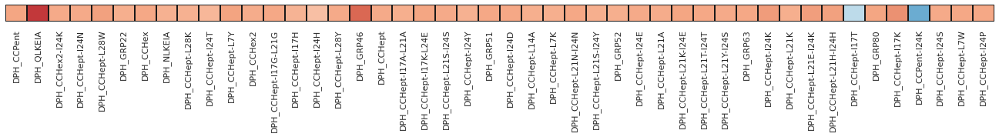


Normal_six


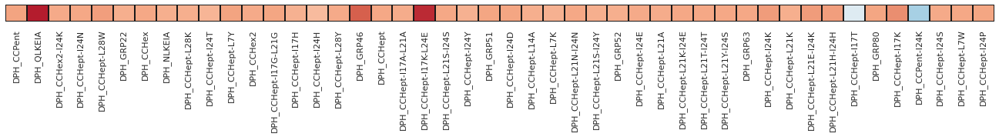


Normal_ten


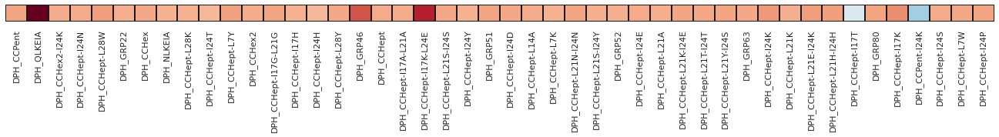


Normal_thirteen


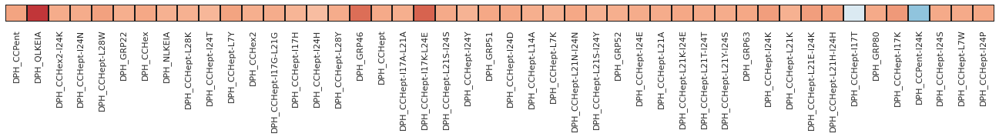


Normal_thirty


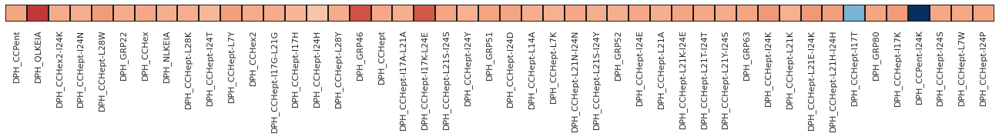


Normal_thirtyeight


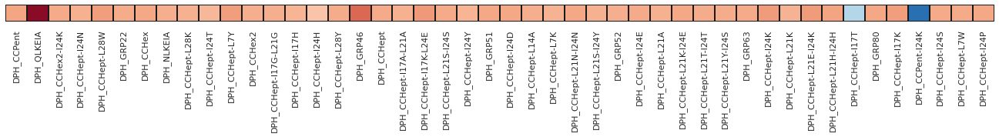


Normal_thirtyfive


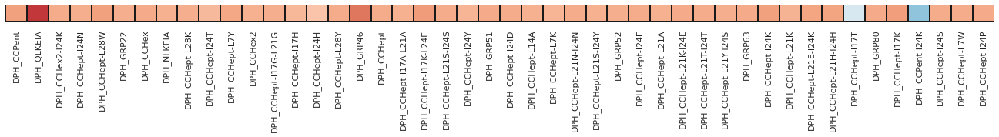


Normal_thirtyfour


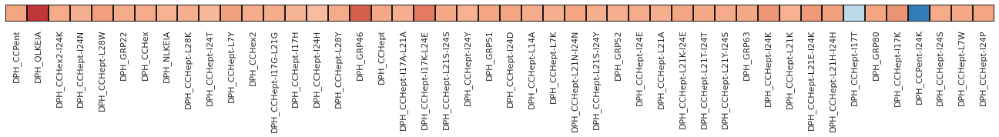


Normal_thirtynine


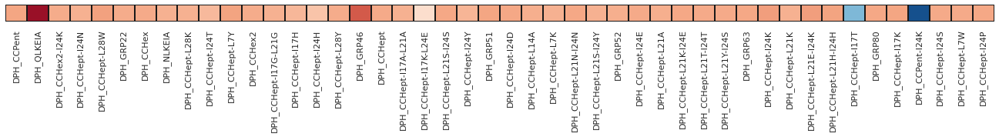


Normal_thirtyone


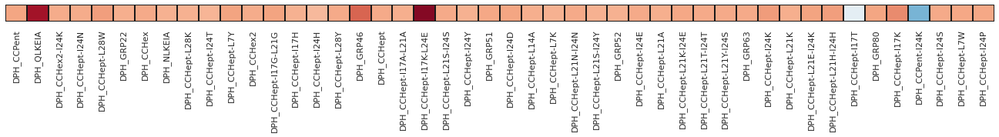


Normal_thirtyseven


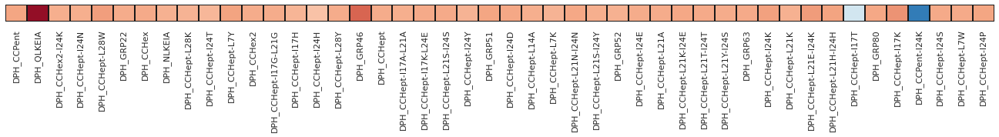


Normal_thirtysix


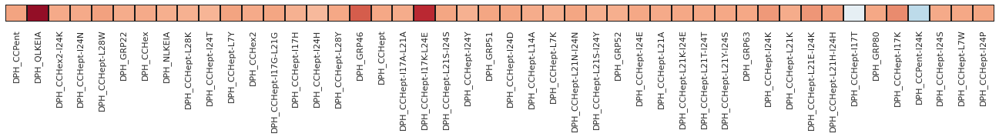


Normal_thirtythree


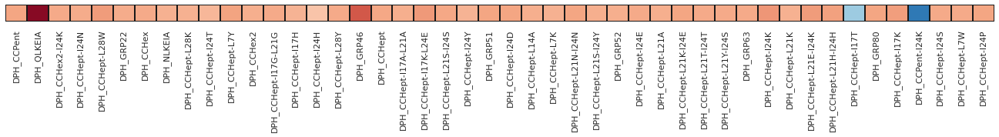


Normal_thirtytwo


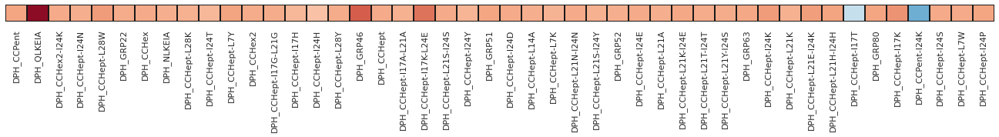


Normal_three


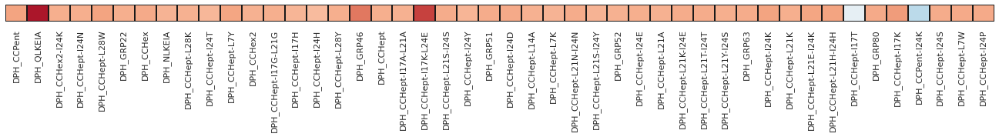


Normal_twelve


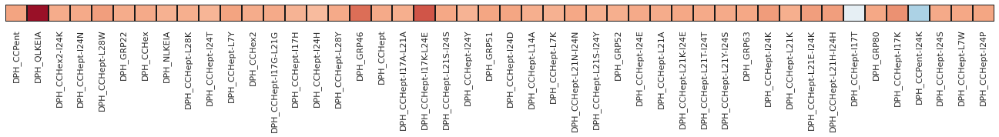


Normal_twentynine


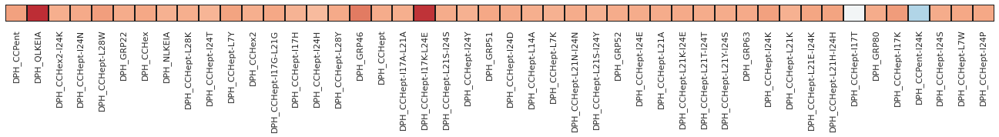


Normal_two


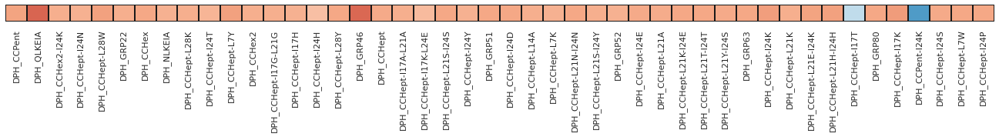




Scaled_data:


NASH_eighteen


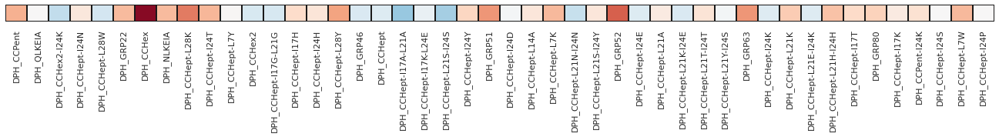


NASH_fifteen


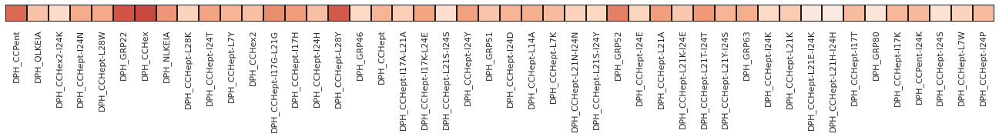


NASH_nineteen


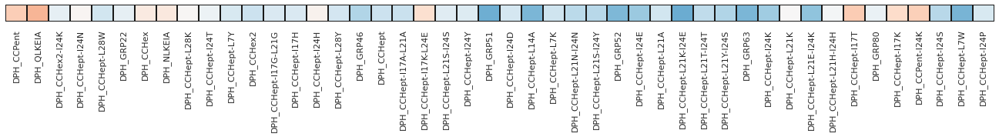


NASH_seventeen


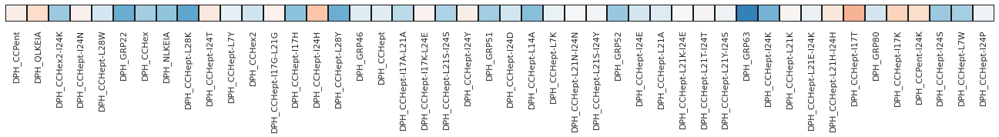


NASH_sixteen


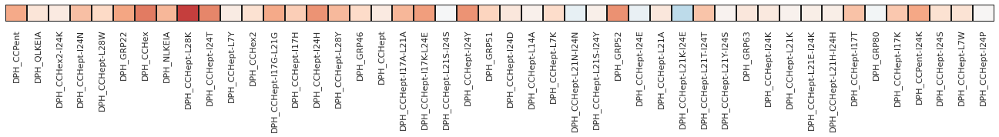


NASH_twenty


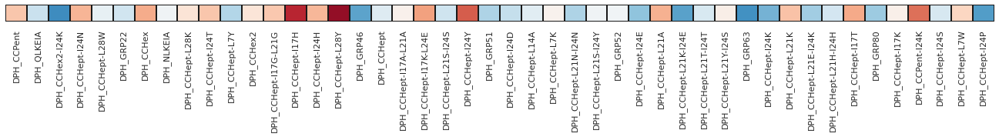


NASH_twentyeight


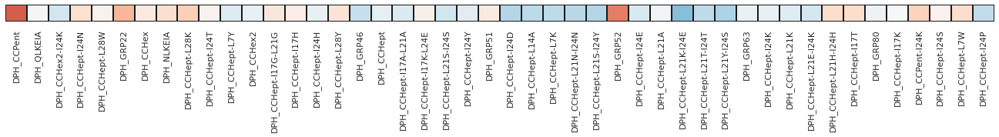


NASH_twentyfive


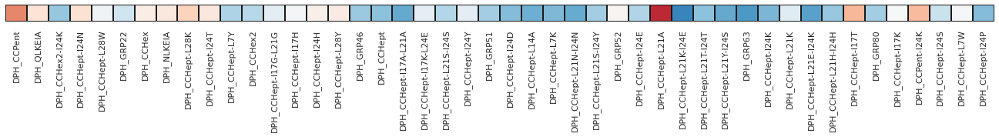


NASH_twentyfour


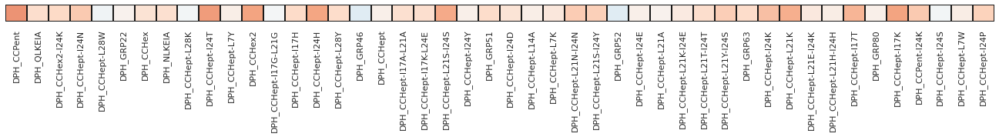


NASH_twentyone


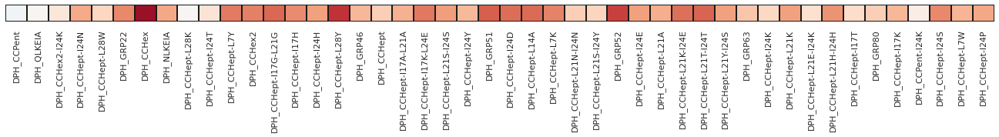


NASH_twentyseven


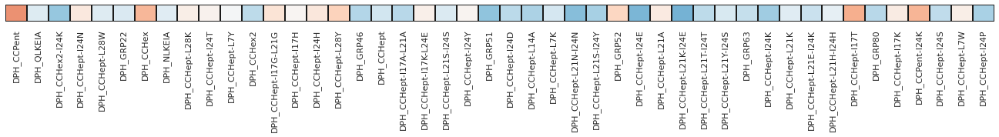


NASH_twentysix


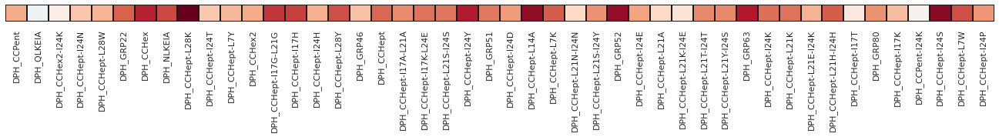


NASH_twentythree


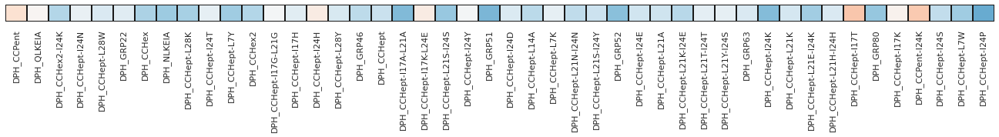


NASH_twentytwo


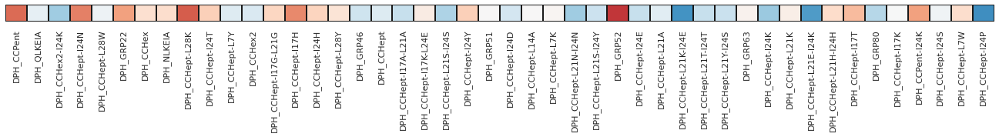


Normal_eight


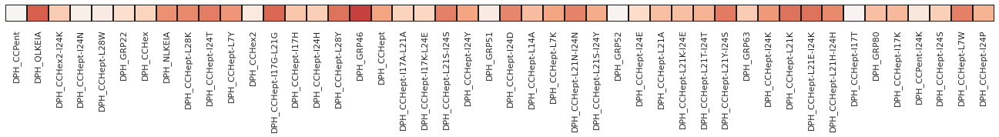


Normal_eleven


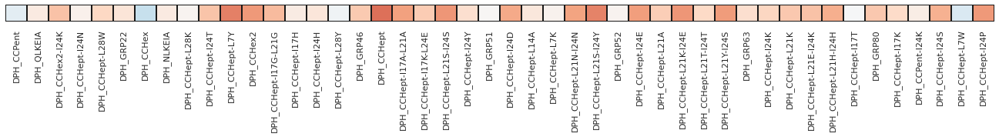


Normal_five


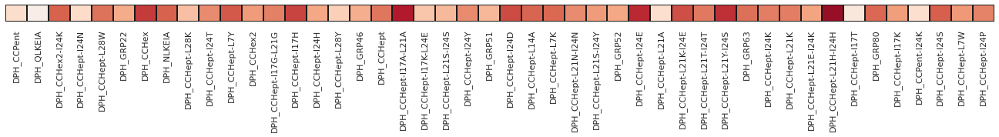


Normal_forty


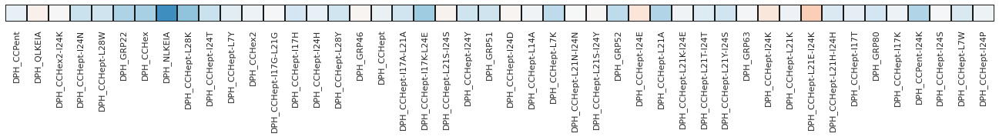


Normal_fortyone


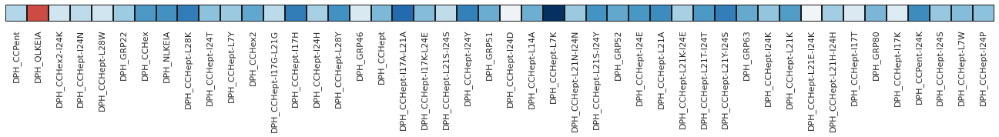


Normal_fortytwo


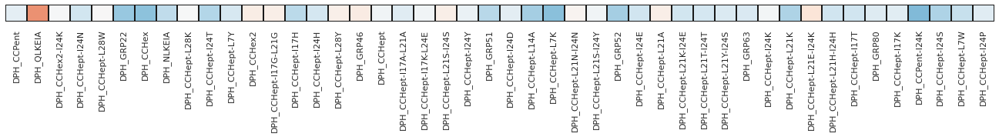


Normal_four


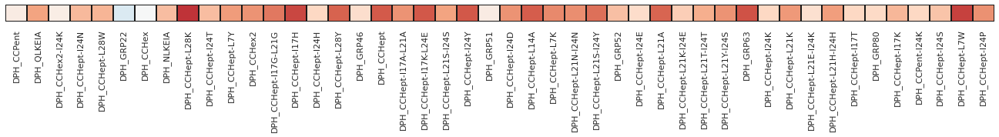


Normal_fourteen


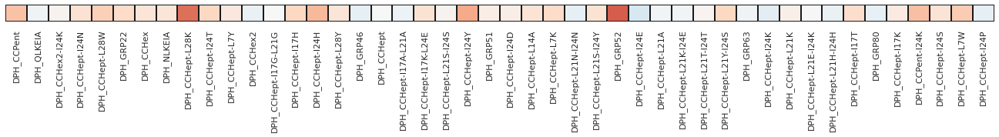


Normal_nine


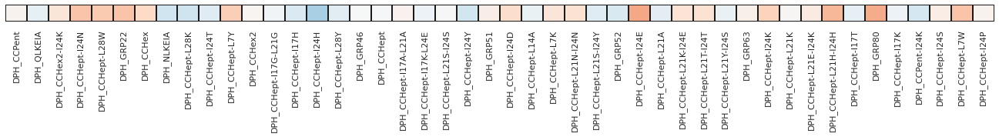


Normal_one


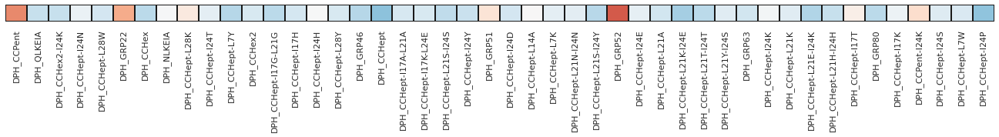


Normal_seven


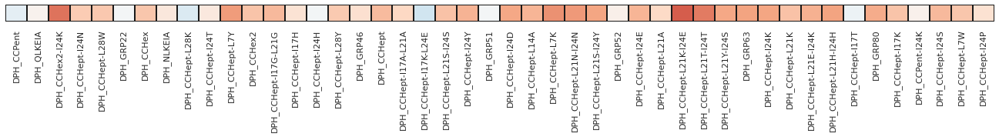


Normal_six


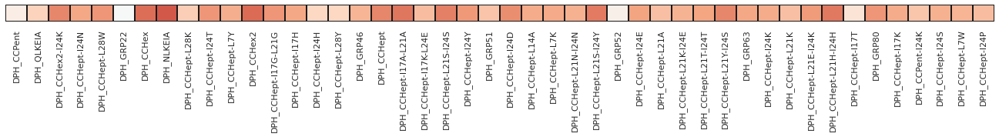


Normal_ten


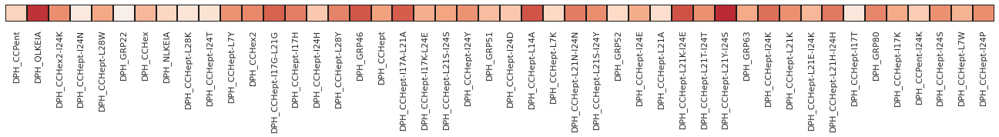


Normal_thirteen


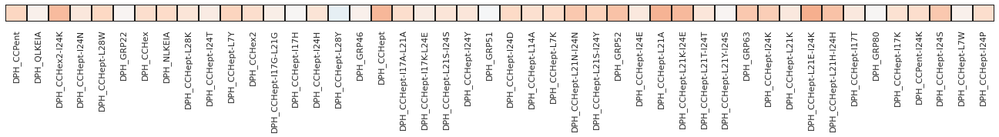


Normal_thirty


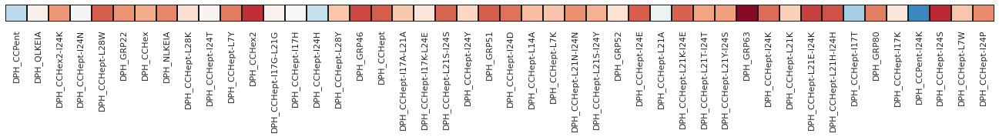


Normal_thirtyeight


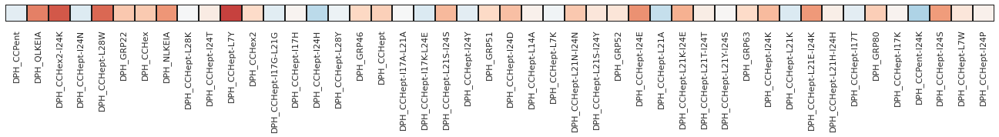


Normal_thirtyfive


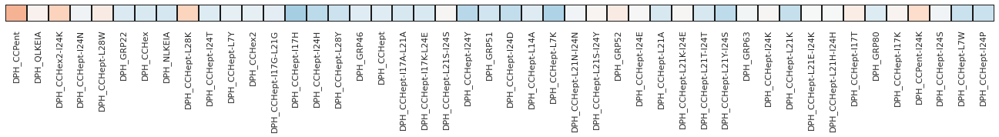


Normal_thirtyfour


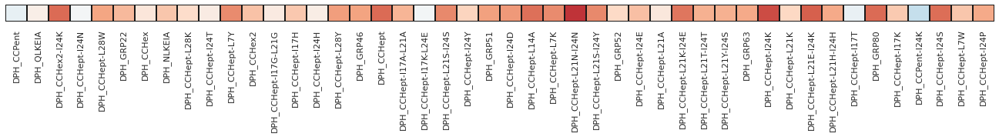


Normal_thirtynine


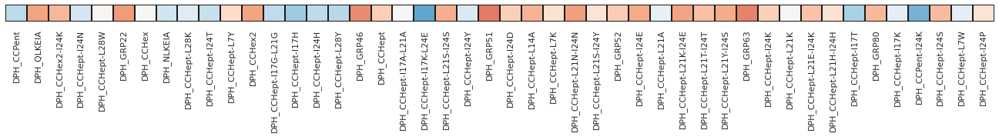


Normal_thirtyone


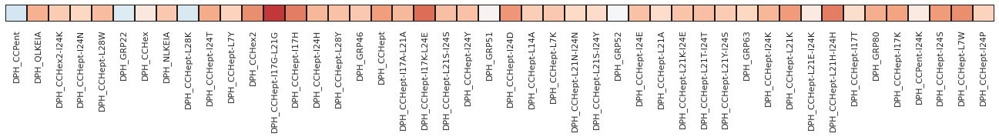


Normal_thirtyseven


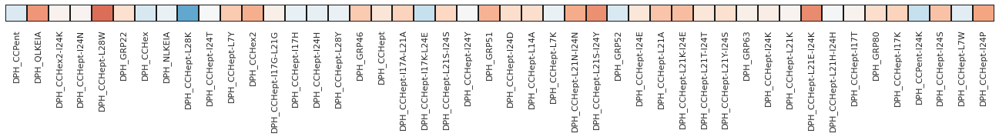


Normal_thirtysix


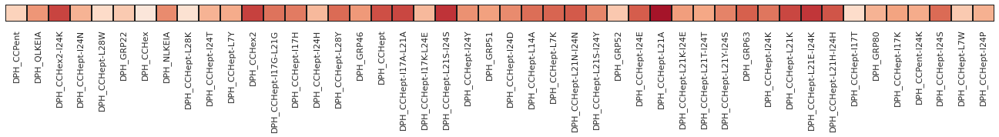


Normal_thirtythree


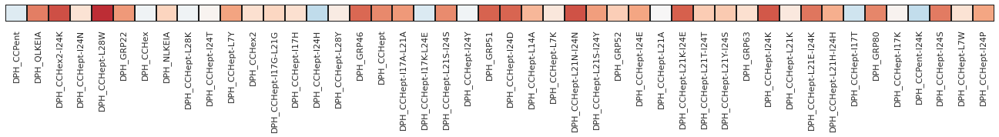


Normal_thirtytwo


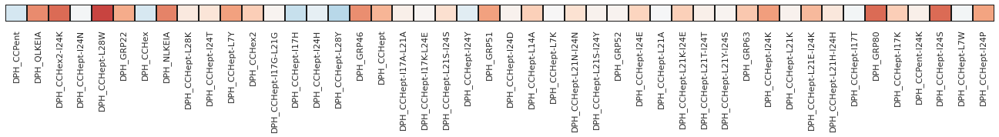


Normal_three


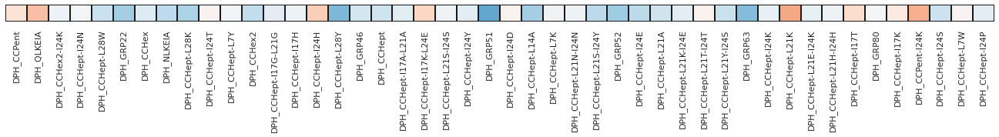


Normal_twelve


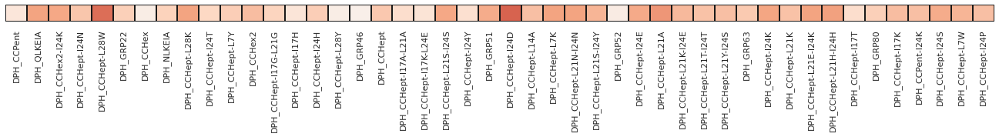


Normal_twentynine


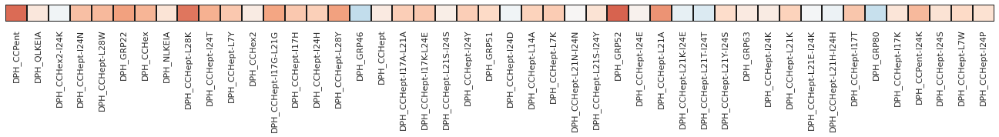


Normal_two


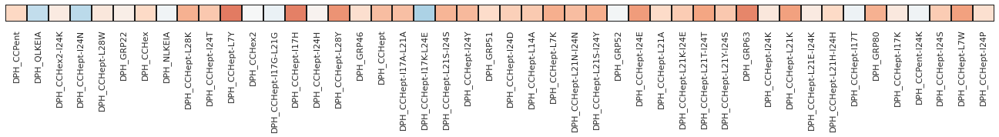




Original_data:



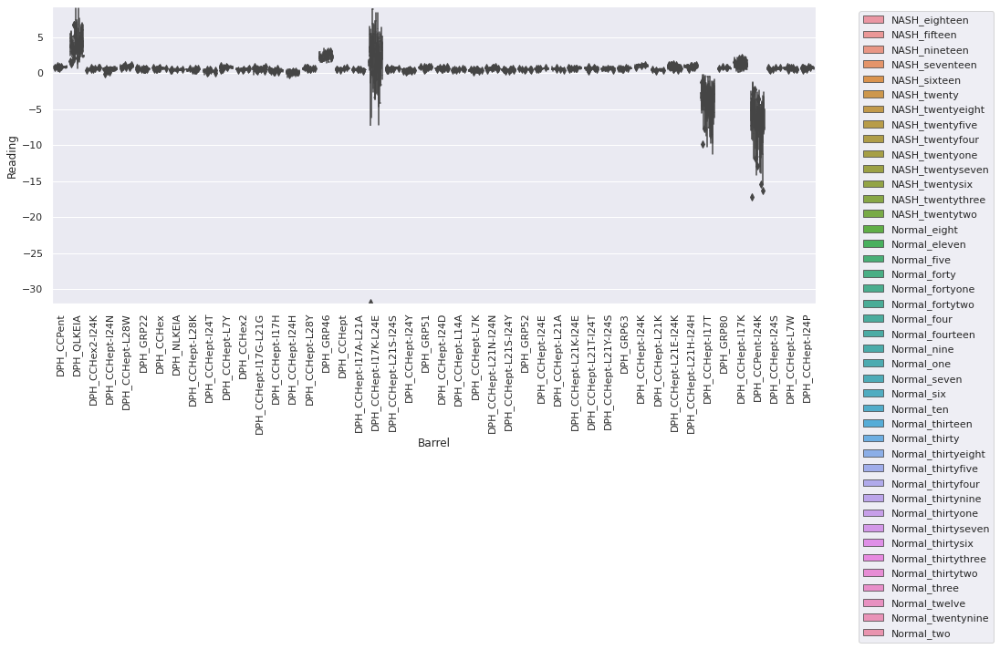

NASH_eighteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


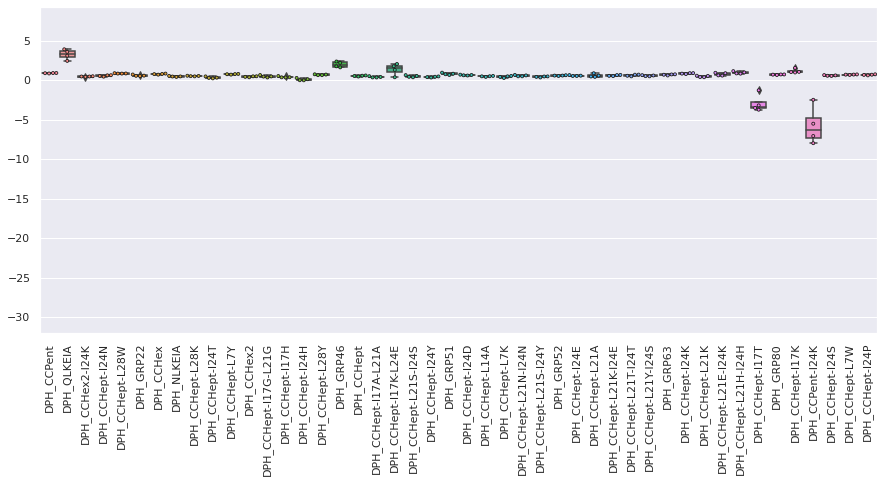

NASH_fifteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


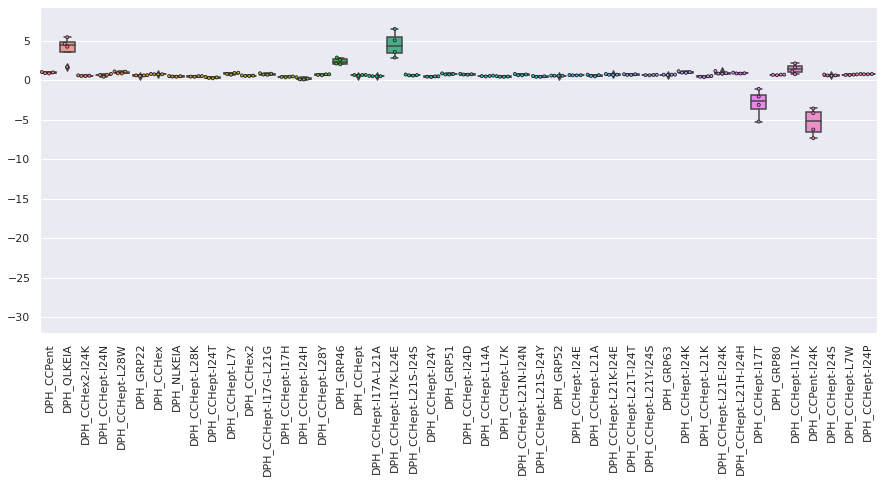

NASH_nineteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


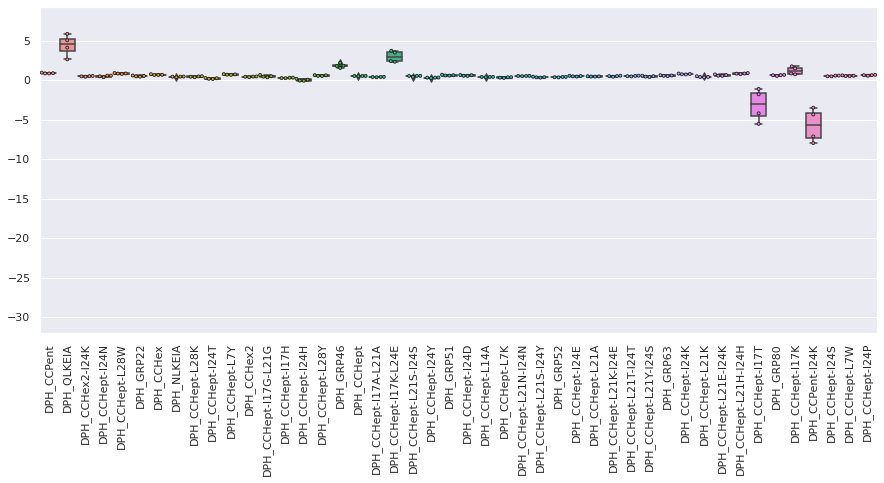

NASH_seventeen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


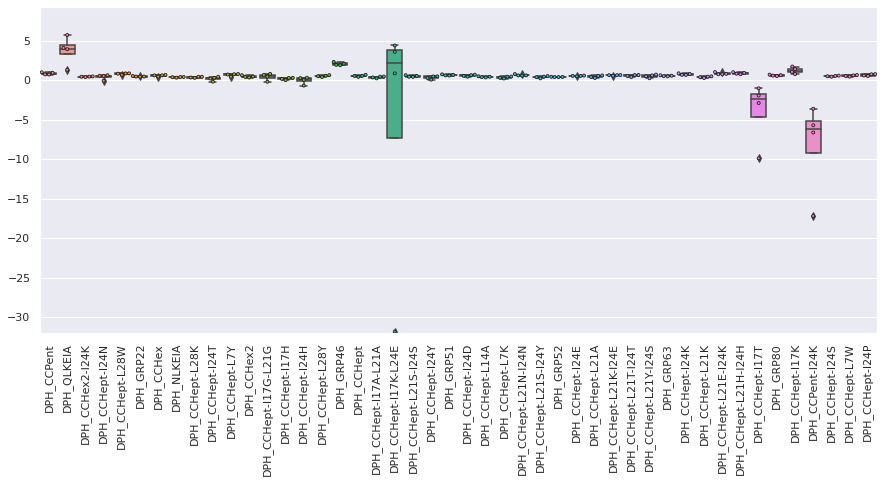

NASH_sixteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


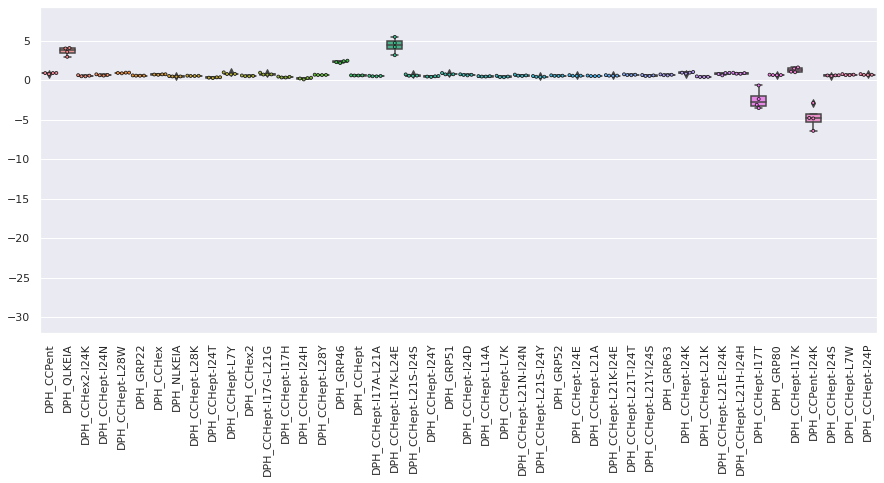

NASH_twenty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


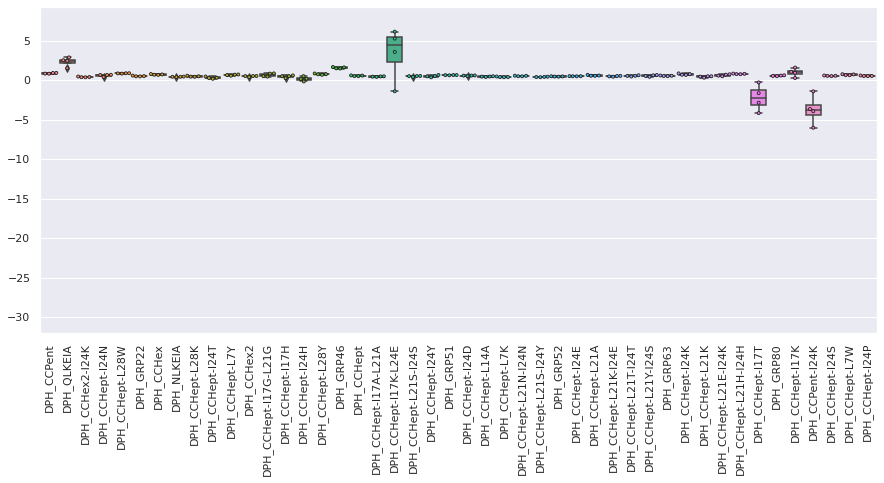

NASH_twentyeight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


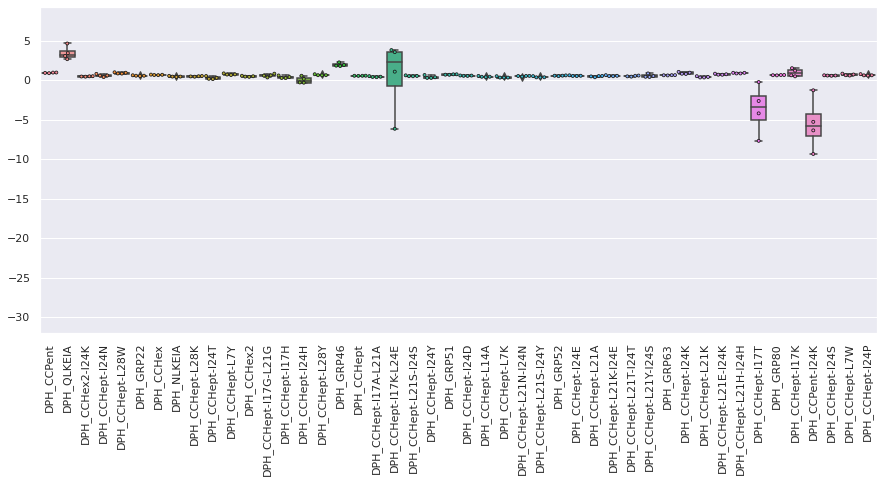

NASH_twentyfive


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


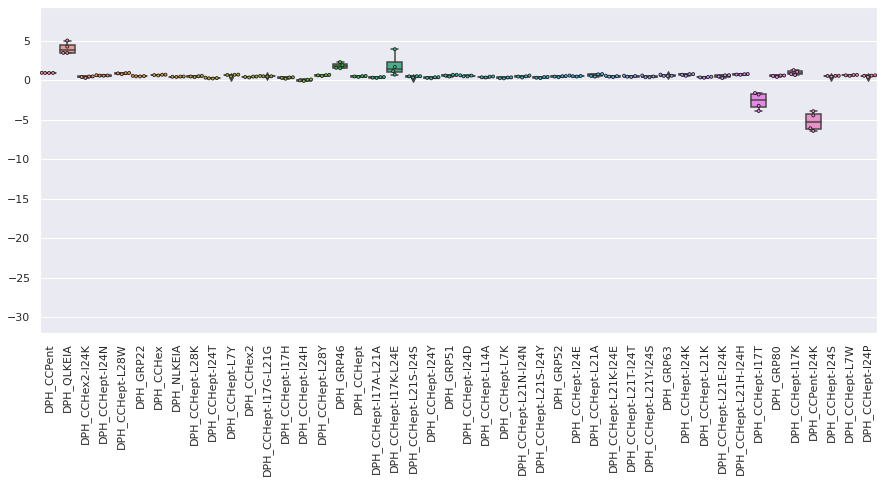

NASH_twentyfour


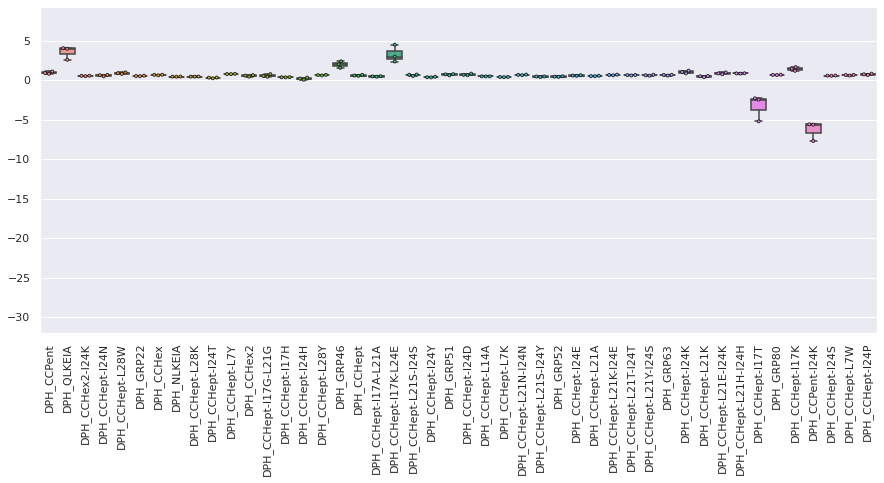

NASH_twentyone


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


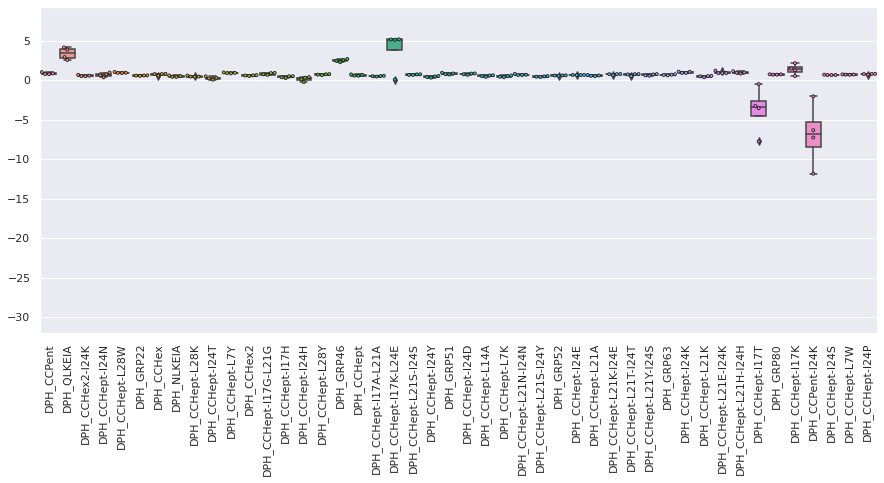

NASH_twentyseven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


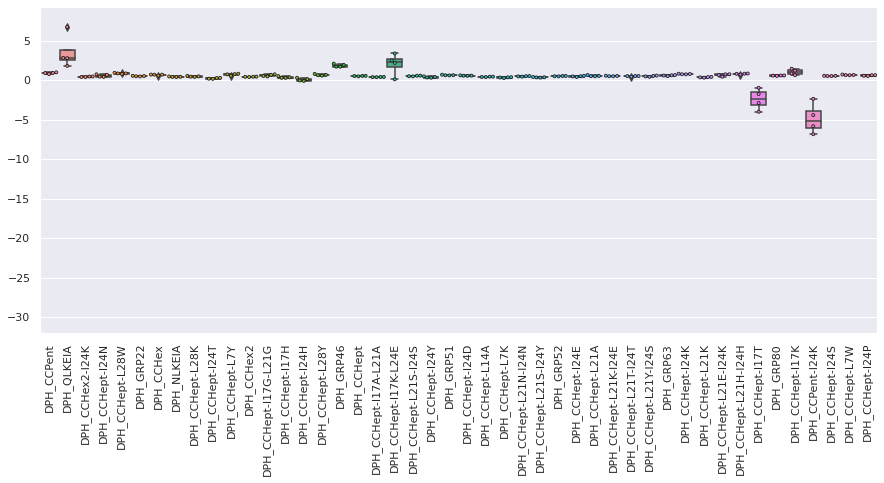

NASH_twentysix


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


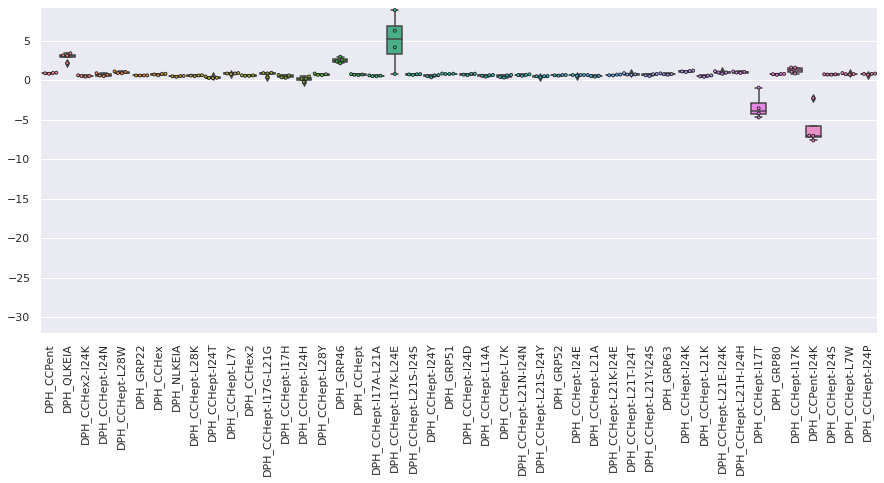

NASH_twentythree


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


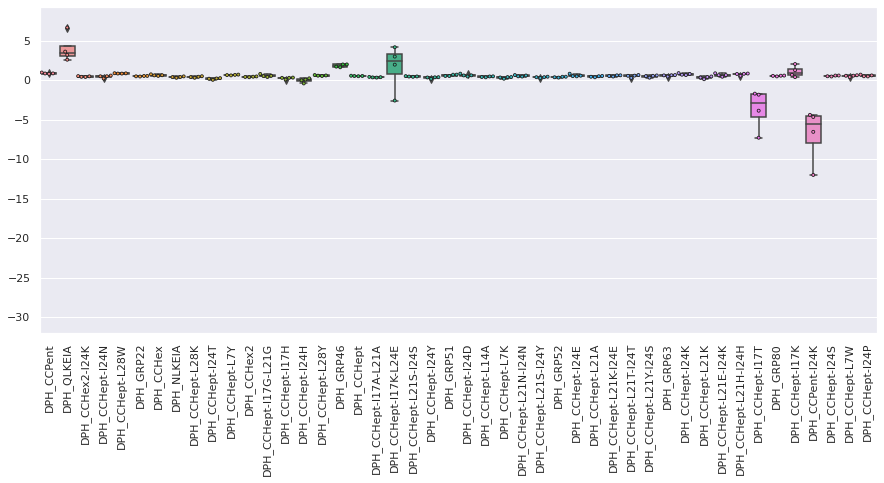

NASH_twentytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


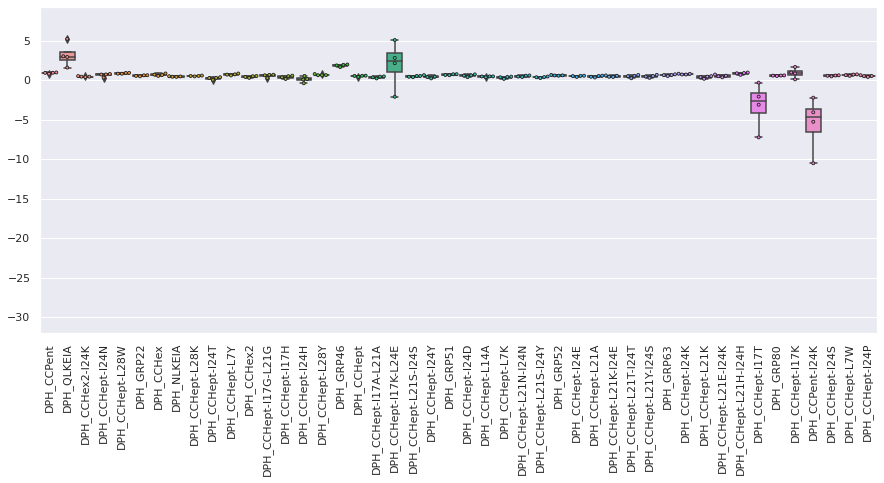

Normal_eight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


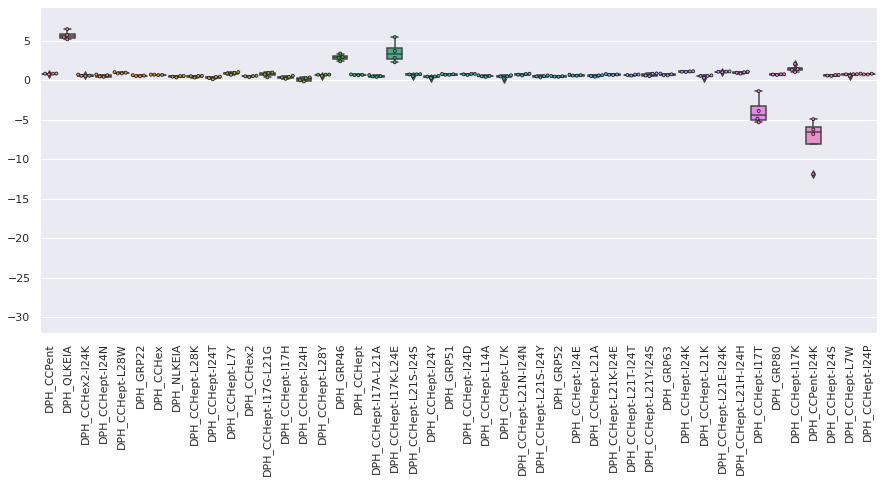

Normal_eleven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


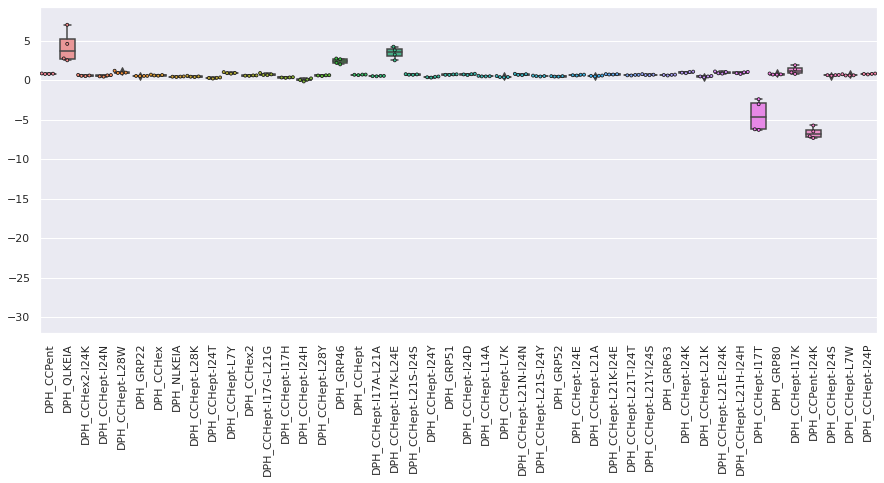

Normal_five


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


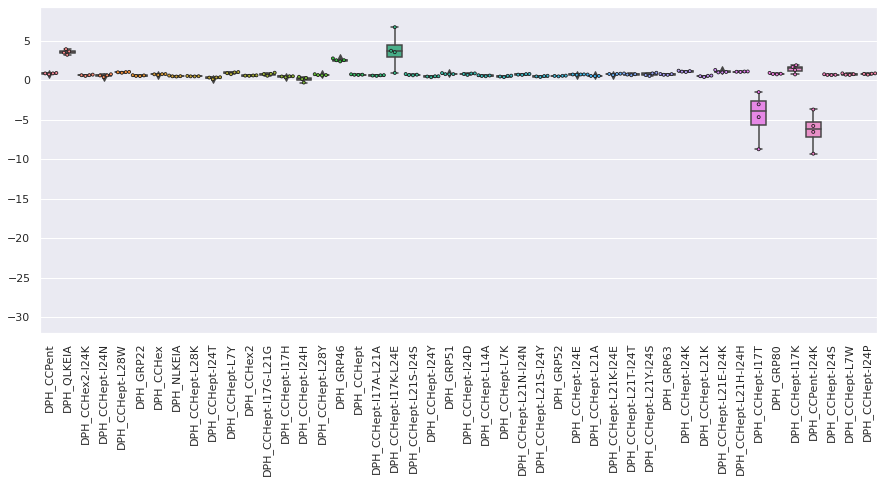

Normal_forty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


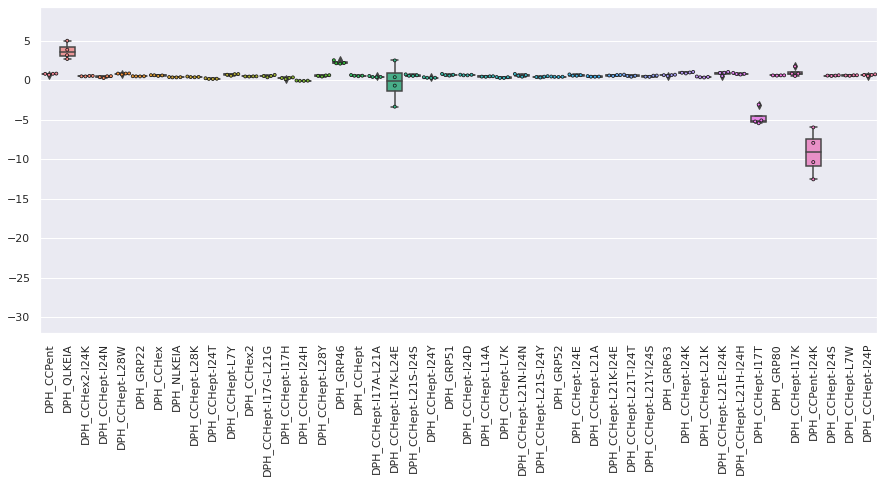

Normal_fortyone


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


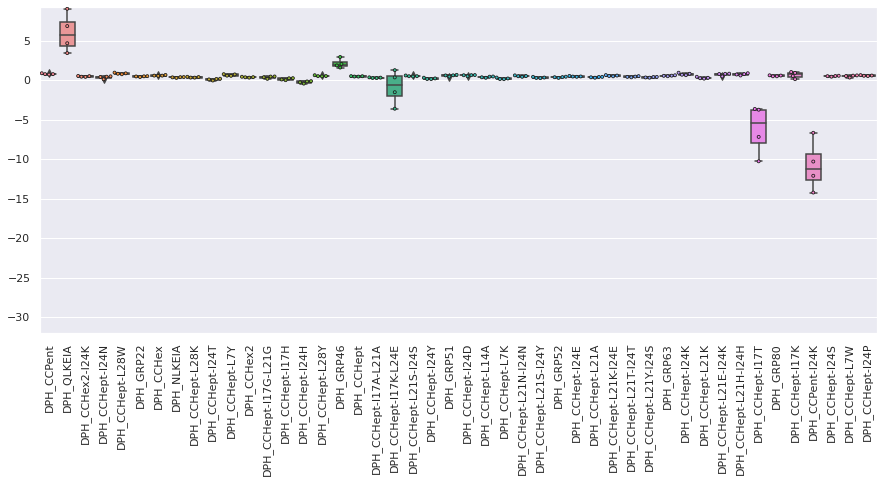

Normal_fortytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


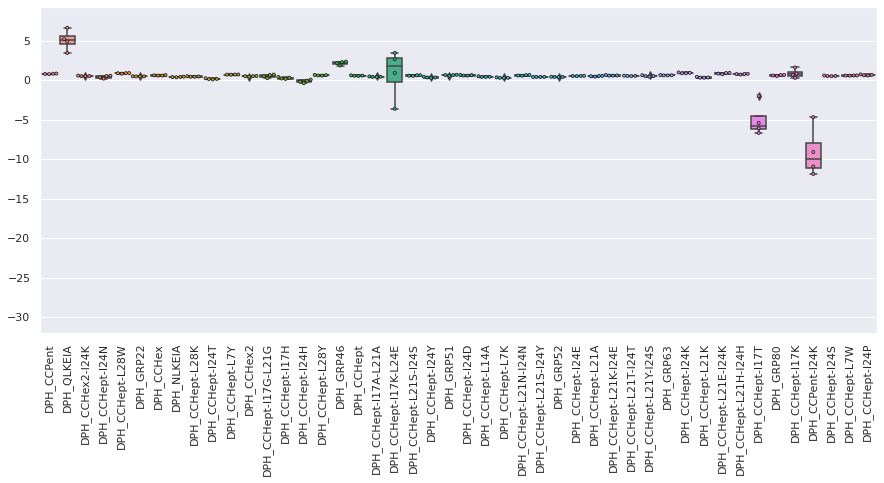

Normal_four


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


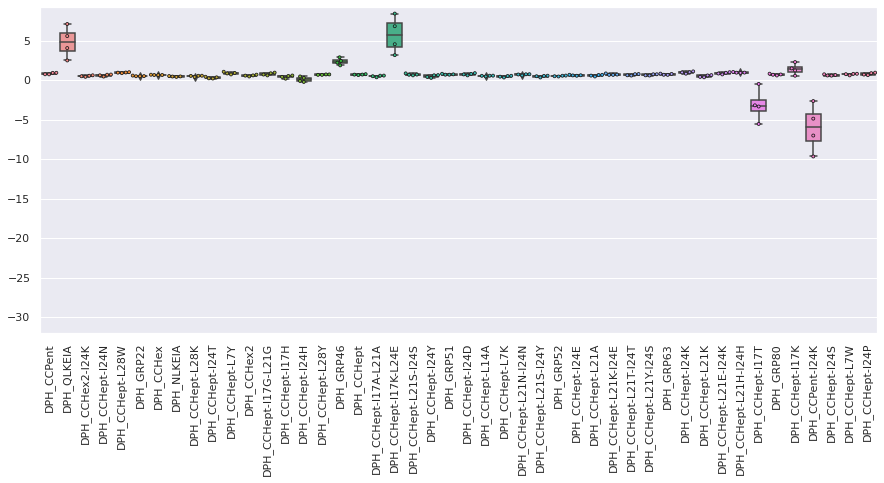

Normal_fourteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


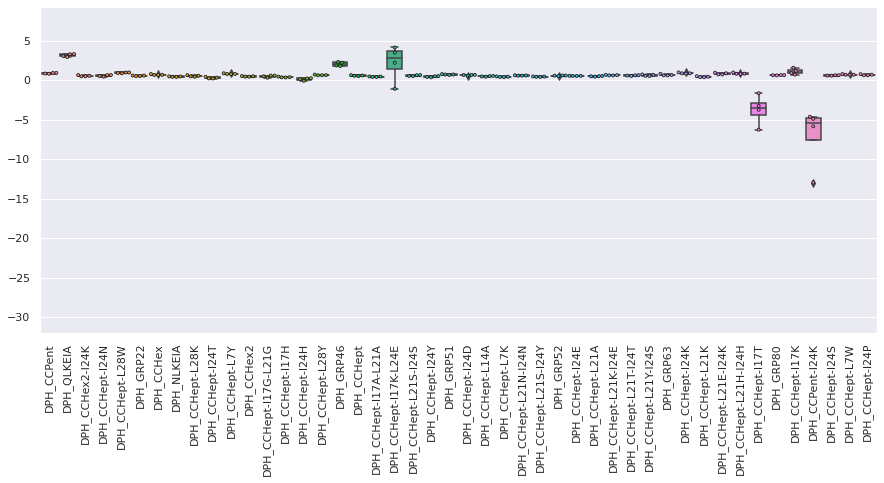

Normal_nine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


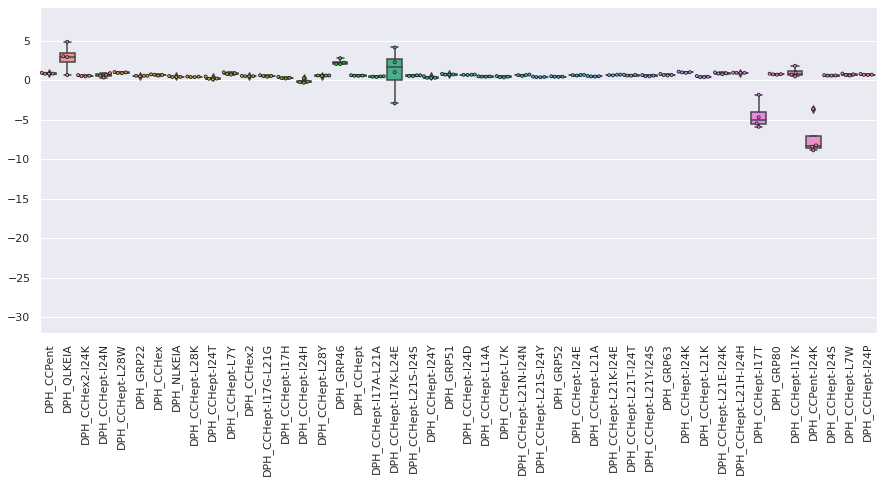

Normal_one


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


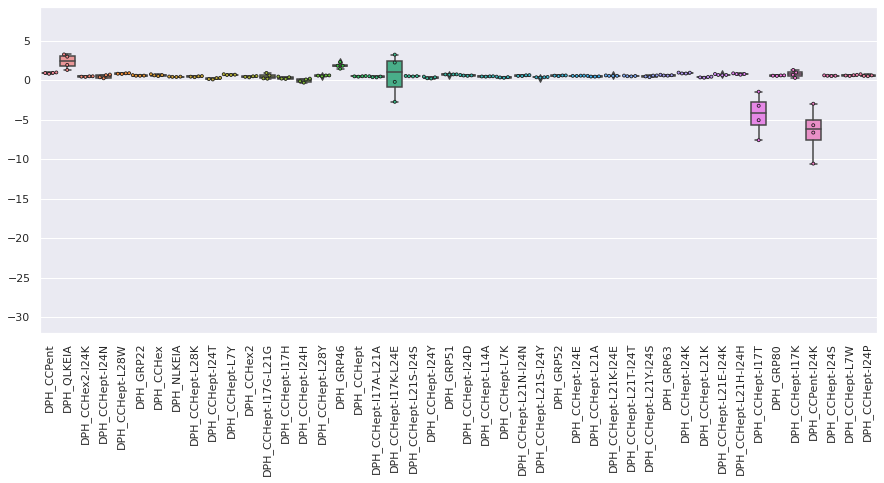

Normal_seven


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


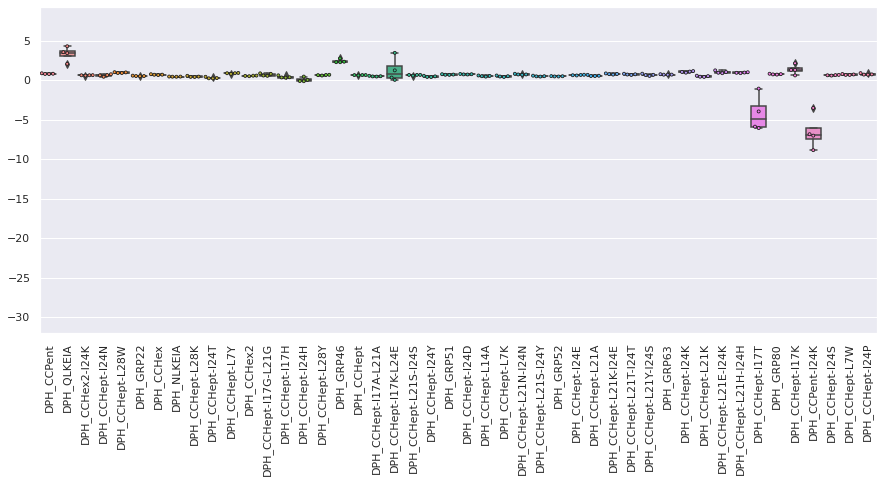

Normal_six


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


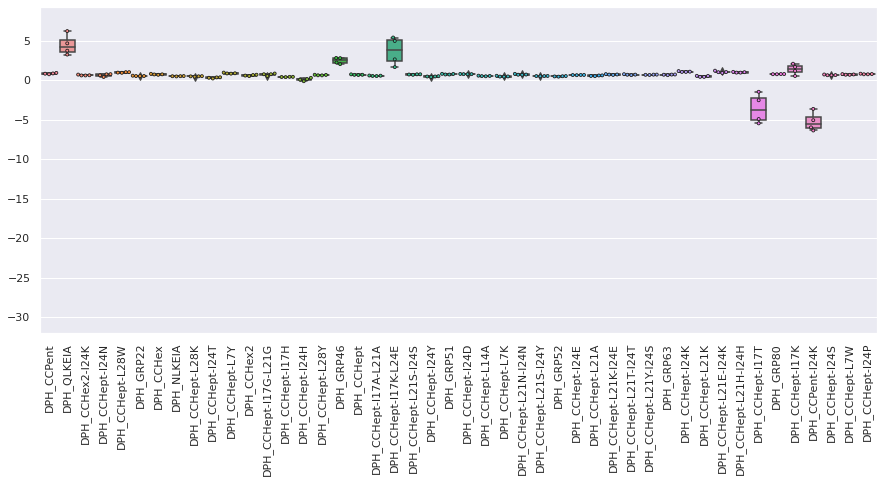

Normal_ten


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


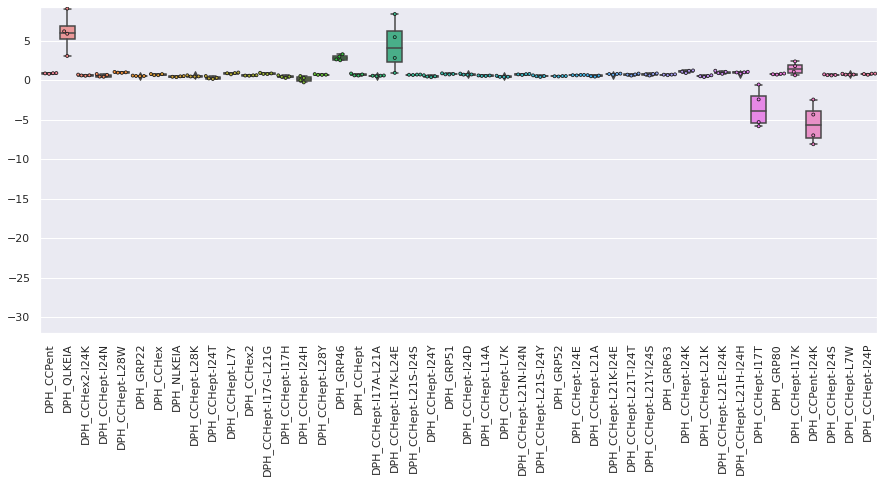

Normal_thirteen


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


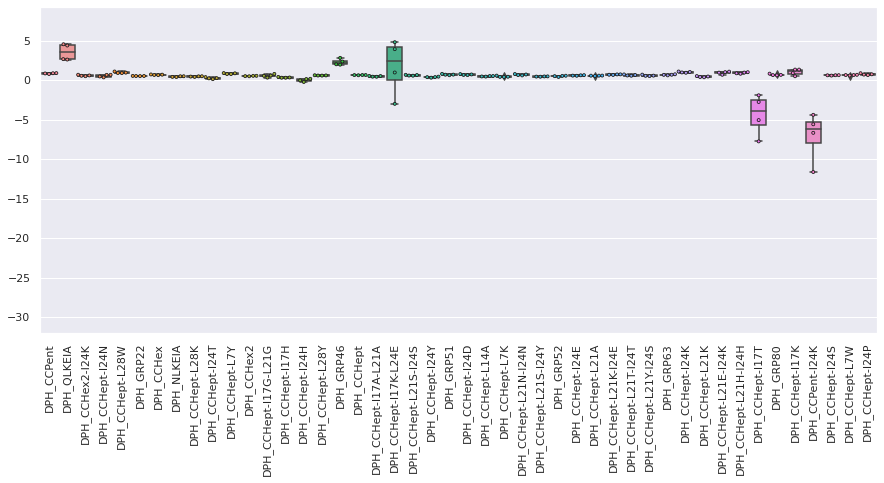

Normal_thirty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


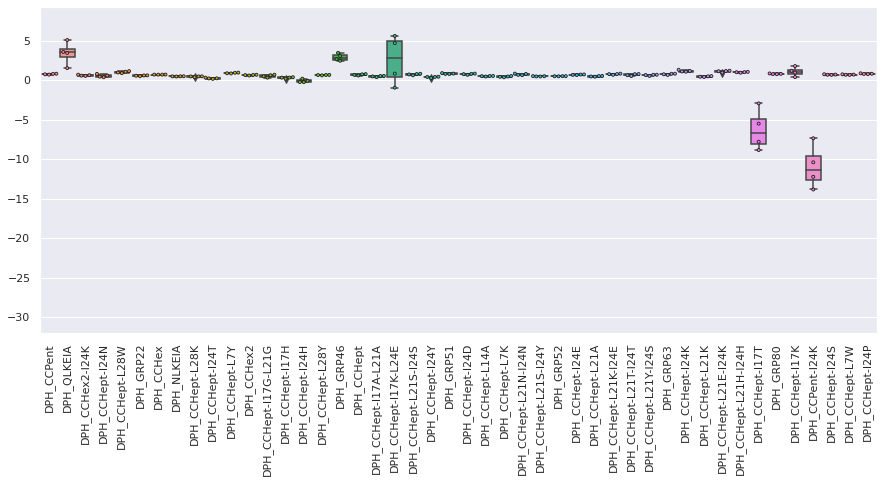

Normal_thirtyeight


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


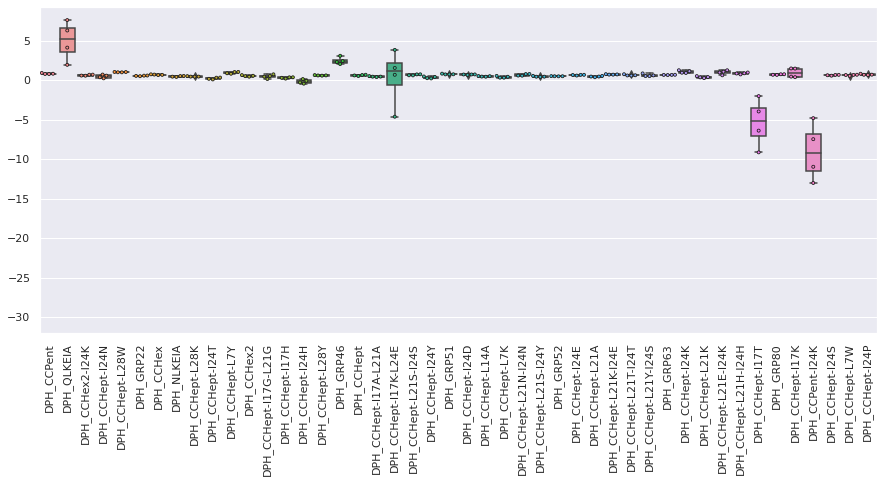

Normal_thirtyfive


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


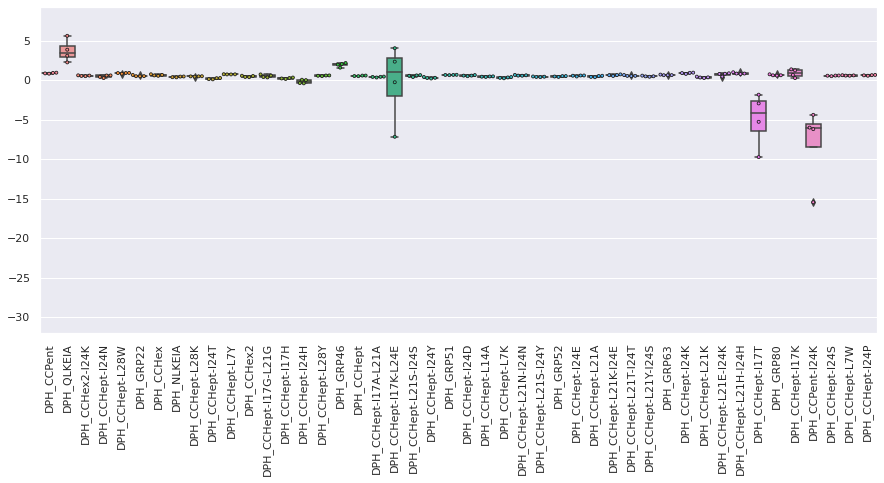

Normal_thirtyfour


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


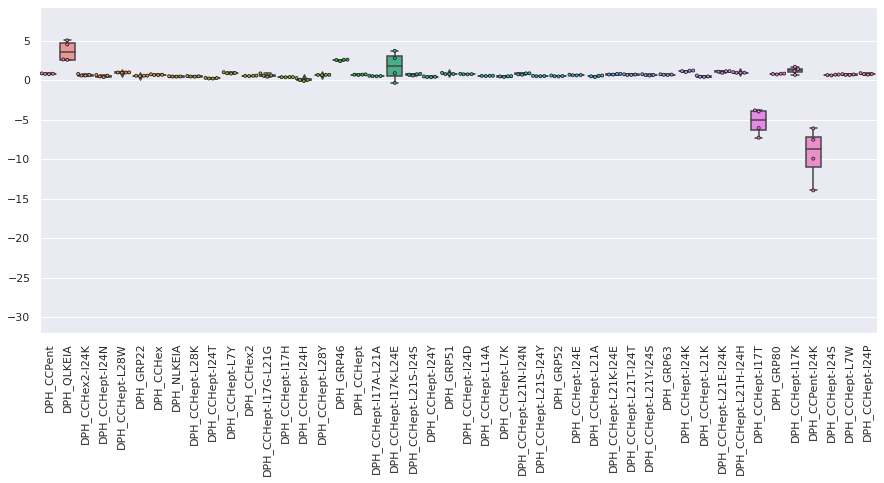

Normal_thirtynine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


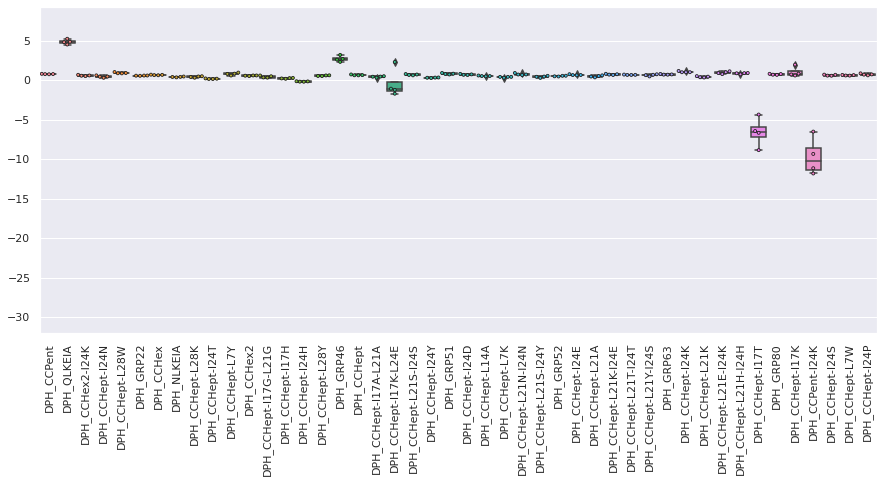

Normal_thirtyone


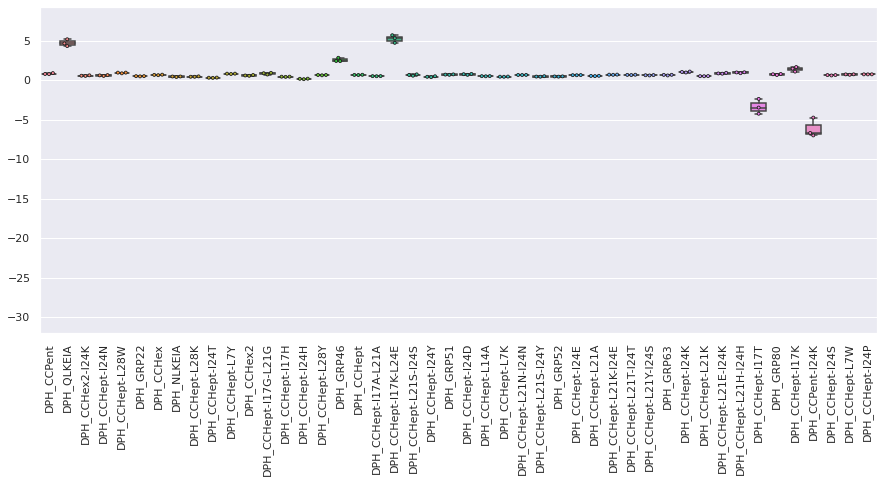

Normal_thirtyseven


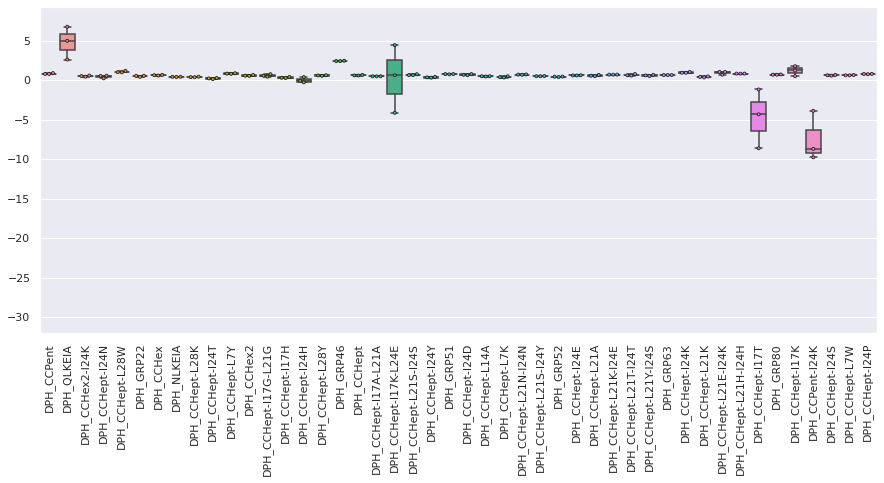

Normal_thirtysix


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


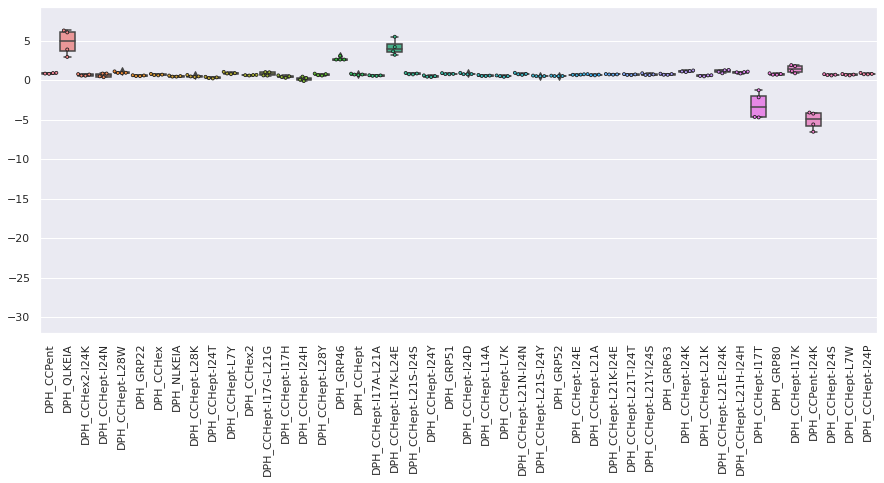

Normal_thirtythree


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


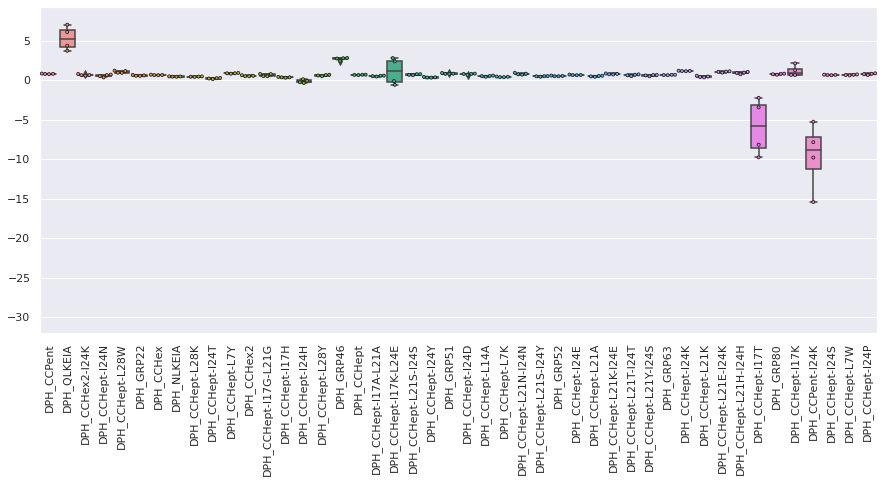

Normal_thirtytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


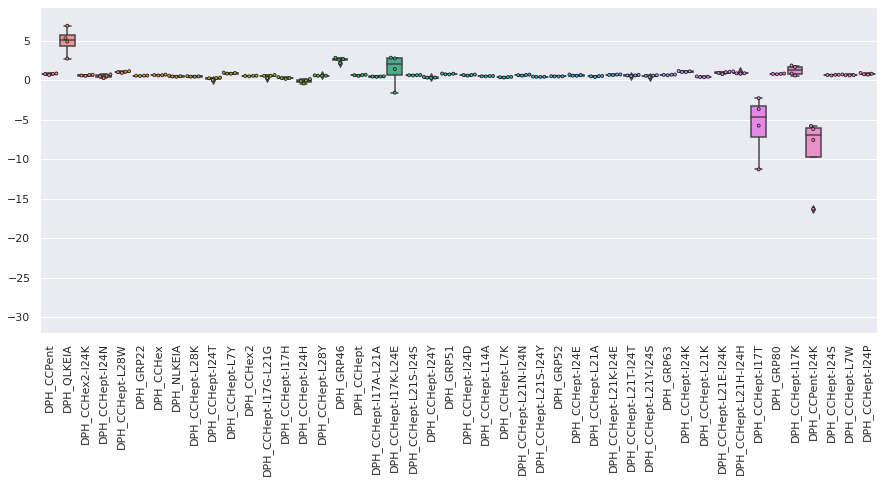

Normal_three


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


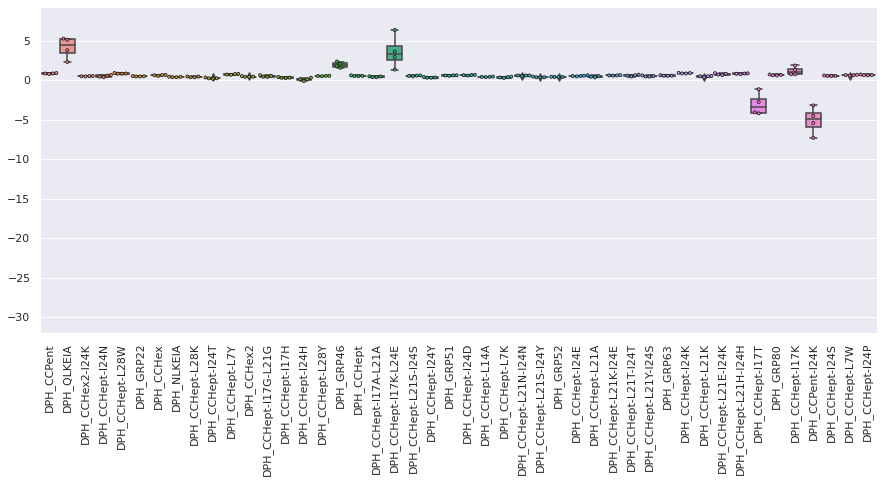

Normal_twelve


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


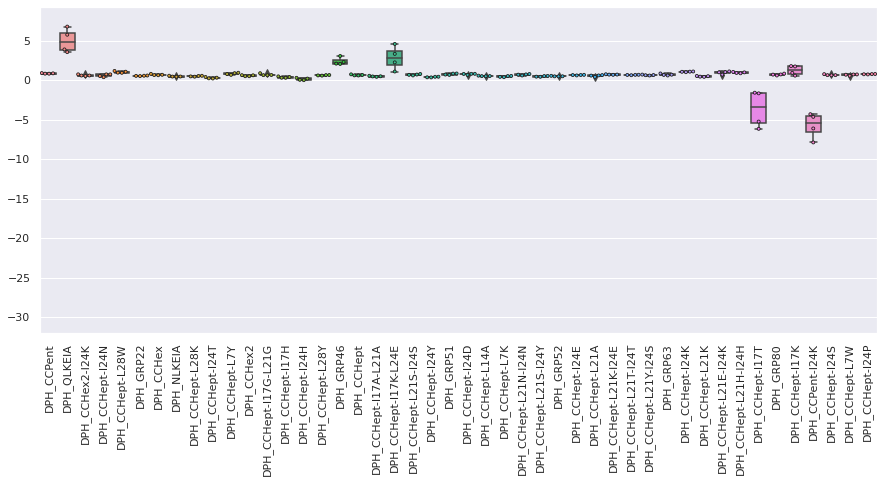

Normal_twentynine


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


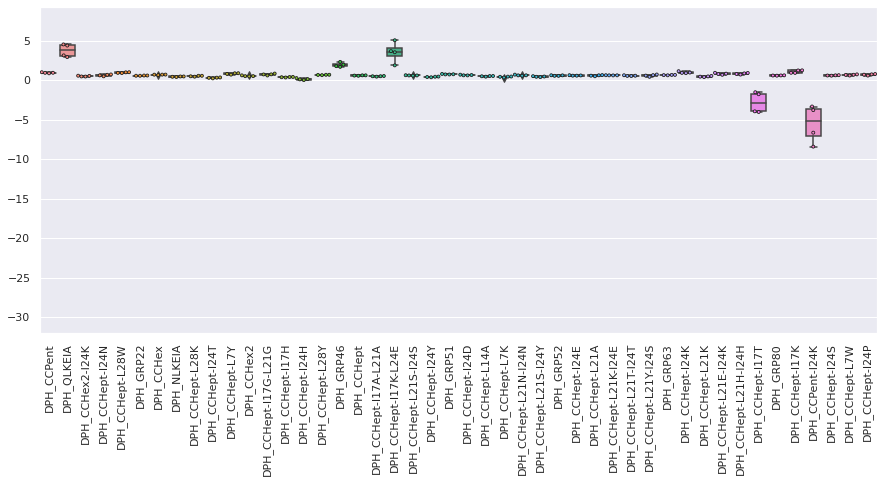

Normal_two


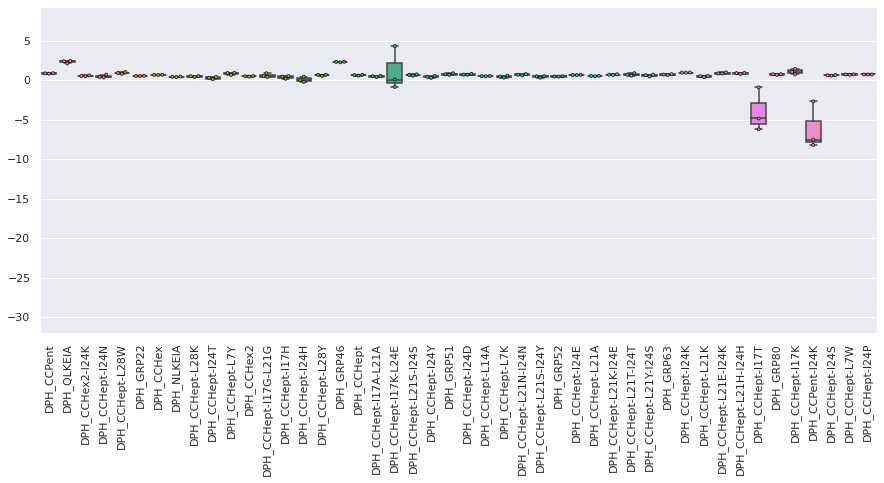




Scaled_data:



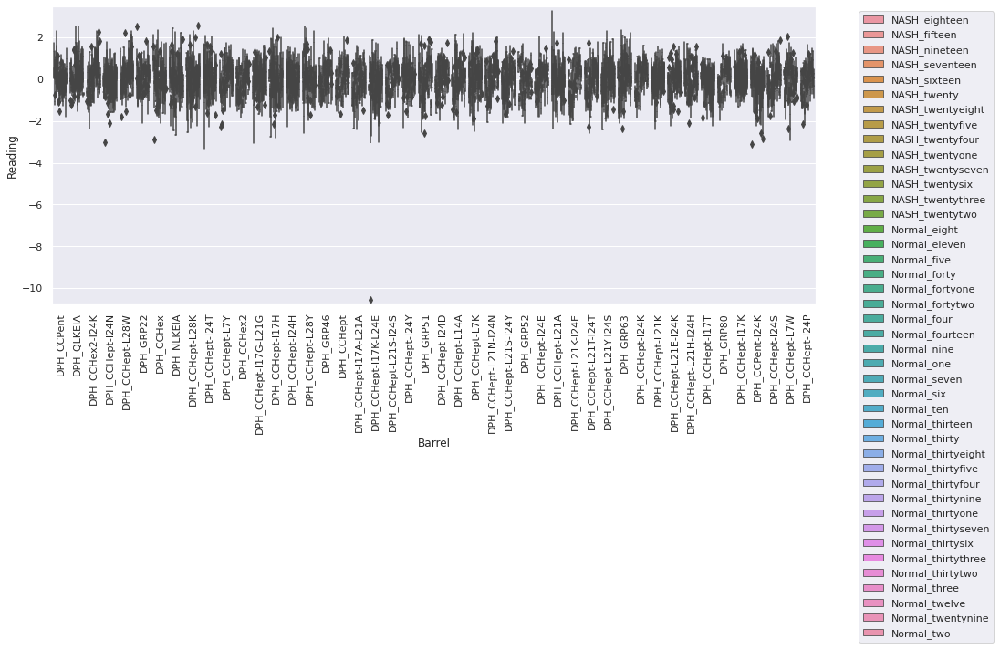

NASH_eighteen


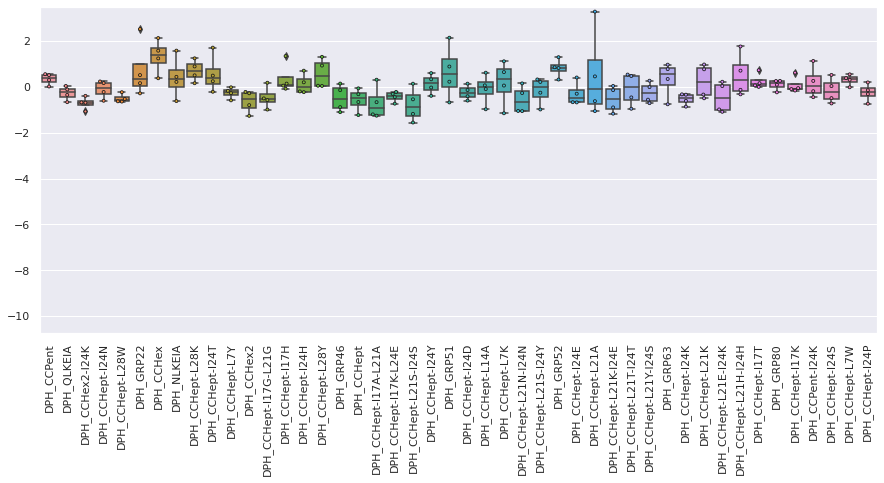

NASH_fifteen


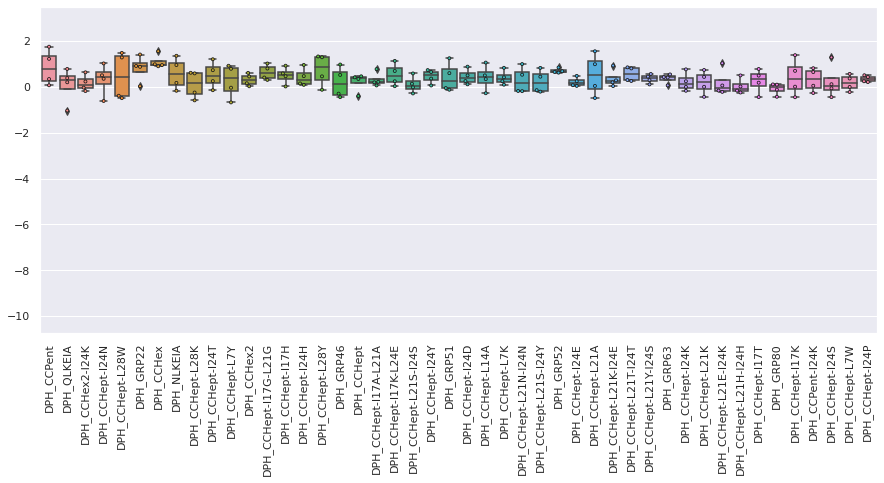

NASH_nineteen


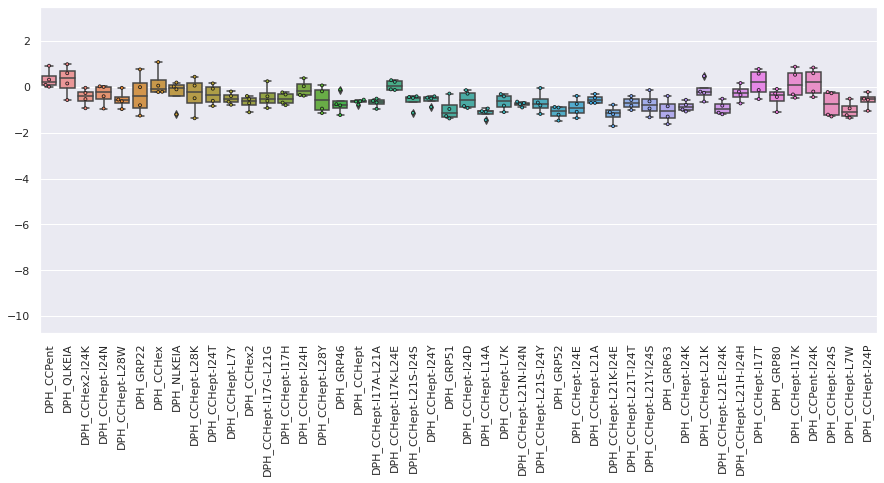

NASH_seventeen


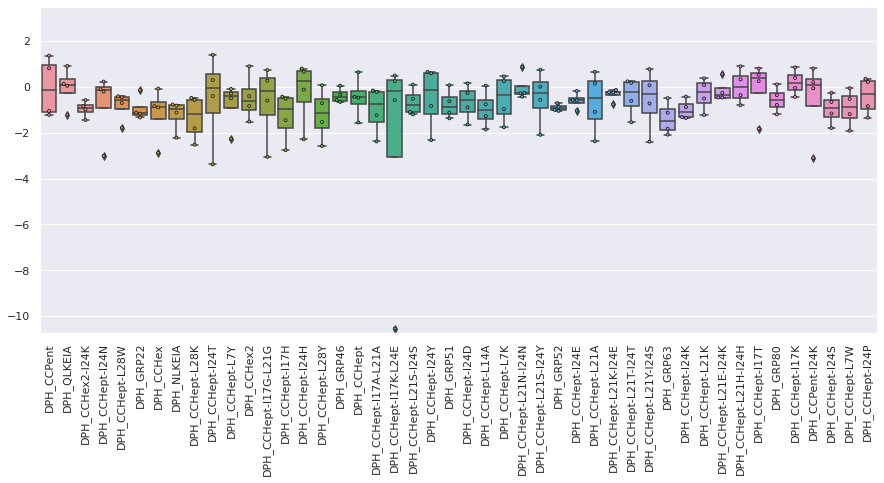

NASH_sixteen


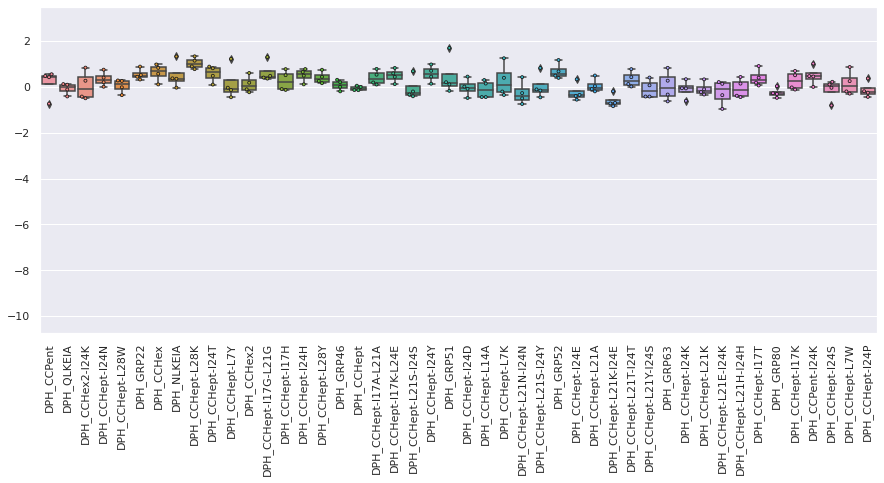

NASH_twenty


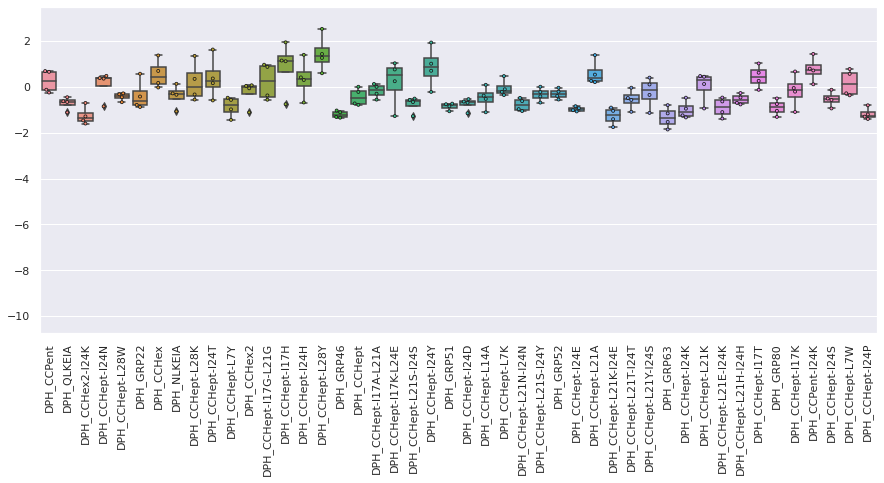

NASH_twentyeight


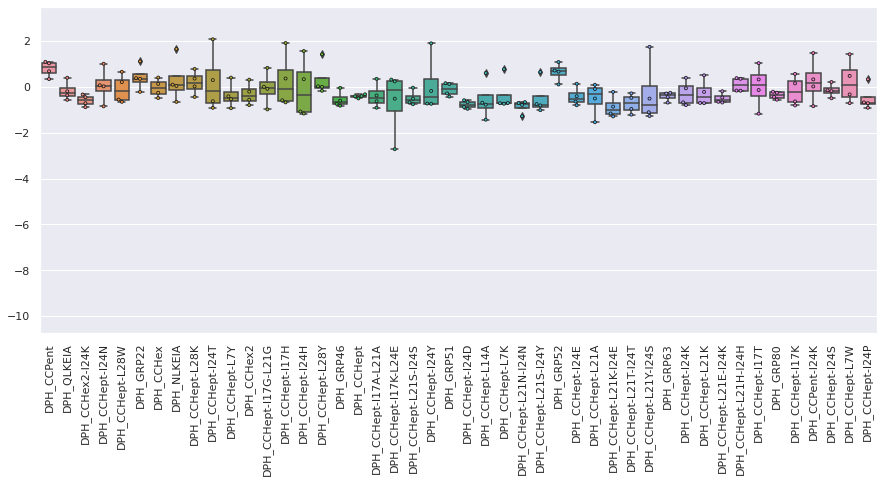

NASH_twentyfive


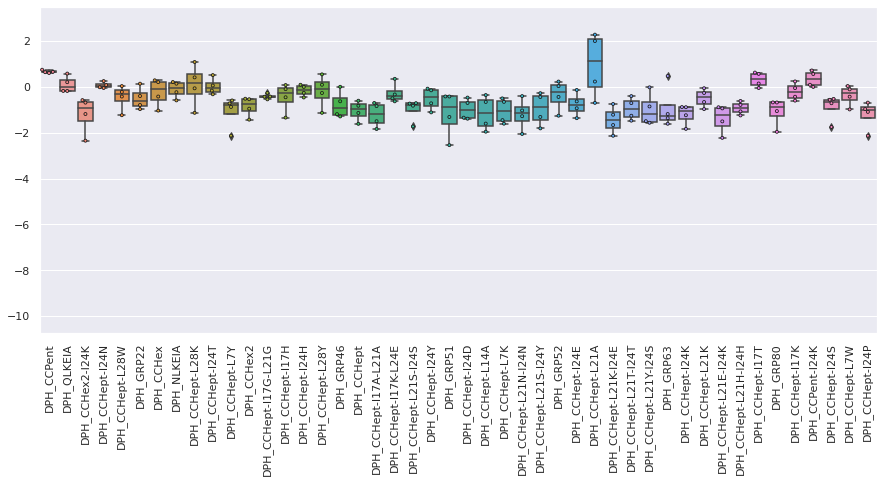

NASH_twentyfour


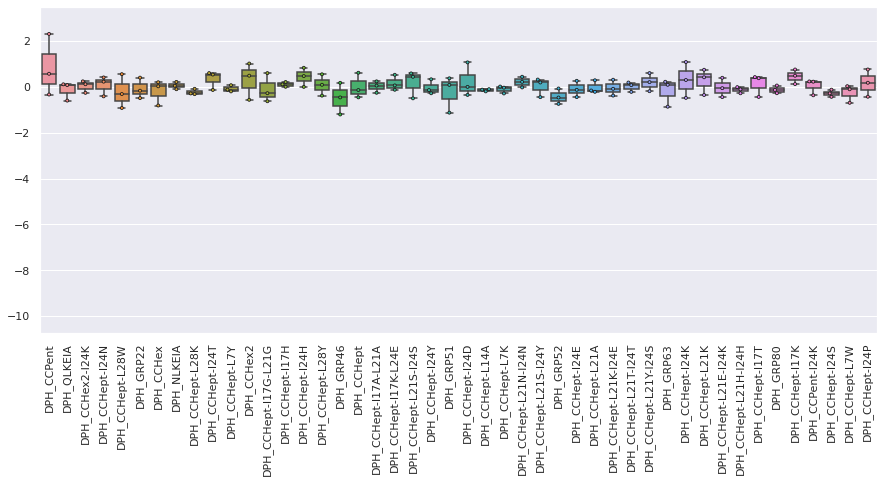

NASH_twentyone


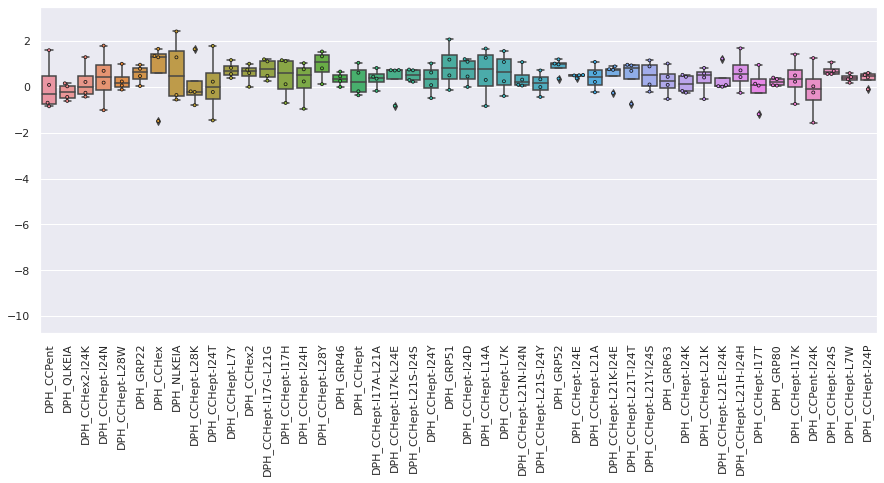

NASH_twentyseven


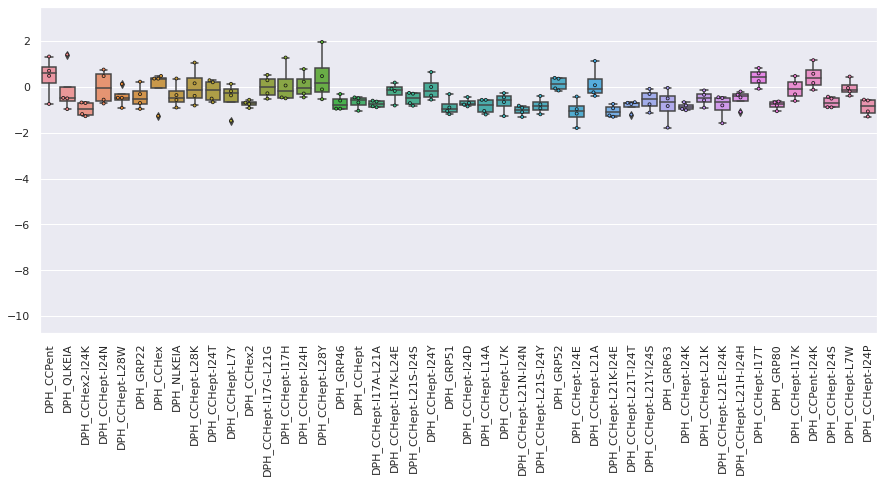

NASH_twentysix


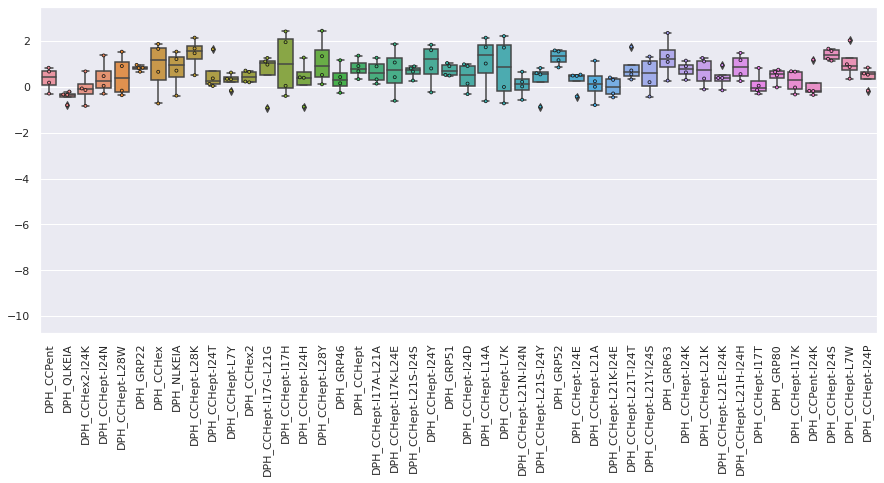

NASH_twentythree


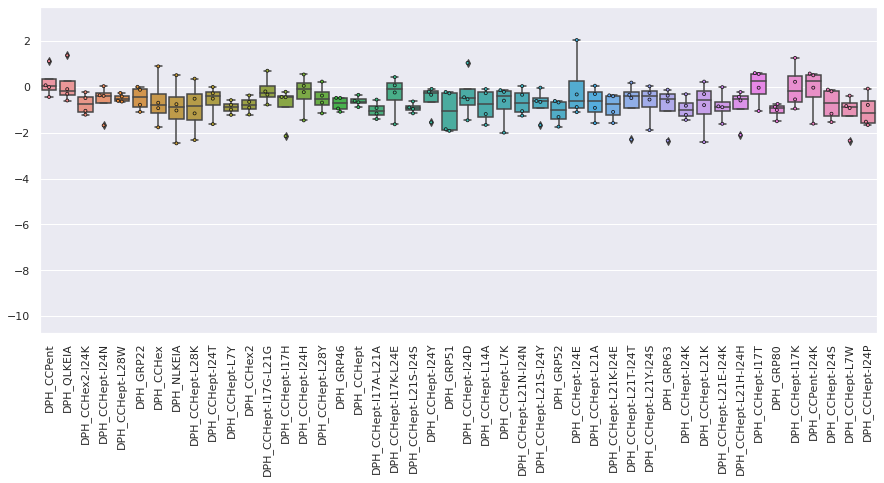

NASH_twentytwo


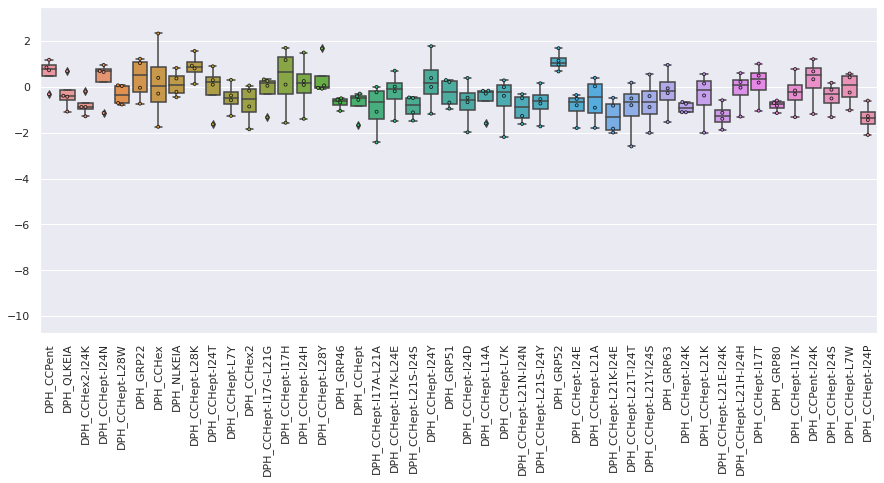

Normal_eight


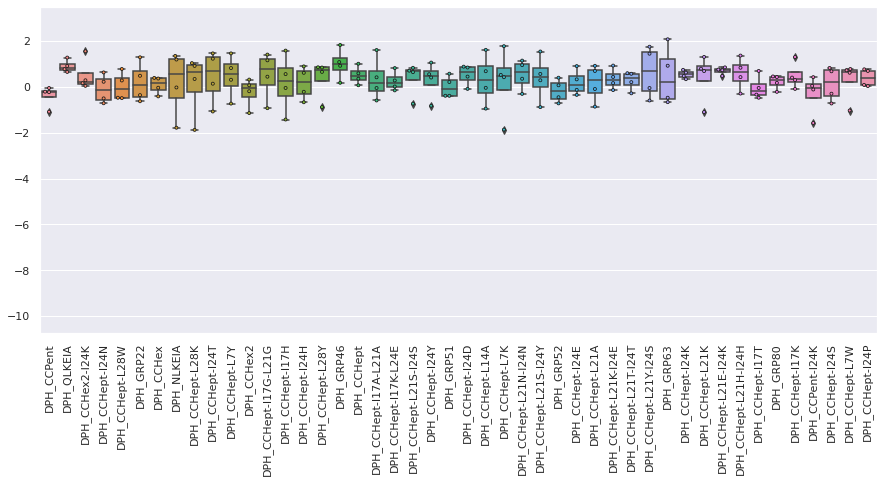

Normal_eleven


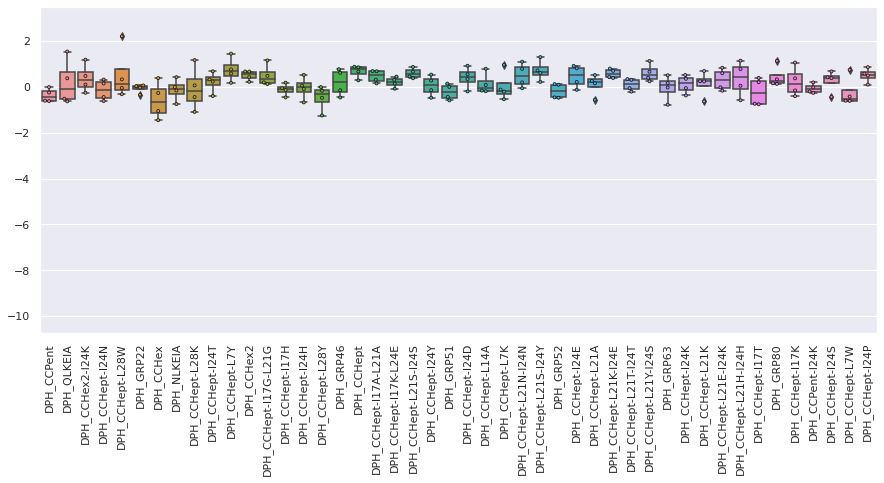

Normal_five


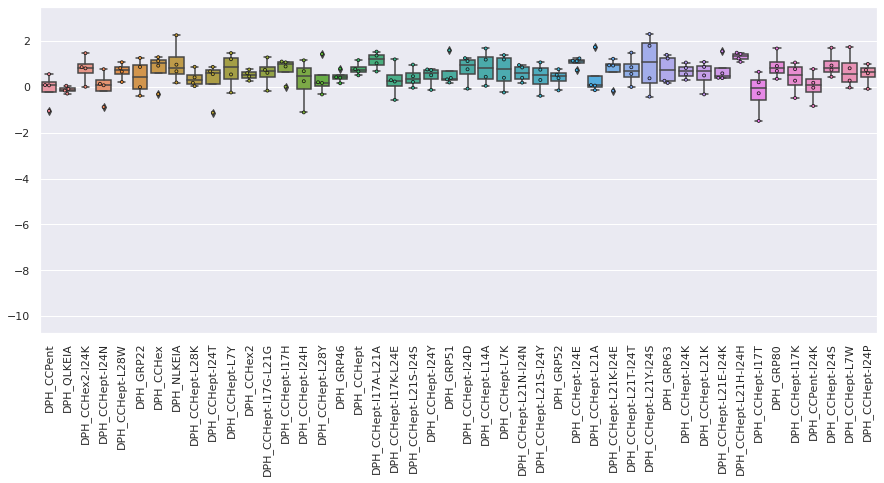

Normal_forty


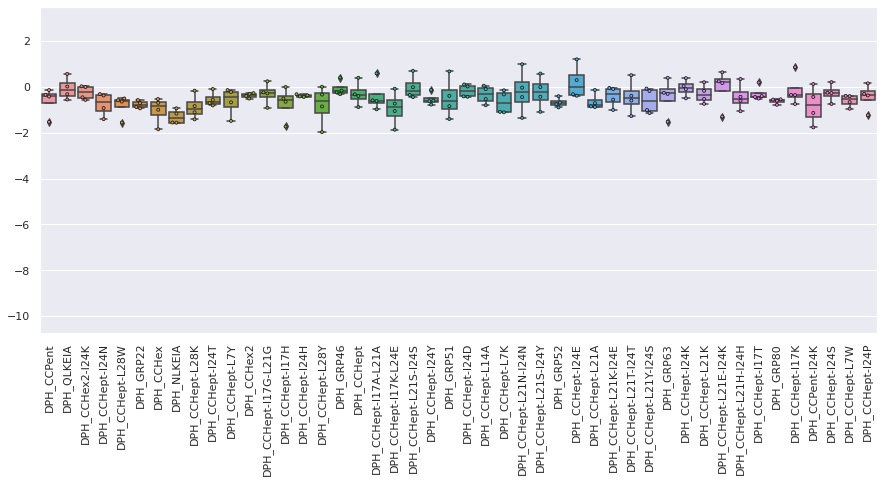

Normal_fortyone


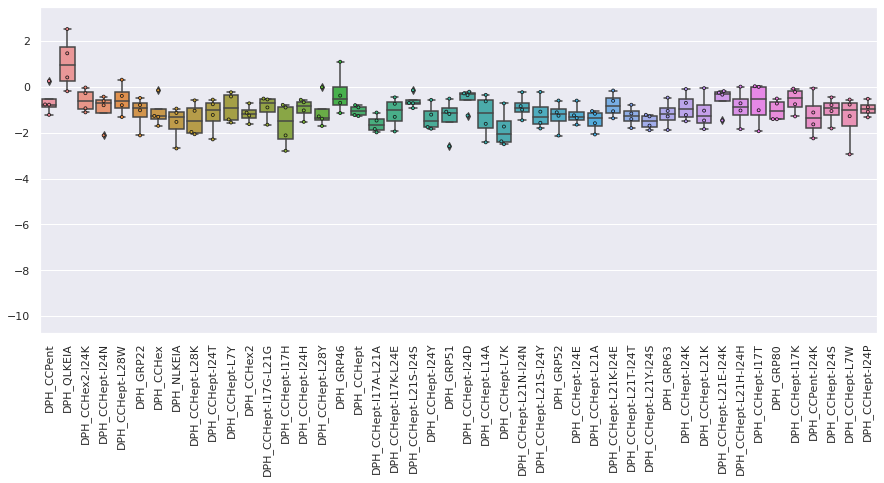

Normal_fortytwo


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


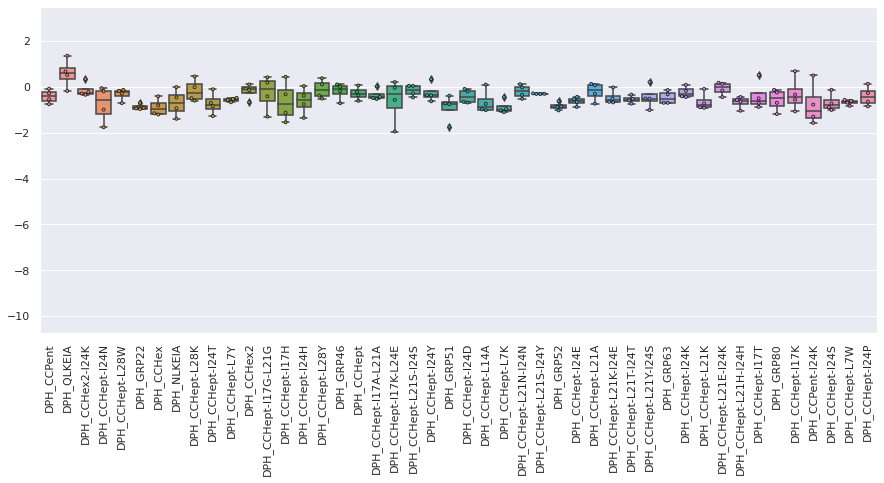

Normal_four


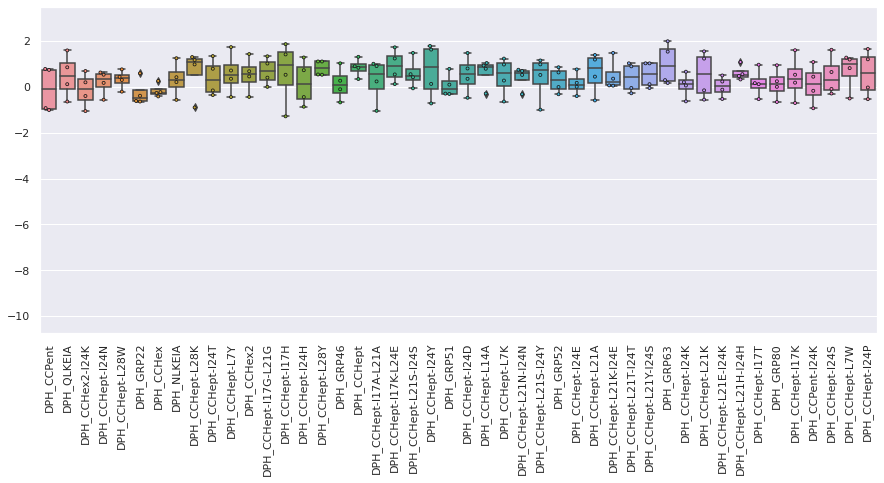

Normal_fourteen


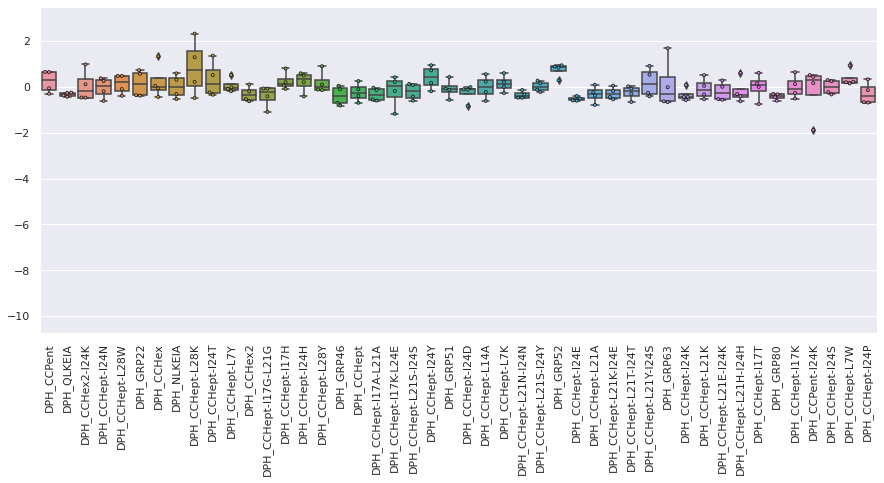

Normal_nine


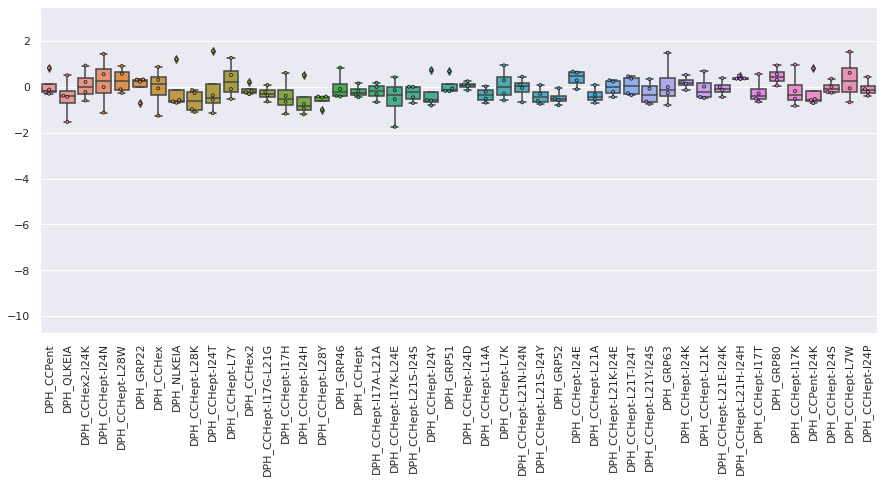

Normal_one


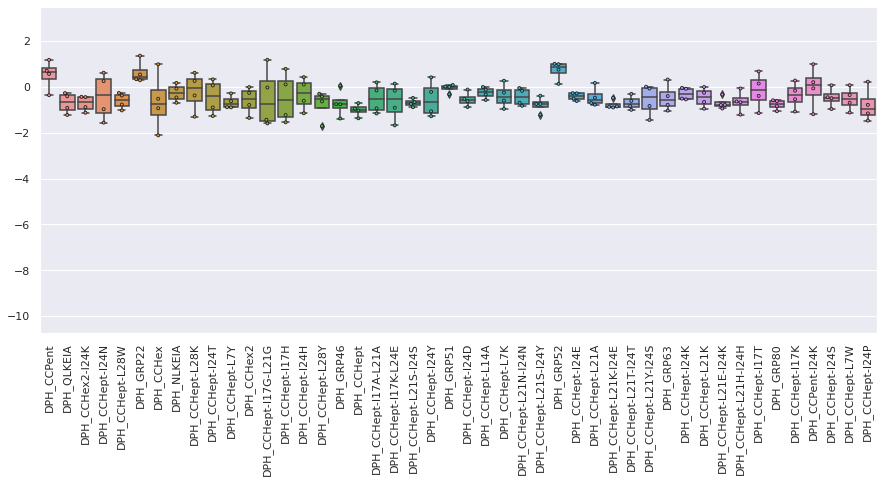

Normal_seven


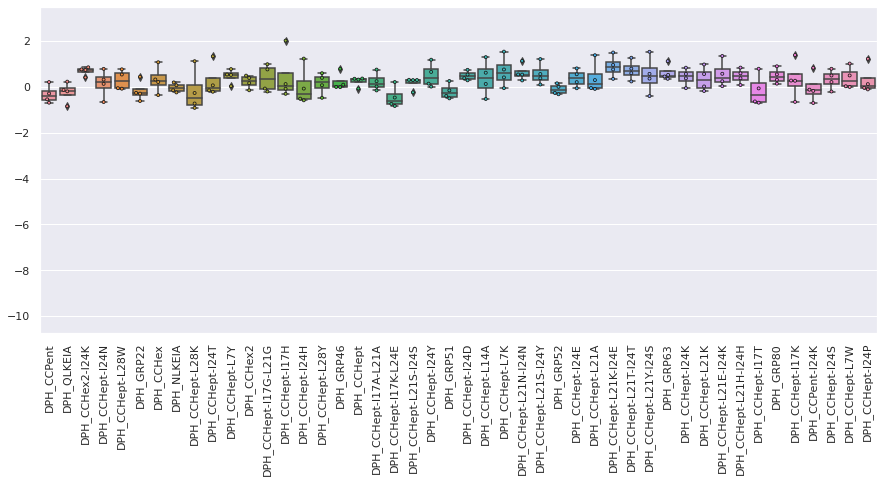

Normal_six


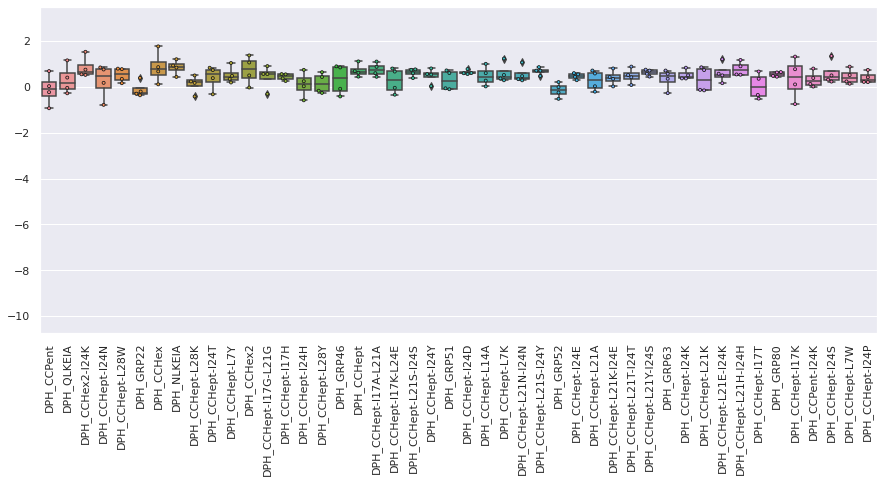

Normal_ten


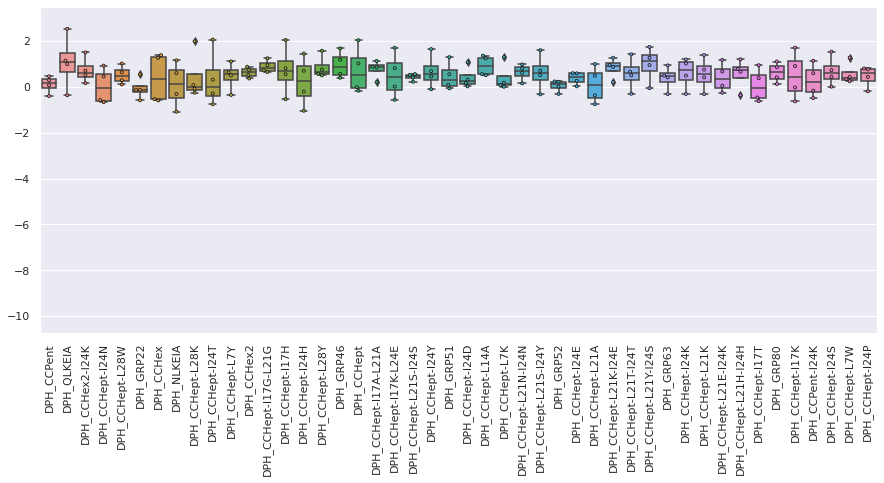

Normal_thirteen


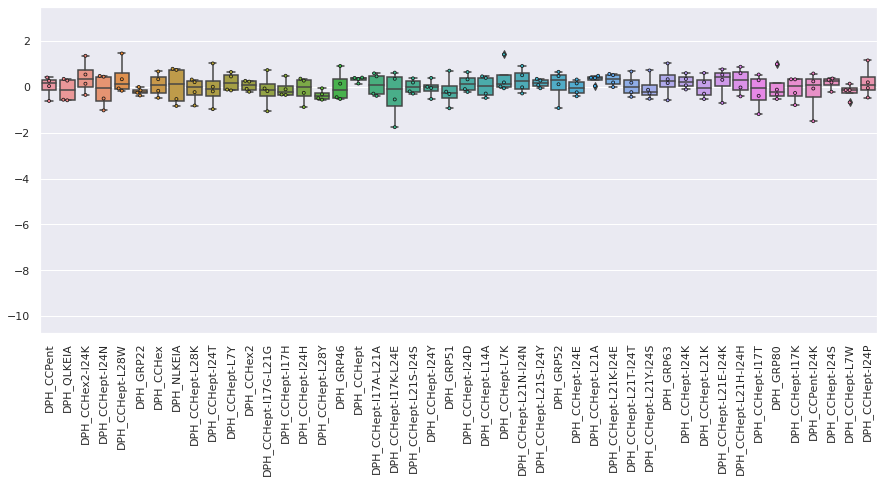

Normal_thirty


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


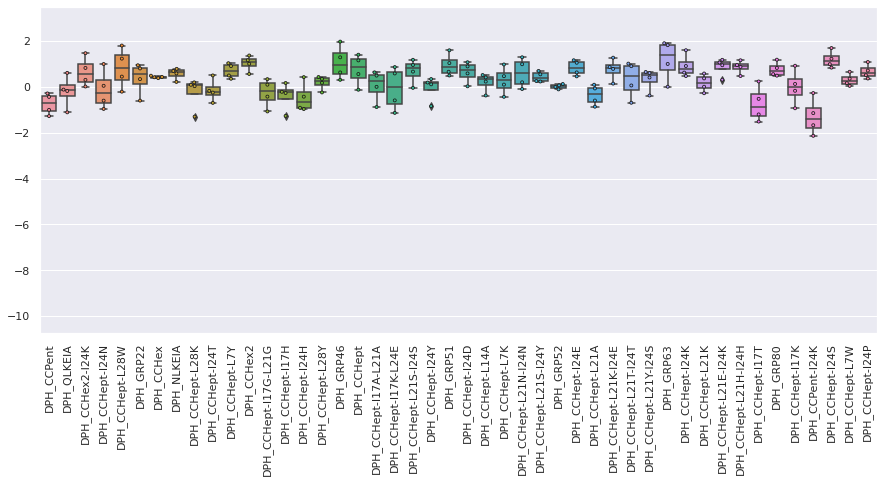

Normal_thirtyeight


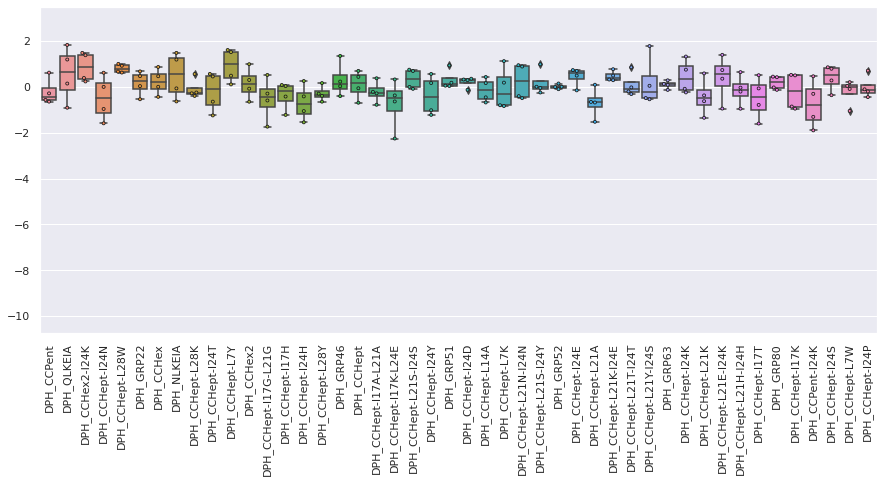

Normal_thirtyfive


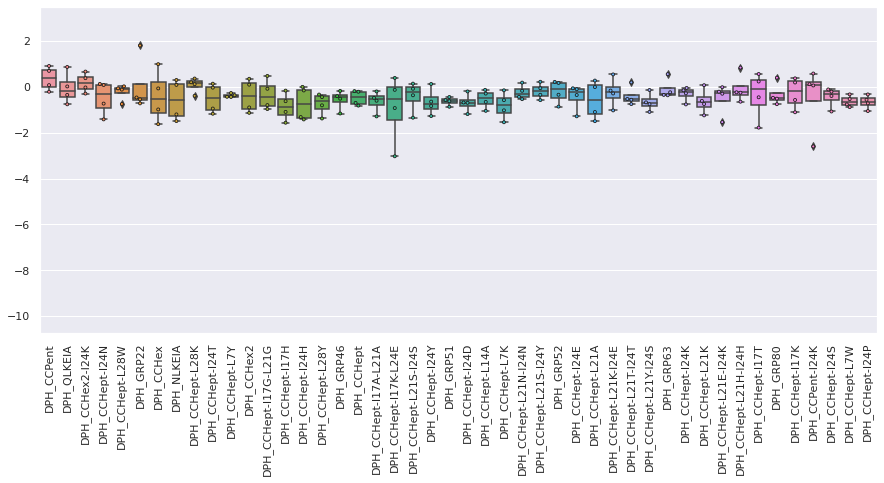

Normal_thirtyfour


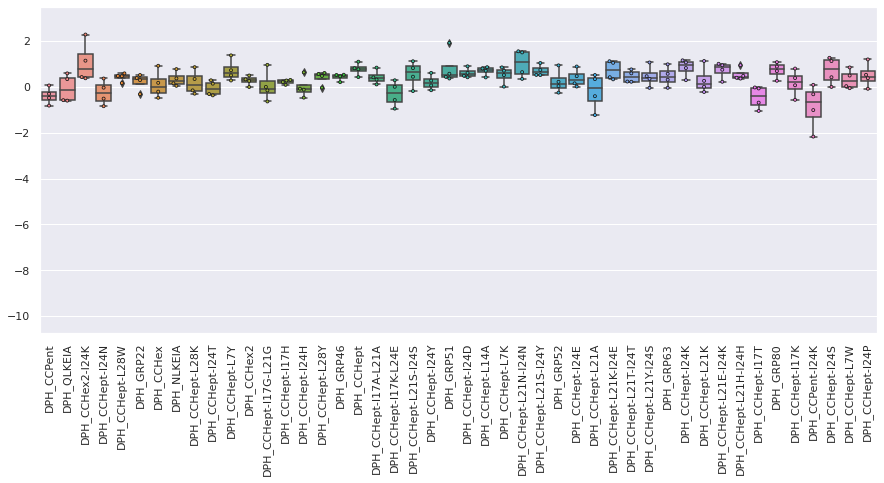

Normal_thirtynine


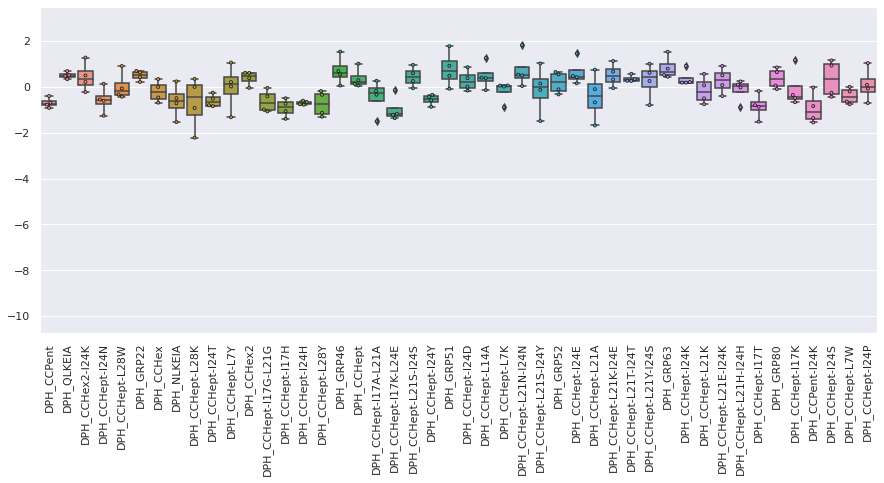

Normal_thirtyone


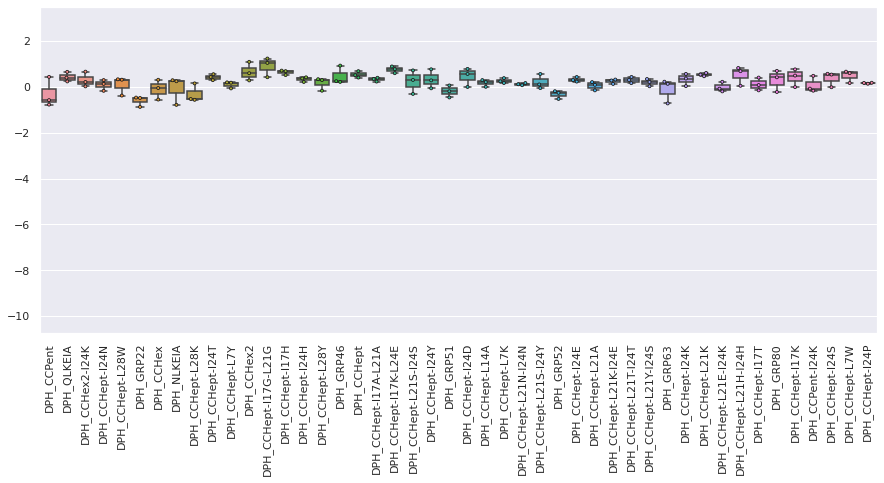

Normal_thirtyseven


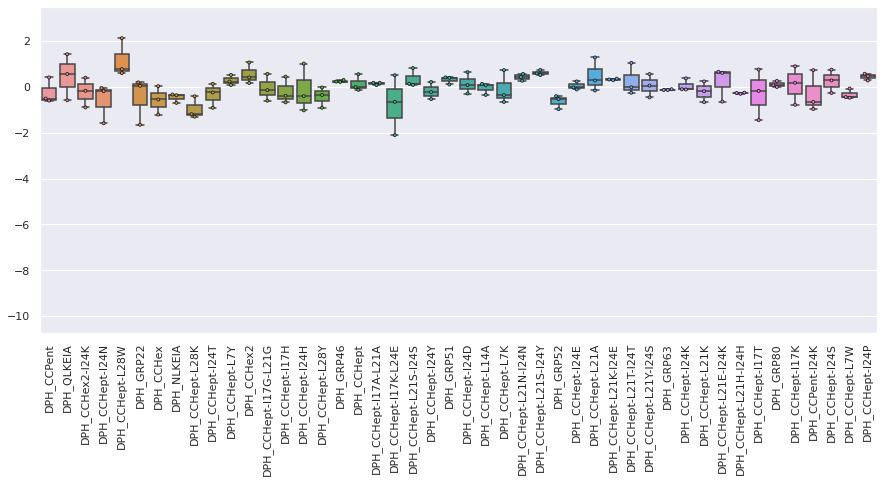

Normal_thirtysix


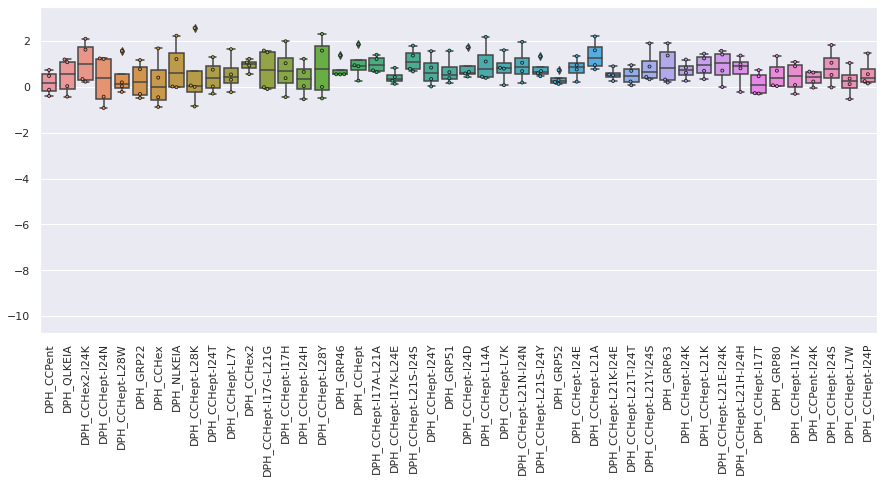

Normal_thirtythree


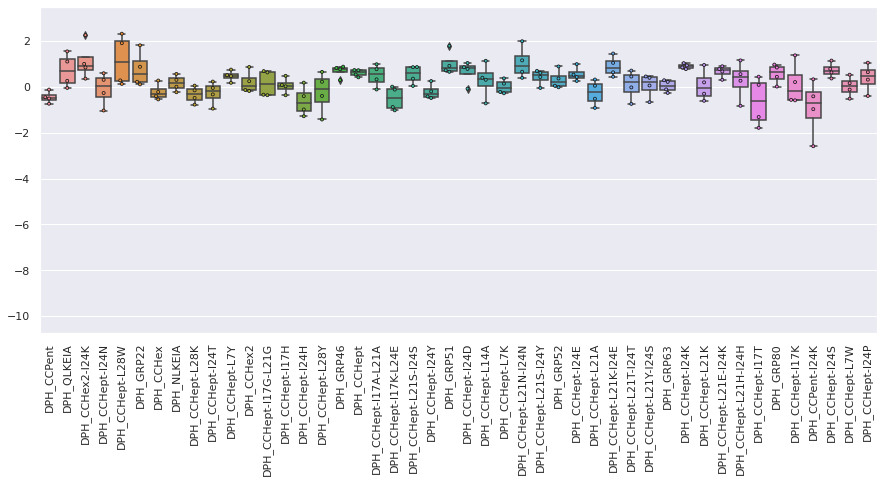

Normal_thirtytwo


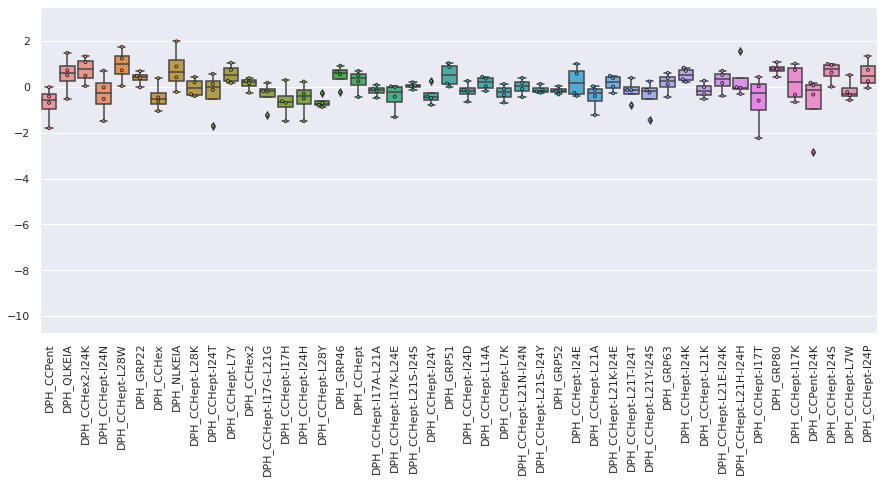

Normal_three


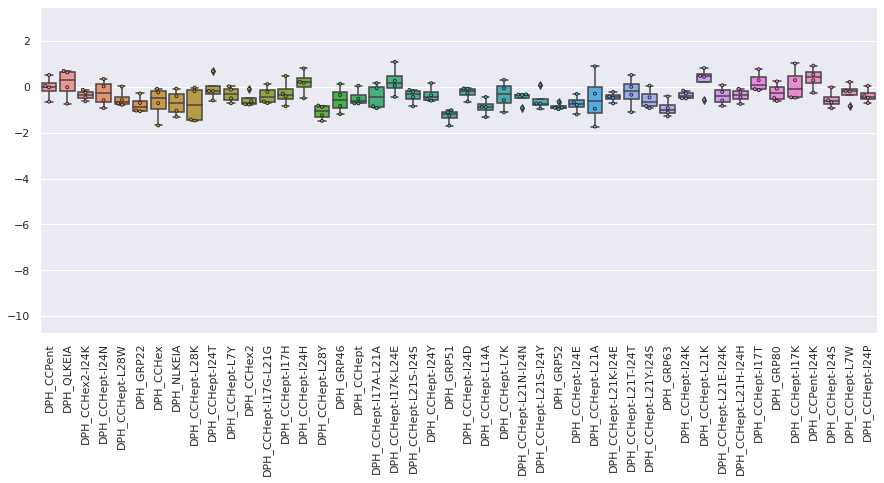

Normal_twelve


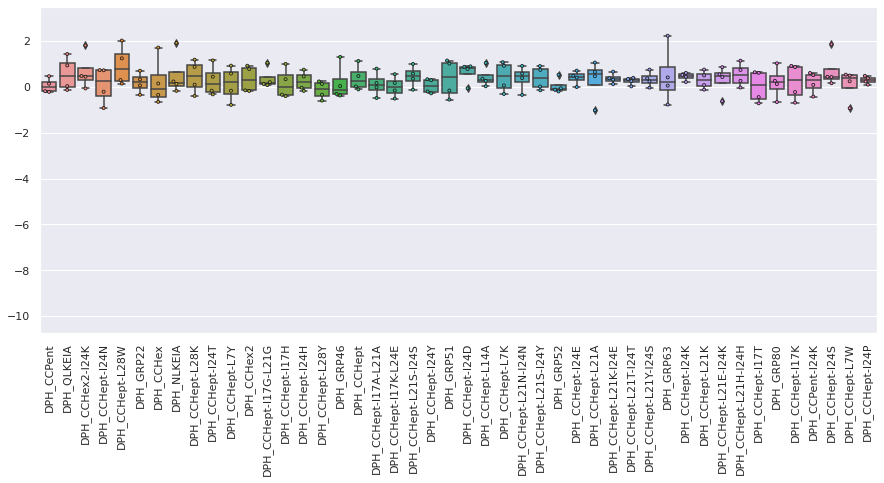

Normal_twentynine


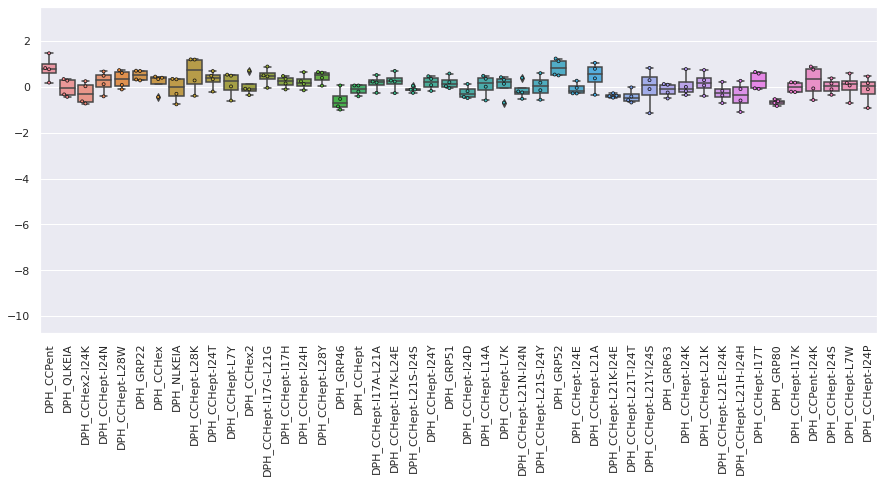

Normal_two


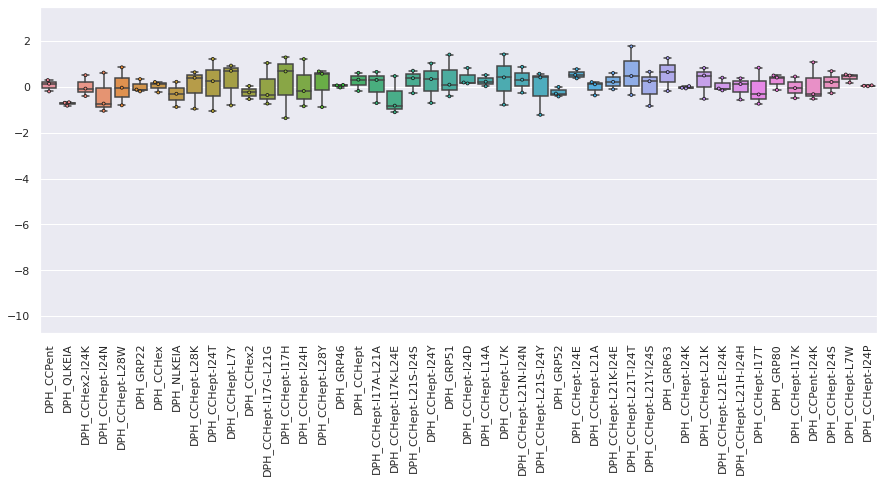

In [8]:
plot_dir = ('/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_patient/'
            'NASH_indv_patients')
if os.path.isdir(plot_dir):
    shutil.rmtree(plot_dir)
os.mkdir(plot_dir)

nash_fluor_data.display_data_distribution(prefix='NASH_indv_patients', results_dir=plot_dir)

- As expected from the scatter plots above, the ranges of (unscaled) readings obtained are particularly large for those peptides that have little effect upon DPH fluorescence. It is very difficult from these plots however to see whether this translates into a noticeably (by eye) greater overlap between the ranges of readings measured for the different classes or not - this should be clearer in the per-class box plots below (as opposed to the per-subclass plots above).
- By eye I can't see any class-wide differences between the heatmap fingerprints of the subclasses. ML will hopefully do a better job of distinguishing differences!

In [9]:
orig_ml_fluor_data = copy.deepcopy(nash_fluor_data.ml_fluor_data)

In [10]:
orig_ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,0.877957,3.095385,0.420399,0.626535,0.833309,0.550566,0.830335,0.460077,0.480613,0.476131,...,0.575472,1.141220,-1.283195,0.698609,1.557728,-2.484808,0.534437,0.706299,0.739634,NASH_eighteen
1,0.847069,3.586758,0.463575,0.526650,0.846187,0.519497,0.699103,0.410027,0.505300,0.285180,...,0.603088,0.822943,-3.193182,0.652183,1.050627,-7.981081,0.554737,0.697937,0.605862,NASH_eighteen
2,0.901390,3.905882,0.462145,0.611198,0.883462,0.575306,0.763889,0.473249,0.533186,0.225612,...,0.932058,0.852884,-3.521320,0.722190,0.971301,-7.073460,0.600972,0.660836,0.666285,NASH_eighteen
3,0.906214,2.440273,0.494804,0.443722,0.831875,0.715844,0.789149,0.541643,0.558587,0.317181,...,0.881435,0.980388,-3.740310,0.721166,1.017946,-5.511050,0.643599,0.725181,0.690570,NASH_eighteen
4,0.979813,5.436782,0.533880,0.651990,0.850773,0.541185,0.787305,0.457448,0.426922,0.410056,...,0.827663,0.874888,-1.102981,0.668763,2.128194,-3.584416,0.592418,0.662459,0.784716,NASH_fifteen
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,0.929617,4.523810,0.458257,0.485395,0.898616,0.561814,0.638160,0.401535,0.441293,0.226648,...,0.824621,0.705797,-3.947368,0.587626,0.933409,-8.415094,0.588466,0.582735,0.579218,Normal_twentynine
160,0.865775,4.381703,0.564634,0.600780,0.988861,0.559064,0.700787,0.466882,0.555201,0.316324,...,0.931061,0.782105,-4.029787,0.569238,0.920232,-6.647260,0.630555,0.682705,0.696830,Normal_twentynine
161,0.877848,2.430464,0.529176,0.710740,1.020066,0.531024,0.686900,0.460314,0.514990,0.411868,...,0.851473,0.929234,-0.915709,0.754863,1.428702,-2.695479,0.573504,0.724223,0.721188,Normal_two
162,0.823427,2.385892,0.493852,0.348596,0.811254,0.562971,0.679888,0.394755,0.400883,0.116464,...,0.829667,0.788279,-4.853242,0.666496,1.049727,-8.207865,0.616494,0.684190,0.718567,Normal_two


In [11]:
nash_fluor_data.ml_fluor_data['Sub_analyte'] = copy.deepcopy(
    nash_fluor_data.ml_fluor_data['Analyte'].tolist()
)
nash_fluor_data.ml_fluor_data['Analyte'] = [
    sub_analyte.split('_')[0] for sub_analyte in nash_fluor_data.ml_fluor_data['Sub_analyte'].tolist()
]

In [12]:
nash_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte,Sub_analyte
0,0.877957,3.095385,0.420399,0.626535,0.833309,0.550566,0.830335,0.460077,0.480613,0.476131,...,1.141220,-1.283195,0.698609,1.557728,-2.484808,0.534437,0.706299,0.739634,NASH,NASH_eighteen
1,0.847069,3.586758,0.463575,0.526650,0.846187,0.519497,0.699103,0.410027,0.505300,0.285180,...,0.822943,-3.193182,0.652183,1.050627,-7.981081,0.554737,0.697937,0.605862,NASH,NASH_eighteen
2,0.901390,3.905882,0.462145,0.611198,0.883462,0.575306,0.763889,0.473249,0.533186,0.225612,...,0.852884,-3.521320,0.722190,0.971301,-7.073460,0.600972,0.660836,0.666285,NASH,NASH_eighteen
3,0.906214,2.440273,0.494804,0.443722,0.831875,0.715844,0.789149,0.541643,0.558587,0.317181,...,0.980388,-3.740310,0.721166,1.017946,-5.511050,0.643599,0.725181,0.690570,NASH,NASH_eighteen
4,0.979813,5.436782,0.533880,0.651990,0.850773,0.541185,0.787305,0.457448,0.426922,0.410056,...,0.874888,-1.102981,0.668763,2.128194,-3.584416,0.592418,0.662459,0.784716,NASH,NASH_fifteen
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159,0.929617,4.523810,0.458257,0.485395,0.898616,0.561814,0.638160,0.401535,0.441293,0.226648,...,0.705797,-3.947368,0.587626,0.933409,-8.415094,0.588466,0.582735,0.579218,Normal,Normal_twentynine
160,0.865775,4.381703,0.564634,0.600780,0.988861,0.559064,0.700787,0.466882,0.555201,0.316324,...,0.782105,-4.029787,0.569238,0.920232,-6.647260,0.630555,0.682705,0.696830,Normal,Normal_twentynine
161,0.877848,2.430464,0.529176,0.710740,1.020066,0.531024,0.686900,0.460314,0.514990,0.411868,...,0.929234,-0.915709,0.754863,1.428702,-2.695479,0.573504,0.724223,0.721188,Normal,Normal_two
162,0.823427,2.385892,0.493852,0.348596,0.811254,0.562971,0.679888,0.394755,0.400883,0.116464,...,0.788279,-4.853242,0.666496,1.049727,-8.207865,0.616494,0.684190,0.718567,Normal,Normal_two





Original_data:


NASH


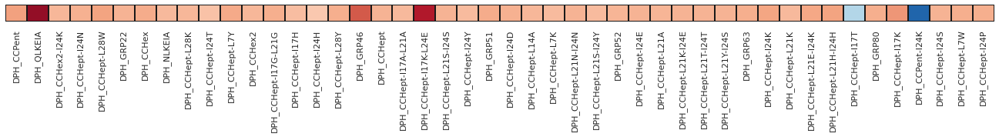


Normal


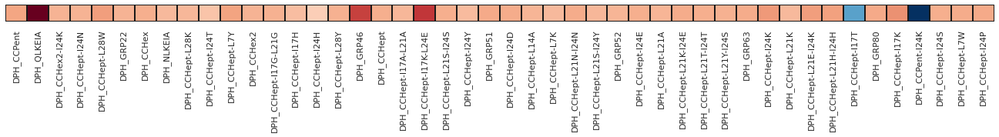




Scaled_data:


NASH


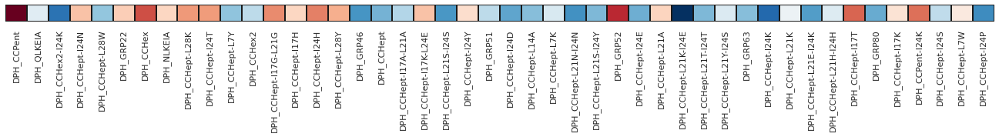


Normal


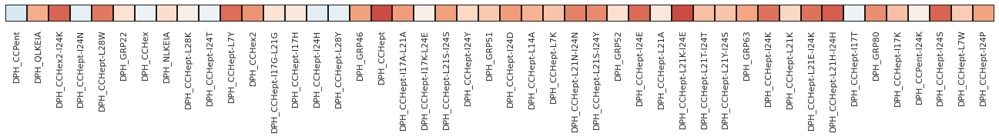




Original_data:



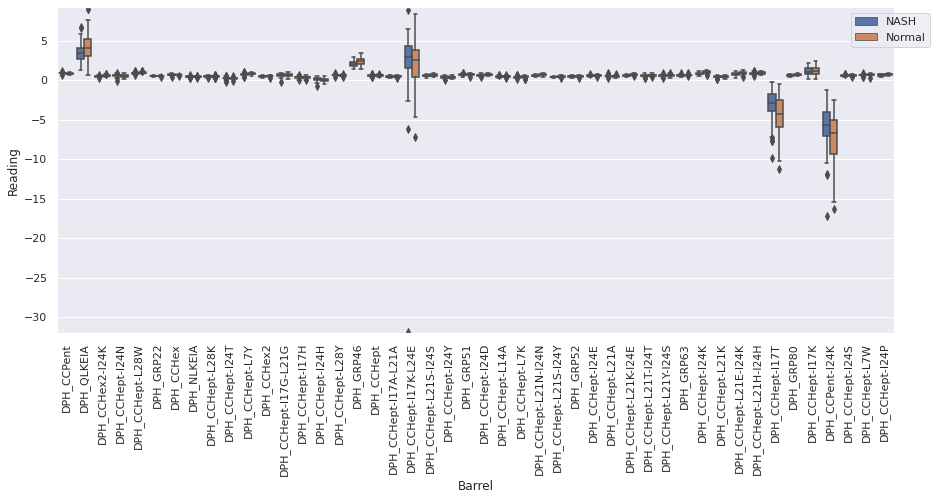

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 94.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 45.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 85.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 89.1% of the points cannot be placed; you may want 

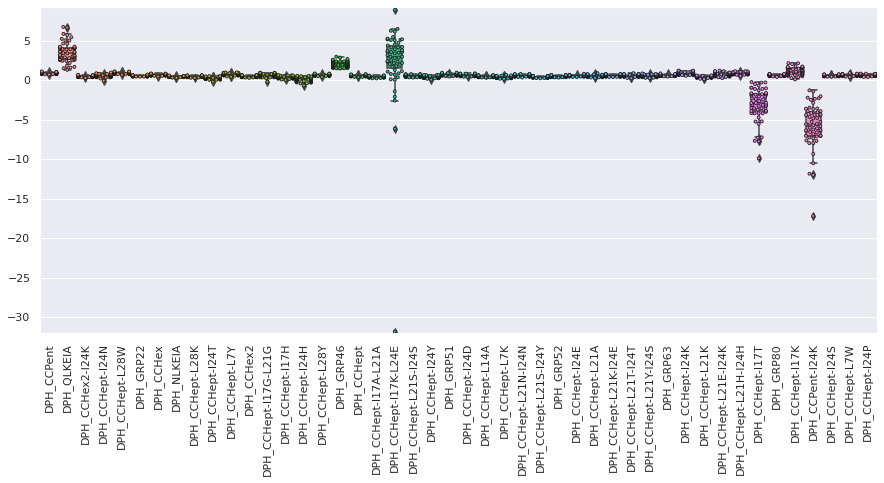

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 97.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 59.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 93.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 95.4% of the points cannot be placed; you may want 

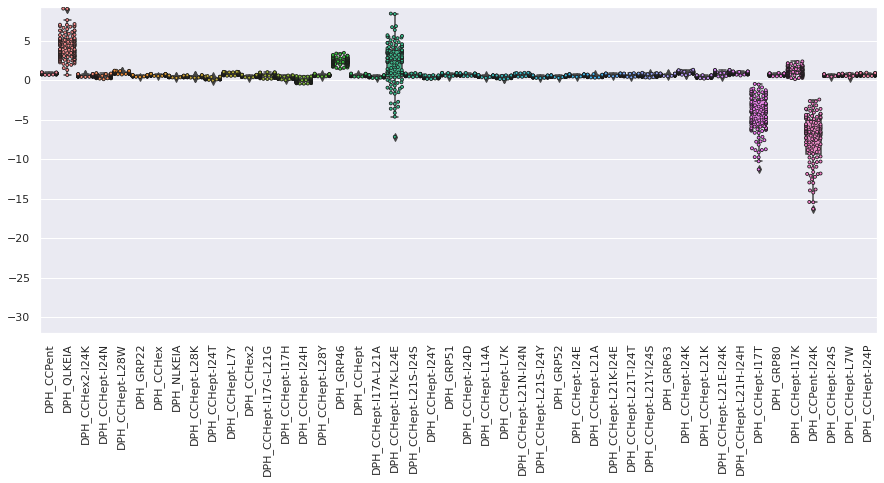




Scaled_data:



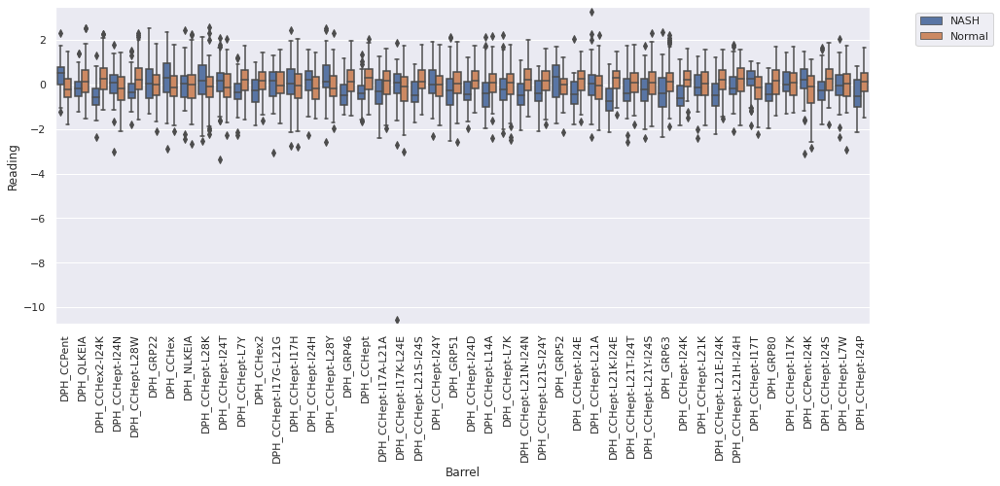

NASH


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 27.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 38.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 32.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 16.4% of the points cannot be placed; you may want 

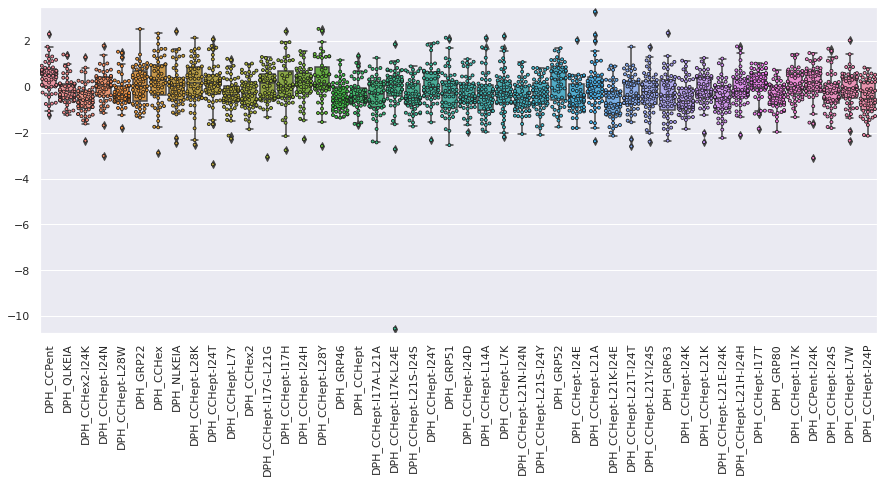

Normal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 56.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 47.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 49.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 48.6% of the points cannot be placed; you may want 

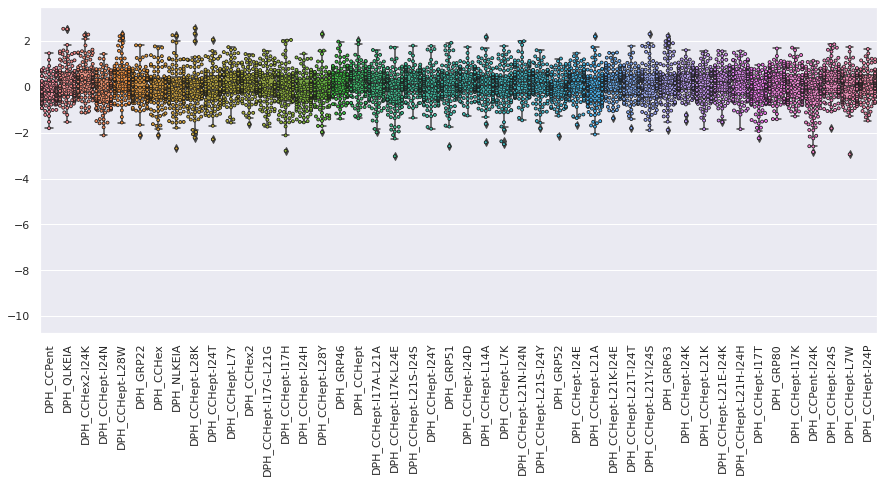

In [13]:
plot_dir = ('/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_patient/'
            'NASH_patient_classes')
if os.path.isdir(plot_dir):
    shutil.rmtree(plot_dir)
os.mkdir(plot_dir)

nash_fluor_data.display_data_distribution(
    ml_fluor_data=nash_fluor_data.ml_fluor_data.drop(['Sub_analyte'], axis=1), results_dir=plot_dir,
    prefix='NASH_patient_classes'
)

By eye, when looking at the scaled data box plots, there is not a noticeable difference between the degree of class overlap of the peptides that affect DPH fluorescence very little and hence give very high/low raw readings, as compared to the other peptides. Consequently, I will not be discarding any of the peptides prior to ML analysis. 

#### ML analysis

 *2 classes (Normal and NASH)*

In [14]:
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size
ml_2_classes = RunML(
    results_dir='/home/ks17361/ML_environment/BADASS/NASH_serum_analysis/NASH_2_classes_split_patient/'
                'NASH_ML_plots',
    fluor_data=nash_fluor_data.ml_fluor_data.drop(['Analyte', 'Sub_analyte'], axis=1),
    classes=nash_fluor_data.ml_fluor_data['Analyte'].tolist(),
    subclasses=nash_fluor_data.ml_fluor_data['Sub_analyte'].tolist(), shuffle=False
)

- Calculate feature correlations

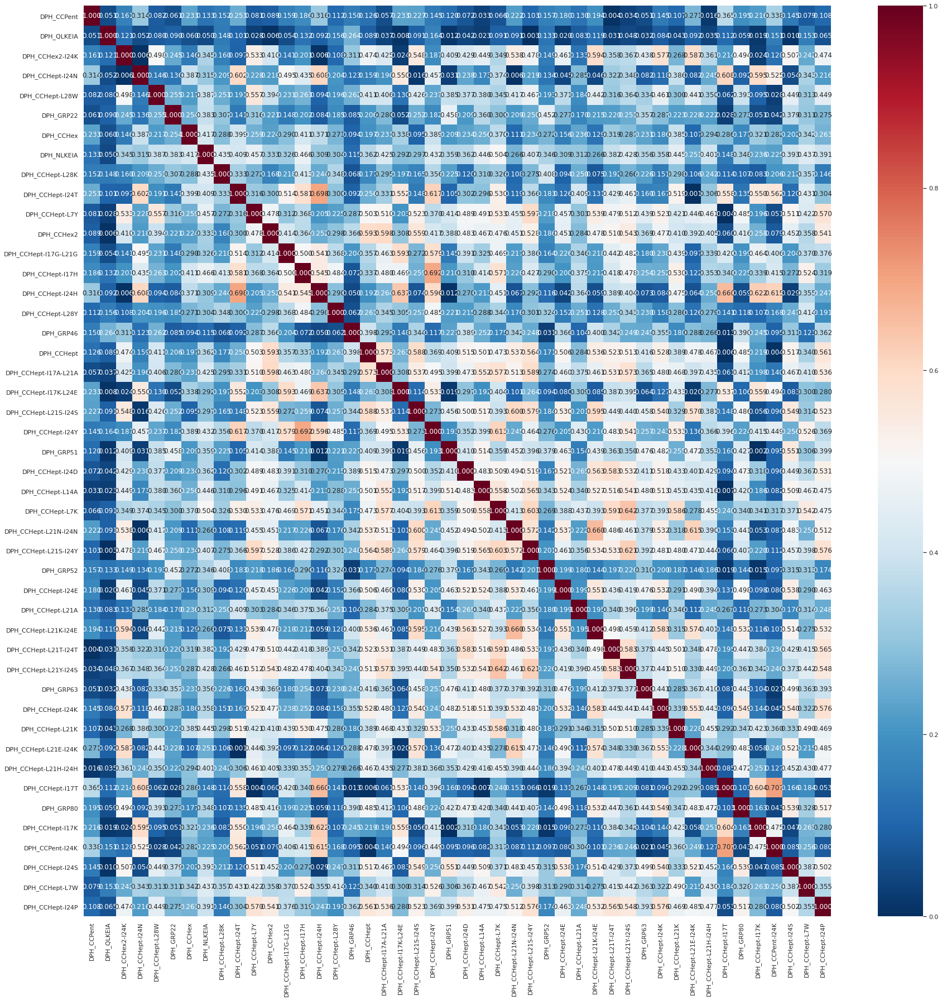

In [15]:
plt.rcParams['figure.figsize'] = (30, 30)
kendall_tau_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='kendall', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

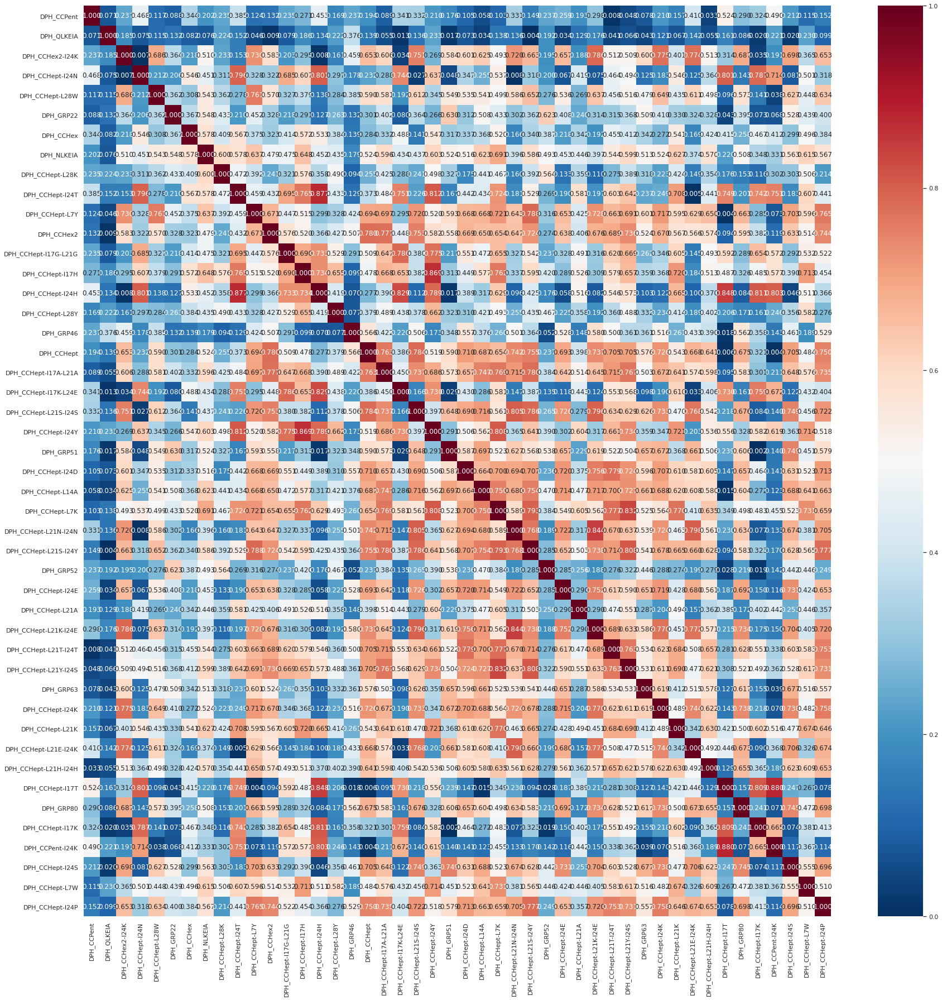

In [16]:
plt.rcParams['figure.figsize'] = (30, 30)
spearman_correlation_matrix = ml_2_classes.calc_feature_correlations(
    fluor_data=ml_2_classes.fluor_data, correlation_coeff='spearman', plt_name='', abs_vals=True
)
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

So, there is quite a wide range of correlation coefficients across the readings of the different barrels. That some of the barrel pairs show high correlation coefficients is encouraging, as it indicates that at least some of the barrels are likely picking up signal in the data as opposed to just noise. However, the barrels with low correlation coefficients are not necessarily picking up noise - they may instead be picking up different information from one another (and hence combining the readings from such barrels in the subsequent ML analysis would likely be beneficial for model performance). The following analysis will help to identify which barrels fall into which of these categories!

- Measure the relative importances of the peptides with KBest using one-way ANOVA

<Figure size 720x720 with 0 Axes>

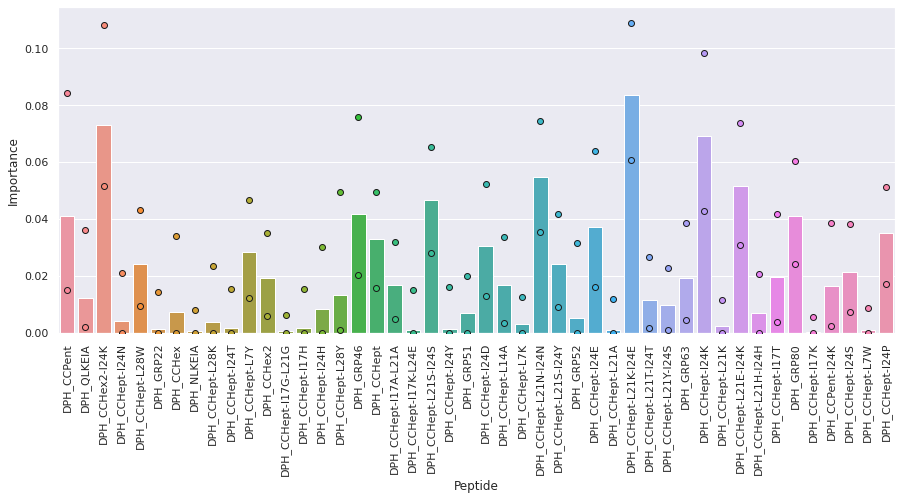

<Figure size 720x720 with 0 Axes>

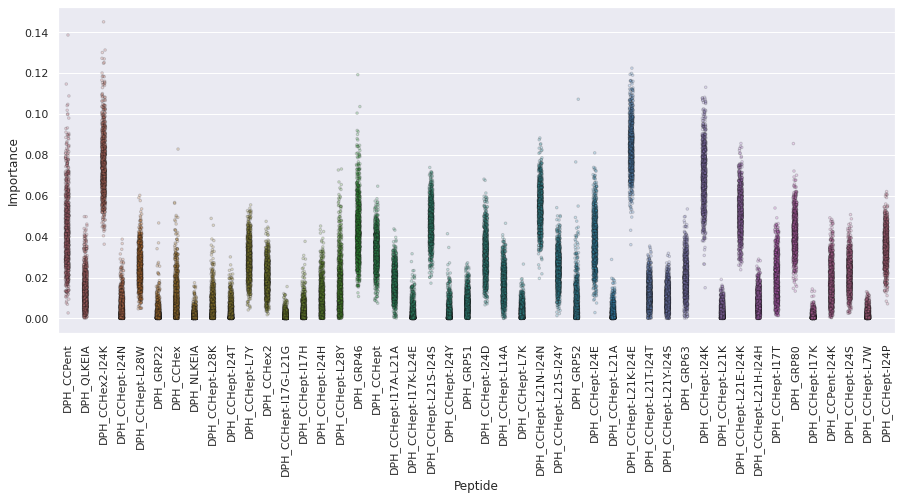

In [17]:
kbest_feat_importances_df, kbest_feat_importances_dict = ml_2_classes.calc_feature_importances_kbest(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, method_classif='f_classif', num_repeats=1000,
    scale=True, plt_name=''
)

In [18]:
print('Peptides ordered by F-score:')
kbest_feat_importances_df

Peptides ordered by F-score:


,Feature,Score
0,DPH_CCHept-L21K-I24E,0.083501
1,DPH_CCHex2-I24K,0.073135
2,DPH_CCHept-I24K,0.069103
3,DPH_CCHept-L21N-I24N,0.054790
4,DPH_CCHept-L21E-I24K,0.051678
5,DPH_CCHept-L21S-I24S,0.046691
6,DPH_GRP46,0.041951
7,DPH_CCPent,0.041182
8,DPH_GRP80,0.041177
9,DPH_CCHept-I24E,0.037385


KBest analysis is a univariate feature selection method, and hence assumes that the features are independent of one another (the importance scores calculated here are the F-scores from running one-way ANOVA). Consequently, the output importance scores do not reflect correlations between features - the scores represent the information provided by a feature about the output class, rather than the unique information provided by that feature alone. Therefore the most important features highlighted by this method could be providing the same information as one another.

Unsurprisingly, there is an approximate (negative) correlation between the degree of overlap of the readings for the two classes in the box plots above and the importance scores in this analysis (the peptides with the largest importance scores via KBest analysis being CCHex2-I24K, CCHept-L21K-I24E and CCHept-I24K), and vice versa.

- Measure the relative importances of the peptides with decision tree analysis

<Figure size 720x720 with 0 Axes>

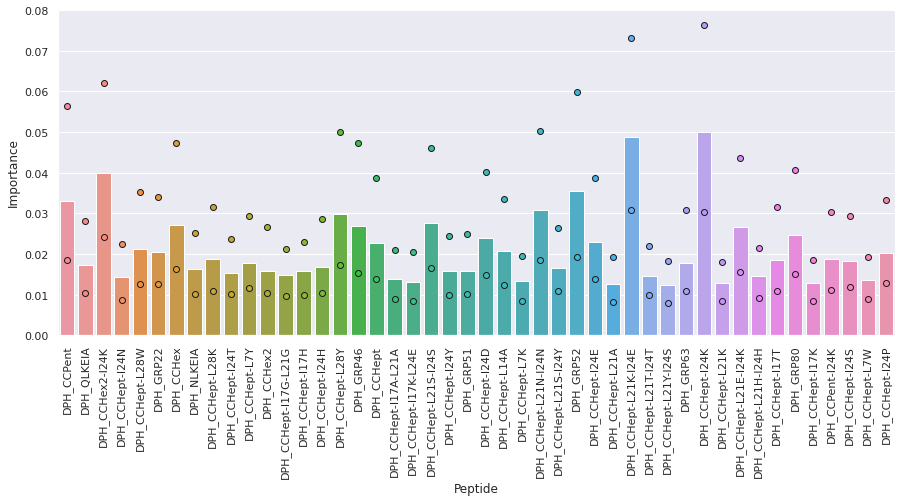

<Figure size 720x720 with 0 Axes>

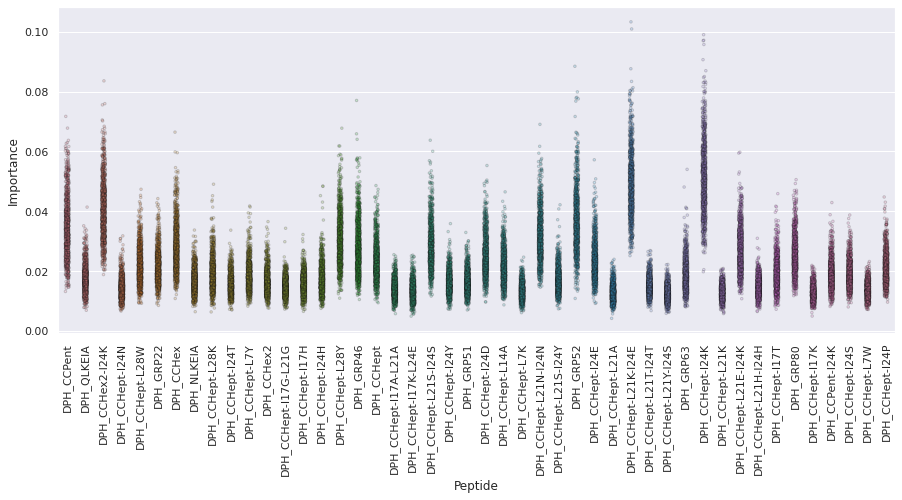

In [19]:
tree_feat_importances_df, tree_feat_importances_dict = ml_2_classes.calc_feature_importances_tree(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, num_repeats=1000, scale=True, plt_name=''
)

In [20]:
print('Peptides ordered by importance:')
tree_feat_importances_df

Peptides ordered by importance:


,Feature,Score
0,DPH_CCHept-I24K,0.049999
1,DPH_CCHept-L21K-I24E,0.048786
2,DPH_CCHex2-I24K,0.040042
3,DPH_GRP52,0.035560
4,DPH_CCPent,0.033102
5,DPH_CCHept-L21N-I24N,0.030868
6,DPH_CCHept-L28Y,0.029833
7,DPH_CCHept-L21S-I24S,0.027572
8,DPH_CCHex,0.027128
9,DPH_GRP46,0.026857


In this method, an ExtraTrees classifier is used to calculate importance scores. The ExtraTrees classifier trains multiple decision trees on the data. Each tree is trained with a random subset of features on a random subset of dataset, the results of these trees are then averaged to make a prediction. Importance scores are calculated as the 
average increase in purity achieved when using a particular feature to split the data across all trees in which that feature is included (i.e. the Gini importance score of the feature). When looking at the Gini importance scores of features in individual trees, correlations between the included features are reflected in the scores. However, as more and more trees, incorporating different subsets of features, are included in the average, feature correlations have less of an effect upon the importance scores. The  number of trees (plus bootstrap repeats) included here means that the correlation between features will have little effect upon the importance scores.

Whilst there are some small differences, the relative order of the peptides identified by this method is very similar to that measured by KBest analysis. The most important peptides identified by this method are essentially the same as those identified by the KBest analysis above (with some small differences in their relative order). The less important peptides are also broadly similar, but unsurprisingly there are more differences in their relative ordering (as the absolute differences between their importance scores are smaller => can lead to more extensive reordering). Consequently, again there is a visible (negative) correlation between the degree of overlap between a peptide's class readings that can be seen in the box plots above and that peptide's importance score.

- Measure the relative importances of the peptides with permutation analysis

<Figure size 720x720 with 0 Axes>

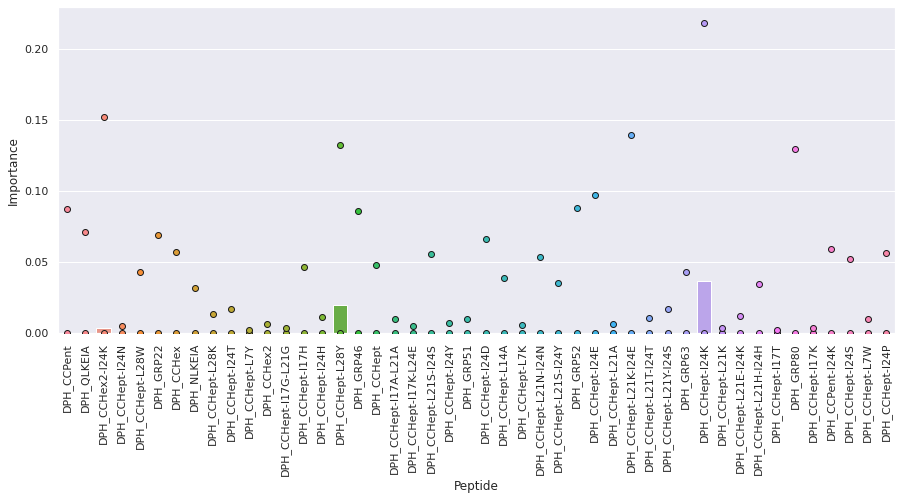

<Figure size 720x720 with 0 Axes>

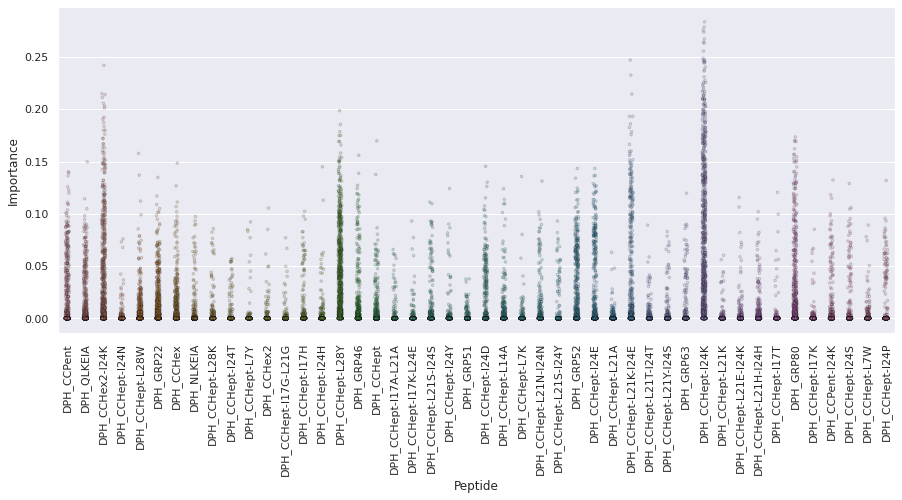

In [21]:
f1 = make_scorer(f1_score, average='weighted')
(
    median_permut_feat_importances_df, permut_feat_importances_dict
) = ml_2_classes.calc_feature_importances_permutation(
    x=ml_2_classes.x, y=ml_2_classes.y, features=None, classifier=AdaBoostClassifier,
    parameters={'n_estimators': np.array([10, 30, 100, 300, 1000])}, model_metric=f1, num_repeats=1000,
    scale=True, plt_name=''
)

In [22]:
print('Peptides ordered by median importance:')
median_permut_feat_importances_df

Peptides ordered by median importance:


,Feature,Score
0,DPH_CCHept-I24K,0.036872
1,DPH_CCHept-L28Y,0.019596
2,DPH_CCHex2-I24K,0.003663
3,DPH_GRP63,0.000000
4,DPH_CCHept-L21N-I24N,0.000000
5,DPH_CCHept-L21S-I24Y,0.000000
6,DPH_GRP52,0.000000
7,DPH_CCHept-I24E,0.000000
8,DPH_CCHept-L21A,0.000000
9,DPH_CCHept-L21K-I24E,0.000000


In [23]:
mean_permut_feat_importances_df = OrderedDict({})
for feat, score_list in permut_feat_importances_dict.items():
    mean_permut_feat_importances_df[feat] = np.mean(score_list)
mean_permut_feat_importances_df = pd.DataFrame({'Feature': list(mean_permut_feat_importances_df.keys()),
                                                'Score': list(mean_permut_feat_importances_df.values())})
mean_permut_feat_importances_df = mean_permut_feat_importances_df.sort_values(
    by=['Score'], axis=0, ascending=False
).reset_index(drop=True)

In [24]:
print('Peptides ordered by mean importance:')
mean_permut_feat_importances_df

Peptides ordered by mean importance:


,Feature,Score
0,DPH_CCHept-I24K,0.063031
1,DPH_CCHept-L28Y,0.034988
2,DPH_CCHex2-I24K,0.027364
3,DPH_CCHept-L21K-I24E,0.018132
4,DPH_GRP80,0.016754
5,DPH_GRP52,0.012548
6,DPH_CCHept-I24E,0.011710
7,DPH_CCPent,0.010878
8,DPH_GRP22,0.009322
9,DPH_QLKEIA,0.008078


In permutation analysis, importance scores are calculated by training two ML models (in this case I have selected AdaBoost classifiers). The first model is trained using all features, the second is trained with one of the features randomly scrambled: the importance score of the feature is then calculated as the difference in performance (in this case measured via model F1 score) between the two models. Hence this method does take into account correlations between features, and the output importance scores represent the unique information that a feature provides about the output class label.

The results obtained with permutation look more different as compared to the difference between the KBest and ExtraTrees analysis, which is perhaps not surprising given that as described above permutation analysis takes feature correlation into account (whereas the former two methods do not).

Interestingly, none of the peptides has an especially high importance score (the median value for all bar three peptides is 0), thus indicating that in general each individual peptide provides little/no unique information about the output class that is not captured by one or more of the other barrels. Looking at the mean importance scores, there is broad agreement of the barrels ranked as most important as compared to the KBest and ExtraTrees analysis above, with CCHex2-I24K, CCHept-L21K-I24E and CCHept-I24K again being identified as three of the most important barrels. Permutation analysis also finds CCHept-L28Y to be one of the most important barrels, however in contrast it has a lower importance rank via the other two methods (especially KBest analysis). As before, there is unsurprisingly greater disagreement between the relative order of the peptides measured as being less important.

- What percentage of the signal in the data can be measured by N principal components?

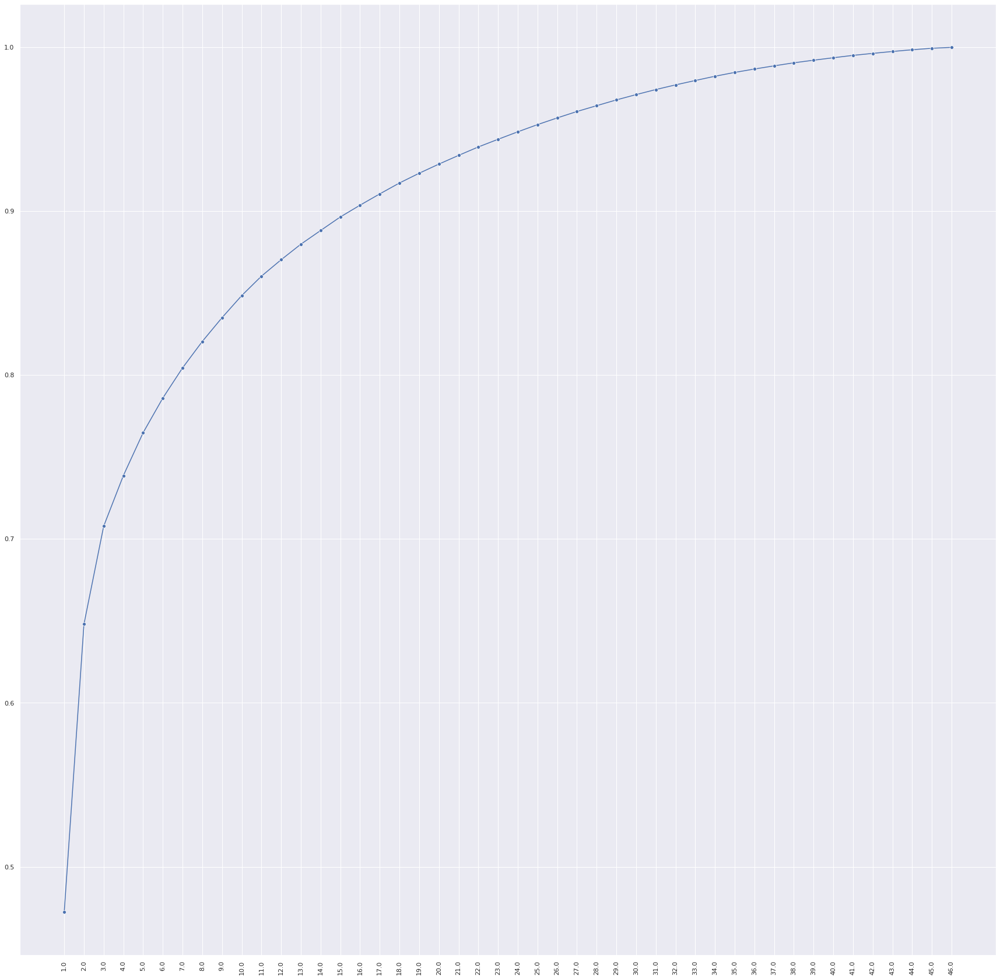

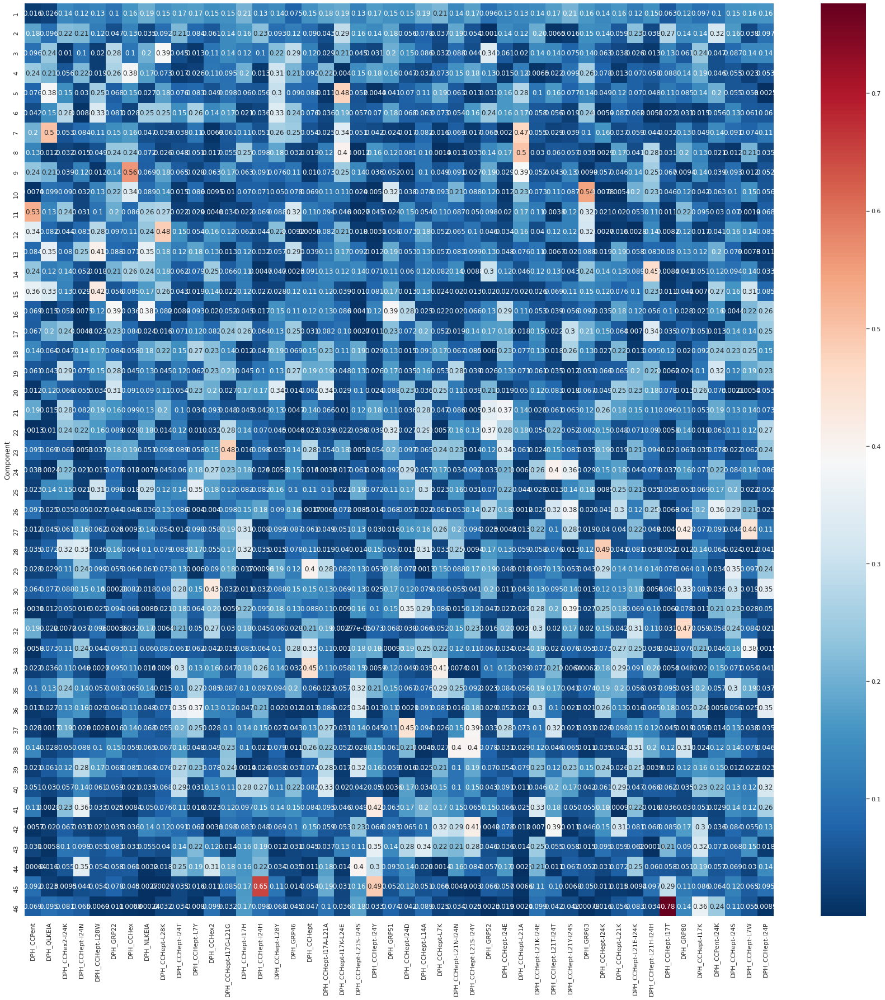

In [25]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size
pca_model, pca_components = ml_2_classes.run_pca(fluor_data=ml_2_classes.fluor_data, scale=True, plt_name='')
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

16 components are required to represent ~90% of the variance in the data. Many of the peptides make ~ similar contributions to the first component, whereas the subsequent components tend to be dominated by the signal from one/a few peptides.

Scatter plots of data transformed to PCA dimensions

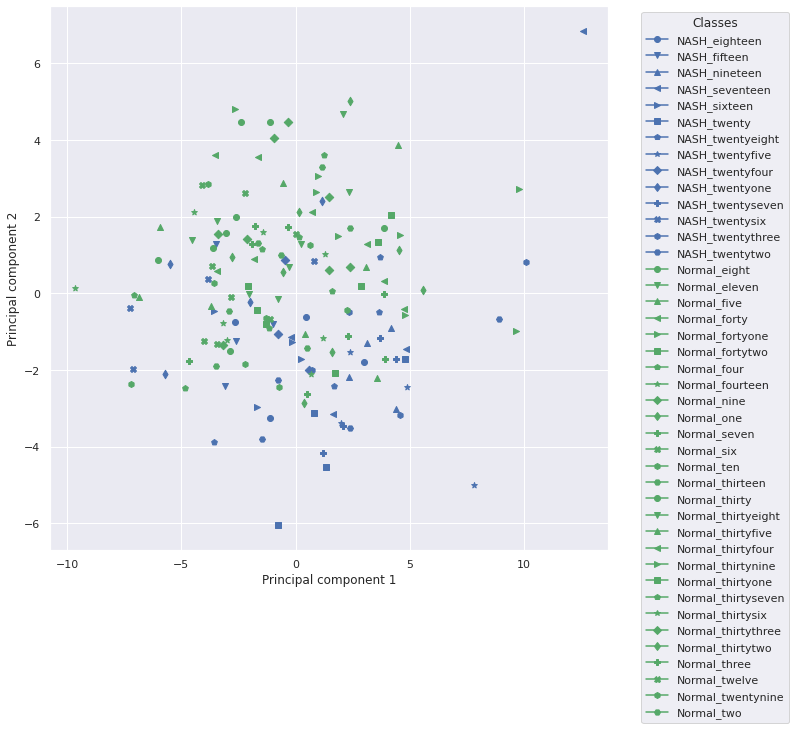

In [26]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=ml_2_classes.x, y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=2,
    scale=True, plt_name=''
)

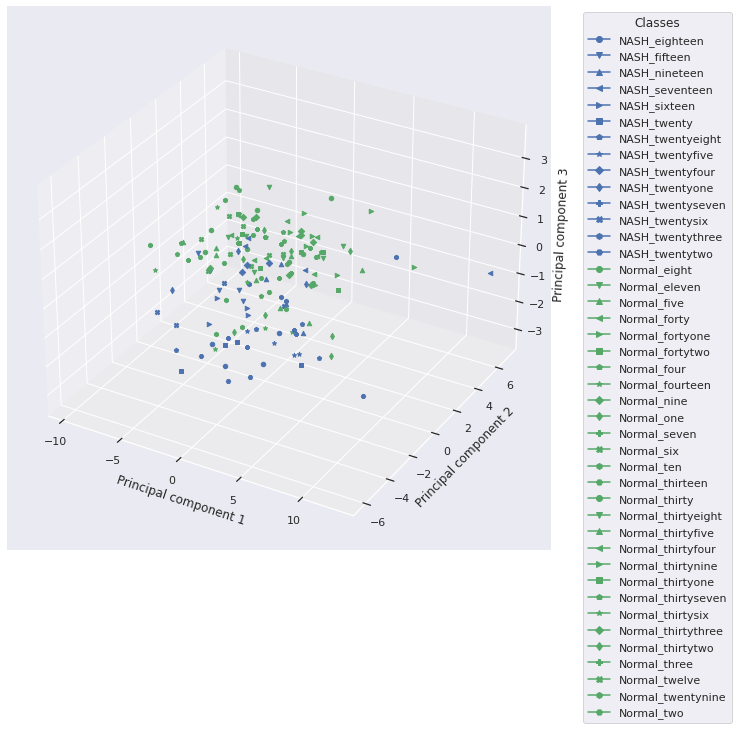

In [27]:
ml_2_classes.plot_scatter_on_pca_axes(
    x=ml_2_classes.x, y=ml_2_classes.y, subclasses=ml_2_classes.sub_classes, num_dimensions=3,
    scale=True, plt_name=''
)

Whilst the two classes do not form distinct clusters on these scatter plots on PCA axes, there is clearly some separation between them. This suggests that it should be possible to train an ML model to distinguish between these classes with an accuracy score etc. outperforming random guessing.

#### How well does a model trained with all features perform?

Runs grid search with nested cross-validation to spot check 5 different ML algorithms. Inner loop identifies the optimal parameter values to use with the ML algorithm; outer loop measures the performance of a model trained using these parameter values.

In [40]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote'] # Classes are imbalanced

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 7
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

all_feat_searches = OrderedDict({})
all_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})

for algorithm in algorithms:
    for resampling_method in resampling_methods:
        fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
        if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
            fixed_params['random_state'] = 1
        tuned_params = ml_2_classes.define_tuned_model_params(
            classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
        )
        nested_cv_search = ml_2_classes.run_nested_CV(
            clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=ml_2_classes.sub_classes,
            selected_features=list(ml_2_classes.features), inner_splits=None, outer_splits=None,
            const_split=True, resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
            fixed_params=fixed_params, tuned_params=tuned_params, train_scoring_metric=train_scoring_metric,
            test_scoring_funcs=test_scoring_funcs, n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
            cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
        )

        all_feat_searches[
            '{}__{}'.format(algorithm.__name__, resampling_method)
        ] = copy.deepcopy(nested_cv_search)

        all_feat_score_dict['Algorithm'].append(algorithm.__name__)
        all_feat_score_dict['Resampling_method'].append(resampling_method)
        all_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
        all_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
        all_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
        all_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
        all_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
        all_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
        all_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
        all_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

        # Print output of nested CV
        for i, params in enumerate(nested_cv_search['outer_loop_params']):
            print('\n\n\n')
            print('{}: {}'.format(algorithm.__name__, resampling_method))
            print('Parameters: {}'.format(params))
            print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][i]))
            print('F1: {}'.format(nested_cv_search['test_scores']['f1'][i]))





KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 12), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.9166666666666666
F1: 0.9185185185185185




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7571428571428571




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 27), ('p', 1), ('weights', 'distance')])
Accuracy: 0.5833333333333334
F1: 0.565826330532213




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.782608695652174
F1: 0.7775235189422831




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 4), ('p', 2), ('weights', 'distance')])
Accu

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: max_sampling
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.6666666666666666
F1: 0.6761904761904761




LinearSVC: max_sampling
Parameters: OrderedDict([('dual', False), ('max_iter', 100





AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.7555555555555555




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.4166666666666667
F1: 0.39215686274509803




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.782608695652174
F1: 0.7693800158744157




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.6521739130434783
F1: 0.5768115942028985




AdaBoostClassifier: no_balancing
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.9130434782608695
F1: 0.9193236714975844




AdaBoostClassifier: no_balancing
Parameters: OrderedDic

In [41]:
all_feat_score_df = pd.DataFrame(all_feat_score_dict)

In [42]:
all_feat_score_df

,Algorithm,Resampling_method,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,0.787267,0.127287,0.787267,0.127287,0.768198,0.187652,0.764668,0.156986
1,KNeighborsClassifier,max_sampling,0.781832,0.127937,0.781832,0.127937,0.827127,0.113342,0.773443,0.138555
2,KNeighborsClassifier,smote,0.739389,0.139912,0.739389,0.139912,0.770512,0.144369,0.734489,0.147317
3,GaussianNB,no_balancing,0.745083,0.178287,0.745083,0.178287,0.741618,0.214870,0.729423,0.193672
4,GaussianNB,max_sampling,0.732660,0.154876,0.732660,0.154876,0.738811,0.195863,0.718167,0.171155
5,GaussianNB,smote,0.726708,0.172120,0.726708,0.172120,0.735604,0.211505,0.713007,0.186335
6,LinearSVC,no_balancing,0.763716,0.149312,0.763716,0.149312,0.768572,0.182706,0.749151,0.166978
7,LinearSVC,max_sampling,0.770704,0.161227,0.770704,0.161227,0.801471,0.160824,0.769861,0.159673
8,LinearSVC,smote,0.788043,0.108997,0.788043,0.108997,0.815889,0.109027,0.786165,0.109379
9,SVC,no_balancing,0.781832,0.148475,0.781832,0.148475,0.811122,0.155591,0.758807,0.169632


In [43]:
with open('{}/All_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((all_feat_searches, all_feat_score_df), f)

SVC with class balancing via random oversampling performs best across all 4 performance metrics => take forwards.

In [44]:
all_feat_searches['SVC__max_sampling']['outer_loop_params']

[OrderedDict([('random_state', 1),
              ('C', 256.0),
              ('gamma', 6.103515625e-05),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 1.0),
              ('gamma', 0.03125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 8.0),
              ('gamma', 0.00390625),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 8.0),
              ('gamma', 0.001953125),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 128.0),
              ('gamma', 6.103515625e-05),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 512.0),
              ('gamma', 6.103515625e-05),
              ('kernel', 'rbf')]),
 OrderedDict([('random_state', 1),
              ('C', 8.0),
              ('gamma', 0.00390625),
              ('kernel', 'rbf')])]

In [45]:
all_feat_searches['SVC__max_sampling']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('random_state', 1),
                           ('C', 512.0),
                           ('gamma', 6.103515625e-05),
                           ('kernel', 'rbf')])),
             ('recall',
              OrderedDict([('random_state', 1),
                           ('C', 512.0),
                           ('gamma', 6.103515625e-05),
                           ('kernel', 'rbf')])),
             ('precision',
              OrderedDict([('random_state', 1),
                           ('C', 512.0),
                           ('gamma', 6.103515625e-05),
                           ('kernel', 'rbf')])),
             ('f1',
              OrderedDict([('random_state', 1),
                           ('C', 512.0),
                           ('gamma', 6.103515625e-05),
                           ('kernel', 'rbf')]))])

In [46]:
all_feat_searches['SVC__max_sampling']['test_scores']['accuracy']

[0.8333333333333334,
 0.6666666666666666,
 0.5833333333333334,
 0.9130434782608695,
 0.7391304347826086,
 1.0,
 0.9565217391304348]

In [47]:
all_feat_nested_pred = all_feat_searches['SVC__max_sampling']['predictions']
all_feat_nested_y_true = all_feat_searches['SVC__max_sampling']['y_true']
all_feat_nested_x_true = all_feat_searches['SVC__max_sampling']['x_true']

all_feat_flat_pred = np.array([pred for pred_array in all_feat_nested_pred for pred in pred_array])
all_feat_flat_y_true = np.array([y for y_array in all_feat_nested_y_true for y in y_array])
all_feat_flat_x_true = np.array([x for x_array in all_feat_nested_x_true for x in x_array])

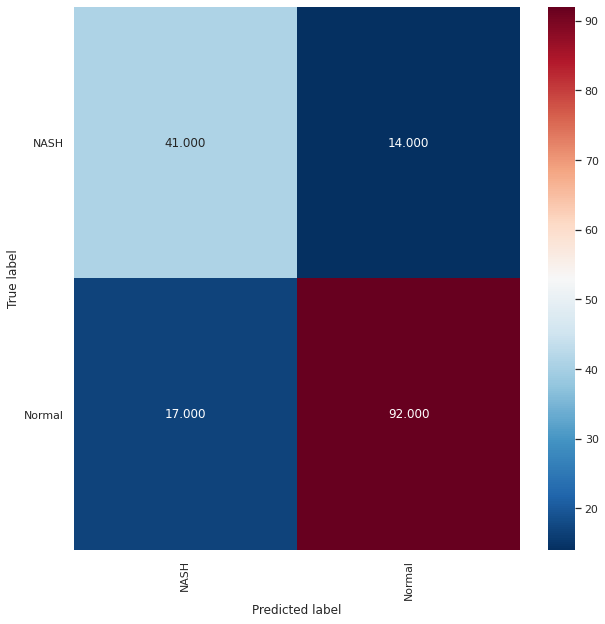

Normalised over true label (rows)


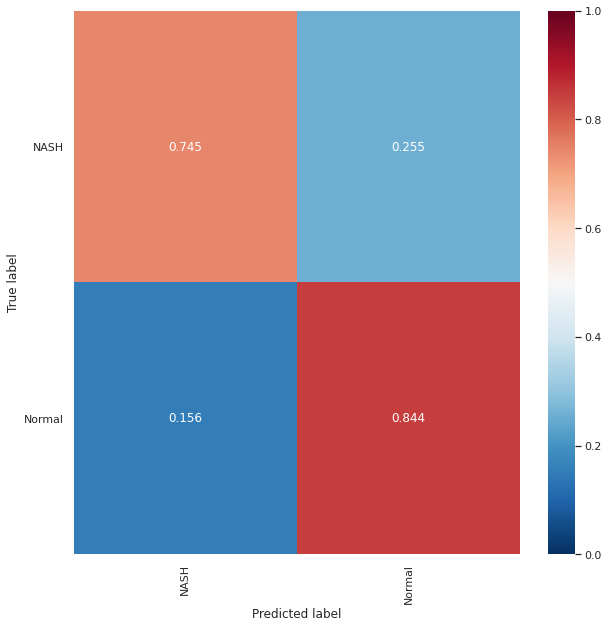

Normalised over pred label (columns)


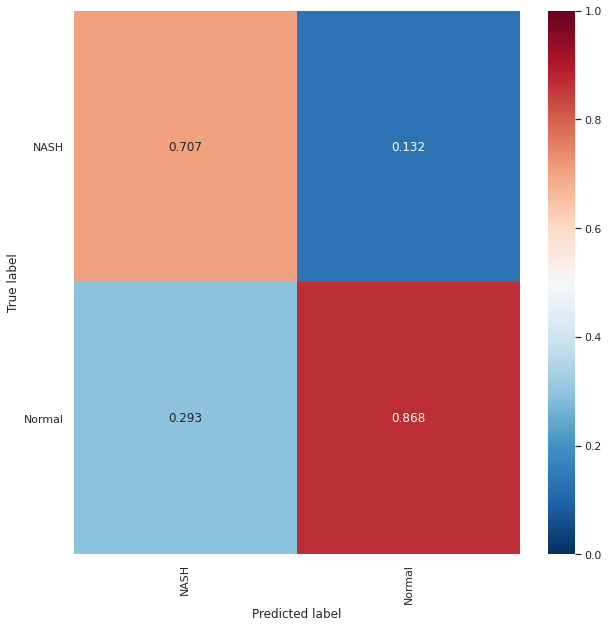

In [49]:
draw_conf_matrices(all_feat_flat_y_true, all_feat_flat_pred, ml_2_classes.results_dir, 'All_features')

In [50]:
all_feat_true_hue = []
for index, y in enumerate(all_feat_flat_y_true):
    if all_feat_flat_pred[index] == y:
        all_feat_true_hue.append('{}_correct'.format(y))
    else:
        all_feat_true_hue.append('{}_incorrect'.format(y))

sub_all_feat_true_hue = []
sub_all_feat_flat_x_true = []
sub_all_feat_flat_y_true = []
for i, true_hue in enumerate(all_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_all_feat_true_hue.append(true_hue)
        sub_all_feat_flat_x_true.append(all_feat_flat_x_true[i])
        sub_all_feat_flat_y_true.append(all_feat_flat_y_true[i])

all_feat_true_hue = np.array(all_feat_true_hue)
sub_all_feat_true_hue = np.array(sub_all_feat_true_hue)
sub_all_feat_flat_x_true = np.array(sub_all_feat_flat_x_true)
sub_all_feat_flat_y_true = np.array(sub_all_feat_flat_y_true)

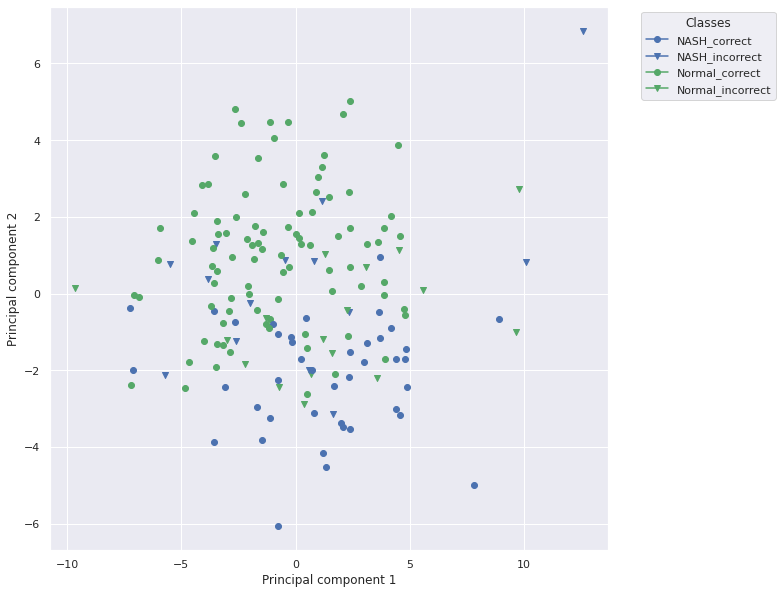

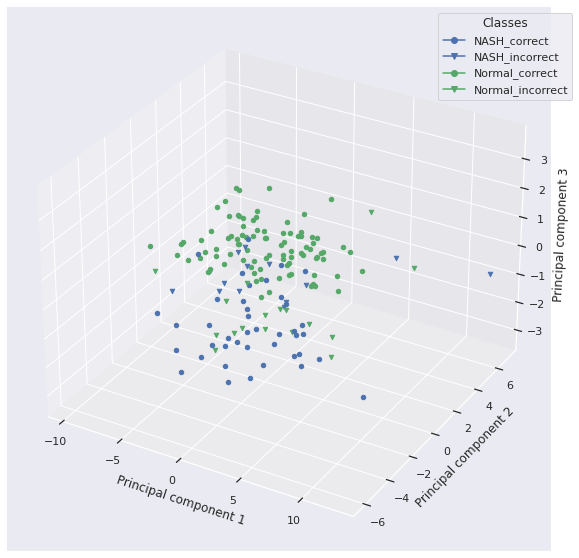

In [51]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

It is possible to train an ML model that is able to identify the class labels of subclasses it was not exposed to during training, i.e. in this case the model can predict the class ("Normal" or "NASH") of a sample from a patient it hasn't seen before better than random guessing.

The earlier correlation coefficients and importance analysis in this notebook indicate that many of the peptides provide similar information to one another. Is it therefore possible to maintain/improve model performance when reducing the number of features?

#### Is it possible to maintain/improve model performance when reducing the number of peptides?

Sequentially include features via their feature importance (as measured via KBest/permutation analysis), measure if there is any difference in trained classifier performance.

In [52]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing', 'max_sampling', 'smote']
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

ordered_features = {'KBest_Fscore': kbest_feat_importances_df['Feature'].tolist(),
                    'Permutation_score': mean_permut_feat_importances_df['Feature'].tolist()}

n_components_pca = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 7
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs = {accuracy_score: {},
                      recall_score: {'average': 'weighted',
                                     'zero_division': 0},
                      precision_score: {'average': 'weighted',
                                        'zero_division': 0},
                      f1_score: {'average': 'weighted',
                                 'zero_division': 0}}

red_feat_searches = OrderedDict({})
red_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Feature_selection_method': [],
                                   'Num_features': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})
for algorithm in algorithms:
    for resampling_method in resampling_methods:
        for feat_method, all_features in ordered_features.items():
            for num_features in num_features_list:
                fixed_params = ml_2_classes.define_fixed_model_params(classifier=algorithm())
                if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                    fixed_params['random_state'] = 1
                tuned_params = ml_2_classes.define_tuned_model_params(
                    classifier=algorithm(), x_train=ml_2_classes.x, n_folds=cv_folds_inner_loop
                )
                selected_features = all_features[:num_features]

                nested_cv_search = ml_2_classes.run_nested_CV(
                    clf=algorithm, x=ml_2_classes.x, y=ml_2_classes.y, groups=ml_2_classes.sub_classes,
                    selected_features=selected_features, inner_splits=None, outer_splits=None, const_split=True,
                    resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                    fixed_params=fixed_params, tuned_params=tuned_params,
                    train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                    n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                    cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
                )

                red_feat_searches[
                    '{}__{}__{}__{}'.format(algorithm.__name__, resampling_method, feat_method, num_features)
                ] = copy.deepcopy(nested_cv_search)

                red_feat_score_dict['Algorithm'].append(algorithm.__name__)
                red_feat_score_dict['Resampling_method'].append(resampling_method)
                red_feat_score_dict['Feature_selection_method'].append(feat_method)
                red_feat_score_dict['Num_features'].append(num_features)
                red_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
                red_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
                red_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
                red_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
                red_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
                red_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
                red_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
                red_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

                # Print output of nested CV
                for index, params in enumerate(nested_cv_search['outer_loop_params']):
                    print('\n\n\n')
                    print('{}: {},  {},  {}'.format(
                        algorithm.__name__, resampling_method, feat_method, num_features
                    ))
                    print('Parameters: {}'.format(params))
                    print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][index]))
                    print('F1: {}'.format(nested_cv_search['test_scores']['f1'][index]))





KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 1), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.75




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7083333333333334
F1: 0.7162734422262552




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 26), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.4583333333333333
F1: 0.4484848484848485




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7391304347826086
F1: 0.7391304347826086




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkows





KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.9166666666666666
F1: 0.9166666666666666




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 2), ('weights', 'distance')])
Accuracy: 0.6666666666666666
F1: 0.6526610644257703




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.5416666666666666
F1: 0.5477545857052498




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8260869565217391
F1: 0.8240802675585283




KNeighborsClassifier: no_balancing,  KBest_Fscore,  15
Parameter





KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 18), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 14), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7916666666666666
F1: 0.7765567765567766




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 18), ('p', 1), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.7394957983193278




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




KNeighborsClassifier: no_balancing,  Permutation_score,  3
Pa





KNeighborsClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 15), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8784029038112523




KNeighborsClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.7083333333333334
F1: 0.7122074636306136




KNeighborsClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 22), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.4583333333333333
F1: 0.465528146742568




KNeighborsClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 2), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.6956521739130435
F1: 0.6956521739130435




KNeighborsClassifier: no_balancing,  Permutation_score,  30





KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 29), ('p', 2), ('weights', 'distance')])
Accuracy: 0.875
F1: 0.8784029038112523




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 16), ('p', 2), ('weights', 'distance')])
Accuracy: 0.7916666666666666
F1: 0.787878787878788




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 9), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.5416666666666666
F1: 0.5541439806412584




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 22), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.6521739130434783
F1: 0.6508563899868249




KNeighborsClassifier: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('





KNeighborsClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 29), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




KNeighborsClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.75




KNeighborsClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 31), ('p', 1), ('weights', 'distance')])
Accuracy: 0.5833333333333334
F1: 0.5925925925925926




KNeighborsClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 23), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.6956521739130435
F1: 0.6921739130434783




KNeighborsClassifier: max_sampling,  Permutation_score,  1
Parameters: Orde





KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 9), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 2), ('weights', 'distance')])
Accuracy: 0.625
F1: 0.6349206349206349




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 12), ('p', 2), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.7571428571428571




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 14), ('p', 1), ('weights', 'distance')])
Accuracy: 0.7391304347826086
F1: 0.7391304347826086




KNeighborsClassifier: max_sampling,  Permutation_score,  15
Paramete





KNeighborsClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 31), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.875
F1: 0.8784029038112523




KNeighborsClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 19), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7394957983193278




KNeighborsClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 29), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.5416666666666666
F1: 0.5541439806412584




KNeighborsClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 29), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.6521739130434783
F1: 0.6508563899868249




KNeighborsClassifier: smote,  KBest_Fscore,  3
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighb





KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7555555555555555




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.5
F1: 0.5111111111111112




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 19), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8260869565217391
F1: 0.8254281949934124




KNeighborsClassifier: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neig





KNeighborsClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 23), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




KNeighborsClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7916666666666666
F1: 0.7765567765567766




KNeighborsClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 16), ('p', 2), ('weights', 'distance')])
Accuracy: 0.625
F1: 0.6299810246679316




KNeighborsClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 19), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.9565217391304348
F1: 0.9563561076604555




KNeighborsClassifier: smote,  Permutation_score,  5
Parameters: OrderedDict([('metric', 





GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.9583333333333334
F1: 0.9575757575757576




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8333333333333334
F1: 0.8263305322128852




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.4583333333333333
F1: 0.4484848484848485




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.782608695652174
F1: 0.7817805383022775




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.9130434782608695
F1: 0.9193236714975844




GaussianNB: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8604439039221647




GaussianNB: no_balancing,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.9166666666666666
F1: 0.9185185185





GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8766603415559772




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.7916666666666666
F1: 0.7765567765567766




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6299810246679316




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.86651411136537




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 1.0
F1: 1.0




GaussianNB: no_balancing,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.8260869565217391
F1: 0.8073316283034953




GaussianNB: no_balancing,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.9583333333333334
F1: 0.9588867805186592




Gaussi





GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.9166666666666666
F1: 0.9185185185185185




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6736596736596736




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5111111111111112




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6956521739130435
F1: 0.6921739130434783




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8817617165443252




GaussianNB: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8604439039221647




GaussianNB: max_sampling,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7552447552447553




GaussianNB: max_s





GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.7083333333333334
F1: 0.7122074636306136




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.625
F1: 0.6299810246679316




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.6956521739130435
F1: 0.6921739130434783




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.6956521739130435
F1: 0.60608434521478




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.8260869565217391
F1: 0.844842284739983




GaussianNB: max_sampling,  Permutation_score,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8673211781206172




GaussianNB: max_sampling,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0





GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.875
F1: 0.8784029038112523




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6666666666666666
F1: 0.6736596736596736




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.5
F1: 0.5111111111111112




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6956521739130435
F1: 0.6921739130434783




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8817617165443252




GaussianNB: smote,  KBest_Fscore,  1
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8604439039221647




GaussianNB: smote,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7552447552447553




GaussianNB: smote,  KBest_Fscore,  2
Parameters: OrderedDict()
Accuracy: 0.66666666666





GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.75
F1: 0.7552447552447553




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.7083333333333334
F1: 0.7030303030303031




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.7083333333333334
F1: 0.7122074636306136




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.782608695652174
F1: 0.782608695652174




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8604439039221647




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.8695652173913043
F1: 0.8817617165443252




GaussianNB: smote,  Permutation_score,  2
Parameters: OrderedDict()
Accuracy: 0.6521739130434783
F1: 0.660200668896321




GaussianNB: smote,  Permutation_score,  3
Parameters: OrderedDict()
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




GaussianNB: smote,  P

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9583333333333334
F1: 0.9575757575757576




LinearSVC: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.8333333333333334
F1: 0.8263305322128852




LinearSVC: no_balancing,  KBest_Fscore,  

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  5
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.9166666666666666
F1: 0.9185185185185185




LinearSVC: no_balancing,  KBest_Fscore,  5
Parameters: O

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.7083333333333334
F1: 0.7162734422262552




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.625
F1: 0.5978021978021979




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




LinearSVC: no_balancing

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  3
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




LinearSVC: no_balancing,  Permutation_score,  3
Para

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.625
F1: 0.6352087114337568




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.6666666666666666
F1: 0.6526610644257703




LinearSVC: no_balancing, 

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  KBest_Fscore,  1
Parameters: OrderedDict([('d

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: max_sampling,  KBest_Fscore,  5
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.5)])
Accuracy: 0.7083333333333334
F1: 0.7162734422262552




LinearSVC: max_sampling,  KBest_Fscore,  5
Pa

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.75
F1: 0.7571428571428571




LinearSVC: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.625
F1: 0.6299810246679316




LinearSVC: max_sampling,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.8260869565217391
F1: 0.8260869565217391




LinearSVC: max_sampling,  KBest_Fs

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: max_sampling,  Permutation_score,  4
Par

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.6666666666666666
F1: 0.6736596736596736




LinearSVC: max_sampling,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.75
F1: 0.7555555555555555




LinearSVC: max_sampling,

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.875
F1: 0.8784029038112523




LinearSVC: smote,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False)

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.75
F1: 0.7552447552447553




LinearSVC: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('dual', False),

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: smote,  KBest_Fscore,  30
Parameters: OrderedDict([

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7083333333333334
F1: 0.7118840579710145




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.75
F1: 0.7555555555555555




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




LinearSVC: smote,  Permutation_score,  2
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8695652173913043
F1: 0.8690683229813664




LinearSVC: smote,  Permutation_scor

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.03125)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




LinearSVC: smote,  Permutation_score,  10
Parameters: Ord

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






LinearSVC: smote,  Permutation_score,  46
Parameters: OrderedDict([('du

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 32768.0






SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8766603415559772




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.5416666666666666
F1: 0.5333333333333333




SVC: no_balancing,  KBest_Fscore,  10
Parameters: OrderedDict([('random_state', 1), ('C', 512.0), ('gamma', 0.00048828125), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.7361204013377926




SVC: no_balancing,  KBest_Fscore,  10
Paramete





SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 4096.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7552447552447553




SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 16384.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.8333333333333334
F1: 0.8148148148148149




SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 2048.0), ('gamma', 0.0625), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6526610644257703




SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.6956521739130435
F1: 0.6589995324918185




SVC: no_balancing,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.8260869565217391
F1: 0.8073316283034953




SVC: no_b





SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8784029038112523




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.8333333333333334
F1: 0.8333333333333334




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.5
F1: 0.5




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.7287784679089025




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.6826086956521739




SVC: no_balancing,  Permutation_sco

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125






SVC: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 0.5), ('kernel', 'rbf')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




SVC: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0078125), ('kernel', 'rbf')])
Accuracy: 0.7083333333333334
F1: 0.7162734422262552




SVC: max_sampling,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.5416666666666666
F1: 0.5537918871252204




SVC: max_sampling,  KBest_Fscore,  3
Parameters





SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.5833333333333334
F1: 0.5920745920745921




SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.5833333333333334
F1: 0.5925925925925926




SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.7381422924901185




SVC: max_sampling,  KBest_Fscore,  20
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.5652173913043478
F1: 0.4710144927536232




SVC: max_sampling,  KBe





SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 8192.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.75




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.5416666666666666
F1: 0.5537918871252204




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 2.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.7391304347826086




SVC: max_sampling,  Permutation_score,  4
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.6956521739130435
F1: 0.6482213438735178




SVC: max_sampling,  Perm





SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 256.0), ('gamma', 6.103515625e-05), ('kernel', 'rbf')])
Accuracy: 0.8333333333333334
F1: 0.8380952380952381




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6761904761904761




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.5833333333333334
F1: 0.5925925925925926




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.001953125), ('kernel', 'rbf')])
Accuracy: 0.9130434782608695
F1: 0.9120401337792643




SVC: max_sampling,  Permutation_score,  46
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 6.103515625e-05), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.68260

Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 0.03125


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 3.0517578125e-05


Range tested: [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0, 512.0, 1024.0, 2048.0, 4096.0, 8192.0, 16384.0, 32768.0]
Value selected: 32768.0






SVC: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('C', 0.03125), ('gamma', 3.0517578125e-05), ('kernel', 'rbf')])
Accuracy: 0.875
F1: 0.8784029038112523




SVC: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('C', 32768.0), ('gamma', 0.25), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7394957983193278




SVC: smote,  KBest_Fsco





SVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




SVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.6666666666666666
F1: 0.6736596736596736




SVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.000244140625), ('kernel', 'rbf')])
Accuracy: 0.5833333333333334
F1: 0.5833333333333334




SVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 0.0009765625), ('kernel', 'rbf')])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




SVC: smote,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.0001220703125), ('kernel', 'rbf')])
Accuracy: 0.7391304347826086
F1: 0.6826086956521739




SVC: smote,  KBest_Fscore,  46






SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.75
F1: 0.7552447552447553




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.625
F1: 0.6349206349206349




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 16.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.7083333333333334
F1: 0.7160493827160493




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.6521739130434783
F1: 0.6481605351170568




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.6956521739130435
F1: 0.6482213438735178




SVC: smote,  Permutation_score,  10
Parameters: OrderedDict([('rando





AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.8333333333333334
F1: 0.837037037037037




AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.5416666666666666
F1: 0.5333333333333333




AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.5833333333333334
F1: 0.5833333333333334




AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




AdaBoostClassifier: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('n_estima





AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.75
F1: 0.7555555555555555




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.4166666666666667
F1: 0.39215686274509803




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.782608695652174
F1: 0.7693800158744157




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.6521739130434783
F1: 0.5768115942028985




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_estimators





AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6666666666666666
F1: 0.674074074074074




AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.5833333333333334
F1: 0.5925925925925926




AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.7391304347826086
F1: 0.7287784679089025




AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6521739130434783
F1: 0.5768115942028985




AdaBoostClassifier: no_balancing,  Permutation_score,  15
Parameters: Ordered





AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.625
F1: 0.618181818181818




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.5416666666666666
F1: 0.5541439806412584




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6521739130434783
F1: 0.6441471571906354




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




AdaBoostClassifier: max_sampling,  KBest_Fscore,  4
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Ac





AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.875
F1: 0.8766603415559772




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6666666666666666
F1: 0.6526610644257703




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6521739130434783
F1: 0.5148741418764302




AdaBoostClassifier: max_sampling,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 





AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.7916666666666666
F1: 0.7971781305114639




AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.7083333333333334
F1: 0.7122074636306136




AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7083333333333334
F1: 0.7162734422262552




AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.8260869565217391
F1: 0.8191856452726018




AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6956521739130435
F1: 0.60608434521478




AdaBoostClassifier: max_sampling,  Permutation_score,  20
Parameters: Order





AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.875
F1: 0.8766603415559772




AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.625
F1: 0.6352087114337568




AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.5
F1: 0.5111111111111112




AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.6521739130434783
F1: 0.6441471571906354




AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6956521739130435
F1: 0.60608434521478




AdaBoostClassifier: smote,  KBest_Fscore,  5
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.782608695652174
F1: 0.8079456775108949




AdaBoostClassifie





AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7552447552447553




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.75
F1: 0.7394957983193278




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6666666666666666
F1: 0.6666666666666666




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 1000)])
Accuracy: 0.8260869565217391
F1: 0.8240802675585283




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.782608695652174
F1: 0.7674065065369414




AdaBoostClassifier: smote,  Permutation_score,  2
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.9565217391304348





AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.75
F1: 0.7552447552447553




AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.75
F1: 0.75




AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10000)])
Accuracy: 0.5
F1: 0.5




AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.8260869565217391
F1: 0.8240802675585283




AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 316)])
Accuracy: 0.782608695652174
F1: 0.7674065065369414




AdaBoostClassifier: smote,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.9130434782608695
F1: 0.9193236714975844




Ad

In [53]:
red_feat_score_df = pd.DataFrame(red_feat_score_dict)

In [54]:
red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,KBest_Fscore,1,0.739648,0.144457,0.739648,0.144457,0.759617,0.151682,0.724913,0.152257
1,KNeighborsClassifier,no_balancing,KBest_Fscore,2,0.756988,0.135410,0.756988,0.135410,0.730373,0.185951,0.732046,0.158578
2,KNeighborsClassifier,no_balancing,KBest_Fscore,3,0.781315,0.151469,0.781315,0.151469,0.758156,0.195980,0.754501,0.173870
3,KNeighborsClassifier,no_balancing,KBest_Fscore,4,0.762940,0.112057,0.762940,0.112057,0.742452,0.168312,0.735189,0.138510
4,KNeighborsClassifier,no_balancing,KBest_Fscore,5,0.762940,0.152295,0.762940,0.152295,0.735388,0.203574,0.731781,0.176553
...,...,...,...,...,...,...,...,...,...,...,...,...
295,AdaBoostClassifier,smote,Permutation_score,10,0.776398,0.119690,0.776398,0.119690,0.809756,0.123447,0.775626,0.118361
296,AdaBoostClassifier,smote,Permutation_score,15,0.794513,0.115933,0.794513,0.115933,0.830598,0.105839,0.789568,0.118513
297,AdaBoostClassifier,smote,Permutation_score,20,0.794513,0.121822,0.794513,0.121822,0.816257,0.118679,0.795038,0.118559
298,AdaBoostClassifier,smote,Permutation_score,30,0.757764,0.117459,0.757764,0.117459,0.784130,0.128720,0.757678,0.118320


In [55]:
with open('{}/Red_features_CV_search_models.pkl'.format(ml_2_classes.results_dir), 'wb') as f:
    pickle.dump((red_feat_searches, red_feat_score_df), f)

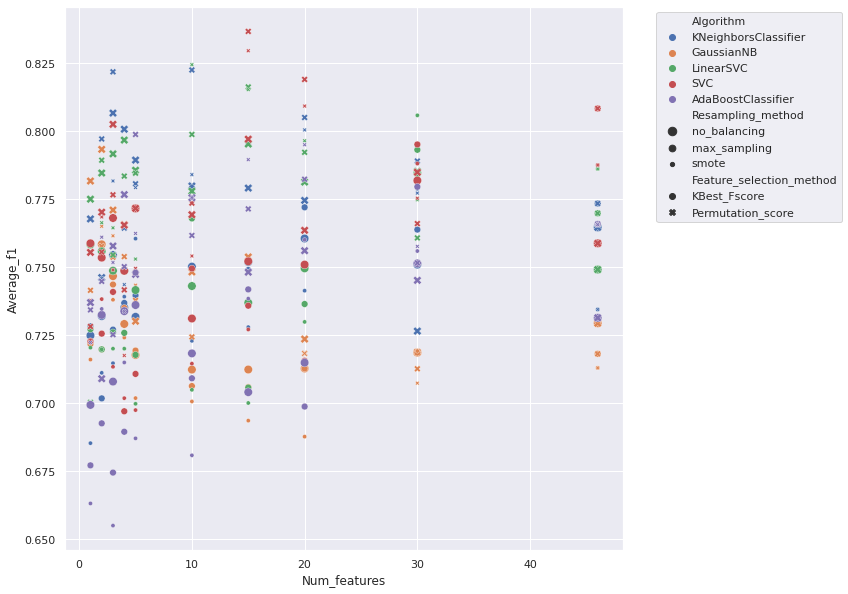

In [56]:
plt.clf()
sns.scatterplot(
    x=red_feat_score_df['Num_features'], y=red_feat_score_df['Average_f1'],
    hue=red_feat_score_df['Algorithm'], style=red_feat_score_df['Feature_selection_method'],
    size=red_feat_score_df['Resampling_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/Number_of_features_vs_performance_scatter_plot.svg'.format(ml_2_classes.results_dir))
plt.show()

Model performance varies depending upon the algorithm, but in general plateaus after ~3 features. The support vector and k neighbours algorithms generally outperform the others. Feature selection with permutation analysis tends to lead to better performance than feature selection via KBest analysis, which likely reflects the fact that as described above permutation analysis measures the unique information provided by a feature about the output class, whereas KBest is a univariate method.

In [57]:
sub_red_feat_score_df = red_feat_score_df[
      (red_feat_score_df['Num_features'] == 3)
    & (red_feat_score_df['Feature_selection_method'] == 'Permutation_score')
].reset_index(drop=True)

In [58]:
sub_red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,Permutation_score,3,0.823758,0.089553,0.823758,0.089553,0.850494,0.078597,0.806677,0.112029
1,KNeighborsClassifier,max_sampling,Permutation_score,3,0.824275,0.077799,0.824275,0.077799,0.857665,0.067845,0.821844,0.080539
2,KNeighborsClassifier,smote,Permutation_score,3,0.781056,0.071679,0.781056,0.071679,0.800533,0.092160,0.781725,0.078274
3,GaussianNB,no_balancing,Permutation_score,3,0.782091,0.138458,0.782091,0.138458,0.810402,0.129424,0.771037,0.147698
4,GaussianNB,max_sampling,Permutation_score,3,0.751035,0.121455,0.751035,0.121455,0.795169,0.120857,0.753710,0.119984
5,GaussianNB,smote,Permutation_score,3,0.756988,0.077397,0.756988,0.077397,0.806025,0.085368,0.761561,0.074050
6,LinearSVC,no_balancing,Permutation_score,3,0.799689,0.085317,0.799689,0.085317,0.825324,0.095589,0.791682,0.092073
7,LinearSVC,max_sampling,Permutation_score,3,0.750776,0.048859,0.750776,0.048859,0.808691,0.065534,0.754513,0.045019
8,LinearSVC,smote,Permutation_score,3,0.762940,0.051880,0.762940,0.051880,0.800289,0.068153,0.764500,0.053261
9,SVC,no_balancing,Permutation_score,3,0.811077,0.104960,0.811077,0.104960,0.826416,0.118901,0.802542,0.113763


KNeighborsClassifier with class balancing via random oversampling performs best across all 4 metrics => take forwards.

In [59]:
red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['outer_loop_params']

[OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 17),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 17),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 27),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 9),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 9),
              ('p', 2),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 13),
              ('p', 1),
              ('weights', 'uniform

In [60]:
red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 13),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('recall',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 13),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('precision',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 13),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('f1',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 13),
                           ('p', 1),
                     

In [61]:
red_feat_nested_pred = red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['predictions']
red_feat_nested_y_true = red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['y_true']
red_feat_nested_x_true = red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['x_true']

red_feat_flat_pred = np.array([pred for pred_array in red_feat_nested_pred for pred in pred_array])
red_feat_flat_y_true = np.array([y for y_array in red_feat_nested_y_true for y in y_array])
red_feat_flat_x_true = np.array([x for x_array in red_feat_nested_x_true for x in x_array])

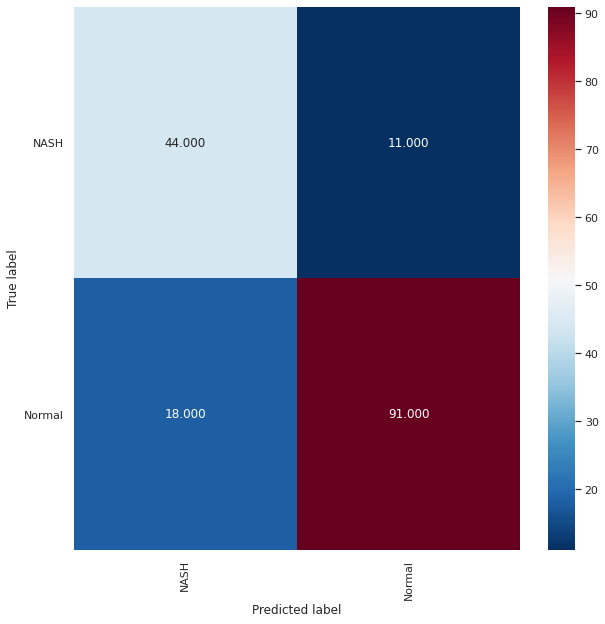

Normalised over true label (rows)


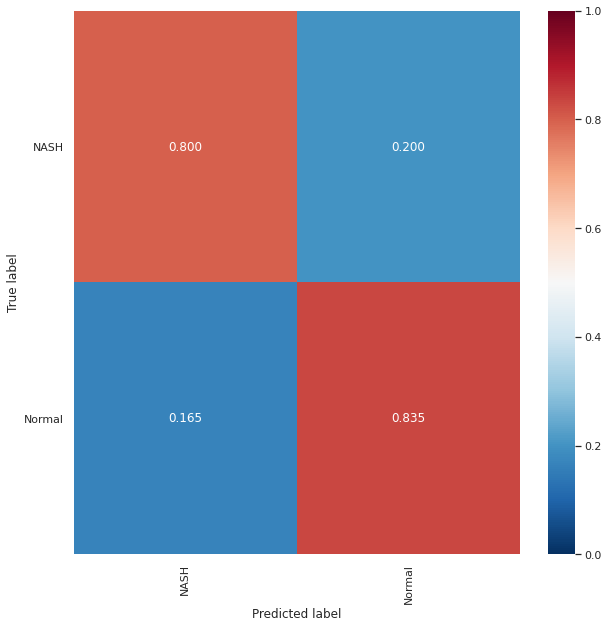

Normalised over pred label (columns)


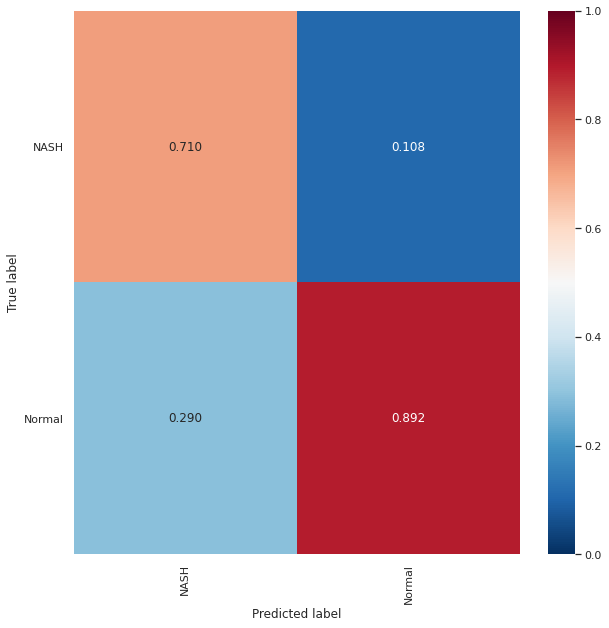

In [62]:
draw_conf_matrices(red_feat_flat_y_true, red_feat_flat_pred, ml_2_classes.results_dir, 'Red_features')

In [63]:
red_feat_true_hue = []
for index, y in enumerate(red_feat_flat_y_true):
    if red_feat_flat_pred[index] == y:
        red_feat_true_hue.append('{}_correct'.format(y))
    else:
        red_feat_true_hue.append('{}_incorrect'.format(y))

sub_red_feat_true_hue = []
sub_red_feat_flat_x_true = []
sub_red_feat_flat_y_true = []
for i, true_hue in enumerate(red_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_red_feat_true_hue.append(true_hue)
        sub_red_feat_flat_x_true.append(red_feat_flat_x_true[i])
        sub_red_feat_flat_y_true.append(red_feat_flat_y_true[i])

red_feat_true_hue = np.array(red_feat_true_hue)
sub_red_feat_true_hue = np.array(sub_red_feat_true_hue)
sub_red_feat_flat_x_true = np.array(sub_red_feat_flat_x_true)
sub_red_feat_flat_y_true = np.array(sub_red_feat_flat_y_true)

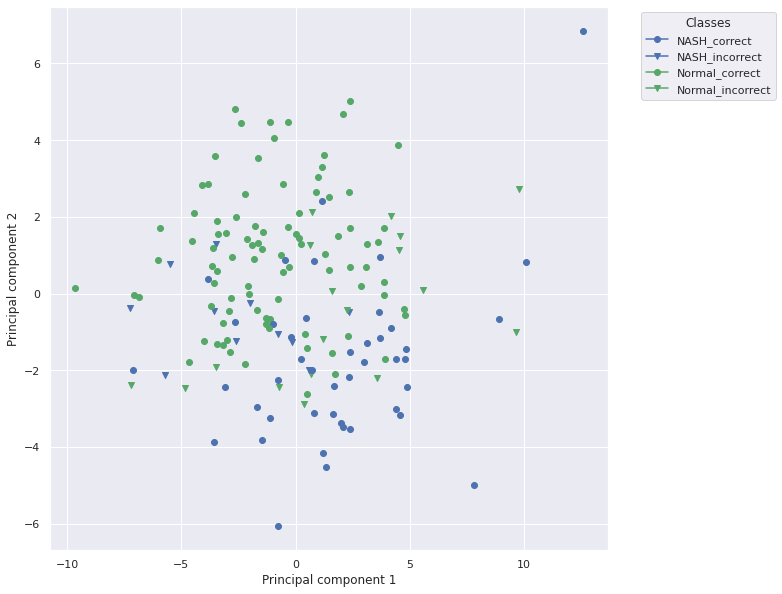

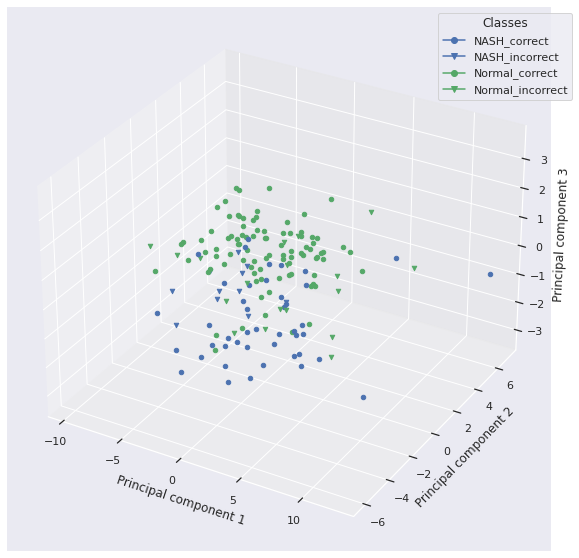

In [64]:
# Scatter plot (axes = top two principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml_2_classes.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# NASH_incorrect = Value that is actually NASH is predicted to be something else

So, a KNeighborsClassifier model trained with just 3 peptides similarly well to an SVC model trained with all features.

Is there a significant difference between the two models?

In [65]:
params_1 = all_feat_searches['SVC__max_sampling']['best_outer_loop_params']['f1']
selected_features_1 = list(ml_2_classes.features)
params_2 = red_feat_searches['KNeighborsClassifier__max_sampling__Permutation_score__3']['best_outer_loop_params']['f1']
selected_features_2 = mean_permut_feat_importances_df['Feature'].tolist()[:3]

print('Model 1:')
print('Algorithm: SVC')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: KNeighborsClassifier')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml_2_classes.run_group_5x2_CV_combined_F_test(
    x=ml_2_classes.x, y=ml_2_classes.y, groups=ml_2_classes.sub_classes, selected_features_1=selected_features_1,
    selected_features_2=selected_features_2, classifier_1=SVC, classifier_2=KNeighborsClassifier,
    params_1=params_1, params_2=params_2, resampling_method_1='max_sampling', resampling_method_2='max_sampling',
    n_components_pca_1=None, n_components_pca_2=None
)

Model 1:
Algorithm: SVC
Parameters:
OrderedDict([('random_state', 1), ('C', 512.0), ('gamma', 6.103515625e-05), ('kernel', 'rbf')])
Features:
['DPH_CCPent', 'DPH_QLKEIA', 'DPH_CCHex2-I24K', 'DPH_CCHept-I24N', 'DPH_CCHept-L28W', 'DPH_GRP22', 'DPH_CCHex', 'DPH_NLKEIA', 'DPH_CCHept-L28K', 'DPH_CCHept-I24T', 'DPH_CCHept-L7Y', 'DPH_CCHex2', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I17H', 'DPH_CCHept-I24H', 'DPH_CCHept-L28Y', 'DPH_GRP46', 'DPH_CCHept', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17K-L24E', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-I24Y', 'DPH_GRP51', 'DPH_CCHept-I24D', 'DPH_CCHept-L14A', 'DPH_CCHept-L7K', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24Y', 'DPH_GRP52', 'DPH_CCHept-I24E', 'DPH_CCHept-L21A', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-L21Y-I24S', 'DPH_GRP63', 'DPH_CCHept-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-I17T', 'DPH_GRP80', 'DPH_CCHept-I17K', 'DPH_CCPent-I24K', 'DPH_CCHept-I24S', 'DPH_CCHept-L7W', 'DPH_CCHept-I24P'

In [66]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 0.6510484420257218
p value: 0.7368122300820649


So, there is no significant difference in performance when reduce the number of peptides from 46 to 3.